**Dependencies and Such**

In [1]:
!pip install --upgrade --force-reinstall "git+https://github.com/ytdl-org/youtube-dl.git"
!pip install Augmentor

  Cloning https://github.com/ytdl-org/youtube-dl.git to /tmp/pip-req-build-euzc5loi
  Running command git clone --filter=blob:none --quiet https://github.com/ytdl-org/youtube-dl.git /tmp/pip-req-build-euzc5loi
  Resolved https://github.com/ytdl-org/youtube-dl.git to commit dc512e3a8a26a8e3fc7f1f67e5ee5e7699db8659
  Preparing metadata (setup.py) ... done
  Created wheel for youtube-dl: filename=youtube_dl-2021.12.17-py2.py3-none-any.whl size=1946343 sha256=ff18cc6a5ee16243d30962657861673753fd9c5a038fd589e754d954b3fdec89
  Stored in directory: /tmp/pip-ephem-wheel-cache-j5ekmdse/wheels/64/8e/40/866e846163e3e4859bbe820ff8847ec97f4320864f1525aa9a
Successfully built youtube-dl


In [2]:
import cv2
import os
import random
import numpy as np
from matplotlib import pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer, Conv2D, Dense, MaxPooling2D, Input, Flatten
import tensorflow as tf
from google.colab import drive

In [3]:
# My data was accessed from my own Google Drive using this code.
drive.mount("/content/drive")
NEG = os.path.join("data", "neg") # LFW dataset path
MAIN = os.path.join("/content", "drive", "My Drive", "jerma", "photos") # library containing all photos used for training besides LFW
ANCH = os.path.join(MAIN, "anchor_resized", "anchor_resized") # unaugmented anchor images
ANCH_AUG = os.path.join(MAIN, "posanch_aug") # augmented anchor images
MODELCORR = os.path.join(MAIN, "newNeg") # negative data the model misclassified as positive ( was collected for more training after the first rounds of training )
CUSTOM = os.path.join(MAIN, "newNeg", "neg") # unaugmented negative data
NEG_AUG = os.path.join(MAIN, "neg_aug") # augmented negative data


Mounted at /content/drive


In [ ]:
# LFW dataset was manually loaded into Google Colab and extracted with this code
!tar -xf lfw.tgz
for directory in os.listdir("lfw"):
  for image in os.listdir(os.path.join("lfw", directory)):
    OLD_PATH = os.path.join("lfw", directory, image)
    NEW_PATH = os.path.join(NEG, image)
    os.replace(OLD_PATH, NEW_PATH)

**Data Preprocessing**

In [4]:
def preprocess(filepath):
  contents = tf.io.read_file(filepath)
  image = tf.image.decode_jpeg(contents)
  image = tf.image.resize(image, (100, 100))
  image = image / 255.0
  return image

In [5]:
images = tf.data.Dataset.list_files(ANCH_AUG + "/*.jpg").shuffle(buffer_size = 1000) # access all images of Jerma
anchors = images.take(2263) # use half of the images of Jerma as anchor images
positives = images.skip(2263).take(2263) # use half of the images of Jerma as positive images


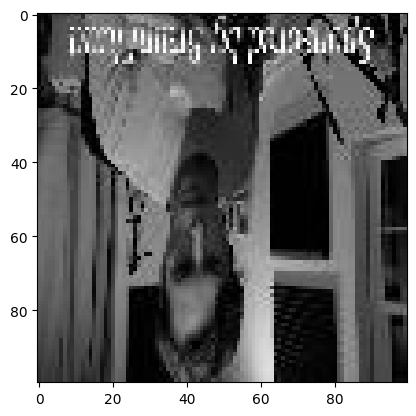

In [7]:
pos1 = positives.as_numpy_iterator().next()
plt.imshow(preprocess(pos1))

In [8]:
negatives = tf.data.Dataset.list_files(MODELCORR + "/*.jpeg").shuffle(buffer_size = 1000).take(200) # access negative data misclassified as positive
negatives = negatives.concatenate(tf.data.Dataset.list_files(CUSTOM + "/*.jpg").shuffle(buffer_size = 1000)) # access unaugmented negative data
negatives = negatives.concatenate(tf.data.Dataset.list_files(NEG_AUG + "/*.jpg").shuffle(buffer_size = 1000).take(452)) # access augmented negative data
negatives = negatives.concatenate(tf.data.Dataset.list_files(NEG + "/*.jpg").shuffle(buffer_size = 1000).take(451)) # access LFW data

In [9]:
len(negatives)

2263

In [10]:
len(positives) == len(negatives), len(negatives) == len(anchors)

(True, True)

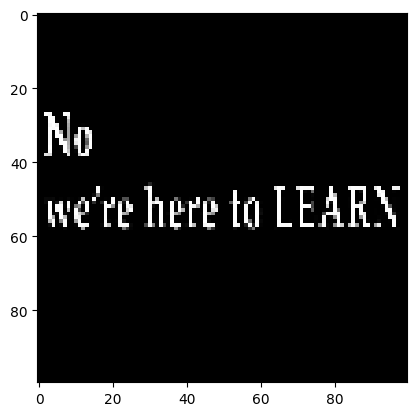

In [14]:
neg1 = negatives.as_numpy_iterator().next()
plt.imshow(preprocess(neg1))

In [ ]:
# used to Augment the data
import Augmentor

pipeline = Augmentor.Pipeline(source_directory = NEG_AUG, output_directory = NEG_AUG)
pipeline.flip_left_right(probability=0.5)
pipeline.flip_top_bottom(probability=0.5)
pipeline.random_brightness(probability=0.5, min_factor=0.7, max_factor=1.7)
pipeline.random_contrast(probability=0.5, min_factor=0.7, max_factor=1.7)
pipeline.random_color(probability=1, min_factor=0.0, max_factor=0.0)
pipeline.random_distortion(probability=0.5, grid_width=4, grid_height=4, magnitude=6)

num_samples = 406

pipeline.sample(num_samples)

Initialised with 1000 image(s) found.
Output directory set to /content/drive/My Drive/jerma/photos/neg_aug.

Processing <PIL.Image.Image image mode=RGB size=1920x1080 at 0x7D3839192AA0>: 100%|██████████| 406/406 [01:08<00:00,  5.95 Samples/s]


**Organizing the Datasets**

In [17]:
posData = tf.data.Dataset.zip((anchors, positives, tf.data.Dataset.from_tensor_slices(tf.ones(len(anchors))))) # zip anchors and positives together
negData = tf.data.Dataset.zip((anchors, negatives, tf.data.Dataset.from_tensor_slices(tf.zeros(len(anchors))))) # zip anchors and negatives together

In [18]:
data = posData.concatenate(negData).shuffle(buffer_size = 1000) # concatenate negative and positive datasets together

In [19]:
data = data.shuffle(buffer_size = 1000)

In [20]:
def dataPreprocess(anch, val, label):
  return (preprocess(anch), preprocess(val), label)

In [21]:
data = data.map(dataPreprocess)
data = data.cache()
data = data.shuffle(buffer_size = 1000)

In [22]:
sevp = round(len(data) * 0.8)
train_data = data.take(sevp)
train_data = train_data.batch(16)
train_data = train_data.prefetch(8)
test_data = data.skip(sevp).take(len(data) - sevp)
test_data = test_data.batch(16)
test_data = test_data.prefetch(8)


**Creating the Model**

In [23]:
def make_embedding():
    inp = Input(shape=(100,100,3))

    # First block
    c1 = Conv2D(64, (10,10), activation='relu')(inp)
    m1 = MaxPooling2D(64, (2,2), padding='same')(c1)

    # Second block
    c2 = Conv2D(128, (7,7), activation='relu')(m1)
    m2 = MaxPooling2D(64, (2,2), padding='same')(c2)

    # Third block
    c3 = Conv2D(128, (4,4), activation='relu')(m2)
    m3 = MaxPooling2D(64, (2,2), padding='same')(c3)

    # Final embedding block
    c4 = Conv2D(256, (4,4), activation='relu')(m3)
    f1 = Flatten()(c4)
    d1 = Dense(4096, activation='sigmoid')(f1)


    return Model(inputs=[inp], outputs=[d1], name='embedding')

In [24]:
embedding = make_embedding()

In [26]:
class L1Dist(Layer):


    def __init__(self, **kwargs):
        super().__init__()


    def __call__(self, input_embedding, validation_embedding):
        return tf.math.abs(input_embedding - validation_embedding)

In [27]:
def make_siamese_model():


    input_image = Input(name='input_img', shape=(100,100,3))


    validation_image = Input(name='validation_img', shape=(100,100,3))


    siamese_layer = L1Dist()
    siamese_layer._name = 'distance'
    distances = siamese_layer(embedding(input_image), embedding(validation_image))


    classifier = Dense(1, activation='sigmoid')(distances)

    return Model(inputs=[input_image, validation_image], outputs=classifier, name='SiameseNetwork')

In [28]:
model = make_siamese_model()

In [29]:
model.summary()

Model: "SiameseNetwork"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_img (InputLayer)      [(None, 100, 100, 3)]        0         []                            
                                                                                                  
 validation_img (InputLayer  [(None, 100, 100, 3)]        0         []                            
 )                                                                                                
                                                                                                  
 embedding (Functional)      (None, 4096)                 3896044   ['input_img[0][0]',           
                                                          8          'validation_img[0][0]']      
                                                                                     

**Model Training**

In [30]:
binary_cross_loss = tf.losses.BinaryCrossentropy()
opt = tf.keras.optimizers.Adam(1e-4) # 0.0001

In [31]:
@tf.function
def train_step(batch):

    # Record all of our operations
    with tf.GradientTape() as tape:
        # Get anchor and positive/negative image
        X = batch[:2]
        # Get label
        y = batch[2]

        # Forward pass
        yhat = model(X, training=True)
        # Calculate loss
        loss = binary_cross_loss(y, yhat)
    print(loss)

    # Calculate gradients
    grad = tape.gradient(loss, model.trainable_variables)

    # Calculate updated weights and apply to siamese model
    opt.apply_gradients(zip(grad, model.trainable_variables))

    # Return loss
    return loss

In [32]:
def train(data, EPOCHS):
    # Loop through epochs
    for epoch in range(1, EPOCHS+1):
        print('\n Epoch {}/{}'.format(epoch, EPOCHS))
        progbar = tf.keras.utils.Progbar(len(data))

        total = 0
        # Loop through each batch
        for idx, batch in enumerate(data):
            # Run train step here
            loss = train_step(batch)
            total += loss
            progbar.update(idx+1)

        # Save checkpoints
        print(f'Average Loss: {total / len(data)}')
        print(f'Loss: {loss}')

In [35]:
EPOCHS = 1

In [36]:
model.compile(optimizer = opt, loss = binary_cross_loss, metrics = ["accuracy"])

In [ ]:
train(train_data, EPOCHS)

In [ ]:
# iteration used to save versions of the model trained with different data to evaluate which set of data was best
iteration = 8
SAVE_PATH = os.path.join("/content", "drive", "My Drive", "jerma", "checkpoints") + ("ckpt" + iteration)
os.makedirs(SAVE_PATH)

In [ ]:
model.save(SAVE_PATH) # save the model

In [ ]:
siamese_model = tf.keras.models.load_model(SAVE_PATH) # verify the saving worked

**Model Evaluation** (I made this a while ago, so it's funky)

In [65]:
testAnch, testVal, testLabel = train_data.as_numpy_iterator().next()

In [ ]:
yhat = siamese_model.predict([testAnch, testVal])
res = [1 if prediction > 0.7 else 0 for prediction in yhat]

In [ ]:
from tensorflow.keras.metrics import Precision, Recall
print(res)
print(testLabel)
m = Recall()
n = Precision()
m.update_state(testLabel, res)
n.update_state(testLabel, res)
m.result().numpy(), n.result().numpy()

**Running the Model on a Youtube Video**

In [ ]:
# insert url of video in the parentheses
!youtube-dl ""

In [ ]:
urlFilepath = ""

In [ ]:
# get an anchor image for comparison when looking through youtube video
im1 = images.as_numpy_iterator().next()
im1 = preprocess(im1)
plt.imshow(im1)

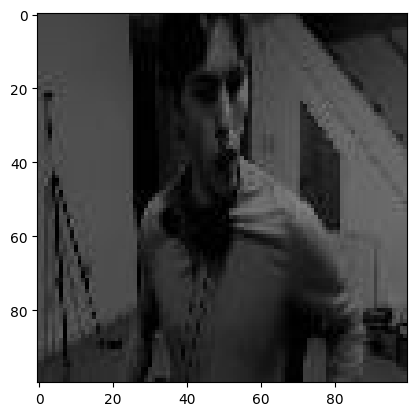

In [ ]:
plt.imshow(im1)
saved = []
def processVideo(secondsTimestamp = 0, **kwargs):

  cap = cv2.VideoCapture(urlFilepath)
  cap.set(cv2.CAP_PROP_POS_MSEC, secondsTimestamp * 1000)
  batch_size = 100
  timestamp = 0


  # Initialize lists to store frames, timestamps, and predictions
  frames = []
  timestamps = []

  while cap.isOpened():
      ret, frame = cap.read()
      if not ret:
          break
      frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
      frame = np.repeat(frame[:, :, np.newaxis], 3, axis=2)

      # Resize and preprocess the frame
      thing = cv2.resize(frame, (100, 100))
      thing = np.expand_dims(thing, axis=0)
      thing = thing / 255.0

      # Store frame and timestamp
      frames.append(thing)
      newStamp = cap.get(cv2.CAP_PROP_POS_MSEC) / 1000.0
      timestamps.append(newStamp)
      if newStamp >= (secondsTimestamp + 100):
        print(f"{newStamp} seconds reached. Processing the last 100 seconds")
        break


  cap.release()

  frames = np.array(frames)

  frames_array = np.squeeze(frames, axis=1)
  anc_batch = tf.expand_dims(im1, axis = 0)
  anc_batch = tf.tile(anc_batch, [len(frames_array), 1, 1, 1])


  # Predictions for the entire dataset
  yhat_batch = siamese_model.predict([anc_batch, frames_array])

  # Process individual predictions
  for i in range(len(frames)):
      yhat = yhat_batch[i]
      if yhat >= 0.90:
          print("Confidence:", yhat)
          timestamp = timestamps[i]
          print("JERMA LOCATED AT TIMESTAMP:", timestamp)
          plt.imshow(frames[i][0])
          saved.append(frames[i][0])
          plt.show()
  return newStamp



7700.025666666667 seconds reached. Processing the last 100 seconds
94/94 [==============================] - 12s 124ms/step
Confidence: [0.9235407]
JERMA LOCATED AT TIMESTAMP: 7599.9924


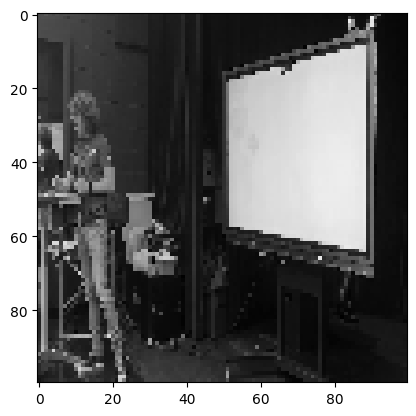

Confidence: [0.92495555]
JERMA LOCATED AT TIMESTAMP: 7600.025766666667


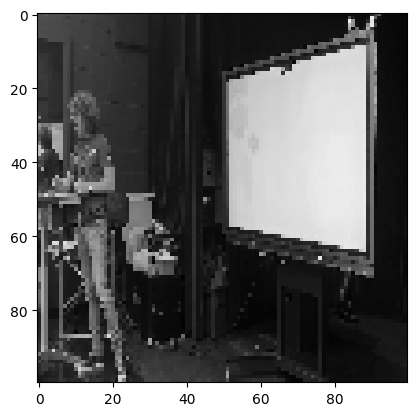

Confidence: [0.9330892]
JERMA LOCATED AT TIMESTAMP: 7600.059133333334


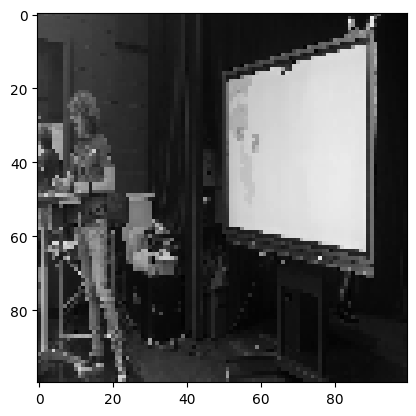

Confidence: [0.93539655]
JERMA LOCATED AT TIMESTAMP: 7600.092500000001


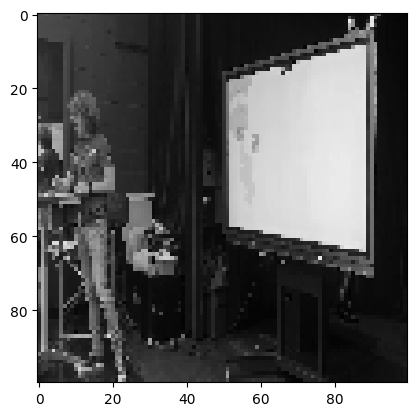

Confidence: [0.9419747]
JERMA LOCATED AT TIMESTAMP: 7600.125866666667


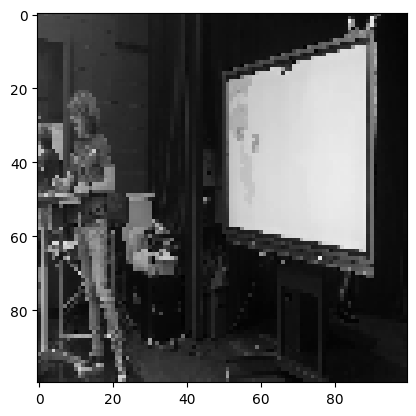

Confidence: [0.945872]
JERMA LOCATED AT TIMESTAMP: 7600.159233333334


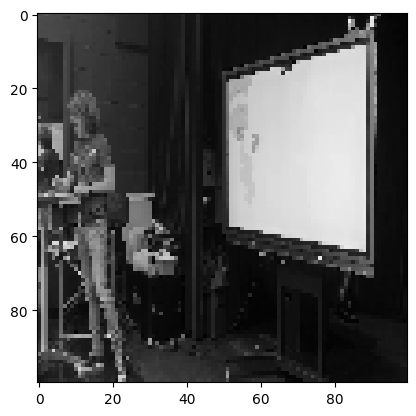

Confidence: [0.9330069]
JERMA LOCATED AT TIMESTAMP: 7600.1926


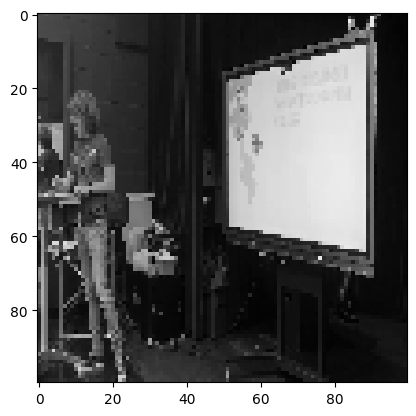

Confidence: [0.948574]
JERMA LOCATED AT TIMESTAMP: 7600.225966666667


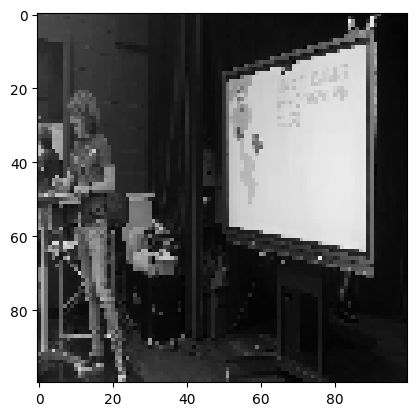

Confidence: [0.9471257]
JERMA LOCATED AT TIMESTAMP: 7600.259333333333


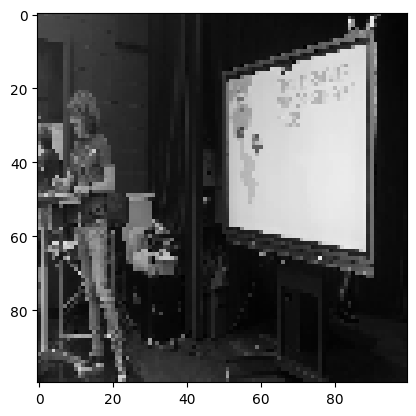

Confidence: [0.94884384]
JERMA LOCATED AT TIMESTAMP: 7600.2927


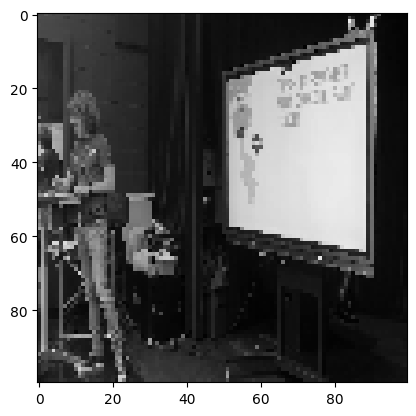

Confidence: [0.9453605]
JERMA LOCATED AT TIMESTAMP: 7600.326066666667


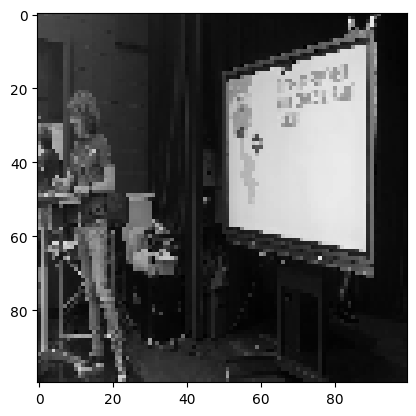

Confidence: [0.9542137]
JERMA LOCATED AT TIMESTAMP: 7600.359433333334


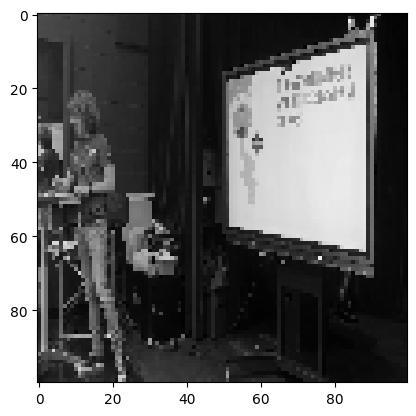

Confidence: [0.9617901]
JERMA LOCATED AT TIMESTAMP: 7600.3928000000005


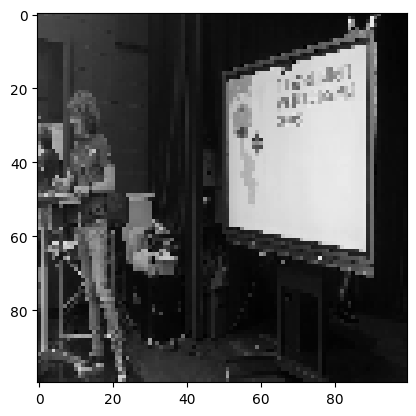

Confidence: [0.90626657]
JERMA LOCATED AT TIMESTAMP: 7600.426166666667


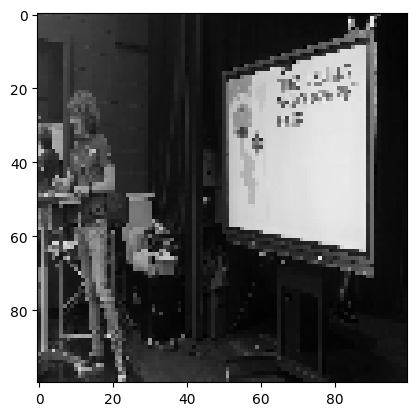

Confidence: [0.9034093]
JERMA LOCATED AT TIMESTAMP: 7600.459533333334


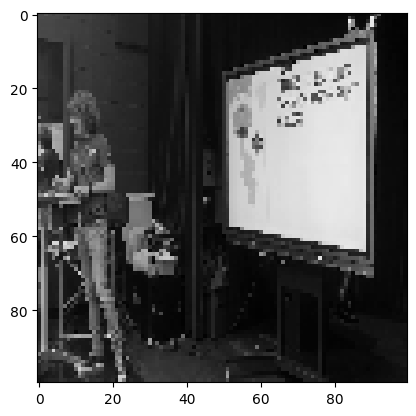

Confidence: [0.9355992]
JERMA LOCATED AT TIMESTAMP: 7600.4929


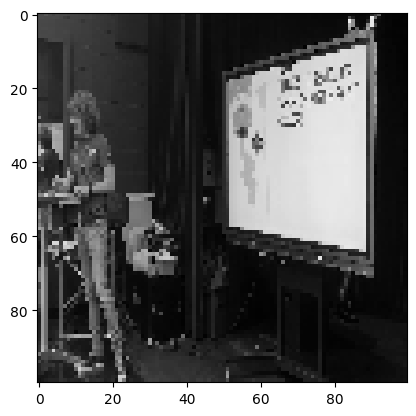

Confidence: [0.9272631]
JERMA LOCATED AT TIMESTAMP: 7600.526266666667


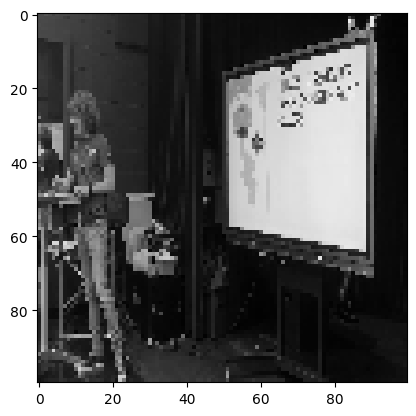

Confidence: [0.9056625]
JERMA LOCATED AT TIMESTAMP: 7600.559633333332


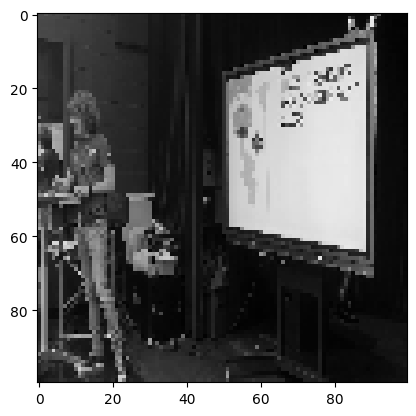

7800.058933333334 seconds reached. Processing the last 100 seconds
94/94 [==============================] - 12s 123ms/step
Confidence: [0.9106904]
JERMA LOCATED AT TIMESTAMP: 7710.436066666667


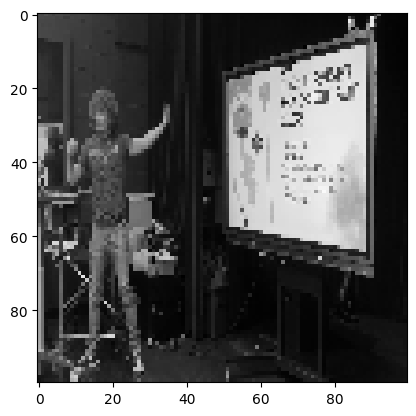

Confidence: [0.9122996]
JERMA LOCATED AT TIMESTAMP: 7710.469433333334


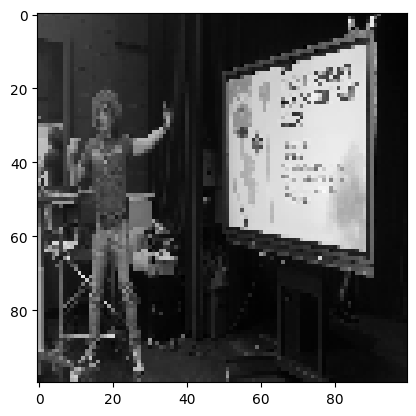

Confidence: [0.9424932]
JERMA LOCATED AT TIMESTAMP: 7710.5028


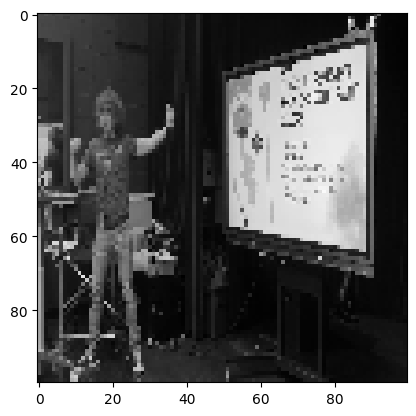

Confidence: [0.9468207]
JERMA LOCATED AT TIMESTAMP: 7710.536166666667


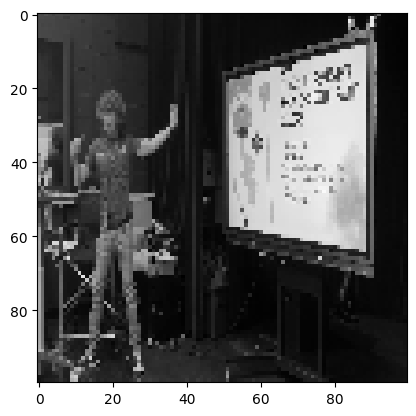

Confidence: [0.92800343]
JERMA LOCATED AT TIMESTAMP: 7710.569533333333


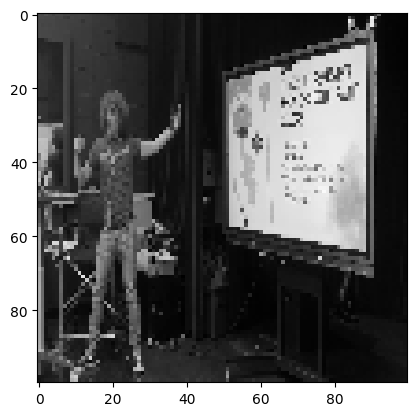

Confidence: [0.94217205]
JERMA LOCATED AT TIMESTAMP: 7710.602900000001


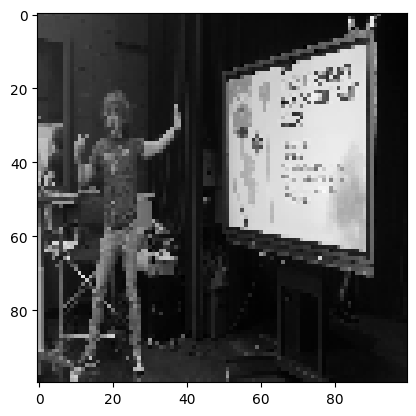

Confidence: [0.9557566]
JERMA LOCATED AT TIMESTAMP: 7710.636266666667


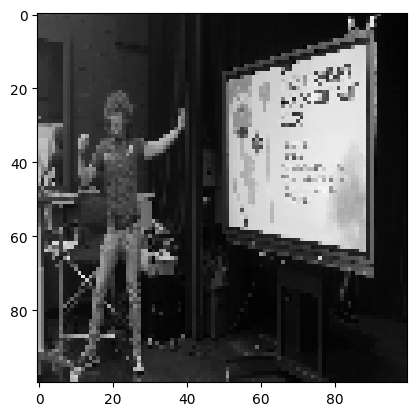

Confidence: [0.967123]
JERMA LOCATED AT TIMESTAMP: 7710.669633333334


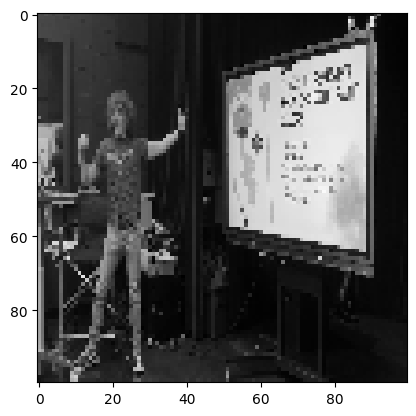

Confidence: [0.955417]
JERMA LOCATED AT TIMESTAMP: 7710.703


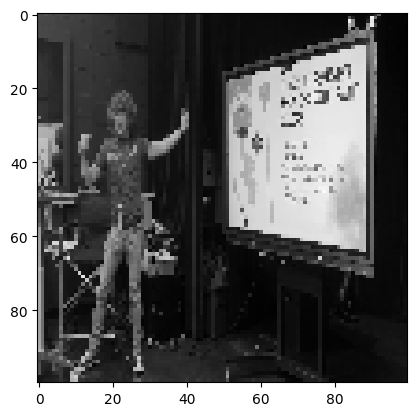

Confidence: [0.96259123]
JERMA LOCATED AT TIMESTAMP: 7710.736366666667


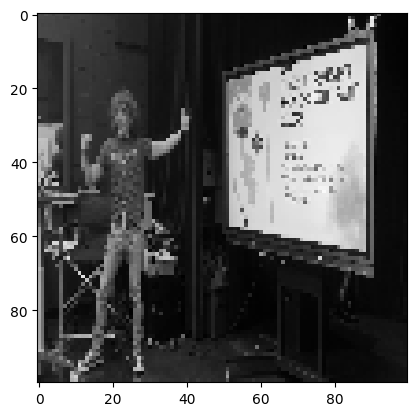

Confidence: [0.95970935]
JERMA LOCATED AT TIMESTAMP: 7710.7697333333335


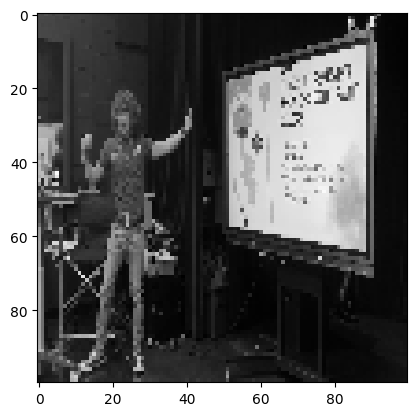

Confidence: [0.95527065]
JERMA LOCATED AT TIMESTAMP: 7710.803099999999


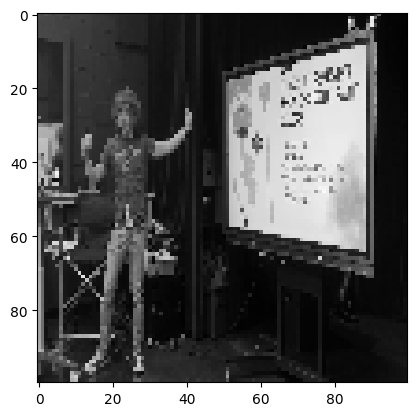

Confidence: [0.9545151]
JERMA LOCATED AT TIMESTAMP: 7710.836466666667


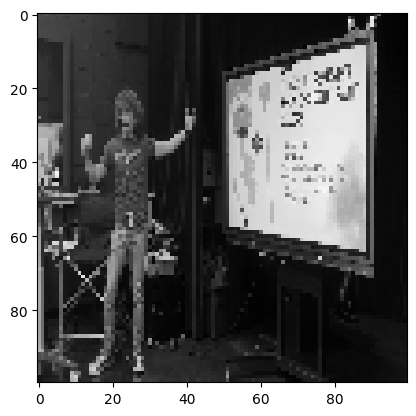

Confidence: [0.9534248]
JERMA LOCATED AT TIMESTAMP: 7710.869833333334


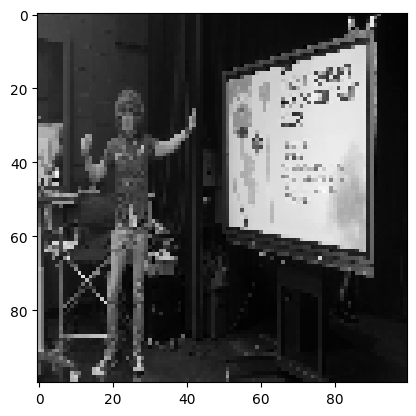

Confidence: [0.9321274]
JERMA LOCATED AT TIMESTAMP: 7710.903200000002


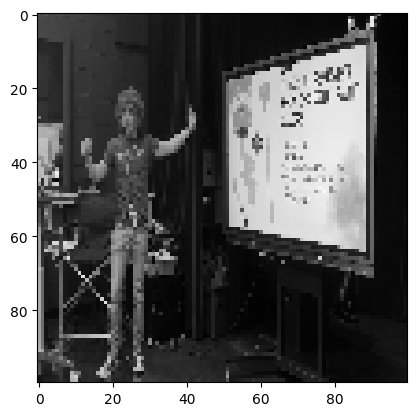

Confidence: [0.9478301]
JERMA LOCATED AT TIMESTAMP: 7710.936566666667


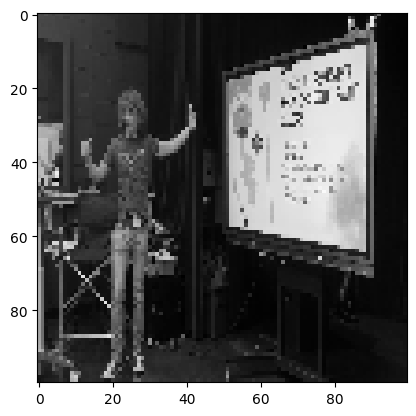

Confidence: [0.95190686]
JERMA LOCATED AT TIMESTAMP: 7710.969933333334


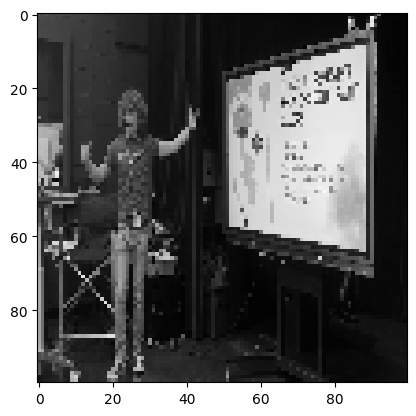

Confidence: [0.9509948]
JERMA LOCATED AT TIMESTAMP: 7711.0033


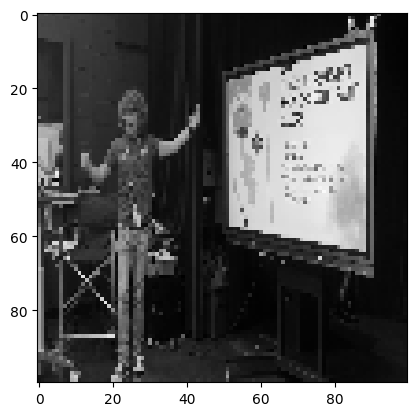

Confidence: [0.95407313]
JERMA LOCATED AT TIMESTAMP: 7711.036666666667


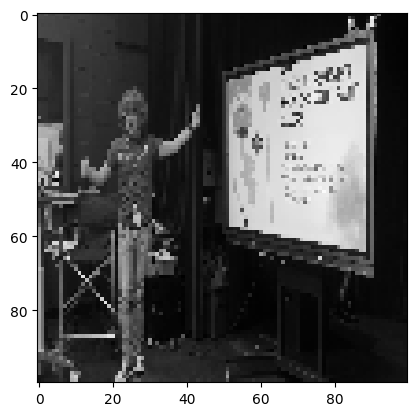

Confidence: [0.96065557]
JERMA LOCATED AT TIMESTAMP: 7711.070033333333


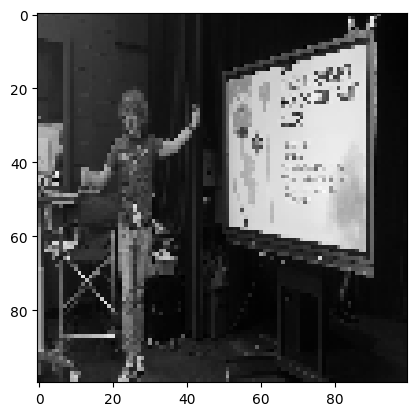

Confidence: [0.9531683]
JERMA LOCATED AT TIMESTAMP: 7711.1034


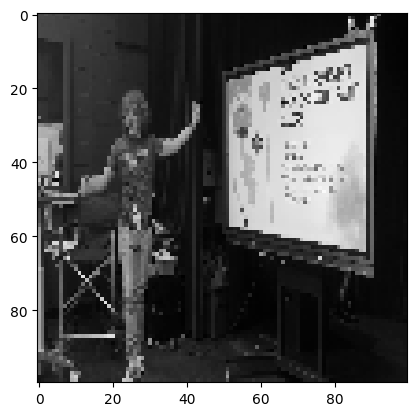

Confidence: [0.9474296]
JERMA LOCATED AT TIMESTAMP: 7711.136766666667


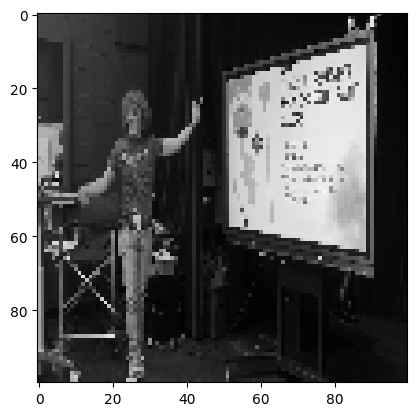

Confidence: [0.9452383]
JERMA LOCATED AT TIMESTAMP: 7711.170133333334


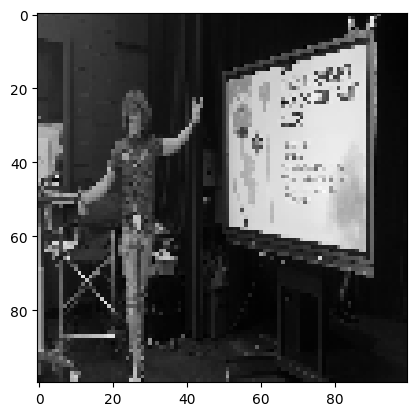

Confidence: [0.9595809]
JERMA LOCATED AT TIMESTAMP: 7711.2035000000005


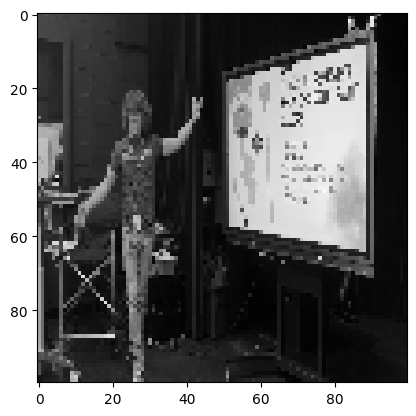

Confidence: [0.9507301]
JERMA LOCATED AT TIMESTAMP: 7711.236866666667


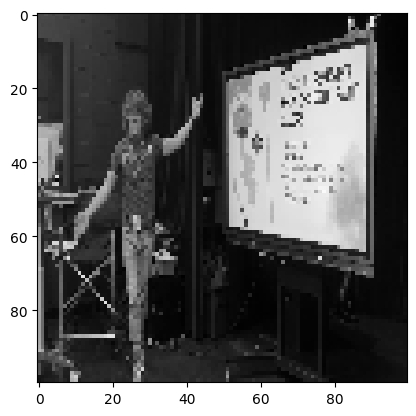

Confidence: [0.9501566]
JERMA LOCATED AT TIMESTAMP: 7711.270233333334


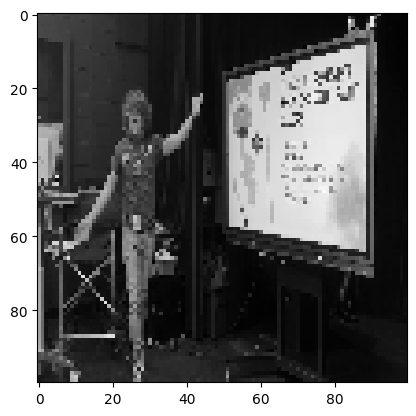

Confidence: [0.96249413]
JERMA LOCATED AT TIMESTAMP: 7711.3036


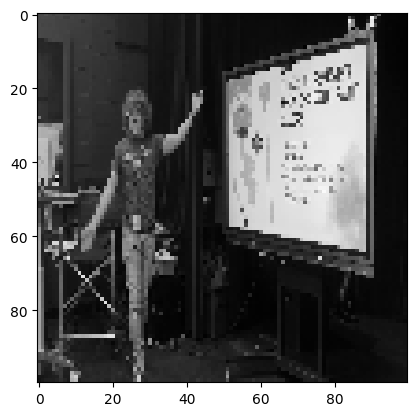

Confidence: [0.9558686]
JERMA LOCATED AT TIMESTAMP: 7711.336966666667


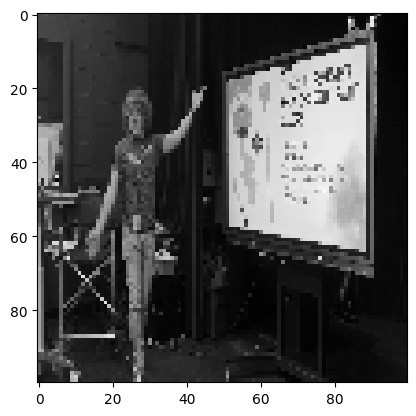

Confidence: [0.95882046]
JERMA LOCATED AT TIMESTAMP: 7711.370333333333


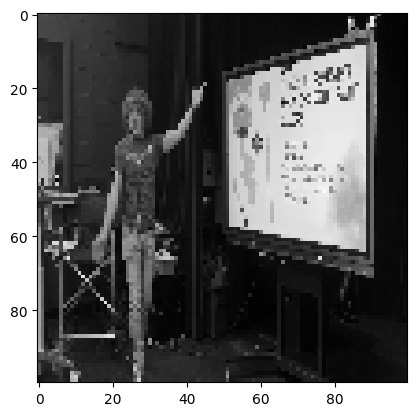

Confidence: [0.9457617]
JERMA LOCATED AT TIMESTAMP: 7711.403700000001


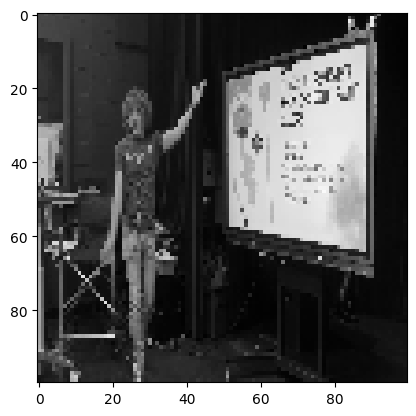

Confidence: [0.9452299]
JERMA LOCATED AT TIMESTAMP: 7711.437066666667


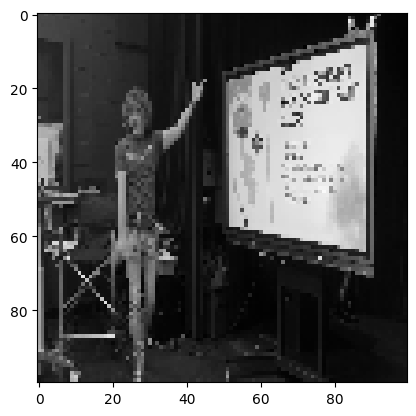

Confidence: [0.9392944]
JERMA LOCATED AT TIMESTAMP: 7711.470433333334


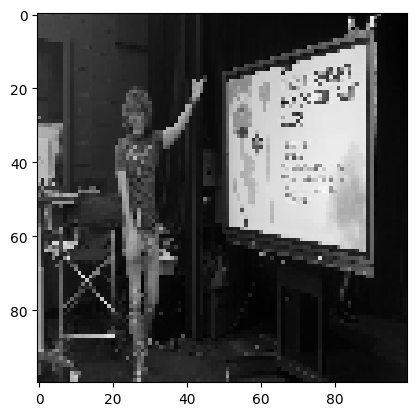

Confidence: [0.94309103]
JERMA LOCATED AT TIMESTAMP: 7711.5038


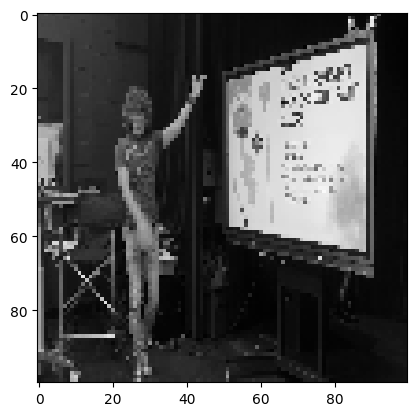

Confidence: [0.93935525]
JERMA LOCATED AT TIMESTAMP: 7711.537166666667


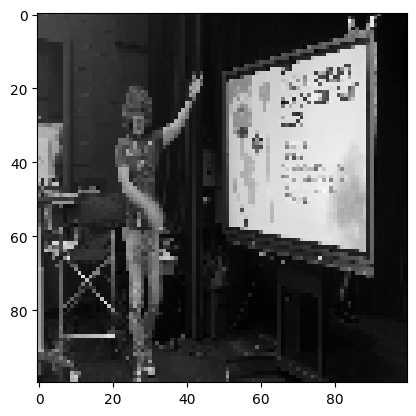

Confidence: [0.94332284]
JERMA LOCATED AT TIMESTAMP: 7711.5705333333335


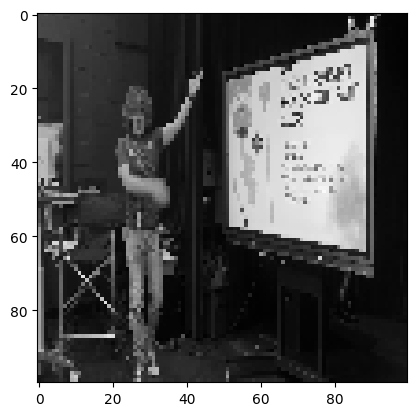

Confidence: [0.93898624]
JERMA LOCATED AT TIMESTAMP: 7711.6039


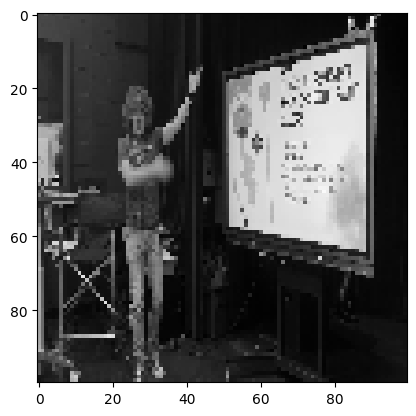

Confidence: [0.92313296]
JERMA LOCATED AT TIMESTAMP: 7711.637266666667


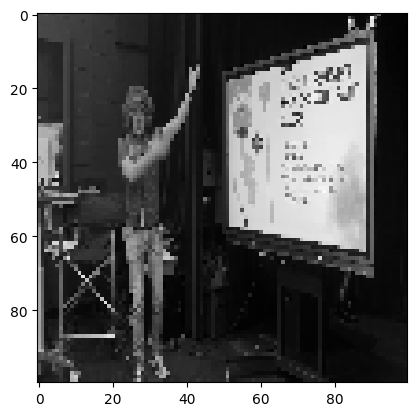

Confidence: [0.925127]
JERMA LOCATED AT TIMESTAMP: 7711.670633333334


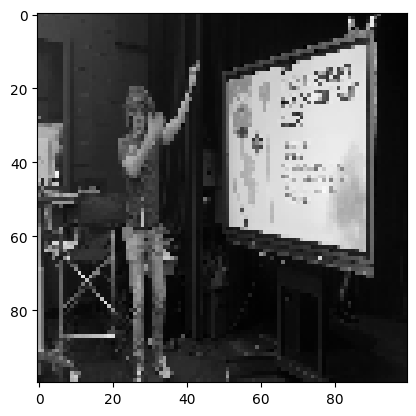

Confidence: [0.92986375]
JERMA LOCATED AT TIMESTAMP: 7711.704000000001


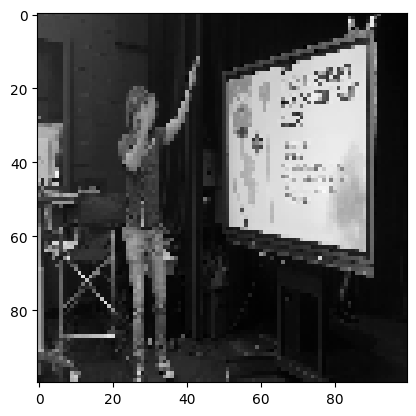

Confidence: [0.9162862]
JERMA LOCATED AT TIMESTAMP: 7711.737366666667


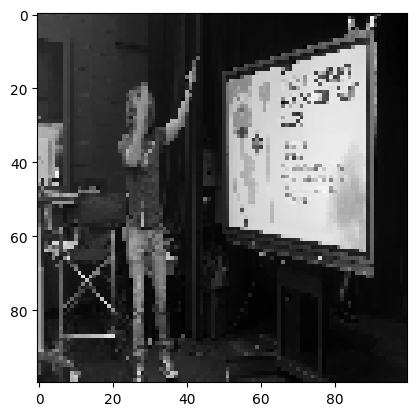

Confidence: [0.9250946]
JERMA LOCATED AT TIMESTAMP: 7711.770733333334


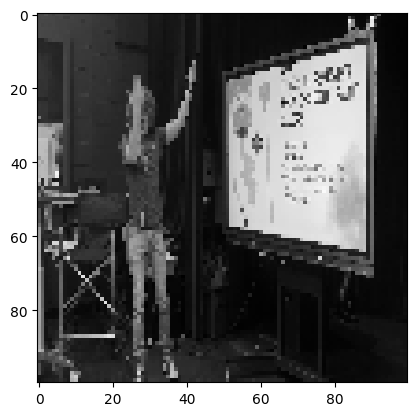

Confidence: [0.9359026]
JERMA LOCATED AT TIMESTAMP: 7711.8041


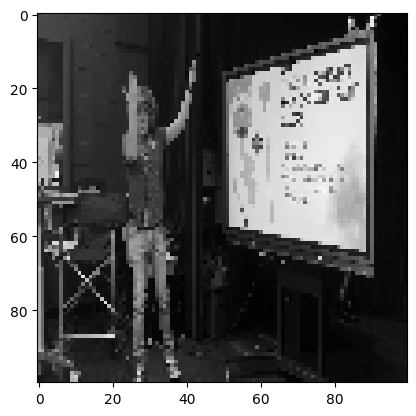

Confidence: [0.9423917]
JERMA LOCATED AT TIMESTAMP: 7711.837466666667


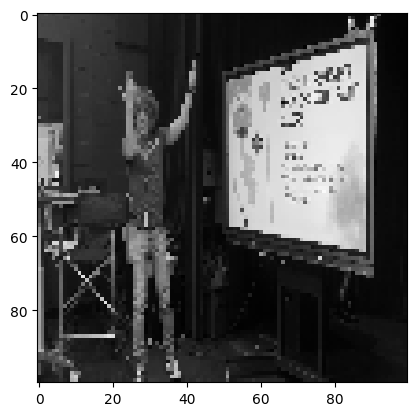

Confidence: [0.9144856]
JERMA LOCATED AT TIMESTAMP: 7711.870833333333


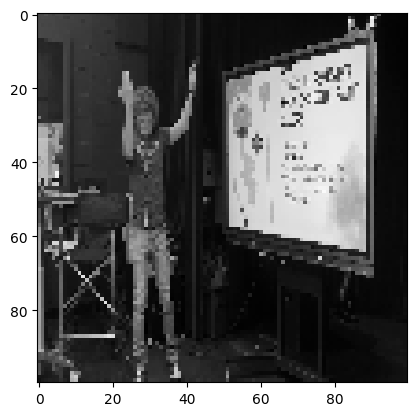

Confidence: [0.9284754]
JERMA LOCATED AT TIMESTAMP: 7711.9042


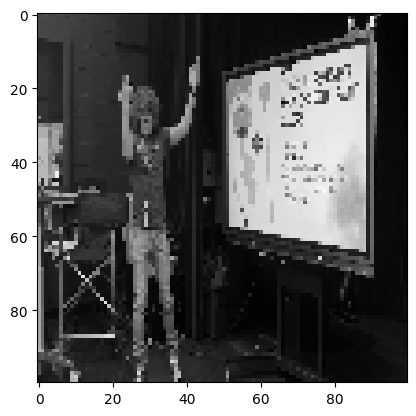

Confidence: [0.9259161]
JERMA LOCATED AT TIMESTAMP: 7711.937566666667


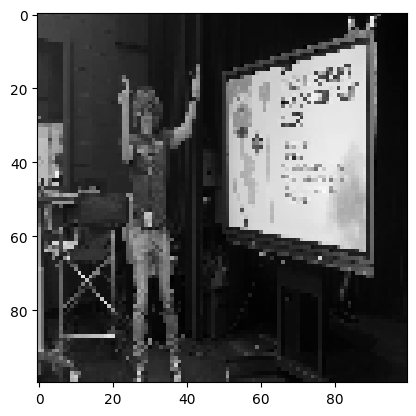

Confidence: [0.9260595]
JERMA LOCATED AT TIMESTAMP: 7711.970933333334


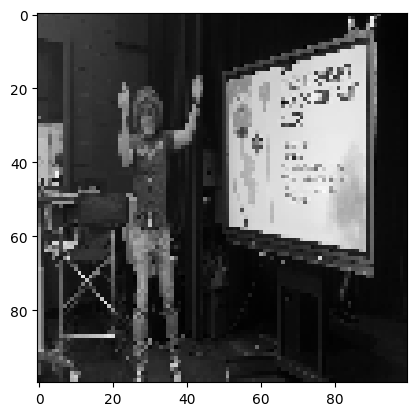

Confidence: [0.92011124]
JERMA LOCATED AT TIMESTAMP: 7712.0043000000005


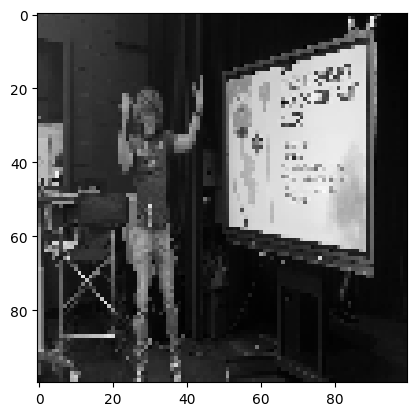

Confidence: [0.9828855]
JERMA LOCATED AT TIMESTAMP: 7733.5258


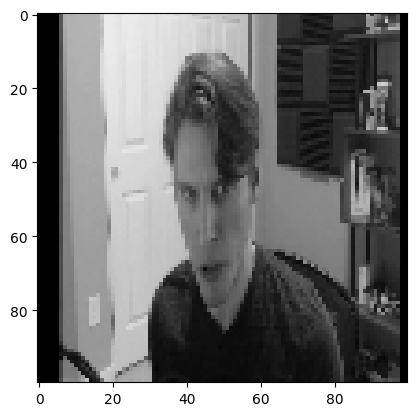

Confidence: [0.9831079]
JERMA LOCATED AT TIMESTAMP: 7733.559166666667


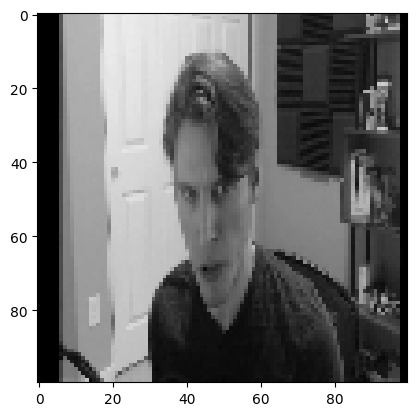

Confidence: [0.9830579]
JERMA LOCATED AT TIMESTAMP: 7733.592533333333


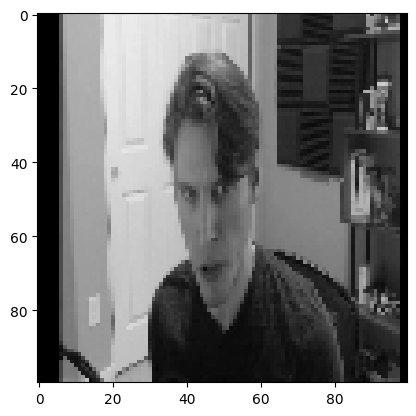

Confidence: [0.98300374]
JERMA LOCATED AT TIMESTAMP: 7733.6259


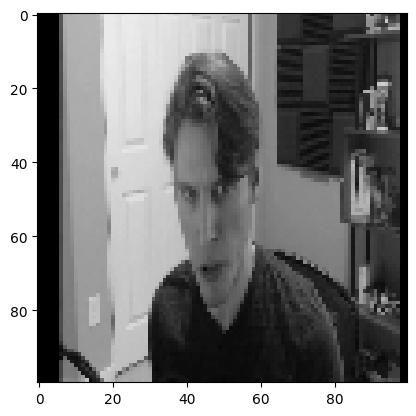

Confidence: [0.9829448]
JERMA LOCATED AT TIMESTAMP: 7733.6592666666675


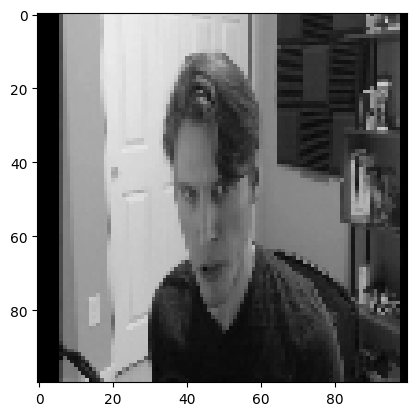

Confidence: [0.9828136]
JERMA LOCATED AT TIMESTAMP: 7733.692633333334


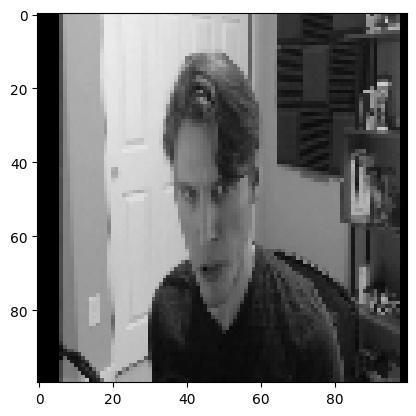

Confidence: [0.9825858]
JERMA LOCATED AT TIMESTAMP: 7733.726000000001


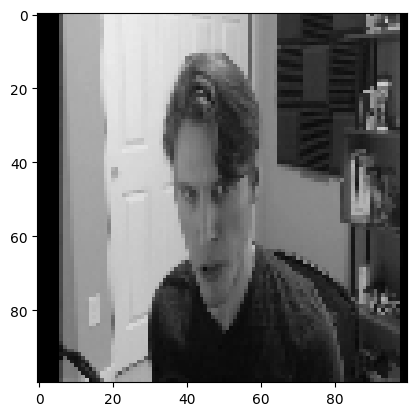

Confidence: [0.9827391]
JERMA LOCATED AT TIMESTAMP: 7733.759366666667


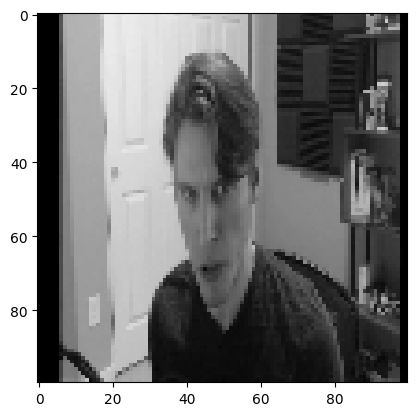

Confidence: [0.9825445]
JERMA LOCATED AT TIMESTAMP: 7733.792733333334


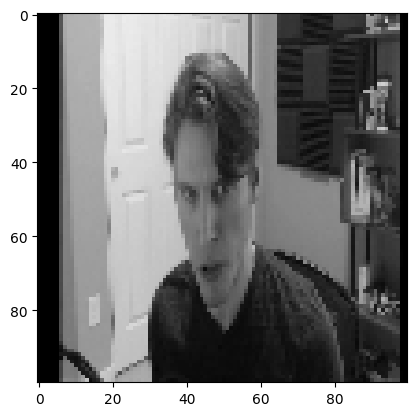

Confidence: [0.9825799]
JERMA LOCATED AT TIMESTAMP: 7733.8261


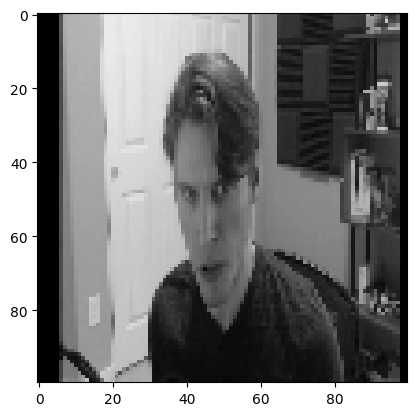

Confidence: [0.98257935]
JERMA LOCATED AT TIMESTAMP: 7733.859466666667


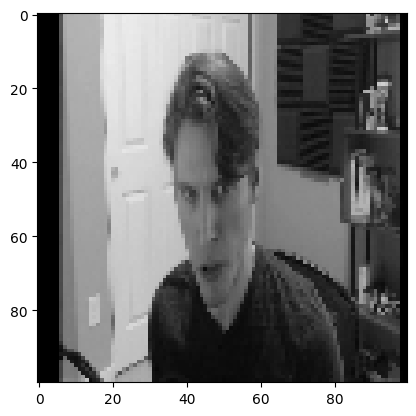

Confidence: [0.9003852]
JERMA LOCATED AT TIMESTAMP: 7736.1284000000005


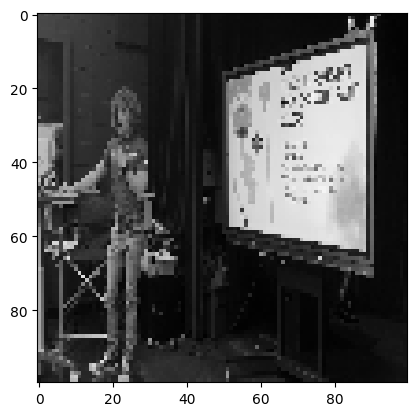

Confidence: [0.9646356]
JERMA LOCATED AT TIMESTAMP: 7750.943200000001


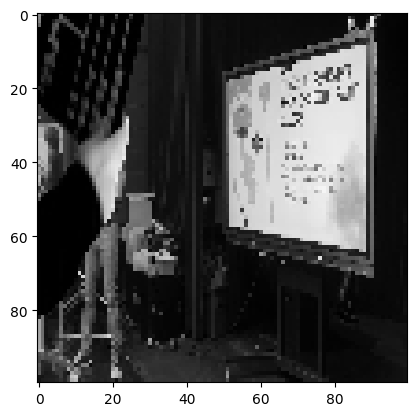

Confidence: [0.9726069]
JERMA LOCATED AT TIMESTAMP: 7750.976566666667


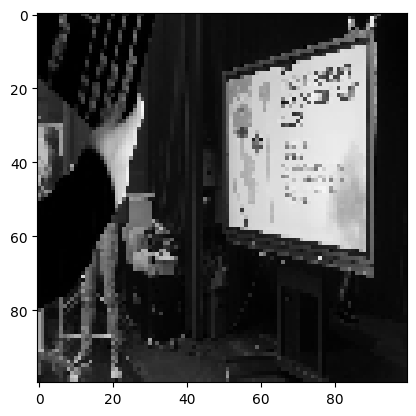

Confidence: [0.9763081]
JERMA LOCATED AT TIMESTAMP: 7751.009933333334


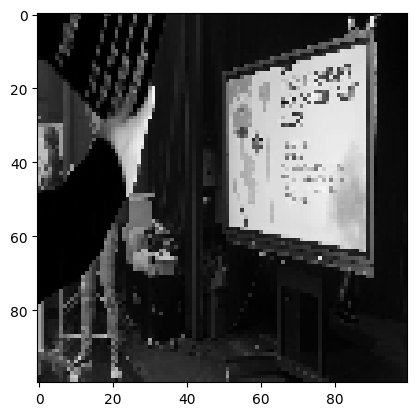

Confidence: [0.9791571]
JERMA LOCATED AT TIMESTAMP: 7751.043299999999


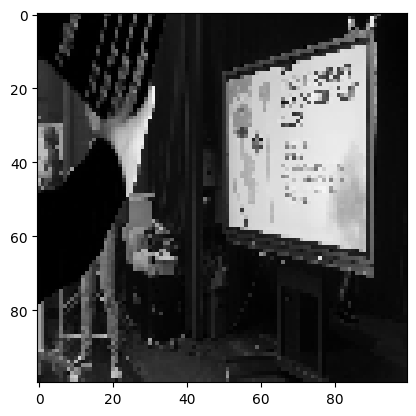

Confidence: [0.97907937]
JERMA LOCATED AT TIMESTAMP: 7751.076666666667


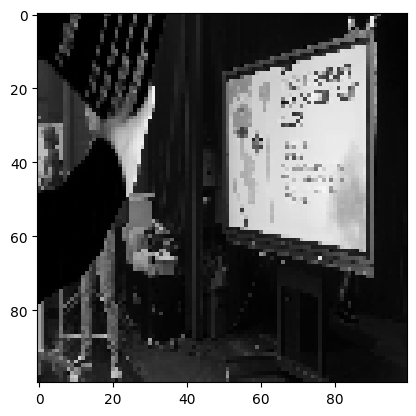

Confidence: [0.96687394]
JERMA LOCATED AT TIMESTAMP: 7751.110033333333


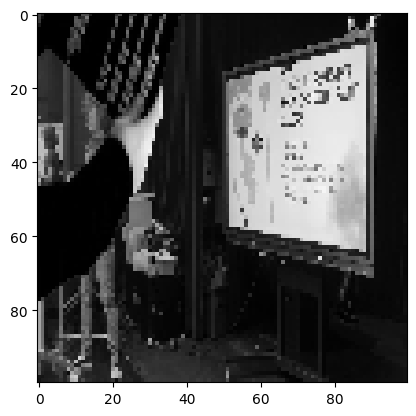

Confidence: [0.9728812]
JERMA LOCATED AT TIMESTAMP: 7751.1434


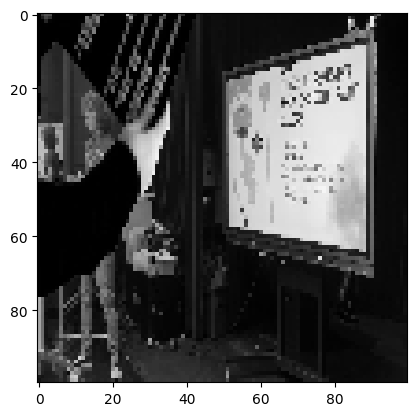

Confidence: [0.952289]
JERMA LOCATED AT TIMESTAMP: 7751.176766666667


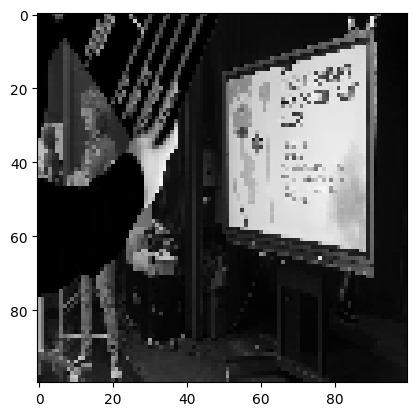

Confidence: [0.9336003]
JERMA LOCATED AT TIMESTAMP: 7751.210133333334


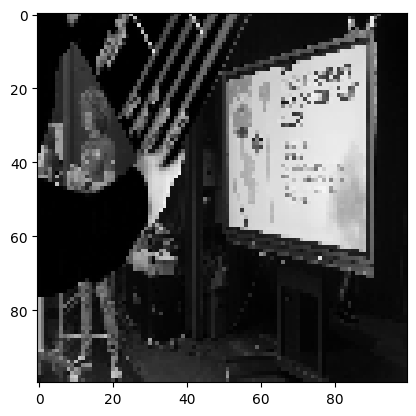

Confidence: [0.9680089]
JERMA LOCATED AT TIMESTAMP: 7751.2435000000005


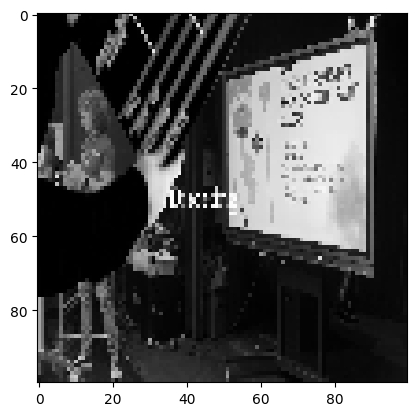

Confidence: [0.94939333]
JERMA LOCATED AT TIMESTAMP: 7751.276866666667


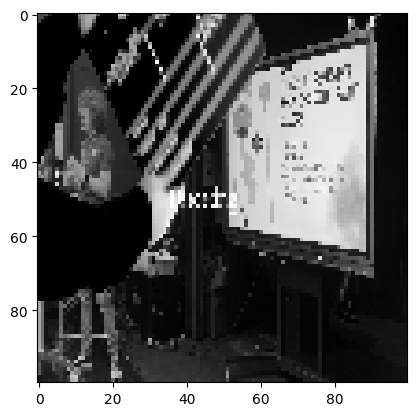

Confidence: [0.9491769]
JERMA LOCATED AT TIMESTAMP: 7751.310233333334


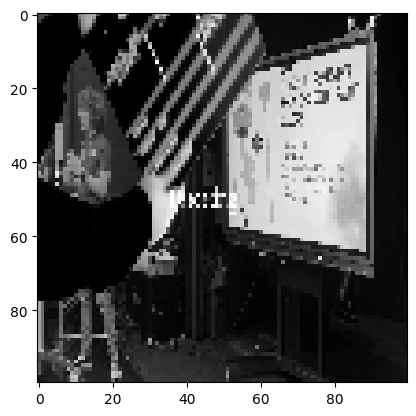

Confidence: [0.9994474]
JERMA LOCATED AT TIMESTAMP: 7751.5438


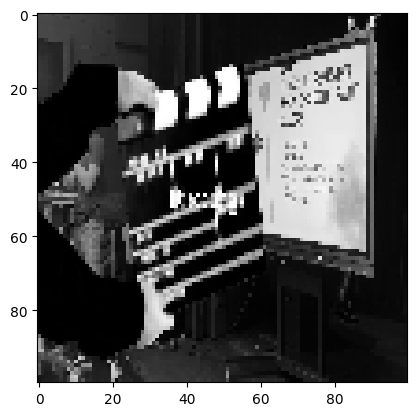

Confidence: [0.9994253]
JERMA LOCATED AT TIMESTAMP: 7751.577166666667


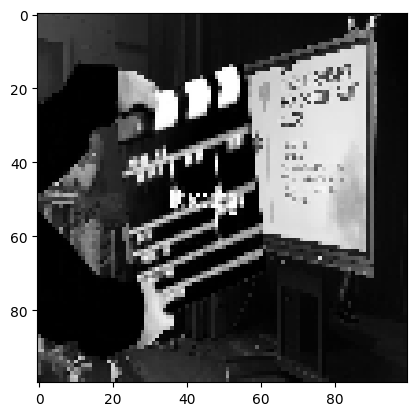

Confidence: [0.909177]
JERMA LOCATED AT TIMESTAMP: 7753.011933333334


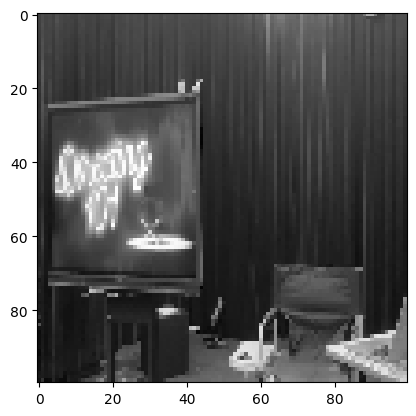

Confidence: [0.92529213]
JERMA LOCATED AT TIMESTAMP: 7753.045300000001


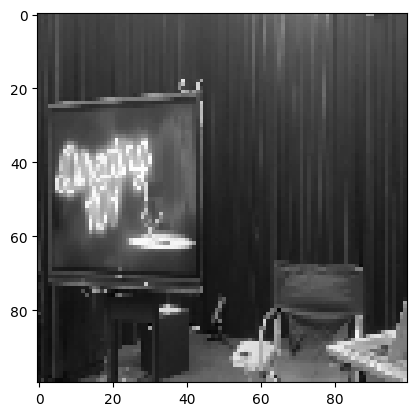

Confidence: [0.9527501]
JERMA LOCATED AT TIMESTAMP: 7753.112033333334


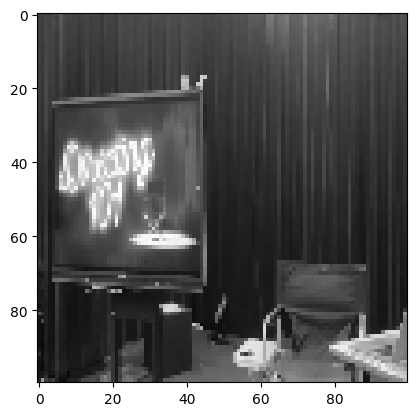

Confidence: [0.9526146]
JERMA LOCATED AT TIMESTAMP: 7753.1454


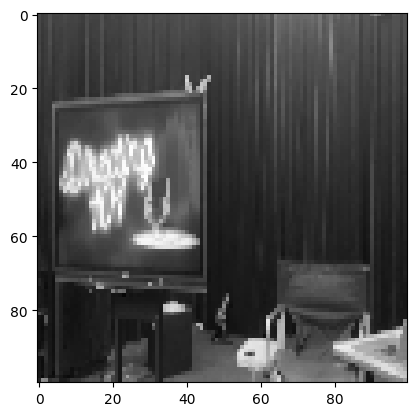

Confidence: [0.96329725]
JERMA LOCATED AT TIMESTAMP: 7753.178766666667


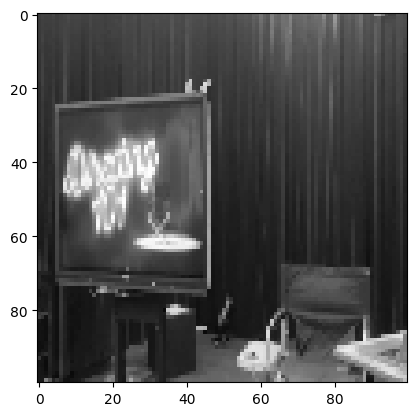

Confidence: [0.9784799]
JERMA LOCATED AT TIMESTAMP: 7753.212133333333


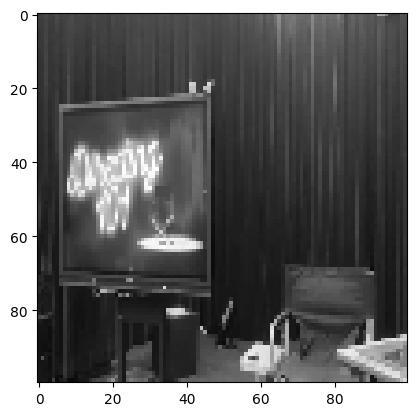

Confidence: [0.908126]
JERMA LOCATED AT TIMESTAMP: 7753.2455


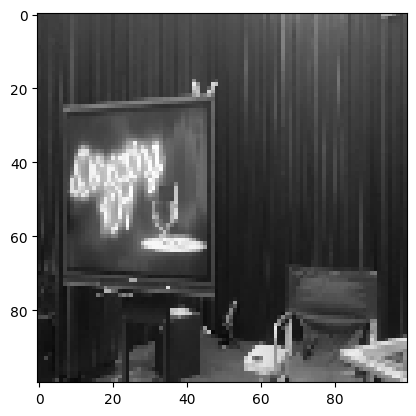

Confidence: [0.93329805]
JERMA LOCATED AT TIMESTAMP: 7753.278866666667


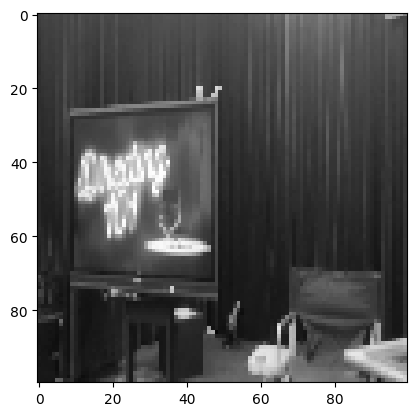

Confidence: [0.97760314]
JERMA LOCATED AT TIMESTAMP: 7753.312233333334


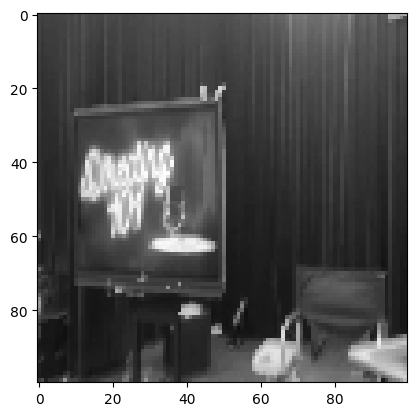

Confidence: [0.9775628]
JERMA LOCATED AT TIMESTAMP: 7753.345600000001


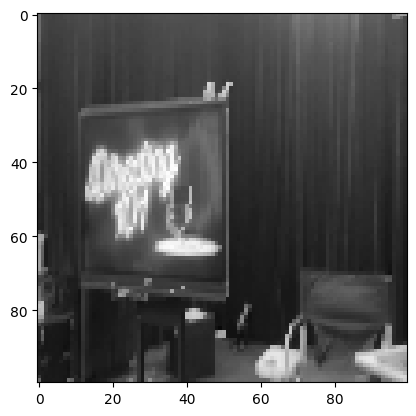

Confidence: [0.9357041]
JERMA LOCATED AT TIMESTAMP: 7753.378966666667


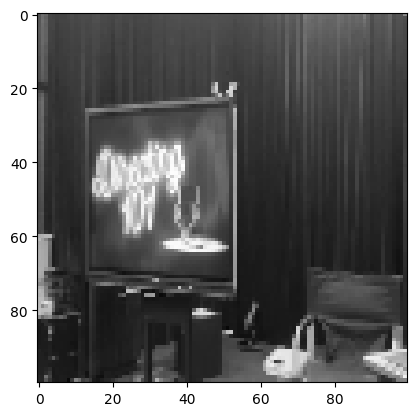

Confidence: [0.97783047]
JERMA LOCATED AT TIMESTAMP: 7753.412333333334


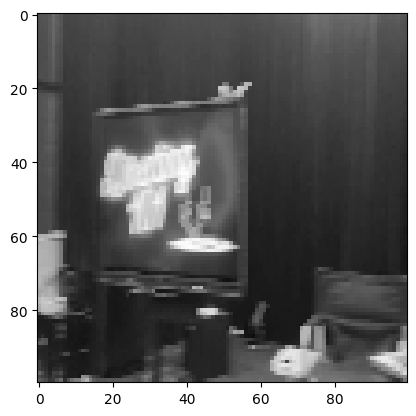

Confidence: [0.98109573]
JERMA LOCATED AT TIMESTAMP: 7753.4457


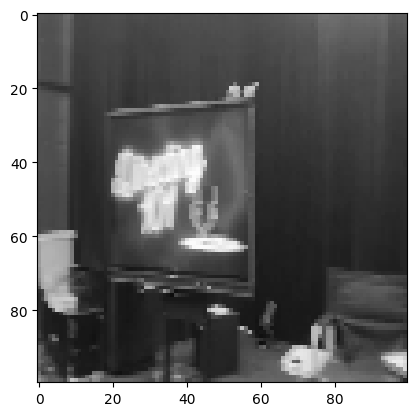

Confidence: [0.9766064]
JERMA LOCATED AT TIMESTAMP: 7753.479066666667


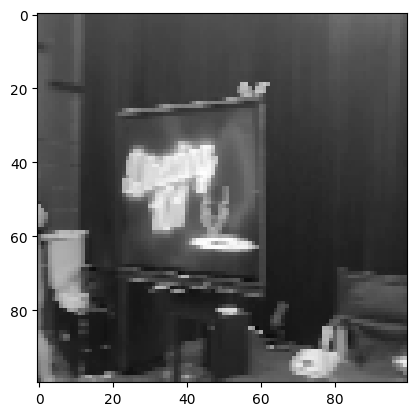

Confidence: [0.9671059]
JERMA LOCATED AT TIMESTAMP: 7753.512433333333


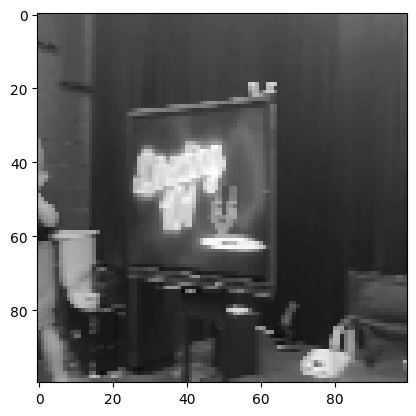

Confidence: [0.95629096]
JERMA LOCATED AT TIMESTAMP: 7753.545800000001


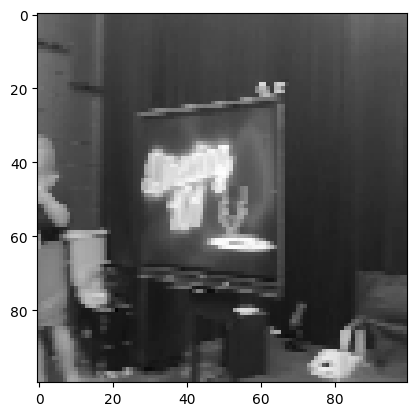

Confidence: [0.9515146]
JERMA LOCATED AT TIMESTAMP: 7753.579166666667


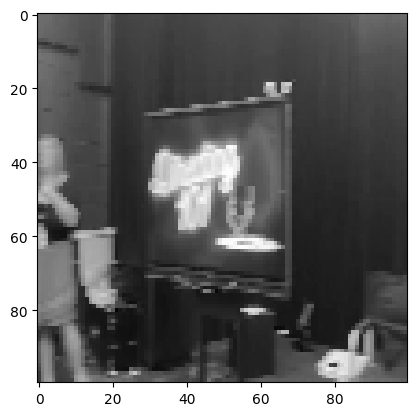

Confidence: [0.9201692]
JERMA LOCATED AT TIMESTAMP: 7753.612533333334


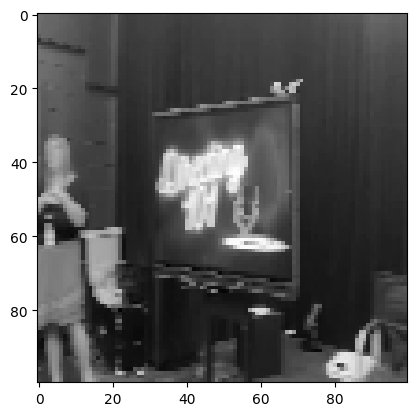

Confidence: [0.91659945]
JERMA LOCATED AT TIMESTAMP: 7753.6459


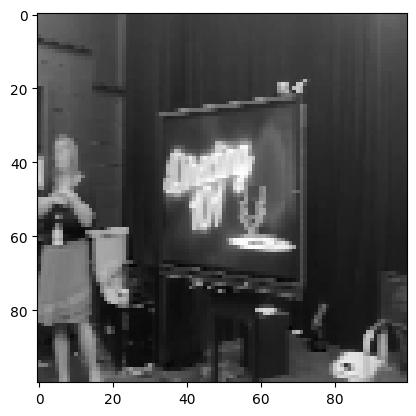

Confidence: [0.92003775]
JERMA LOCATED AT TIMESTAMP: 7753.679266666667


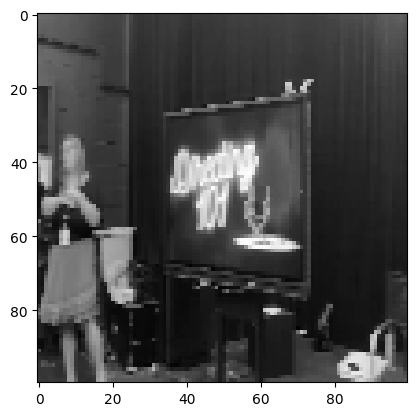

Confidence: [0.9292026]
JERMA LOCATED AT TIMESTAMP: 7753.7126333333335


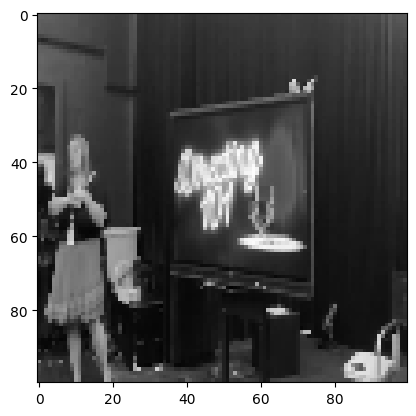

Confidence: [0.9402747]
JERMA LOCATED AT TIMESTAMP: 7753.779366666667


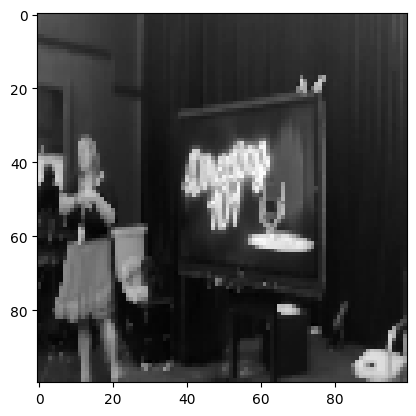

Confidence: [0.96795535]
JERMA LOCATED AT TIMESTAMP: 7753.812733333334


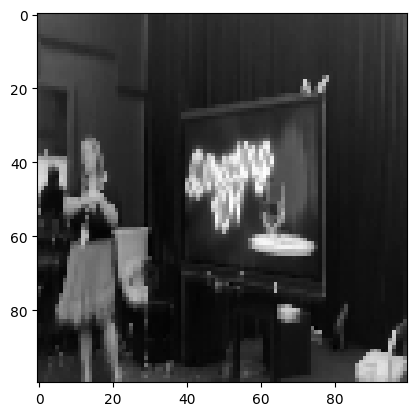

Confidence: [0.9001977]
JERMA LOCATED AT TIMESTAMP: 7754.012933333333


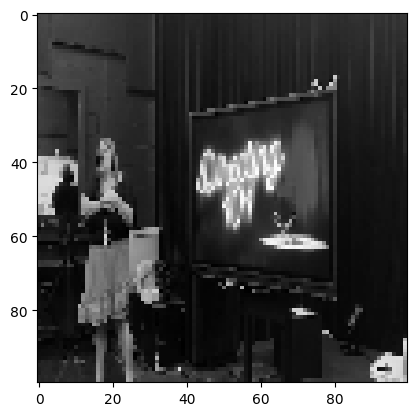

Confidence: [0.94338346]
JERMA LOCATED AT TIMESTAMP: 7754.0463


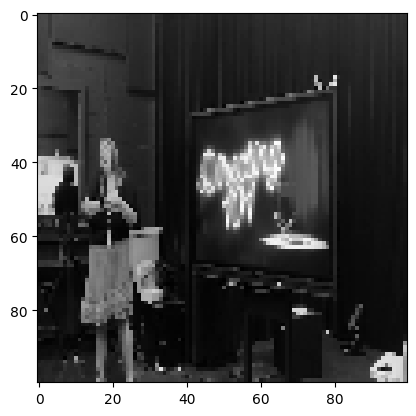

Confidence: [0.9218593]
JERMA LOCATED AT TIMESTAMP: 7754.113033333334


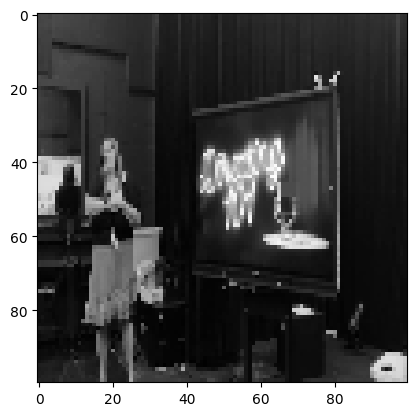

Confidence: [0.9261237]
JERMA LOCATED AT TIMESTAMP: 7754.1464000000005


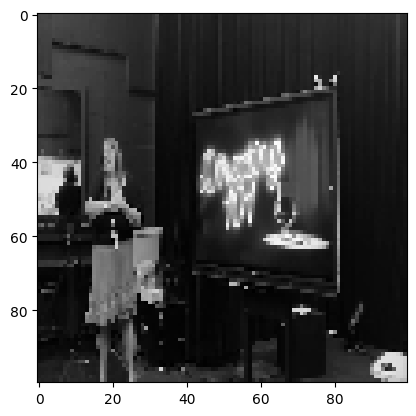

Confidence: [0.9146046]
JERMA LOCATED AT TIMESTAMP: 7754.213133333334


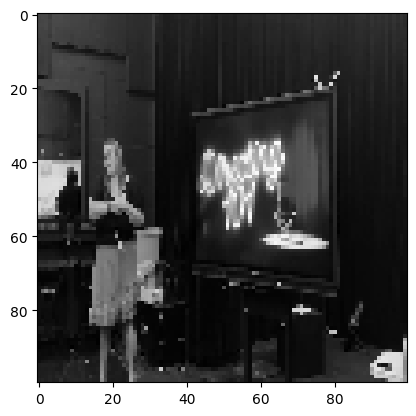

Confidence: [0.91222036]
JERMA LOCATED AT TIMESTAMP: 7754.2465


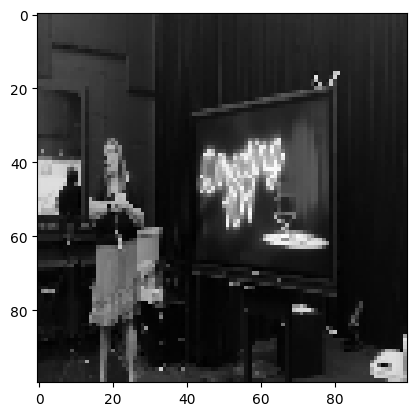

Confidence: [0.96958566]
JERMA LOCATED AT TIMESTAMP: 7754.279866666667


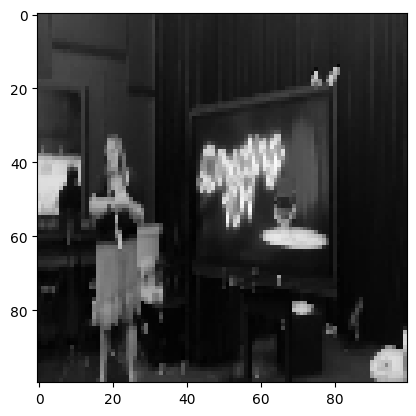

Confidence: [0.95050925]
JERMA LOCATED AT TIMESTAMP: 7754.313233333333


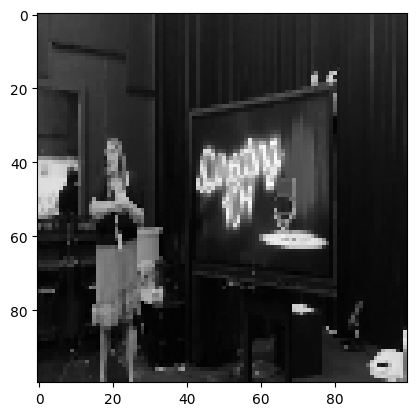

Confidence: [0.9443707]
JERMA LOCATED AT TIMESTAMP: 7754.346600000001


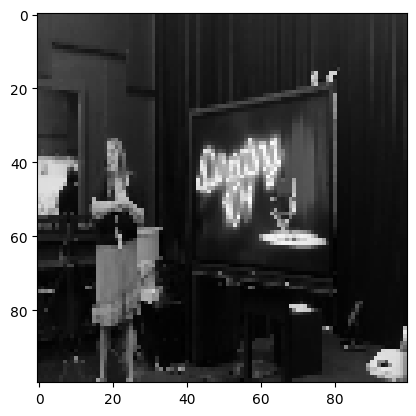

Confidence: [0.94182855]
JERMA LOCATED AT TIMESTAMP: 7754.4467


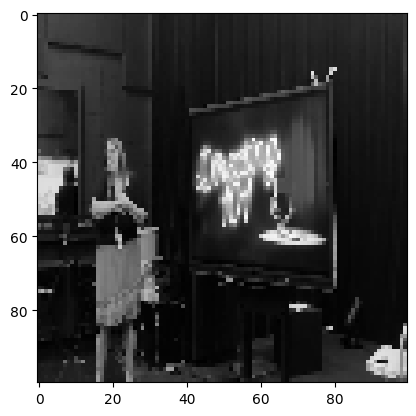

Confidence: [0.9409835]
JERMA LOCATED AT TIMESTAMP: 7754.480066666667


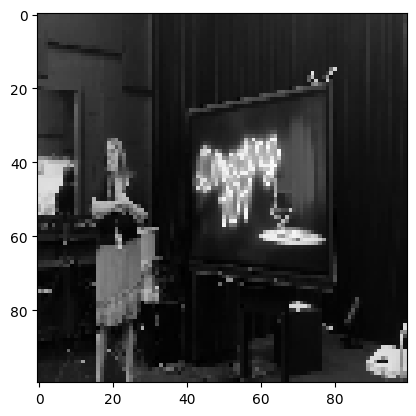

Confidence: [0.9111095]
JERMA LOCATED AT TIMESTAMP: 7754.5134333333335


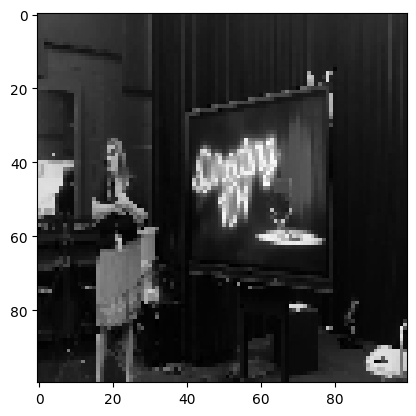

Confidence: [0.914825]
JERMA LOCATED AT TIMESTAMP: 7754.5468


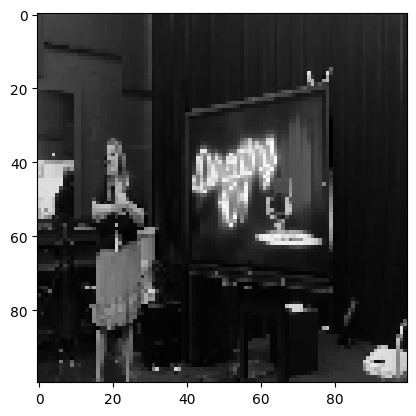

Confidence: [0.9354917]
JERMA LOCATED AT TIMESTAMP: 7754.580166666667


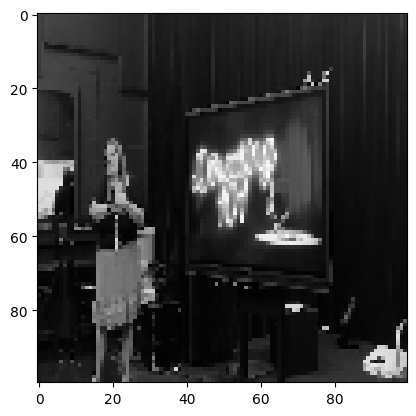

Confidence: [0.96530926]
JERMA LOCATED AT TIMESTAMP: 7754.613533333334


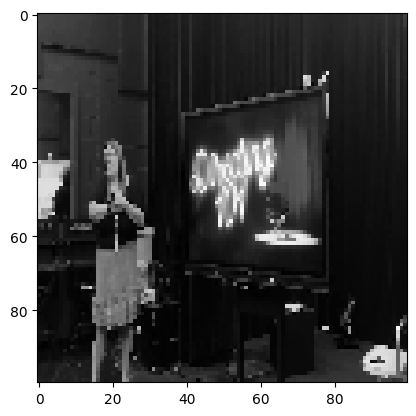

Confidence: [0.9592353]
JERMA LOCATED AT TIMESTAMP: 7754.646900000001


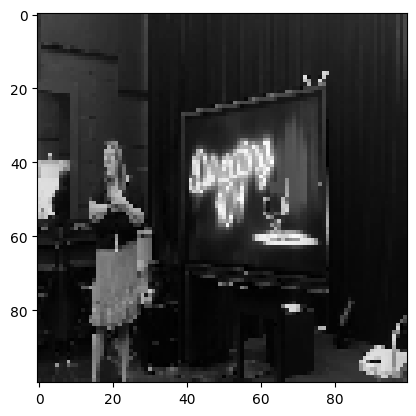

Confidence: [0.9497749]
JERMA LOCATED AT TIMESTAMP: 7754.680266666667


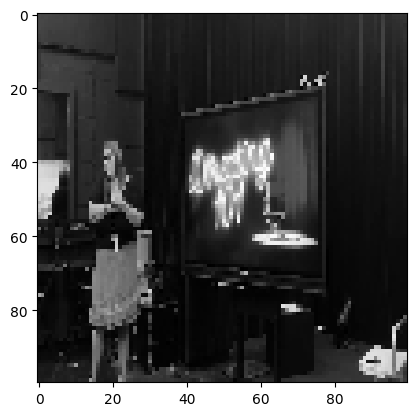

Confidence: [0.9652025]
JERMA LOCATED AT TIMESTAMP: 7754.713633333334


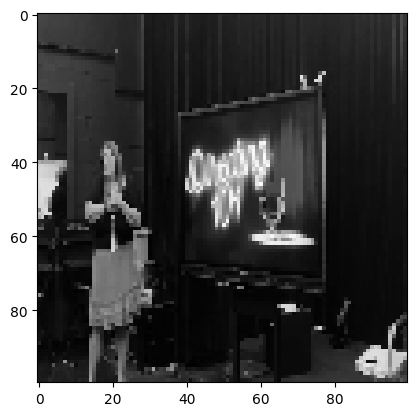

Confidence: [0.9699032]
JERMA LOCATED AT TIMESTAMP: 7754.747


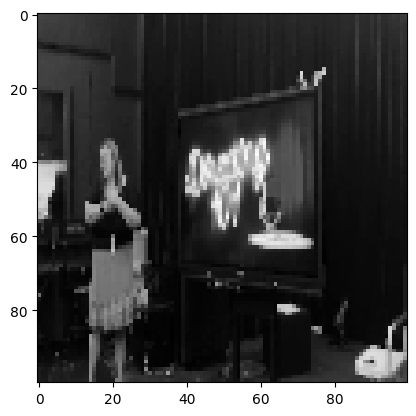

Confidence: [0.98841375]
JERMA LOCATED AT TIMESTAMP: 7754.780366666667


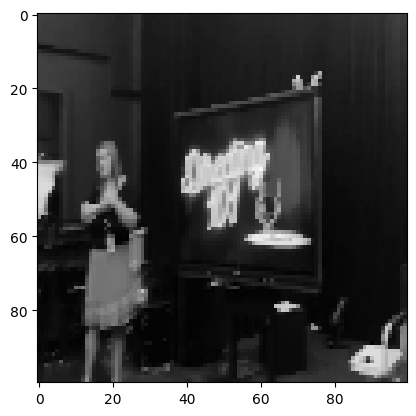

Confidence: [0.98481256]
JERMA LOCATED AT TIMESTAMP: 7754.813733333333


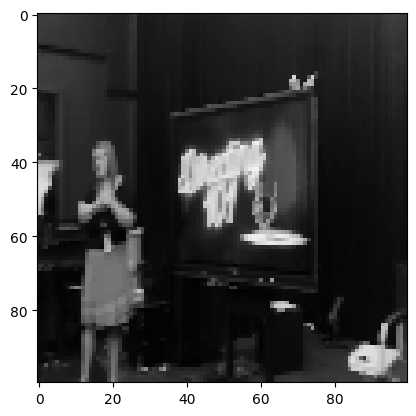

Confidence: [0.9702022]
JERMA LOCATED AT TIMESTAMP: 7754.8471


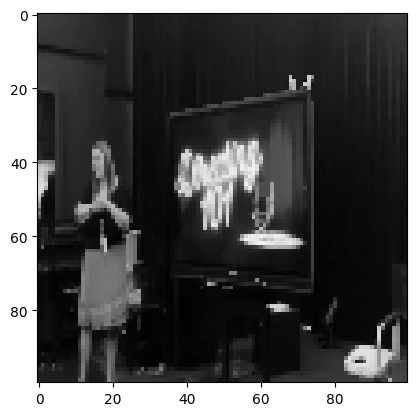

Confidence: [0.9788083]
JERMA LOCATED AT TIMESTAMP: 7754.880466666667


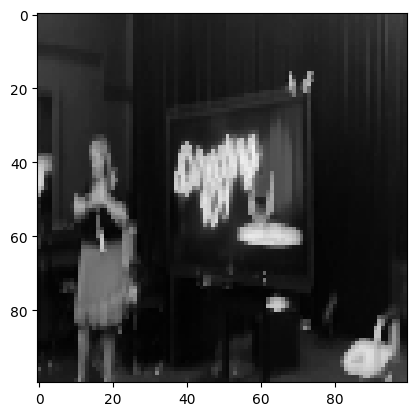

Confidence: [0.983573]
JERMA LOCATED AT TIMESTAMP: 7754.913833333334


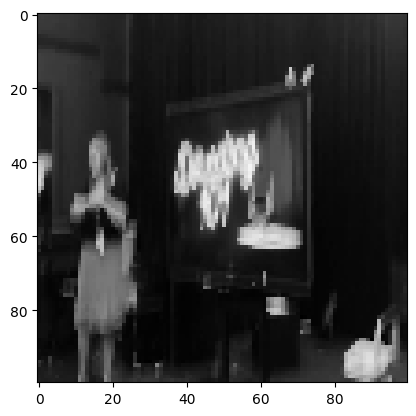

Confidence: [0.96776795]
JERMA LOCATED AT TIMESTAMP: 7754.9472000000005


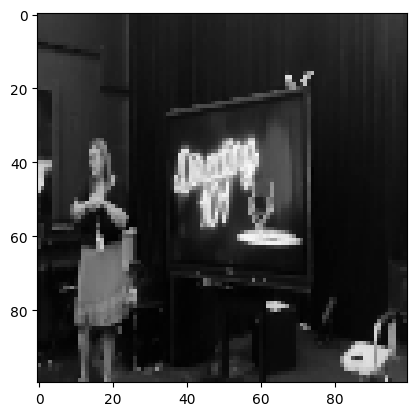

Confidence: [0.94958735]
JERMA LOCATED AT TIMESTAMP: 7754.980566666667


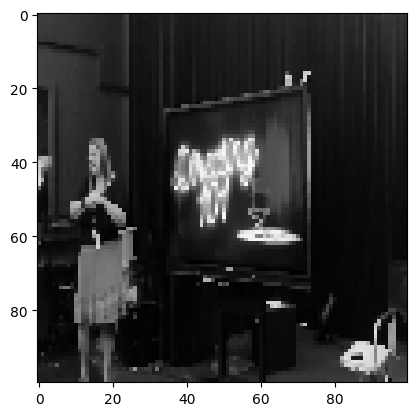

Confidence: [0.9508053]
JERMA LOCATED AT TIMESTAMP: 7755.013933333334


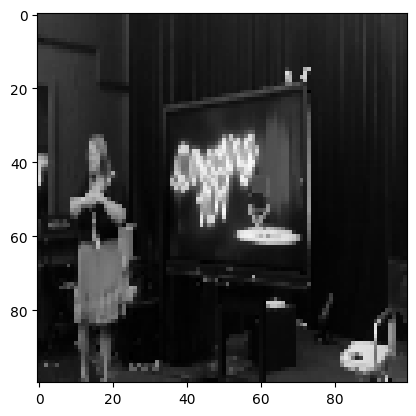

Confidence: [0.91965437]
JERMA LOCATED AT TIMESTAMP: 7755.0473


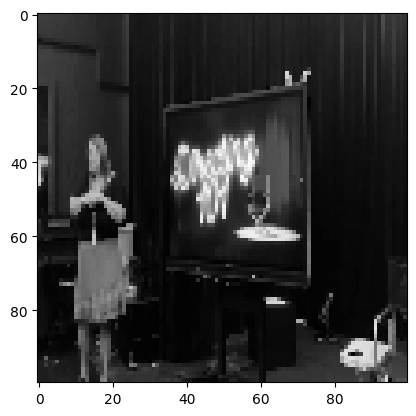

Confidence: [0.9244309]
JERMA LOCATED AT TIMESTAMP: 7755.080666666667


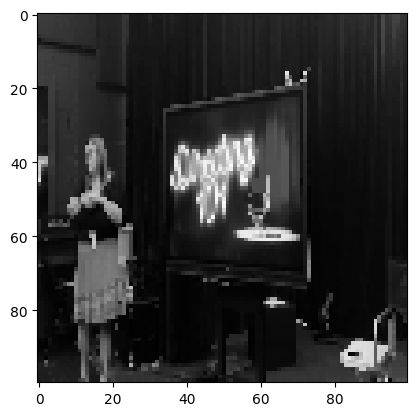

Confidence: [0.9190921]
JERMA LOCATED AT TIMESTAMP: 7755.114033333333


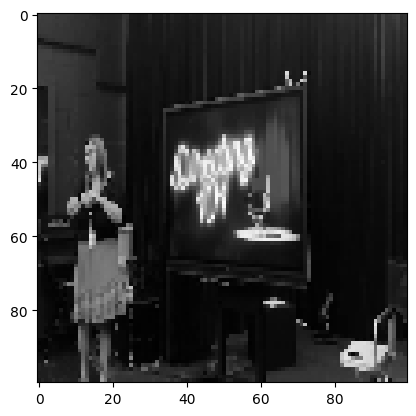

Confidence: [0.9091309]
JERMA LOCATED AT TIMESTAMP: 7755.147400000001


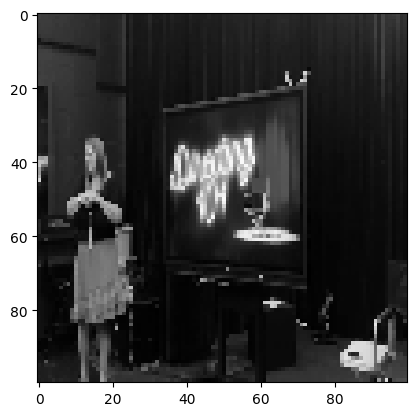

Confidence: [0.9448778]
JERMA LOCATED AT TIMESTAMP: 7755.2475


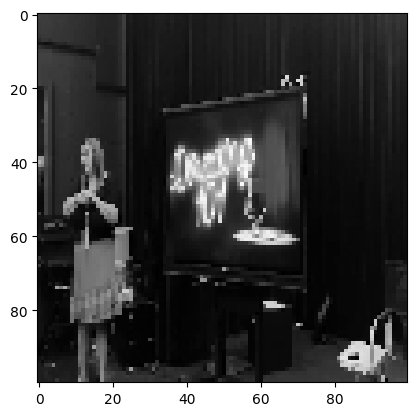

Confidence: [0.93627447]
JERMA LOCATED AT TIMESTAMP: 7755.280866666667


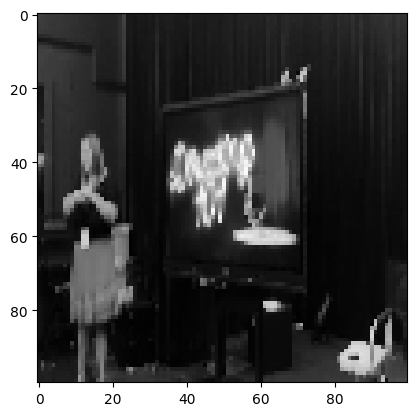

Confidence: [0.95818174]
JERMA LOCATED AT TIMESTAMP: 7755.3142333333335


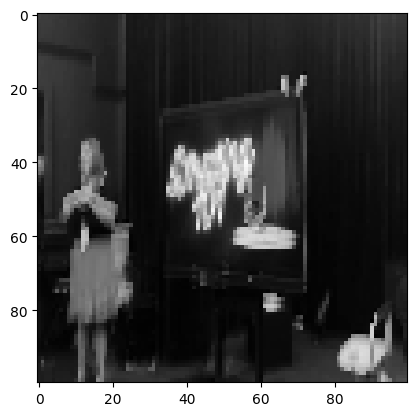

Confidence: [0.9320696]
JERMA LOCATED AT TIMESTAMP: 7755.3476


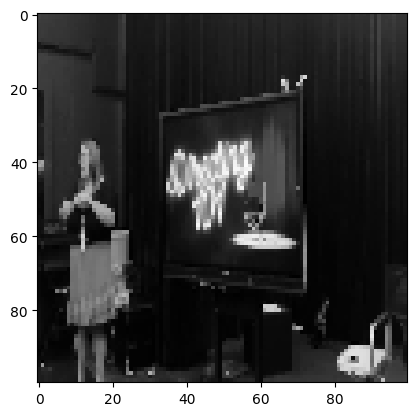

Confidence: [0.94619596]
JERMA LOCATED AT TIMESTAMP: 7755.380966666667


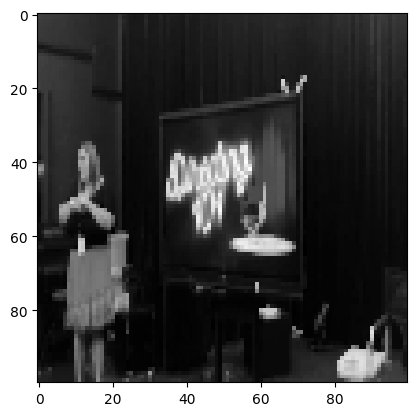

Confidence: [0.9354729]
JERMA LOCATED AT TIMESTAMP: 7755.414333333334


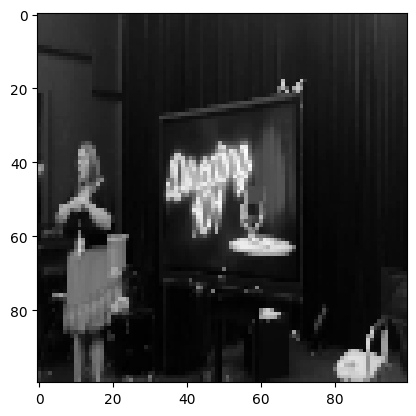

Confidence: [0.94368494]
JERMA LOCATED AT TIMESTAMP: 7755.447700000001


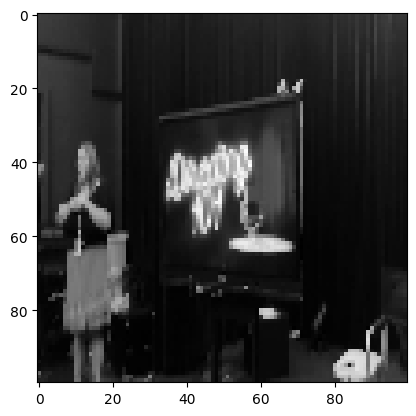

Confidence: [0.968579]
JERMA LOCATED AT TIMESTAMP: 7755.481066666667


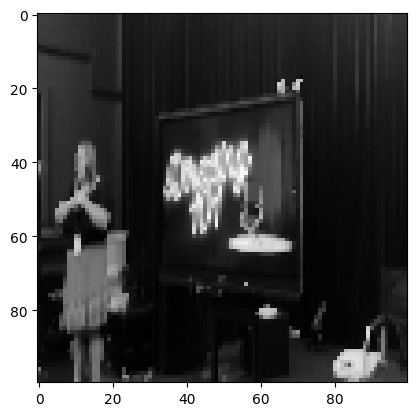

Confidence: [0.94587606]
JERMA LOCATED AT TIMESTAMP: 7755.514433333334


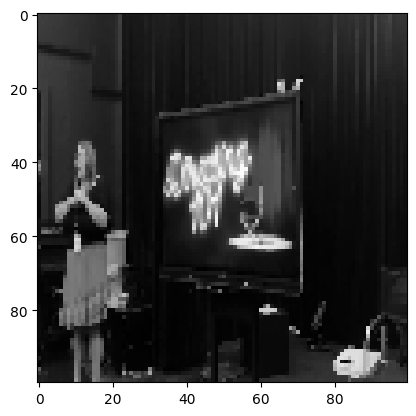

Confidence: [0.9274369]
JERMA LOCATED AT TIMESTAMP: 7755.581166666667


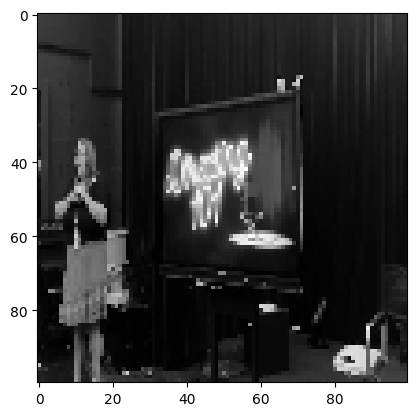

Confidence: [0.9294948]
JERMA LOCATED AT TIMESTAMP: 7755.614533333333


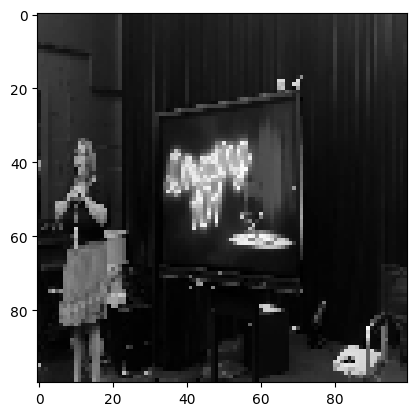

Confidence: [0.9160848]
JERMA LOCATED AT TIMESTAMP: 7755.781366666667


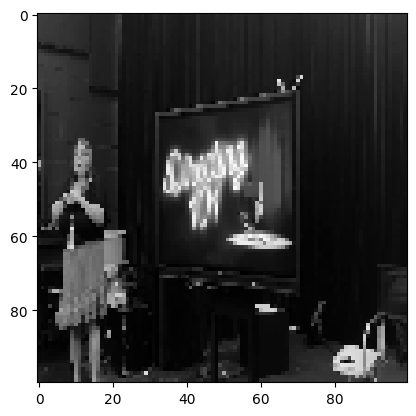

Confidence: [0.9065629]
JERMA LOCATED AT TIMESTAMP: 7755.814733333334


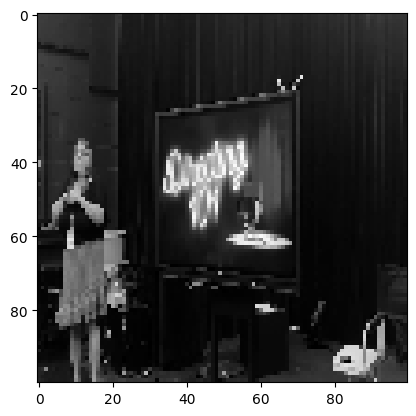

Confidence: [0.9144659]
JERMA LOCATED AT TIMESTAMP: 7755.8481


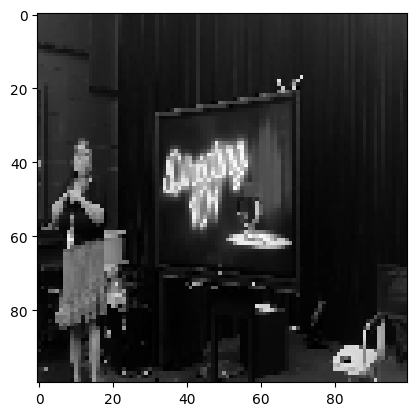

Confidence: [0.92260927]
JERMA LOCATED AT TIMESTAMP: 7755.881466666667


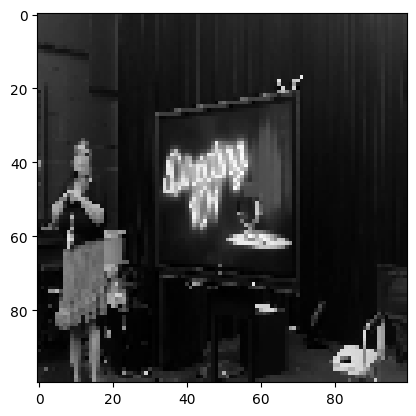

Confidence: [0.90246665]
JERMA LOCATED AT TIMESTAMP: 7755.914833333333


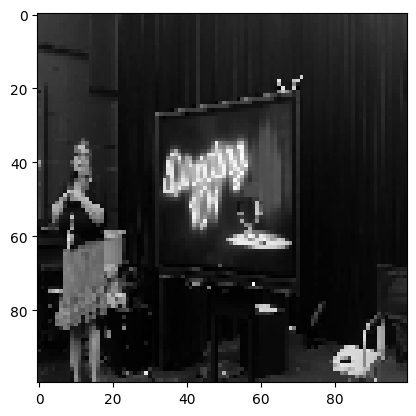

Confidence: [0.90295607]
JERMA LOCATED AT TIMESTAMP: 7755.948200000001


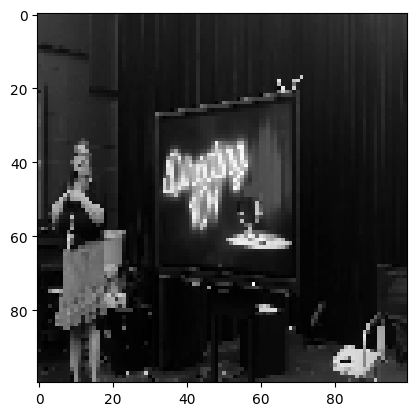

Confidence: [0.9334904]
JERMA LOCATED AT TIMESTAMP: 7756.1150333333335


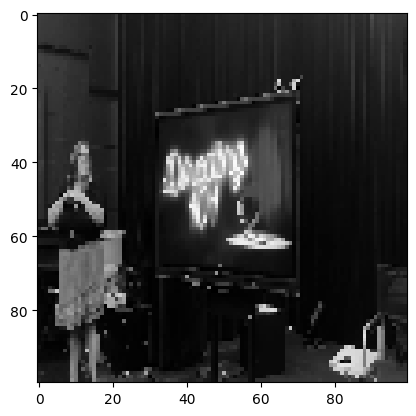

Confidence: [0.9496917]
JERMA LOCATED AT TIMESTAMP: 7756.1484


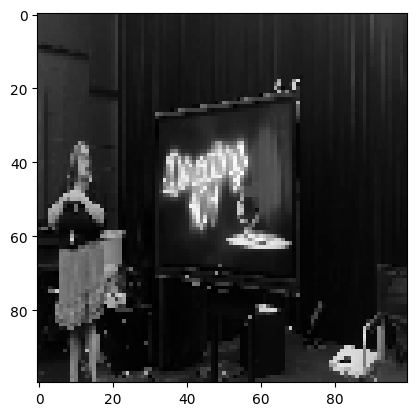

Confidence: [0.9645116]
JERMA LOCATED AT TIMESTAMP: 7756.181766666667


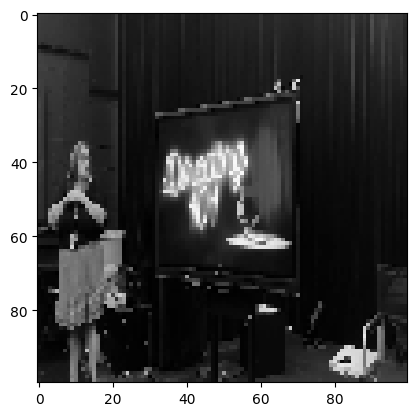

Confidence: [0.9415414]
JERMA LOCATED AT TIMESTAMP: 7756.215133333334


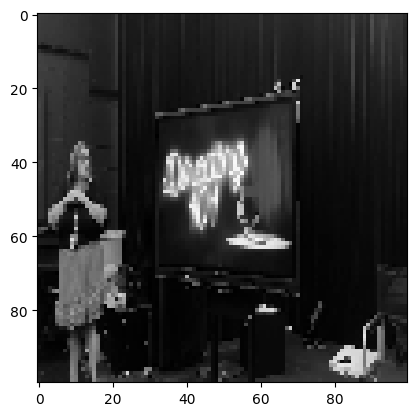

Confidence: [0.93255633]
JERMA LOCATED AT TIMESTAMP: 7756.248500000001


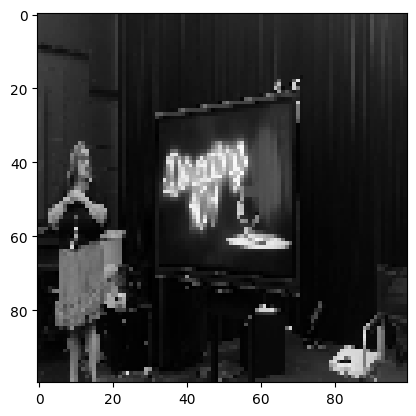

Confidence: [0.9269431]
JERMA LOCATED AT TIMESTAMP: 7756.281866666667


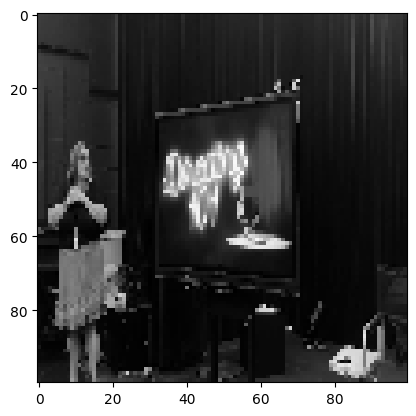

Confidence: [0.93980634]
JERMA LOCATED AT TIMESTAMP: 7756.315233333334


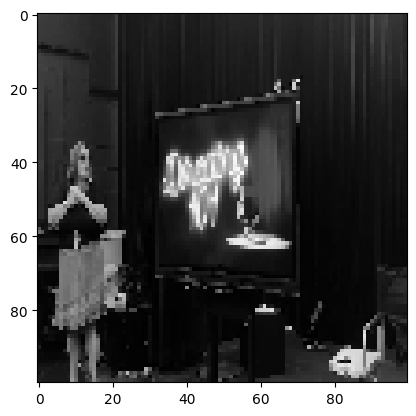

Confidence: [0.95215636]
JERMA LOCATED AT TIMESTAMP: 7756.3486


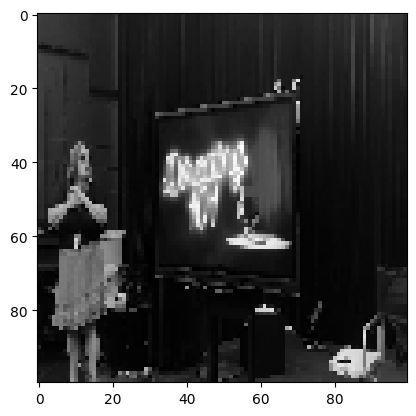

Confidence: [0.95807284]
JERMA LOCATED AT TIMESTAMP: 7756.381966666667


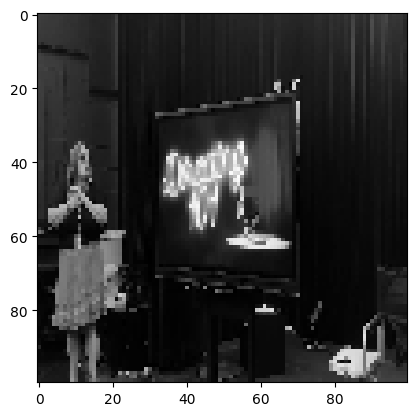

Confidence: [0.95772654]
JERMA LOCATED AT TIMESTAMP: 7756.415333333333


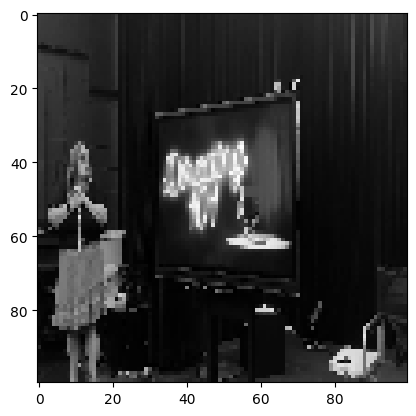

Confidence: [0.9562782]
JERMA LOCATED AT TIMESTAMP: 7756.4487


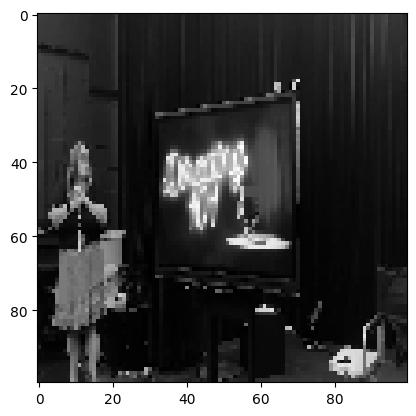

Confidence: [0.95930773]
JERMA LOCATED AT TIMESTAMP: 7756.482066666667


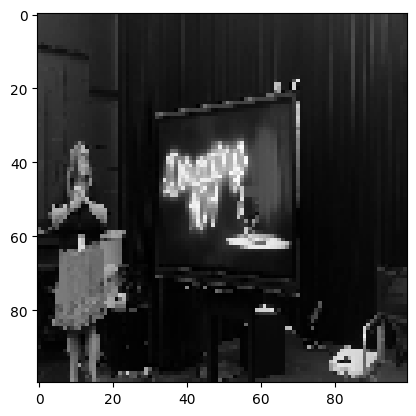

Confidence: [0.94419736]
JERMA LOCATED AT TIMESTAMP: 7756.515433333334


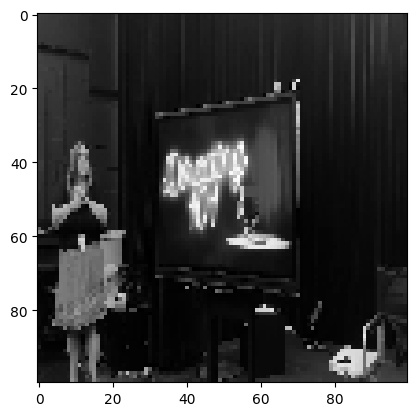

Confidence: [0.9236623]
JERMA LOCATED AT TIMESTAMP: 7756.5488000000005


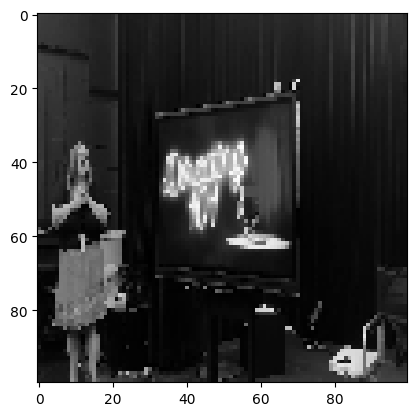

Confidence: [0.93291414]
JERMA LOCATED AT TIMESTAMP: 7756.582166666667


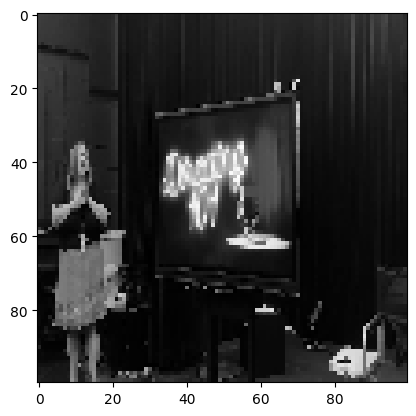

Confidence: [0.9536379]
JERMA LOCATED AT TIMESTAMP: 7756.615533333334


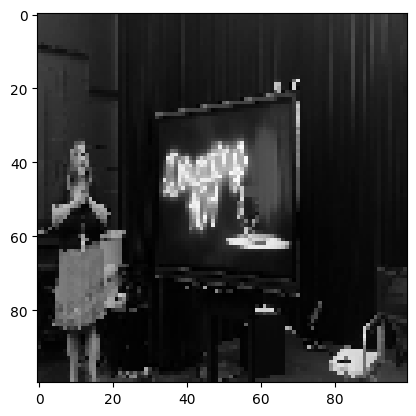

Confidence: [0.96308774]
JERMA LOCATED AT TIMESTAMP: 7756.6489


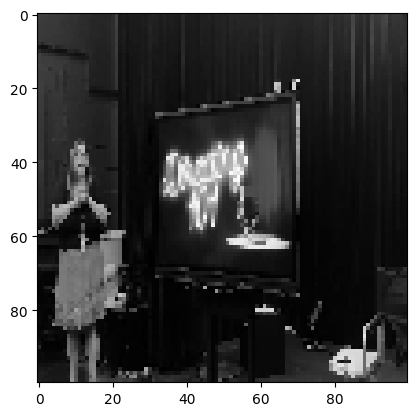

Confidence: [0.97395885]
JERMA LOCATED AT TIMESTAMP: 7756.682266666667


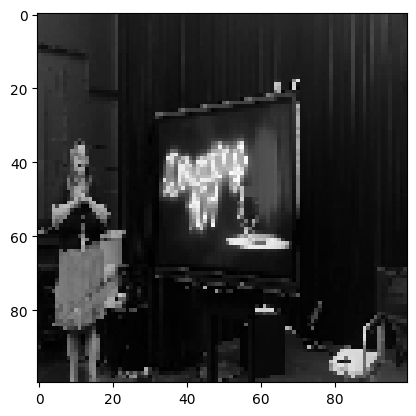

Confidence: [0.97357845]
JERMA LOCATED AT TIMESTAMP: 7756.715633333334


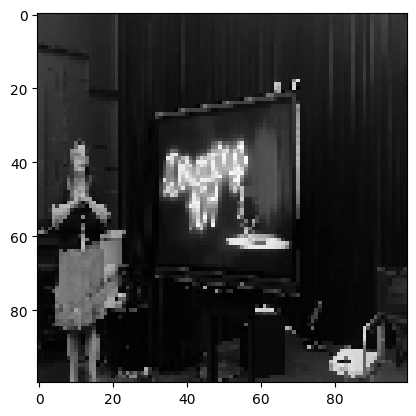

Confidence: [0.9797459]
JERMA LOCATED AT TIMESTAMP: 7756.749000000001


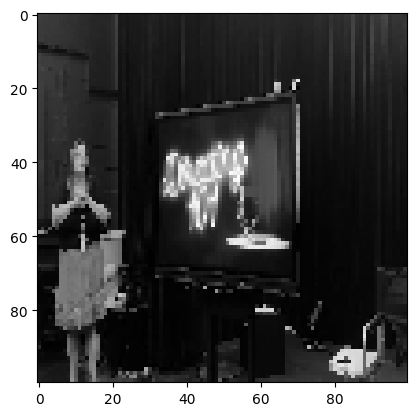

Confidence: [0.98441154]
JERMA LOCATED AT TIMESTAMP: 7756.782366666667


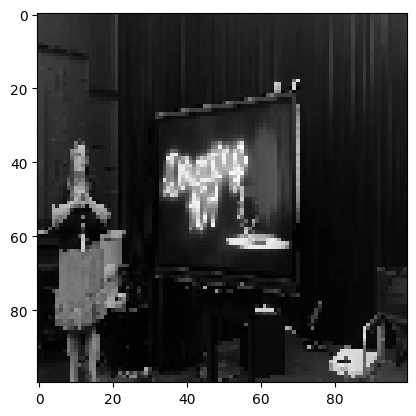

Confidence: [0.98288846]
JERMA LOCATED AT TIMESTAMP: 7756.815733333334


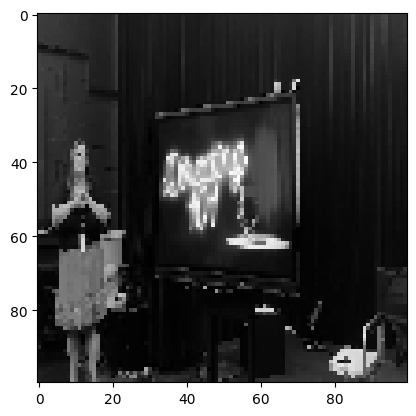

Confidence: [0.97991264]
JERMA LOCATED AT TIMESTAMP: 7756.8491


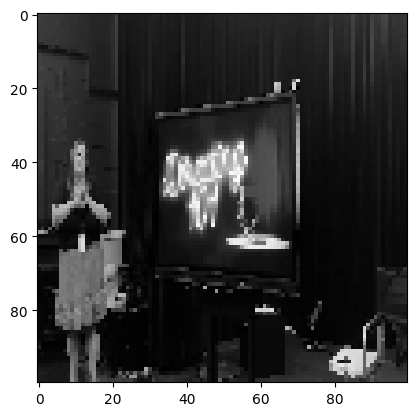

Confidence: [0.9809629]
JERMA LOCATED AT TIMESTAMP: 7756.882466666667


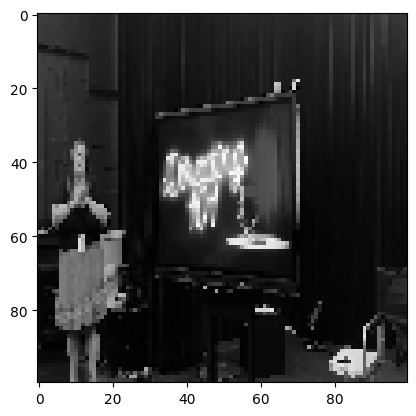

Confidence: [0.97722787]
JERMA LOCATED AT TIMESTAMP: 7756.9158333333335


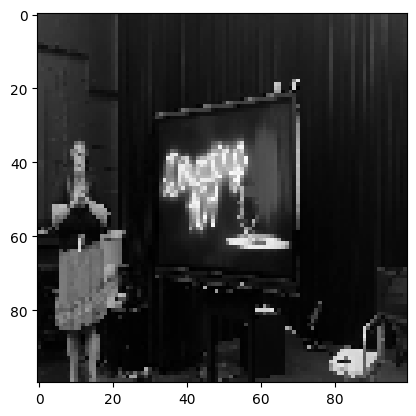

Confidence: [0.9678817]
JERMA LOCATED AT TIMESTAMP: 7756.9492


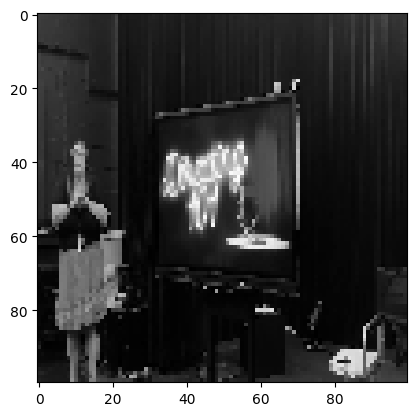

Confidence: [0.97077334]
JERMA LOCATED AT TIMESTAMP: 7756.9825666666675


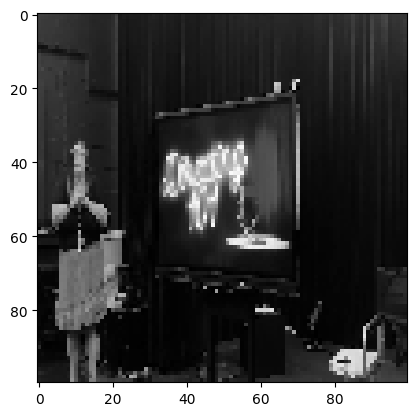

Confidence: [0.96892715]
JERMA LOCATED AT TIMESTAMP: 7757.015933333334


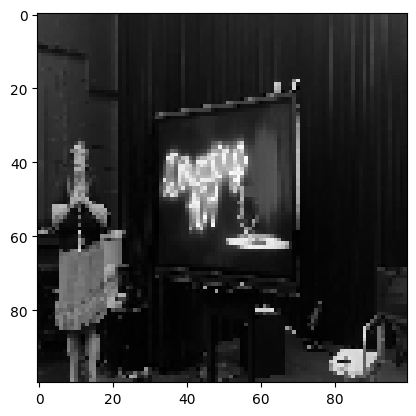

Confidence: [0.9674749]
JERMA LOCATED AT TIMESTAMP: 7757.049300000001


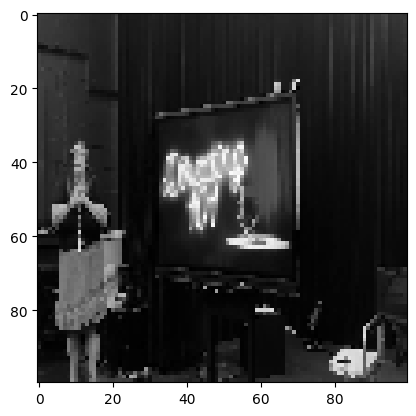

Confidence: [0.9591188]
JERMA LOCATED AT TIMESTAMP: 7757.082666666667


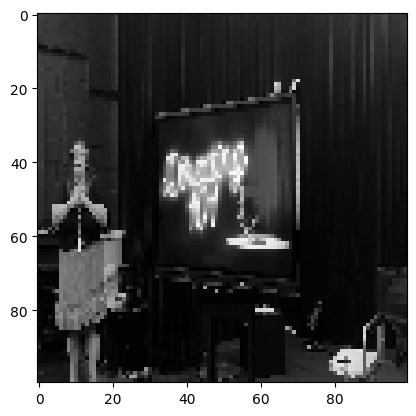

Confidence: [0.95632344]
JERMA LOCATED AT TIMESTAMP: 7757.116033333334


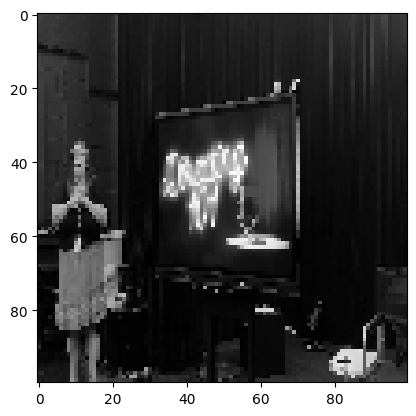

Confidence: [0.9574504]
JERMA LOCATED AT TIMESTAMP: 7757.1494


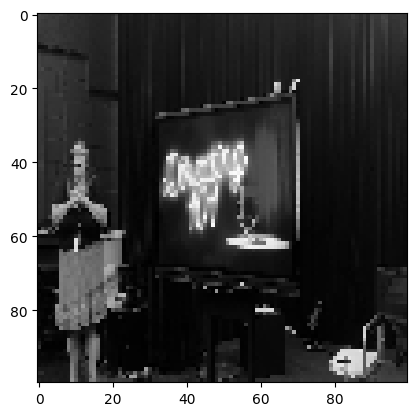

Confidence: [0.9604467]
JERMA LOCATED AT TIMESTAMP: 7757.182766666667


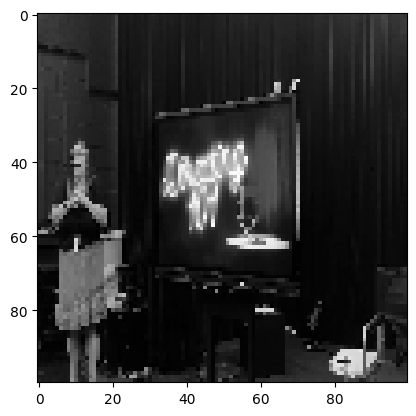

Confidence: [0.95032424]
JERMA LOCATED AT TIMESTAMP: 7757.216133333333


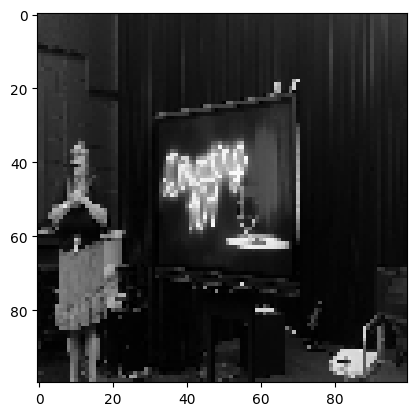

Confidence: [0.9550946]
JERMA LOCATED AT TIMESTAMP: 7757.249500000001


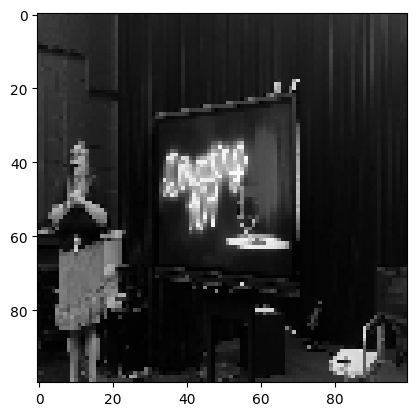

Confidence: [0.9582472]
JERMA LOCATED AT TIMESTAMP: 7757.282866666667


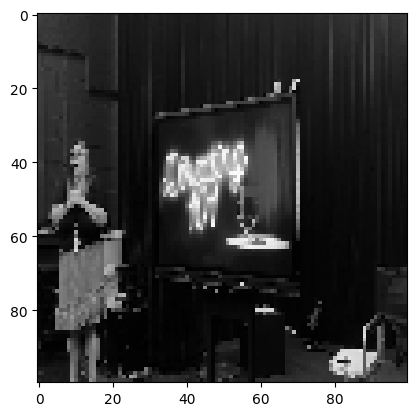

Confidence: [0.95317316]
JERMA LOCATED AT TIMESTAMP: 7757.316233333334


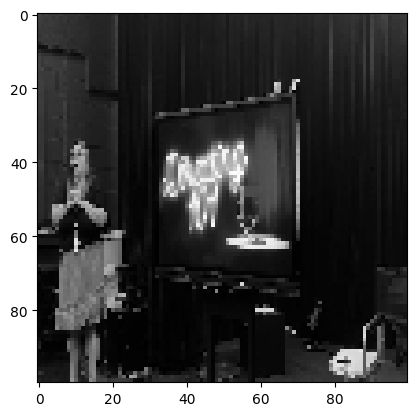

Confidence: [0.9548257]
JERMA LOCATED AT TIMESTAMP: 7757.3496000000005


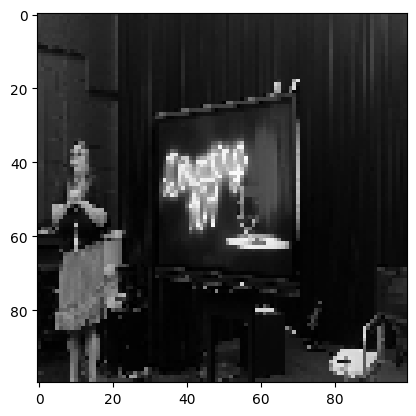

Confidence: [0.9585295]
JERMA LOCATED AT TIMESTAMP: 7757.382966666667


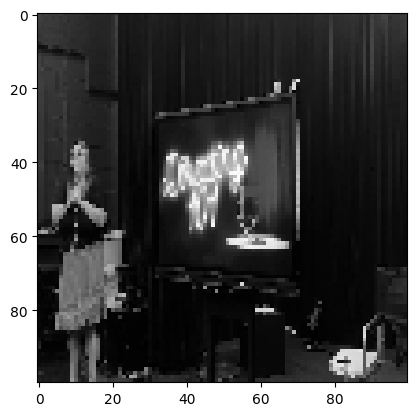

Confidence: [0.9578404]
JERMA LOCATED AT TIMESTAMP: 7757.416333333334


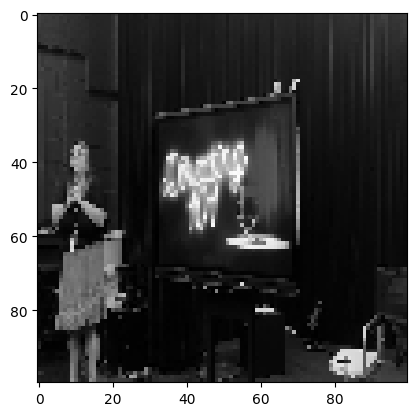

Confidence: [0.9645555]
JERMA LOCATED AT TIMESTAMP: 7757.4497


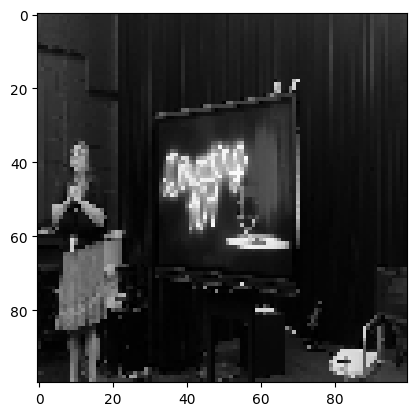

Confidence: [0.9682111]
JERMA LOCATED AT TIMESTAMP: 7757.483066666667


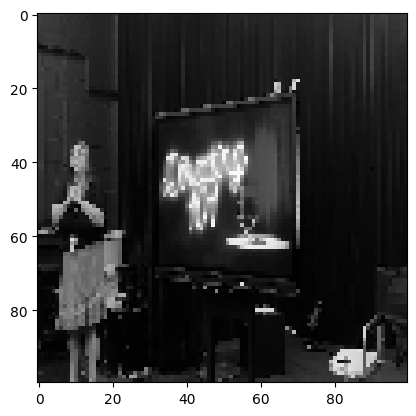

Confidence: [0.96967995]
JERMA LOCATED AT TIMESTAMP: 7757.516433333334


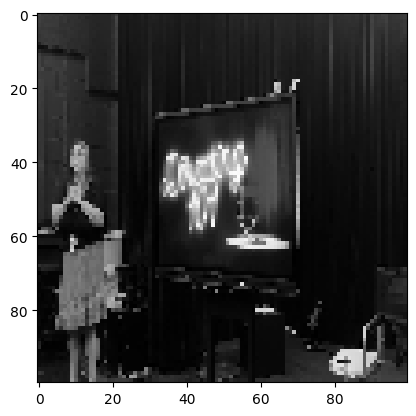

Confidence: [0.966064]
JERMA LOCATED AT TIMESTAMP: 7757.549800000001


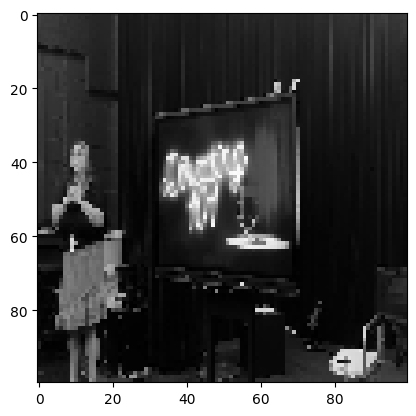

Confidence: [0.9674982]
JERMA LOCATED AT TIMESTAMP: 7757.583166666667


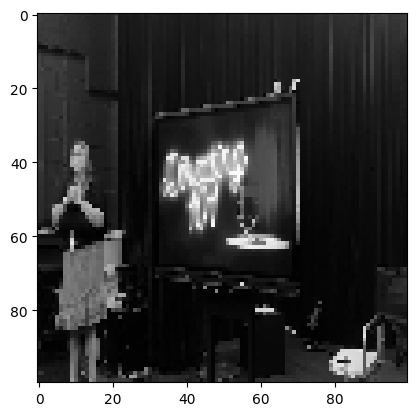

Confidence: [0.96213394]
JERMA LOCATED AT TIMESTAMP: 7757.616533333334


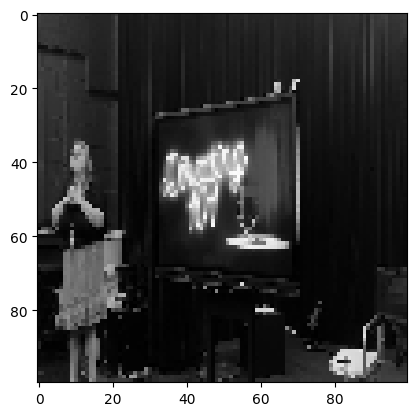

Confidence: [0.95976007]
JERMA LOCATED AT TIMESTAMP: 7757.6499


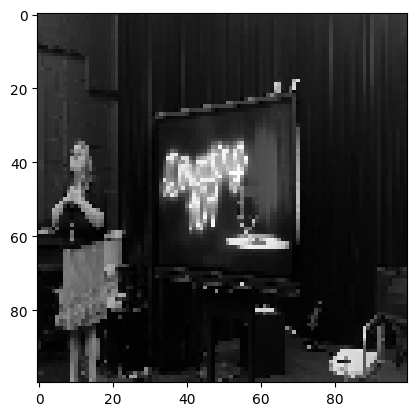

Confidence: [0.9381371]
JERMA LOCATED AT TIMESTAMP: 7757.683266666667


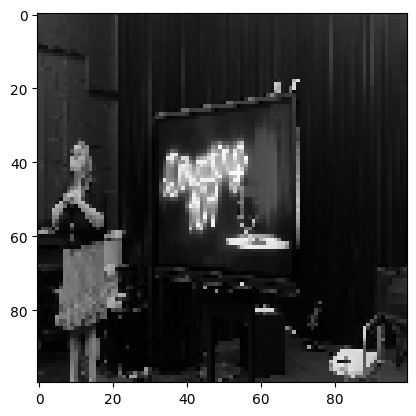

Confidence: [0.94196266]
JERMA LOCATED AT TIMESTAMP: 7757.716633333333


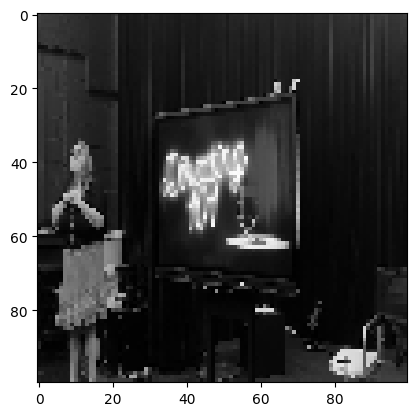

Confidence: [0.92698437]
JERMA LOCATED AT TIMESTAMP: 7757.75


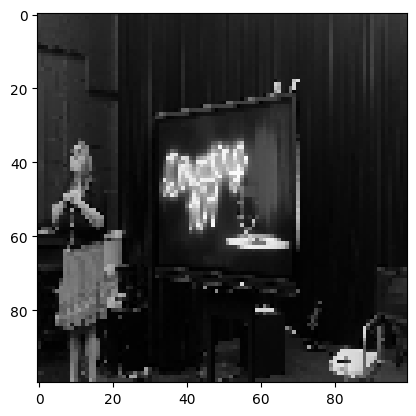

Confidence: [0.9202958]
JERMA LOCATED AT TIMESTAMP: 7757.7833666666675


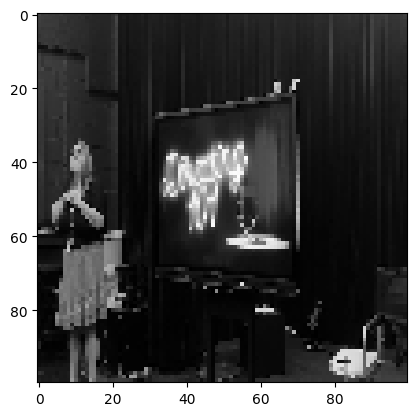

Confidence: [0.9114825]
JERMA LOCATED AT TIMESTAMP: 7757.816733333334


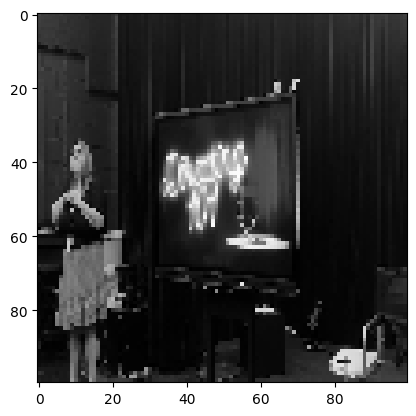

Confidence: [0.9324255]
JERMA LOCATED AT TIMESTAMP: 7757.850100000001


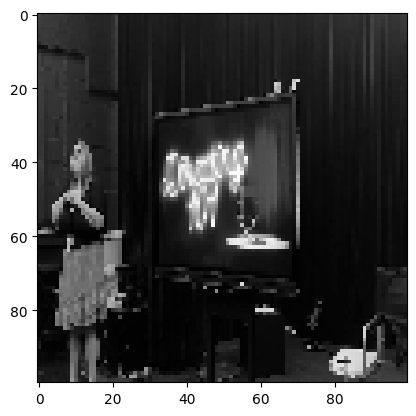

Confidence: [0.93545973]
JERMA LOCATED AT TIMESTAMP: 7757.883466666667


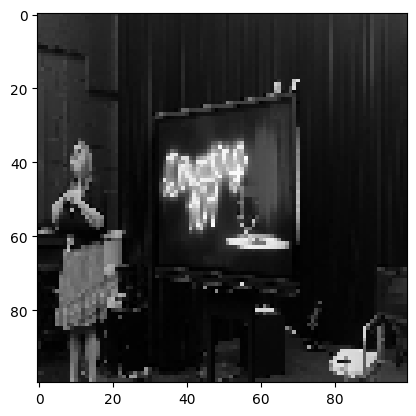

Confidence: [0.9357131]
JERMA LOCATED AT TIMESTAMP: 7757.916833333334


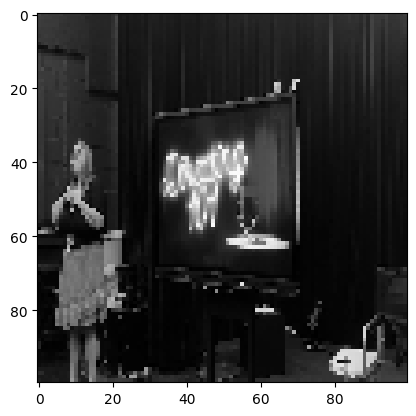

Confidence: [0.9447087]
JERMA LOCATED AT TIMESTAMP: 7757.9502


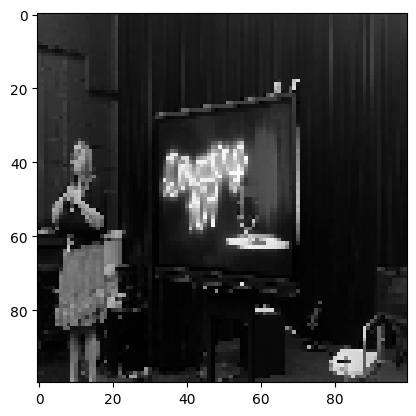

Confidence: [0.9393965]
JERMA LOCATED AT TIMESTAMP: 7757.983566666667


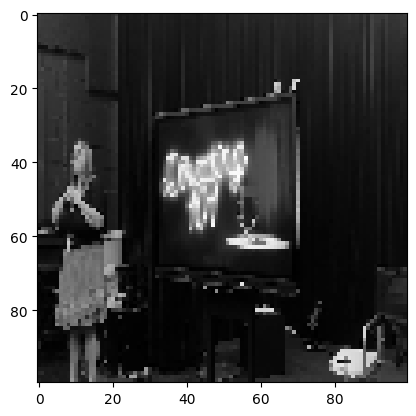

Confidence: [0.93921685]
JERMA LOCATED AT TIMESTAMP: 7758.016933333333


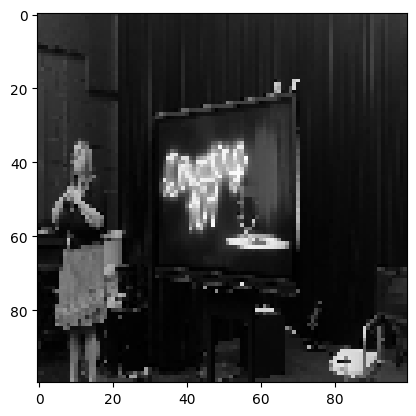

Confidence: [0.9406595]
JERMA LOCATED AT TIMESTAMP: 7758.050300000001


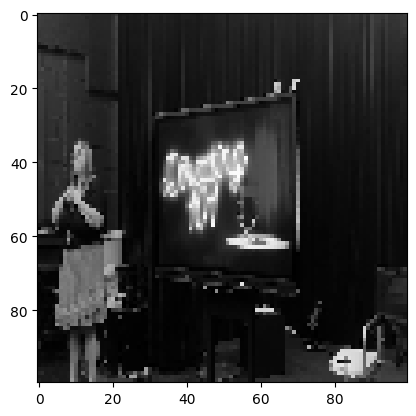

Confidence: [0.9404182]
JERMA LOCATED AT TIMESTAMP: 7758.083666666667


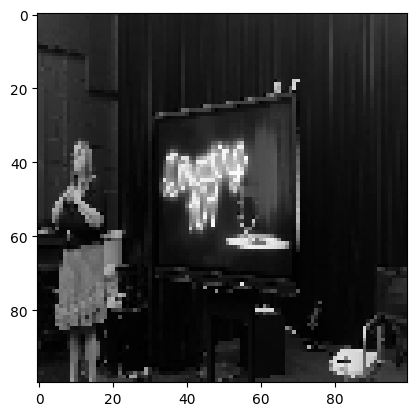

Confidence: [0.9374258]
JERMA LOCATED AT TIMESTAMP: 7758.117033333334


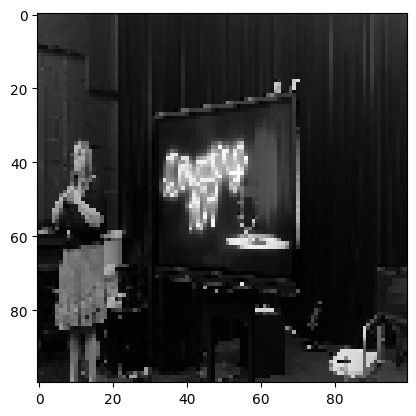

Confidence: [0.9423022]
JERMA LOCATED AT TIMESTAMP: 7758.1504


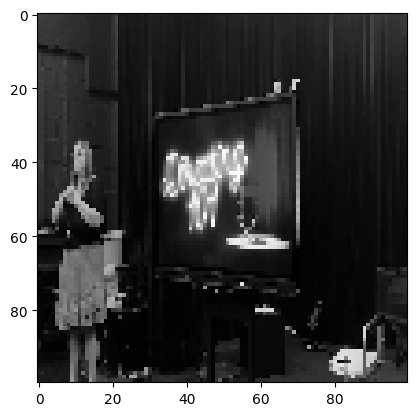

Confidence: [0.94573563]
JERMA LOCATED AT TIMESTAMP: 7758.183766666667


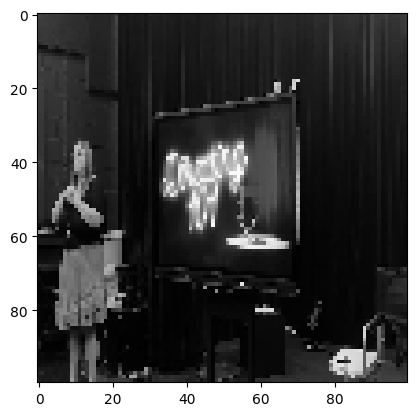

Confidence: [0.94645077]
JERMA LOCATED AT TIMESTAMP: 7758.217133333334


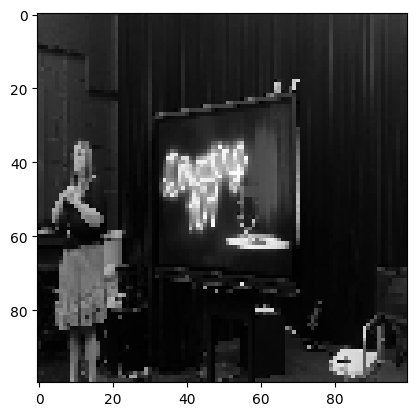

Confidence: [0.94954014]
JERMA LOCATED AT TIMESTAMP: 7758.2505


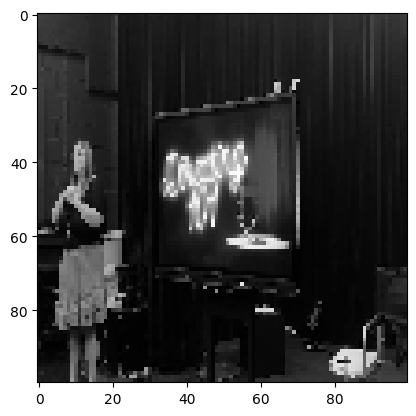

Confidence: [0.9490666]
JERMA LOCATED AT TIMESTAMP: 7758.283866666667


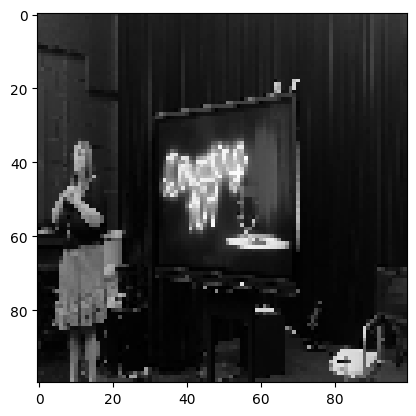

Confidence: [0.946323]
JERMA LOCATED AT TIMESTAMP: 7758.317233333334


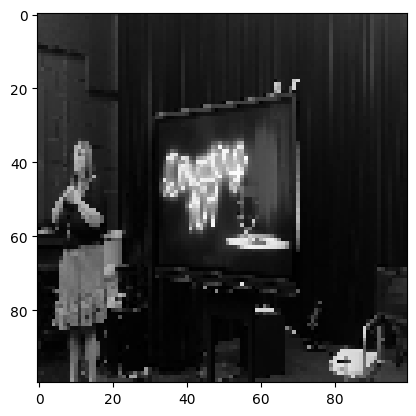

Confidence: [0.92675775]
JERMA LOCATED AT TIMESTAMP: 7758.350600000001


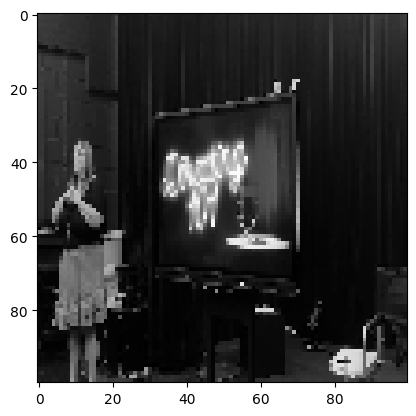

Confidence: [0.94096786]
JERMA LOCATED AT TIMESTAMP: 7758.383966666667


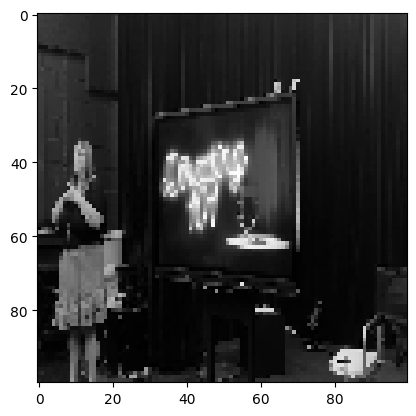

Confidence: [0.9445116]
JERMA LOCATED AT TIMESTAMP: 7758.417333333334


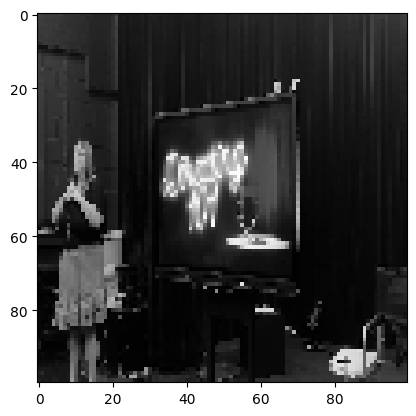

Confidence: [0.9494917]
JERMA LOCATED AT TIMESTAMP: 7758.4507


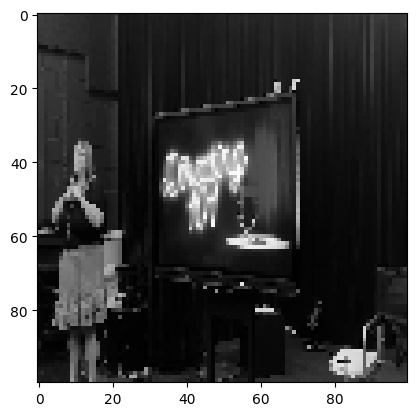

Confidence: [0.9575897]
JERMA LOCATED AT TIMESTAMP: 7758.484066666666


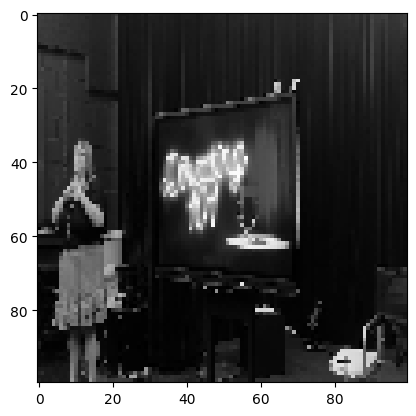

Confidence: [0.9660206]
JERMA LOCATED AT TIMESTAMP: 7758.517433333333


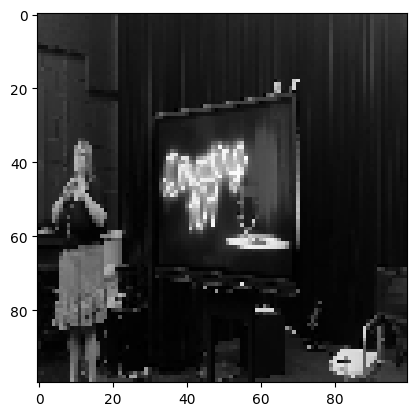

Confidence: [0.95460135]
JERMA LOCATED AT TIMESTAMP: 7758.5508


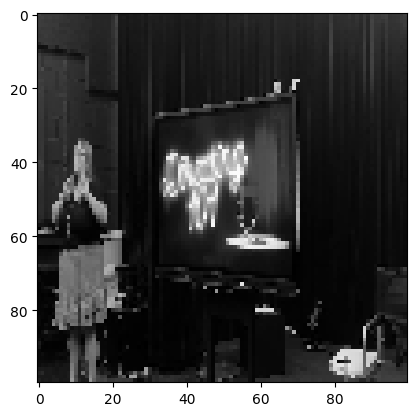

Confidence: [0.93668157]
JERMA LOCATED AT TIMESTAMP: 7758.584166666668


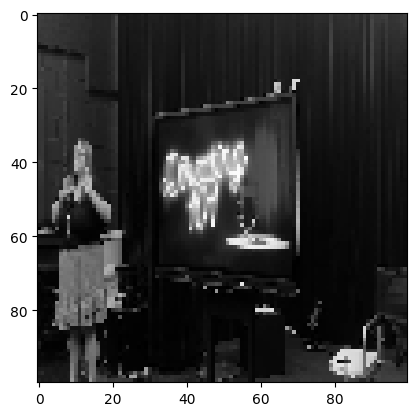

Confidence: [0.95888656]
JERMA LOCATED AT TIMESTAMP: 7758.617533333334


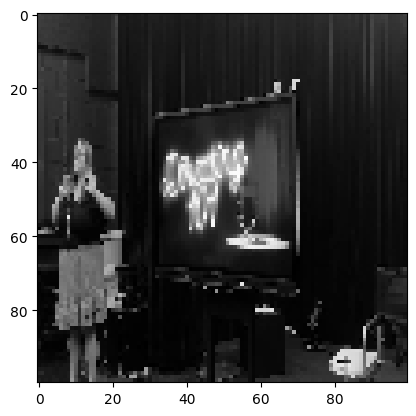

Confidence: [0.9566364]
JERMA LOCATED AT TIMESTAMP: 7758.650900000001


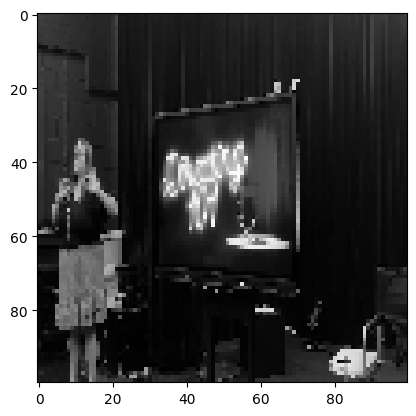

Confidence: [0.96472347]
JERMA LOCATED AT TIMESTAMP: 7758.684266666667


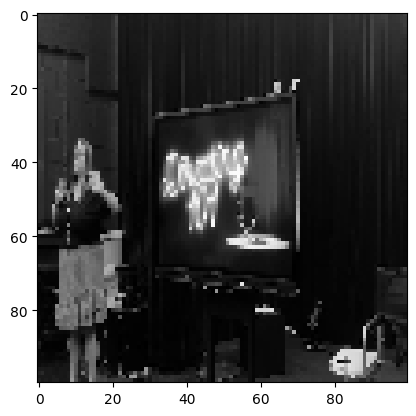

Confidence: [0.96295774]
JERMA LOCATED AT TIMESTAMP: 7758.717633333334


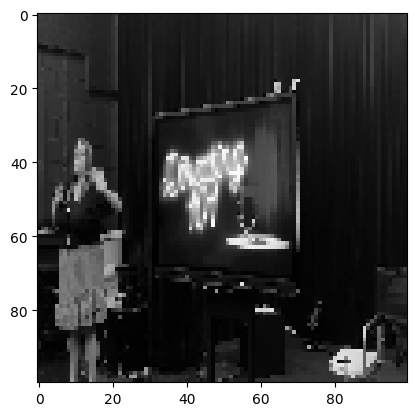

Confidence: [0.9408157]
JERMA LOCATED AT TIMESTAMP: 7758.751


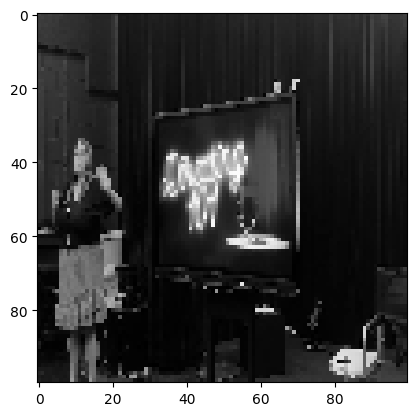

Confidence: [0.9408654]
JERMA LOCATED AT TIMESTAMP: 7758.784366666667


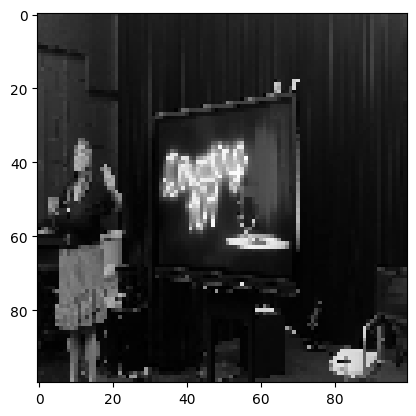

Confidence: [0.9492498]
JERMA LOCATED AT TIMESTAMP: 7758.817733333333


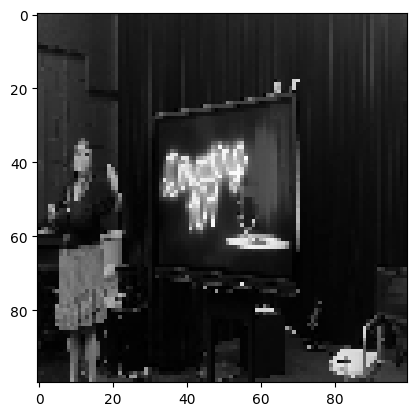

Confidence: [0.96019596]
JERMA LOCATED AT TIMESTAMP: 7758.851100000001


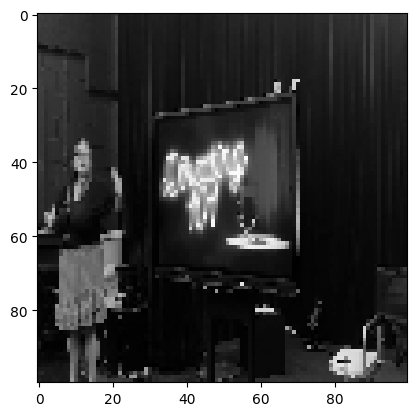

Confidence: [0.9514107]
JERMA LOCATED AT TIMESTAMP: 7758.884466666667


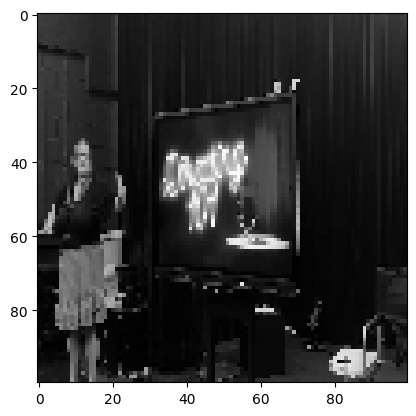

Confidence: [0.9610952]
JERMA LOCATED AT TIMESTAMP: 7758.917833333334


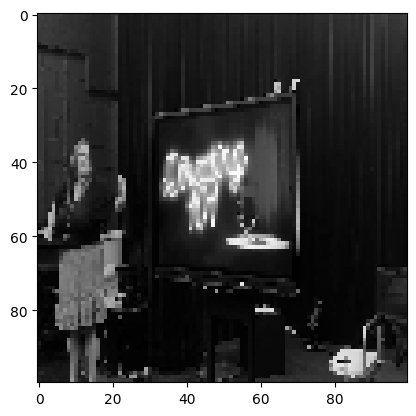

Confidence: [0.9464071]
JERMA LOCATED AT TIMESTAMP: 7758.9512


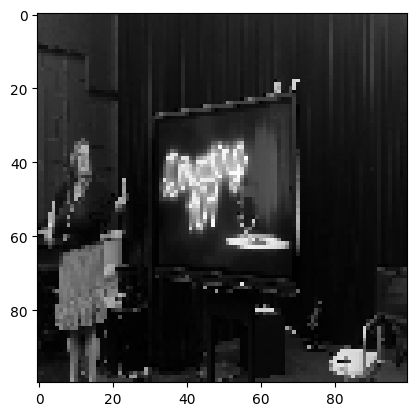

Confidence: [0.953935]
JERMA LOCATED AT TIMESTAMP: 7758.984566666667


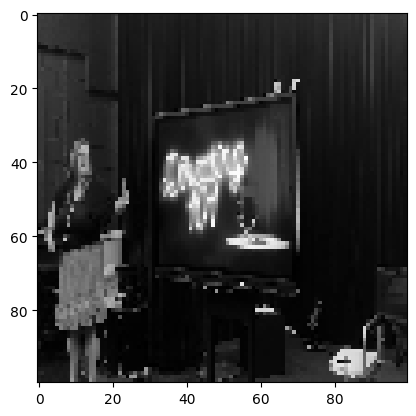

Confidence: [0.9518344]
JERMA LOCATED AT TIMESTAMP: 7759.0179333333335


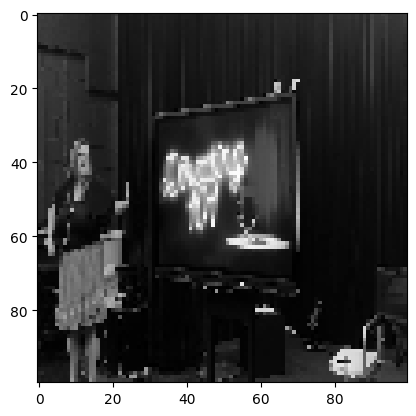

Confidence: [0.9476823]
JERMA LOCATED AT TIMESTAMP: 7759.0513


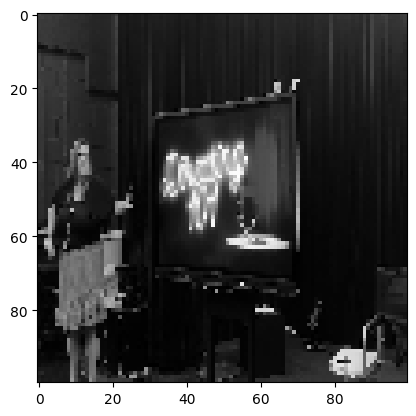

Confidence: [0.90049464]
JERMA LOCATED AT TIMESTAMP: 7759.084666666667


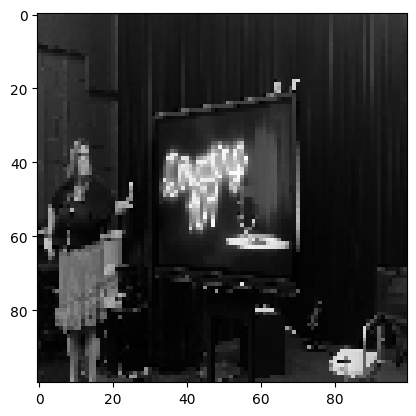

Confidence: [0.90864336]
JERMA LOCATED AT TIMESTAMP: 7759.118033333334


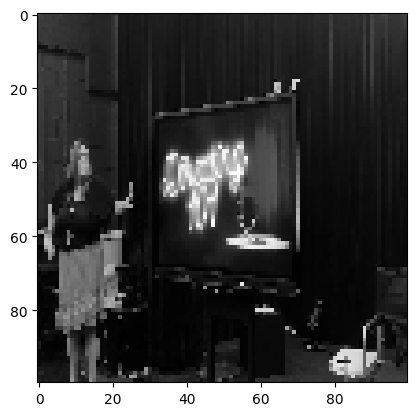

Confidence: [0.9316239]
JERMA LOCATED AT TIMESTAMP: 7759.151400000001


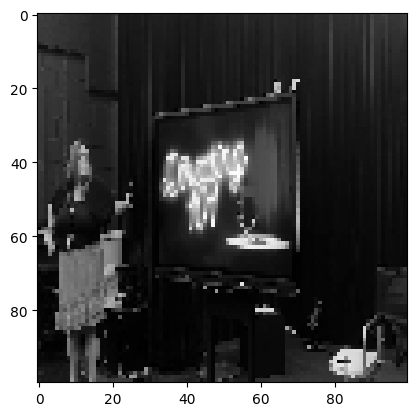

Confidence: [0.9041767]
JERMA LOCATED AT TIMESTAMP: 7759.184766666667


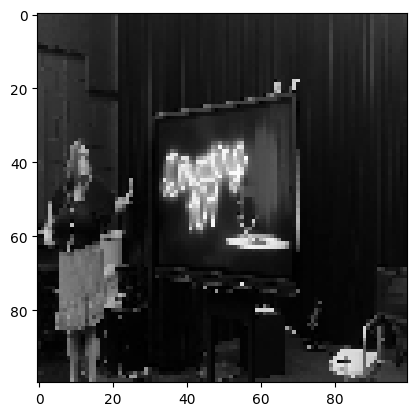

Confidence: [0.9363963]
JERMA LOCATED AT TIMESTAMP: 7759.218133333334


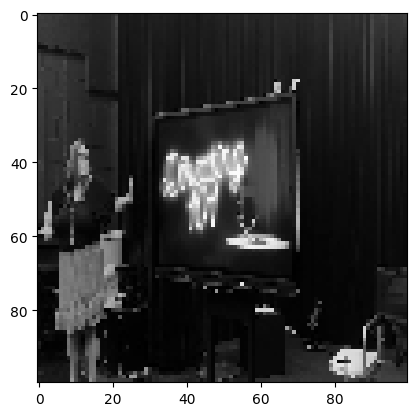

Confidence: [0.91555643]
JERMA LOCATED AT TIMESTAMP: 7759.2515


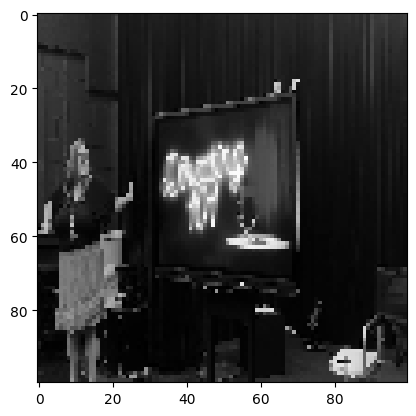

Confidence: [0.93207616]
JERMA LOCATED AT TIMESTAMP: 7759.284866666667


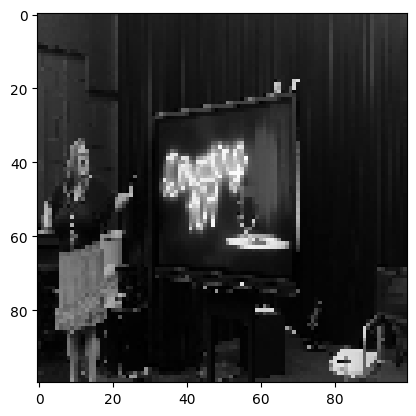

Confidence: [0.9185678]
JERMA LOCATED AT TIMESTAMP: 7759.318233333333


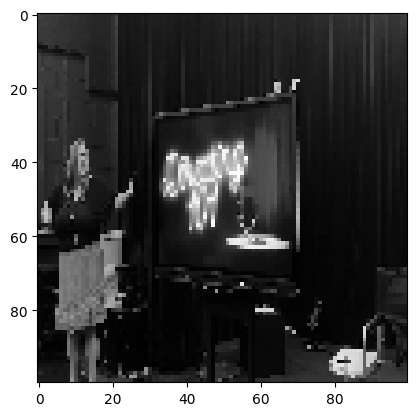

Confidence: [0.9056538]
JERMA LOCATED AT TIMESTAMP: 7759.3516


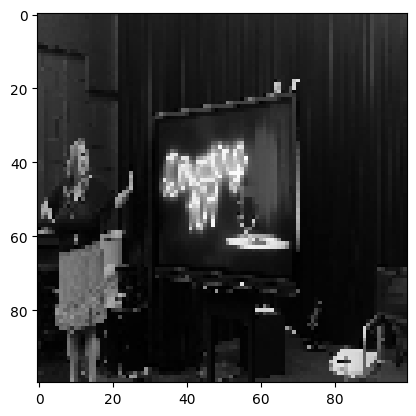

Confidence: [0.9052561]
JERMA LOCATED AT TIMESTAMP: 7759.485066666667


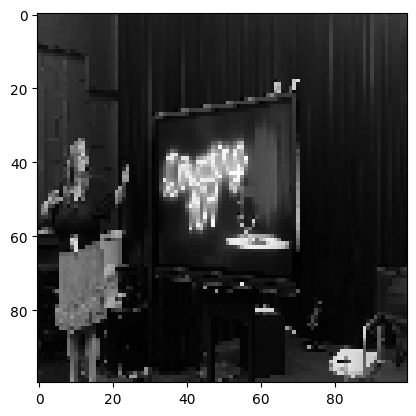

Confidence: [0.9004987]
JERMA LOCATED AT TIMESTAMP: 7759.5518


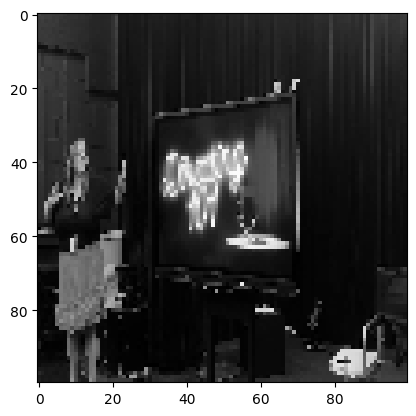

Confidence: [0.9526815]
JERMA LOCATED AT TIMESTAMP: 7759.585166666667


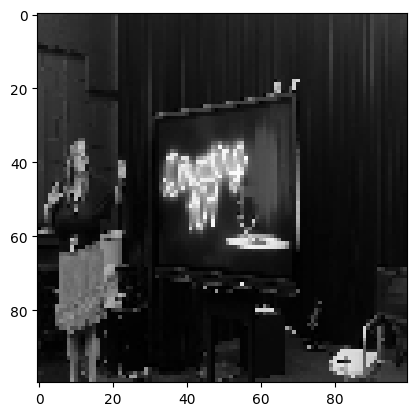

Confidence: [0.9171697]
JERMA LOCATED AT TIMESTAMP: 7759.618533333333


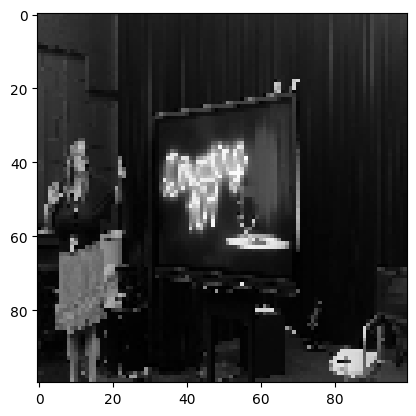

Confidence: [0.93301064]
JERMA LOCATED AT TIMESTAMP: 7759.651900000001


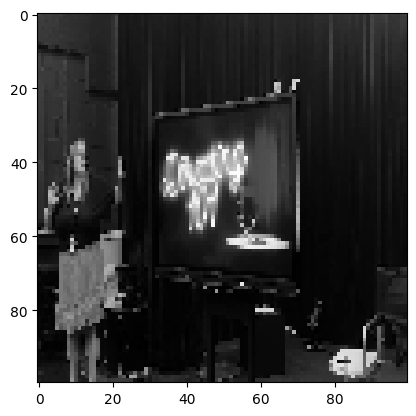

Confidence: [0.9206921]
JERMA LOCATED AT TIMESTAMP: 7759.685266666667


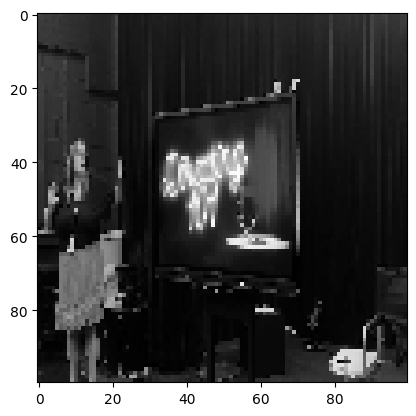

Confidence: [0.9112829]
JERMA LOCATED AT TIMESTAMP: 7759.718633333334


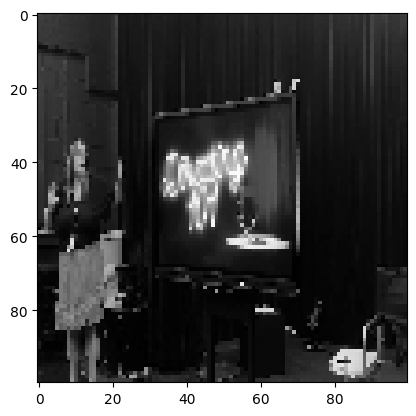

Confidence: [0.9348879]
JERMA LOCATED AT TIMESTAMP: 7759.8187333333335


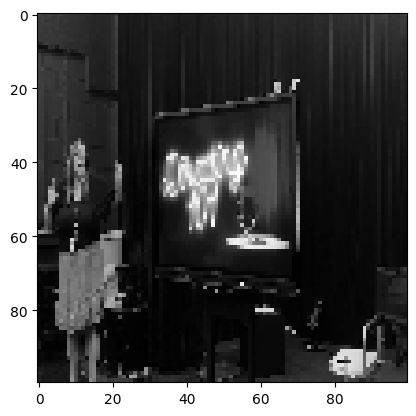

Confidence: [0.9205541]
JERMA LOCATED AT TIMESTAMP: 7759.8521


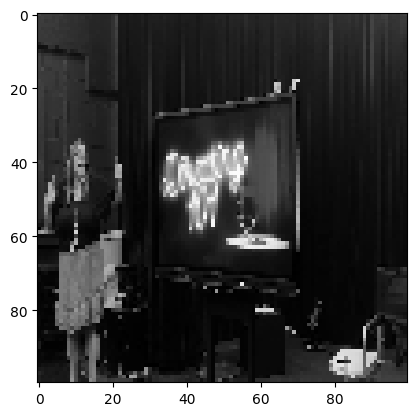

Confidence: [0.93114275]
JERMA LOCATED AT TIMESTAMP: 7759.885466666667


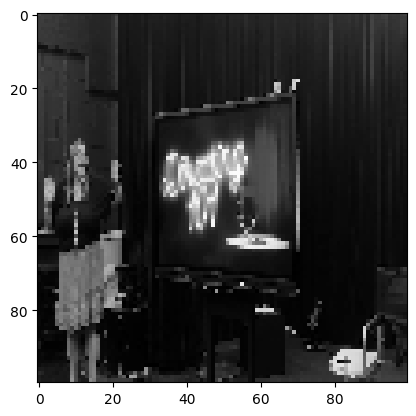

Confidence: [0.96379757]
JERMA LOCATED AT TIMESTAMP: 7759.918833333334


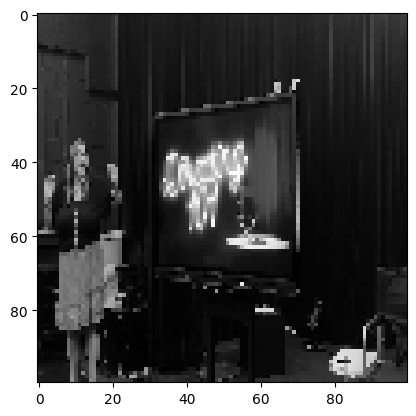

Confidence: [0.9655646]
JERMA LOCATED AT TIMESTAMP: 7759.952200000001


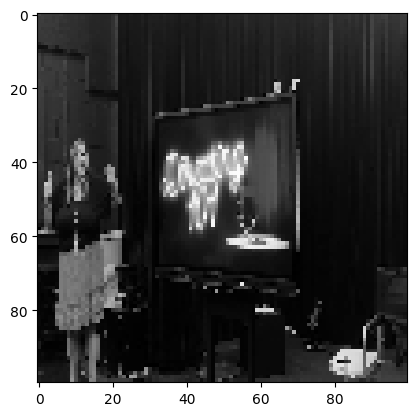

Confidence: [0.93885267]
JERMA LOCATED AT TIMESTAMP: 7759.985566666667


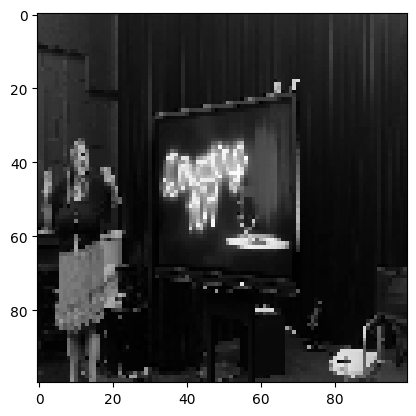

Confidence: [0.949092]
JERMA LOCATED AT TIMESTAMP: 7760.018933333334


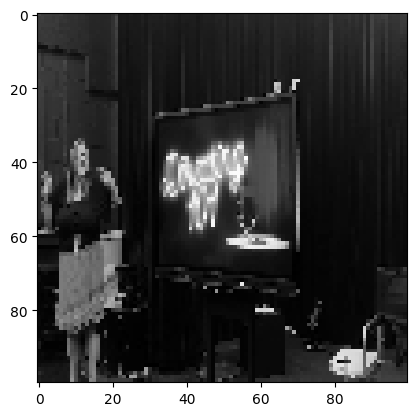

Confidence: [0.9345364]
JERMA LOCATED AT TIMESTAMP: 7760.052300000001


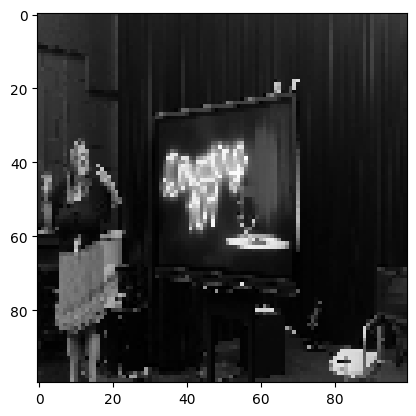

Confidence: [0.9356125]
JERMA LOCATED AT TIMESTAMP: 7760.085666666667


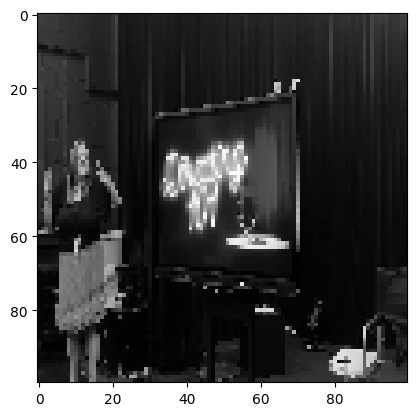

Confidence: [0.9288933]
JERMA LOCATED AT TIMESTAMP: 7760.119033333333


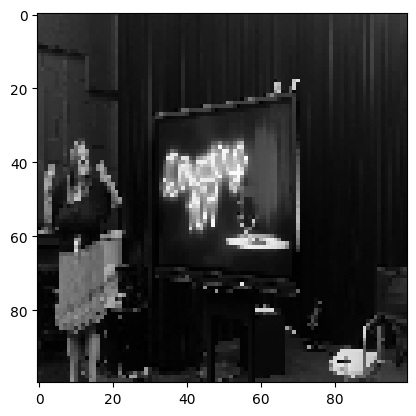

Confidence: [0.9348879]
JERMA LOCATED AT TIMESTAMP: 7760.1524


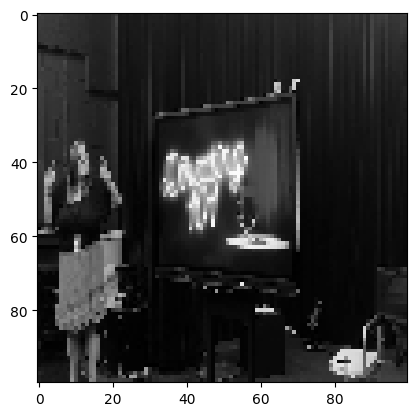

Confidence: [0.92619723]
JERMA LOCATED AT TIMESTAMP: 7760.185766666667


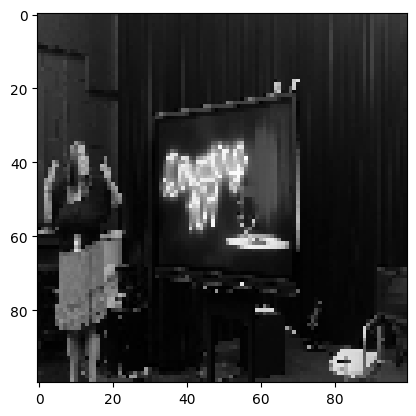

Confidence: [0.90200806]
JERMA LOCATED AT TIMESTAMP: 7760.219133333334


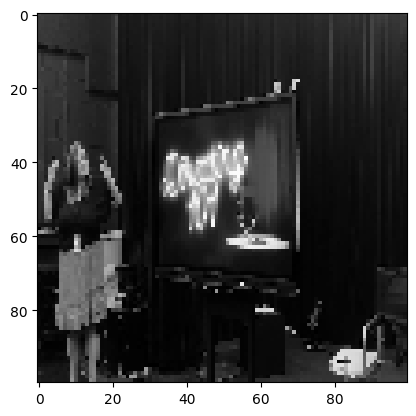

Confidence: [0.92975134]
JERMA LOCATED AT TIMESTAMP: 7760.285866666667


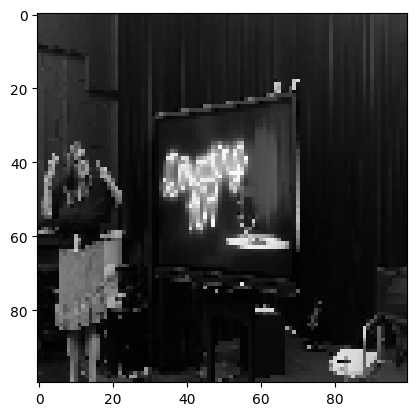

Confidence: [0.92242026]
JERMA LOCATED AT TIMESTAMP: 7760.319233333334


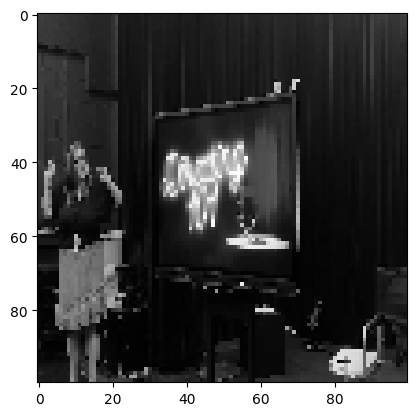

Confidence: [0.9132021]
JERMA LOCATED AT TIMESTAMP: 7760.419333333333


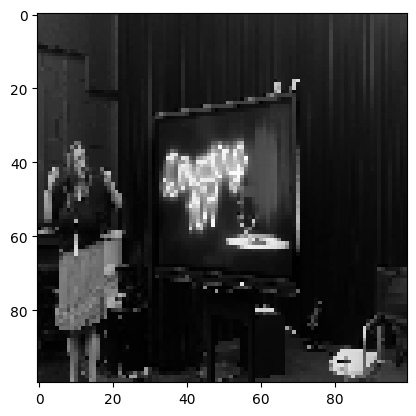

Confidence: [0.9058298]
JERMA LOCATED AT TIMESTAMP: 7760.452700000001


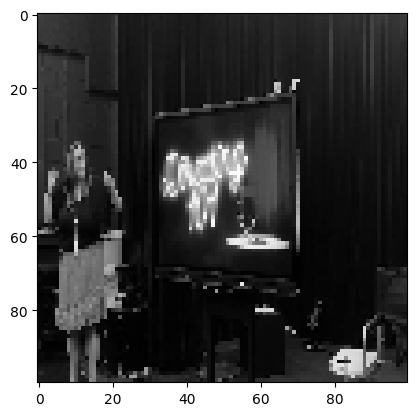

Confidence: [0.9212474]
JERMA LOCATED AT TIMESTAMP: 7760.486066666667


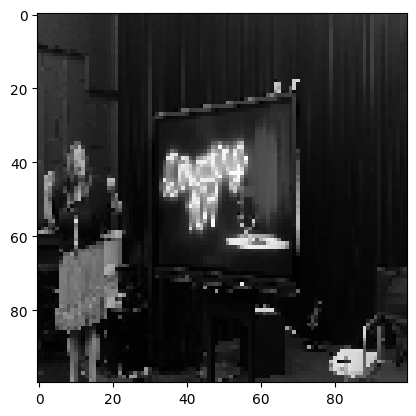

Confidence: [0.93214315]
JERMA LOCATED AT TIMESTAMP: 7760.519433333334


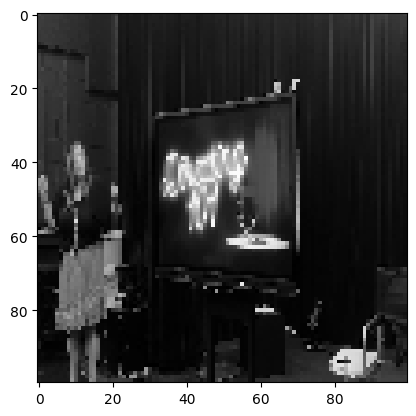

Confidence: [0.94223607]
JERMA LOCATED AT TIMESTAMP: 7760.5528


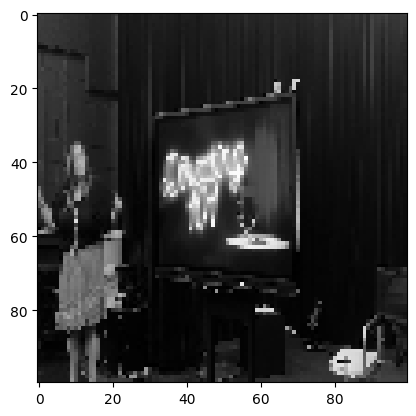

Confidence: [0.9593738]
JERMA LOCATED AT TIMESTAMP: 7760.586166666667


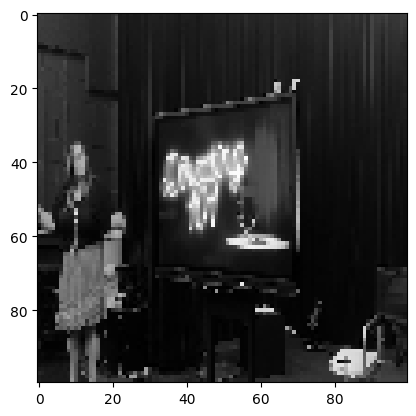

Confidence: [0.9342307]
JERMA LOCATED AT TIMESTAMP: 7760.6195333333335


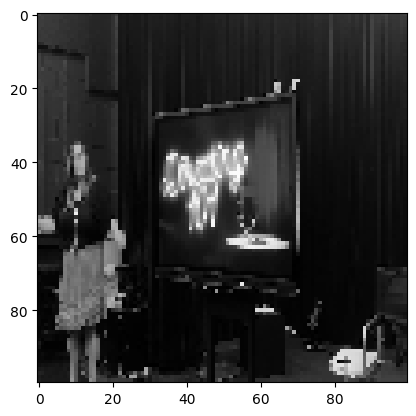

Confidence: [0.93878174]
JERMA LOCATED AT TIMESTAMP: 7760.6529


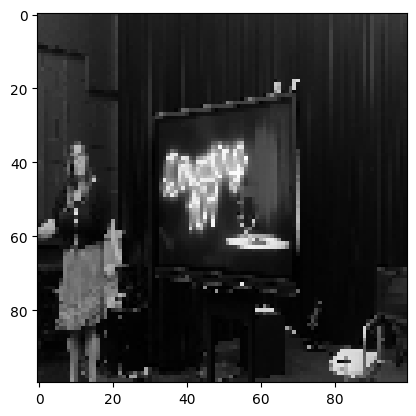

Confidence: [0.93907094]
JERMA LOCATED AT TIMESTAMP: 7760.686266666667


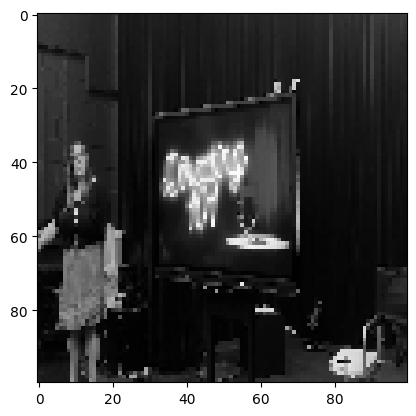

Confidence: [0.93993336]
JERMA LOCATED AT TIMESTAMP: 7760.719633333334


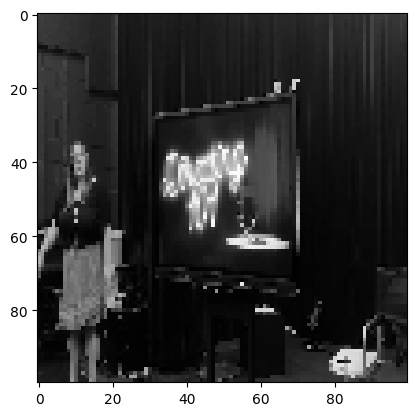

Confidence: [0.9621357]
JERMA LOCATED AT TIMESTAMP: 7760.753000000001


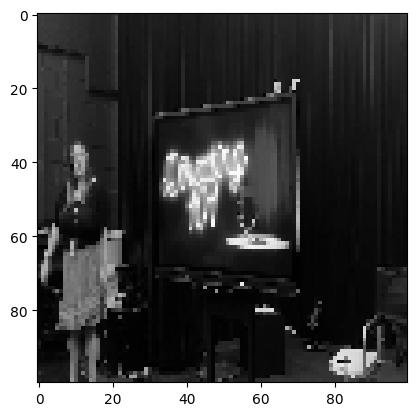

Confidence: [0.9654704]
JERMA LOCATED AT TIMESTAMP: 7760.786366666667


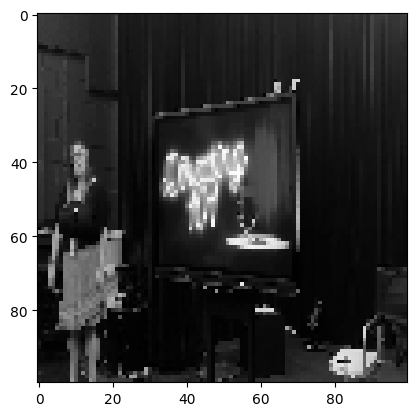

Confidence: [0.958638]
JERMA LOCATED AT TIMESTAMP: 7760.819733333334


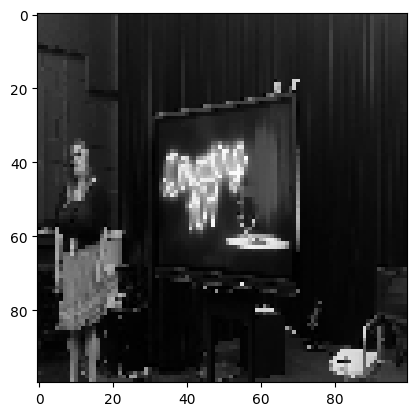

Confidence: [0.9624102]
JERMA LOCATED AT TIMESTAMP: 7760.8531


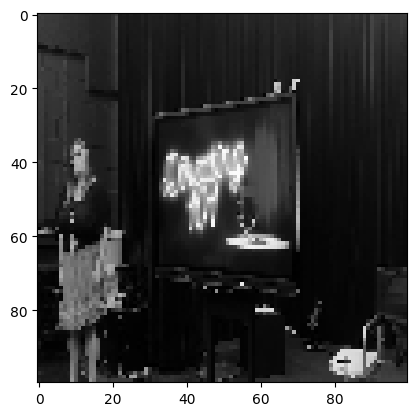

Confidence: [0.95983964]
JERMA LOCATED AT TIMESTAMP: 7760.886466666667


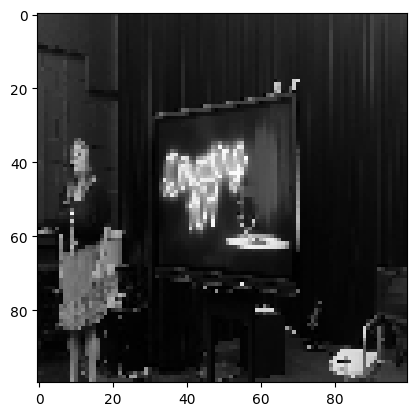

Confidence: [0.96013004]
JERMA LOCATED AT TIMESTAMP: 7760.919833333333


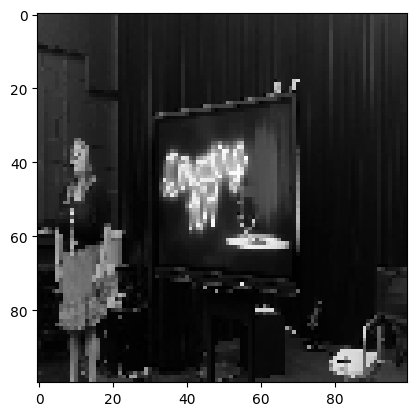

Confidence: [0.9542417]
JERMA LOCATED AT TIMESTAMP: 7760.9532


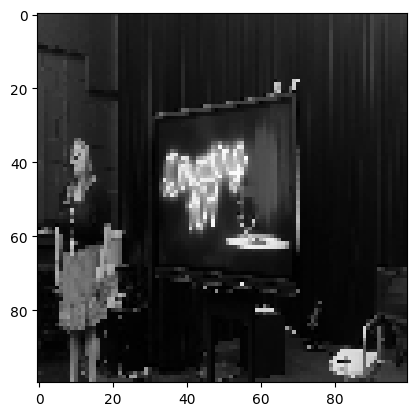

Confidence: [0.94996965]
JERMA LOCATED AT TIMESTAMP: 7760.986566666667


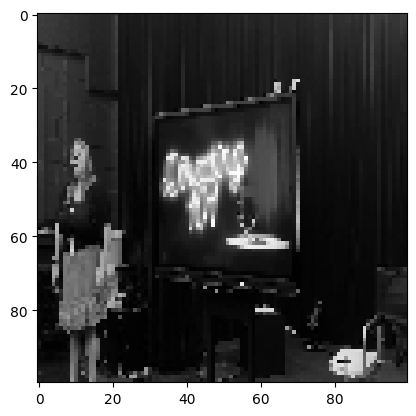

Confidence: [0.95284694]
JERMA LOCATED AT TIMESTAMP: 7761.019933333334


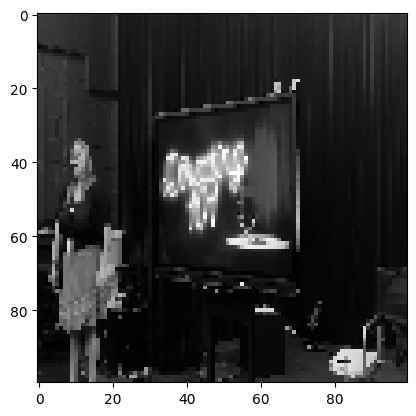

Confidence: [0.9530014]
JERMA LOCATED AT TIMESTAMP: 7761.0533000000005


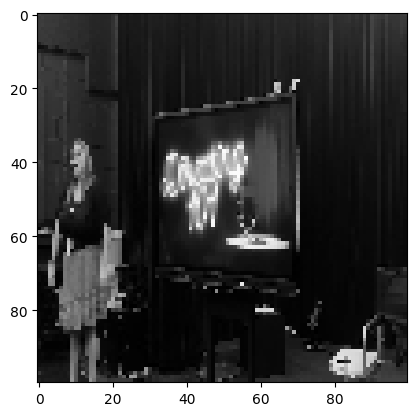

Confidence: [0.94890064]
JERMA LOCATED AT TIMESTAMP: 7761.086666666667


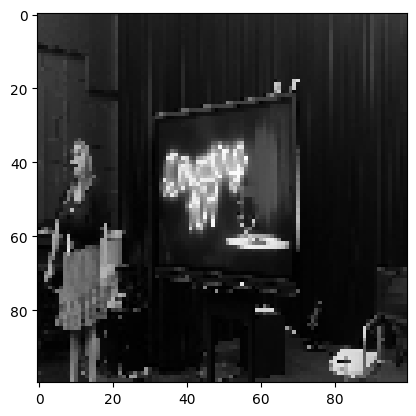

Confidence: [0.9453555]
JERMA LOCATED AT TIMESTAMP: 7761.120033333334


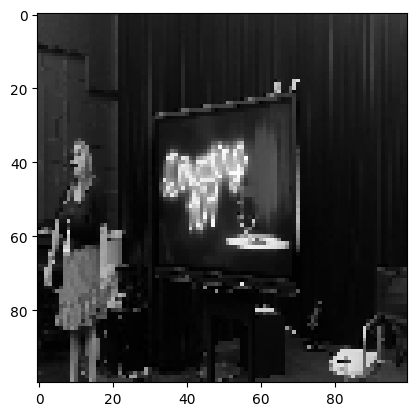

Confidence: [0.9373296]
JERMA LOCATED AT TIMESTAMP: 7761.1534


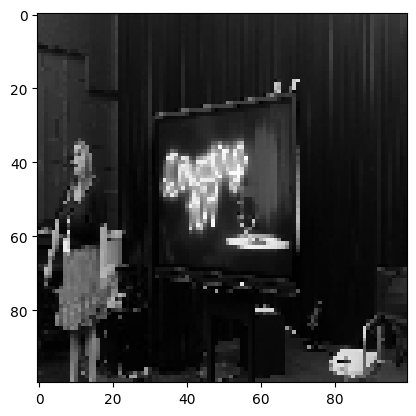

Confidence: [0.91727215]
JERMA LOCATED AT TIMESTAMP: 7761.186766666667


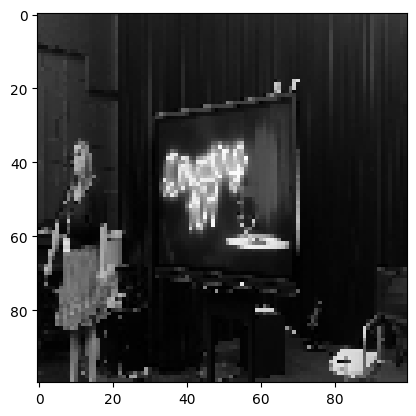

Confidence: [0.9090694]
JERMA LOCATED AT TIMESTAMP: 7761.220133333333


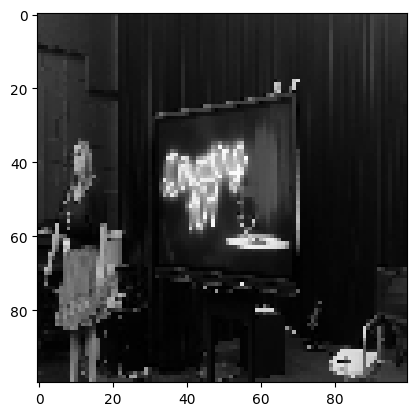

Confidence: [0.9079712]
JERMA LOCATED AT TIMESTAMP: 7761.286866666667


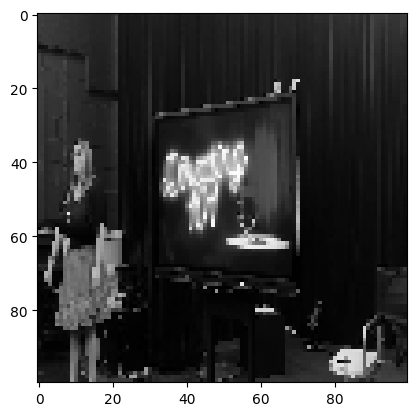

Confidence: [0.91294026]
JERMA LOCATED AT TIMESTAMP: 7761.320233333334


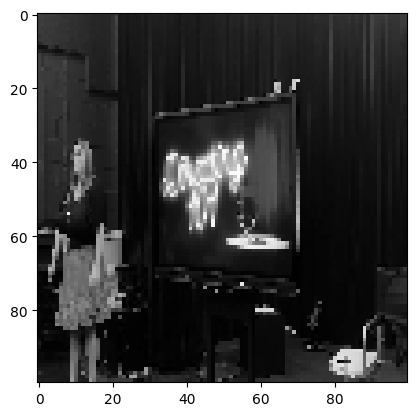

Confidence: [0.91839784]
JERMA LOCATED AT TIMESTAMP: 7761.3536


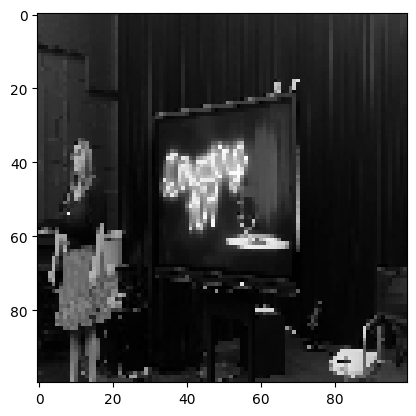

Confidence: [0.92951953]
JERMA LOCATED AT TIMESTAMP: 7761.386966666667


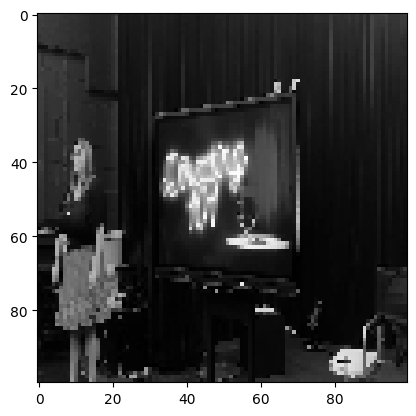

Confidence: [0.9432843]
JERMA LOCATED AT TIMESTAMP: 7761.4203333333335


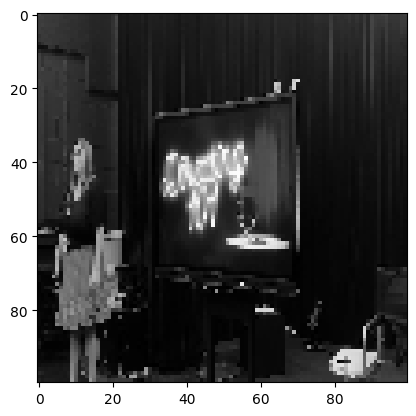

Confidence: [0.94217944]
JERMA LOCATED AT TIMESTAMP: 7761.4537


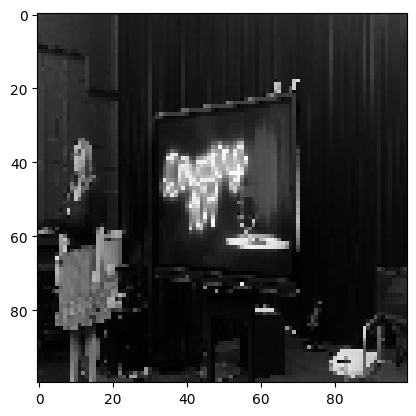

Confidence: [0.94654644]
JERMA LOCATED AT TIMESTAMP: 7761.4870666666675


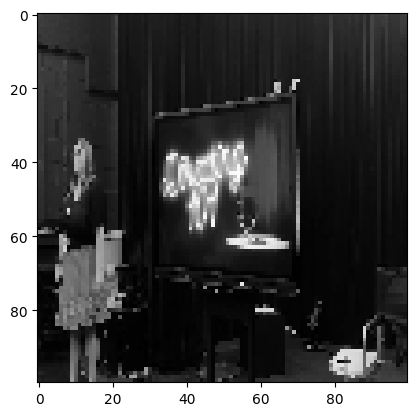

Confidence: [0.94635594]
JERMA LOCATED AT TIMESTAMP: 7761.520433333333


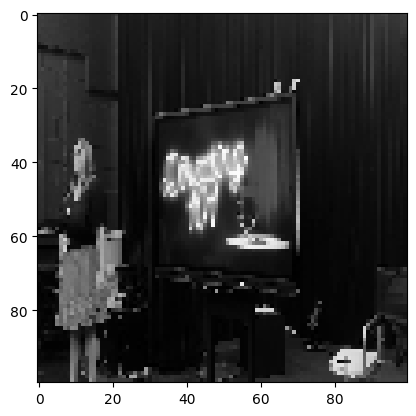

Confidence: [0.9377566]
JERMA LOCATED AT TIMESTAMP: 7761.553800000001


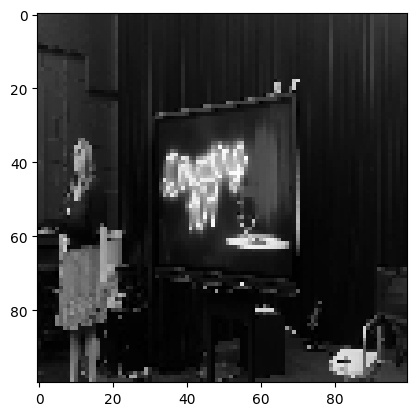

Confidence: [0.9394692]
JERMA LOCATED AT TIMESTAMP: 7761.587166666667


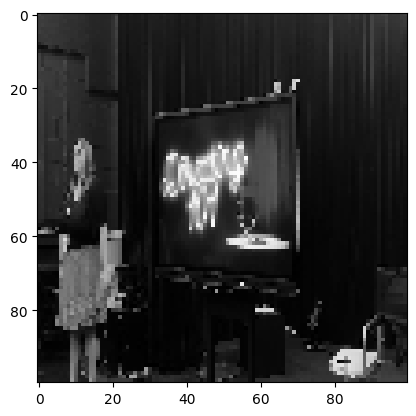

Confidence: [0.92981243]
JERMA LOCATED AT TIMESTAMP: 7761.620533333334


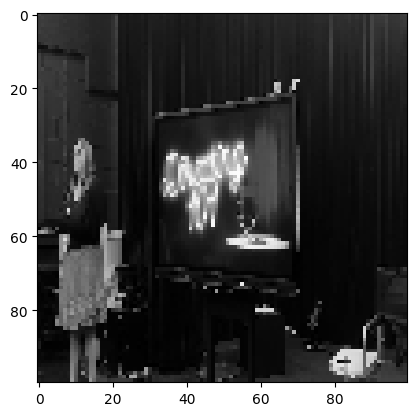

Confidence: [0.9327344]
JERMA LOCATED AT TIMESTAMP: 7761.6539


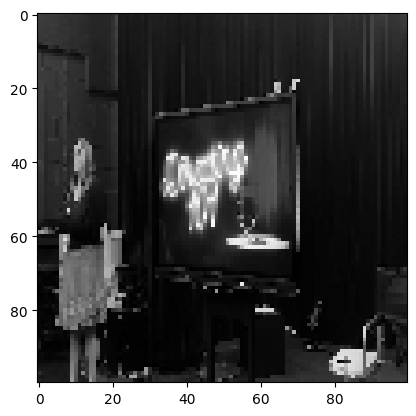

Confidence: [0.92886627]
JERMA LOCATED AT TIMESTAMP: 7761.687266666667


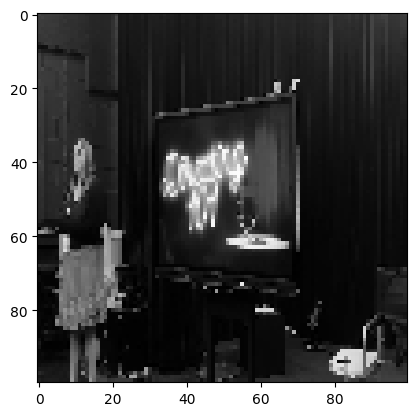

Confidence: [0.9414306]
JERMA LOCATED AT TIMESTAMP: 7761.720633333333


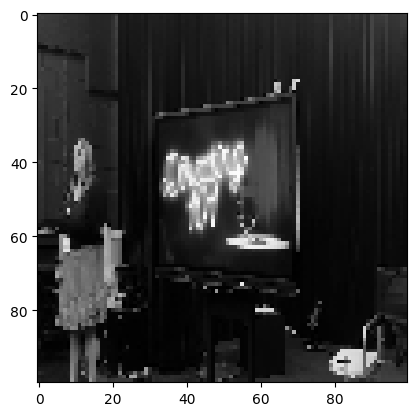

Confidence: [0.95213765]
JERMA LOCATED AT TIMESTAMP: 7761.754000000001


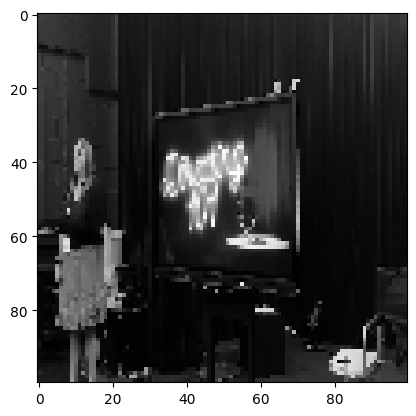

Confidence: [0.9363766]
JERMA LOCATED AT TIMESTAMP: 7761.787366666667


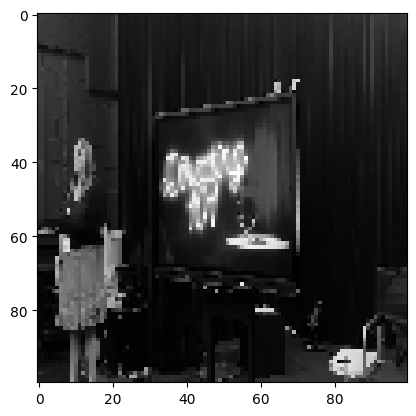

Confidence: [0.9486172]
JERMA LOCATED AT TIMESTAMP: 7761.820733333334


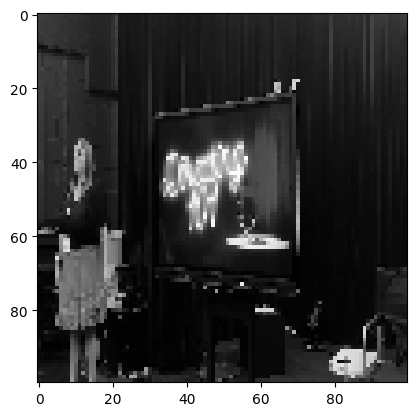

Confidence: [0.95191604]
JERMA LOCATED AT TIMESTAMP: 7761.8541000000005


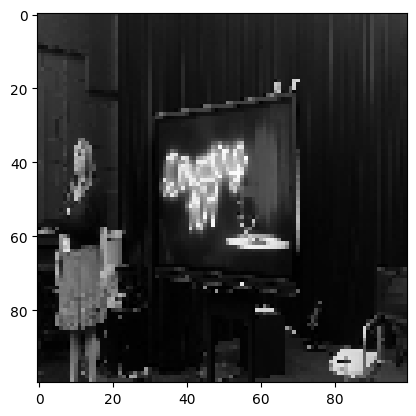

Confidence: [0.9481085]
JERMA LOCATED AT TIMESTAMP: 7761.887466666667


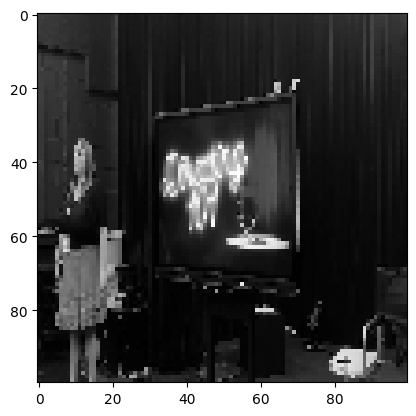

Confidence: [0.9462894]
JERMA LOCATED AT TIMESTAMP: 7761.920833333334


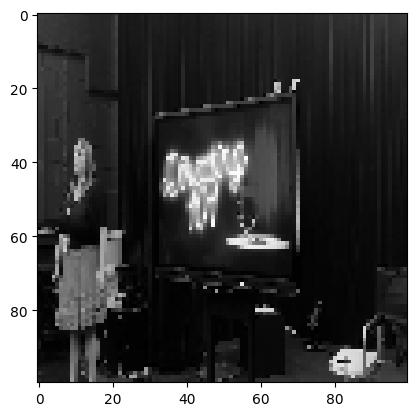

Confidence: [0.9440357]
JERMA LOCATED AT TIMESTAMP: 7761.9542


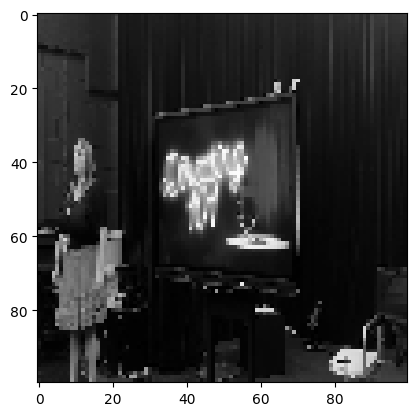

Confidence: [0.94674945]
JERMA LOCATED AT TIMESTAMP: 7761.987566666667


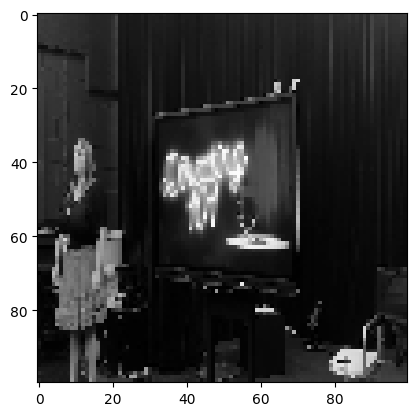

Confidence: [0.94468796]
JERMA LOCATED AT TIMESTAMP: 7762.020933333334


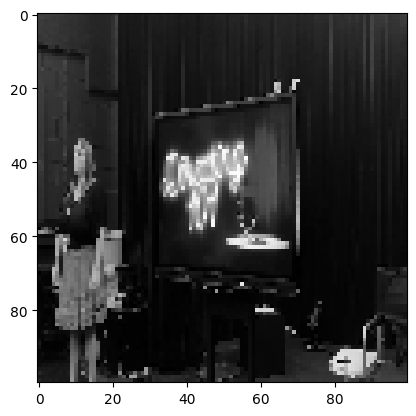

Confidence: [0.94430435]
JERMA LOCATED AT TIMESTAMP: 7762.054300000001


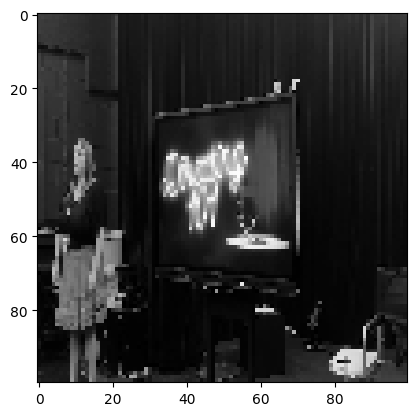

Confidence: [0.9410443]
JERMA LOCATED AT TIMESTAMP: 7762.087666666667


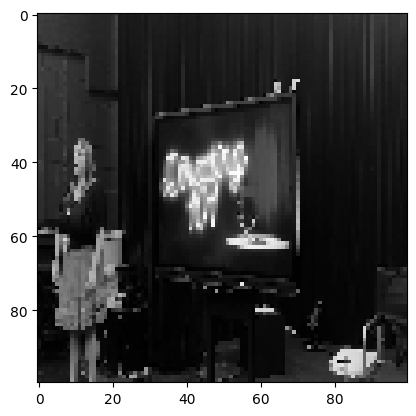

Confidence: [0.94729125]
JERMA LOCATED AT TIMESTAMP: 7762.121033333334


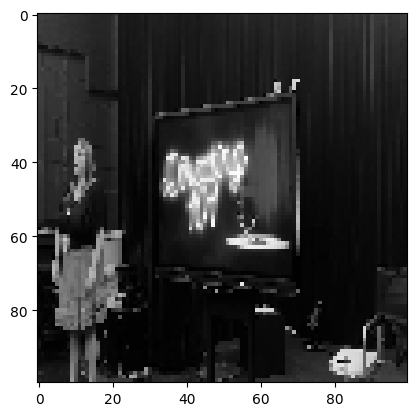

Confidence: [0.9506205]
JERMA LOCATED AT TIMESTAMP: 7762.1544


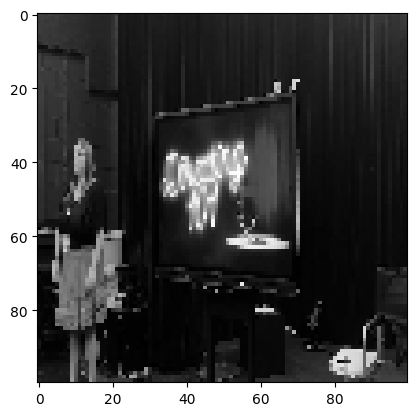

Confidence: [0.9434907]
JERMA LOCATED AT TIMESTAMP: 7762.187766666667


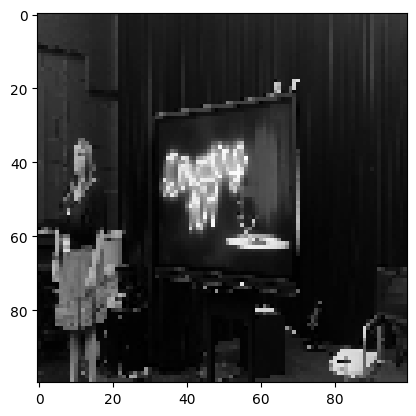

Confidence: [0.93666327]
JERMA LOCATED AT TIMESTAMP: 7762.2211333333335


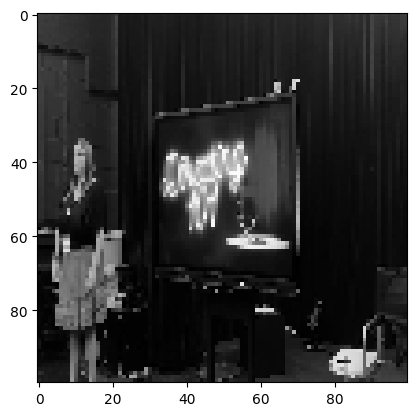

Confidence: [0.9451247]
JERMA LOCATED AT TIMESTAMP: 7762.2545


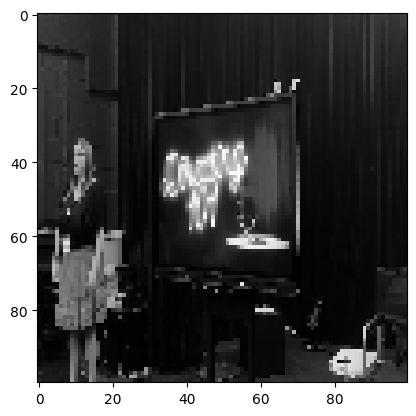

Confidence: [0.9429825]
JERMA LOCATED AT TIMESTAMP: 7762.2878666666675


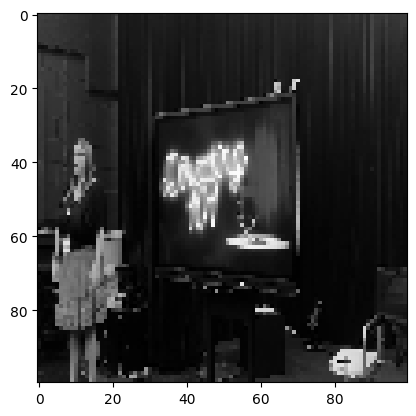

Confidence: [0.94130796]
JERMA LOCATED AT TIMESTAMP: 7762.321233333334


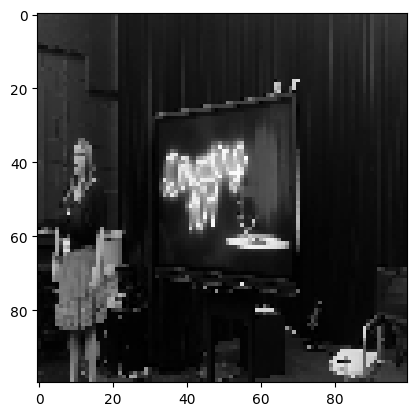

Confidence: [0.9386755]
JERMA LOCATED AT TIMESTAMP: 7762.354600000001


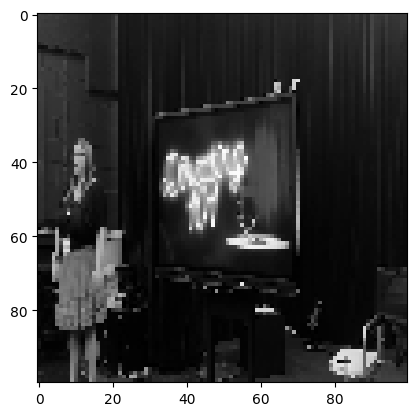

Confidence: [0.94273907]
JERMA LOCATED AT TIMESTAMP: 7762.387966666667


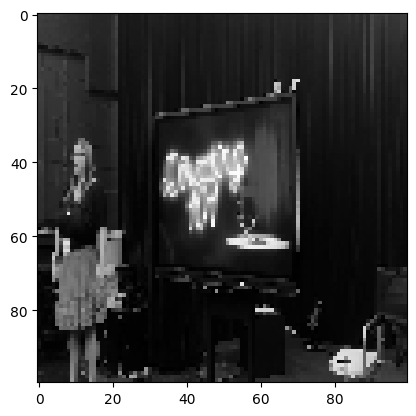

Confidence: [0.95031583]
JERMA LOCATED AT TIMESTAMP: 7762.421333333334


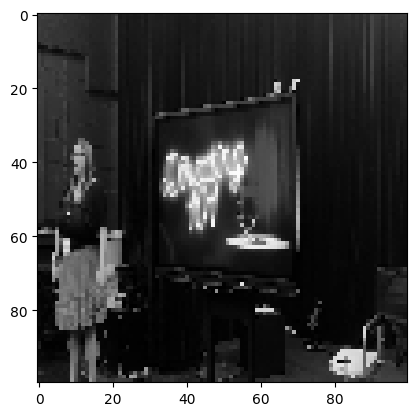

Confidence: [0.94475746]
JERMA LOCATED AT TIMESTAMP: 7762.4547


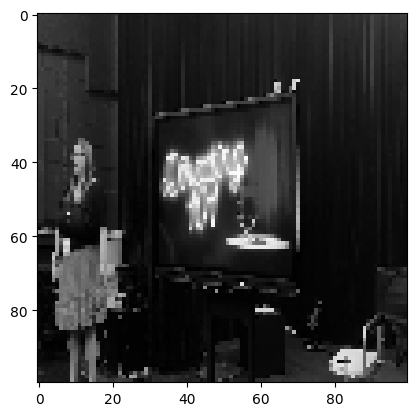

Confidence: [0.93856317]
JERMA LOCATED AT TIMESTAMP: 7762.488066666667


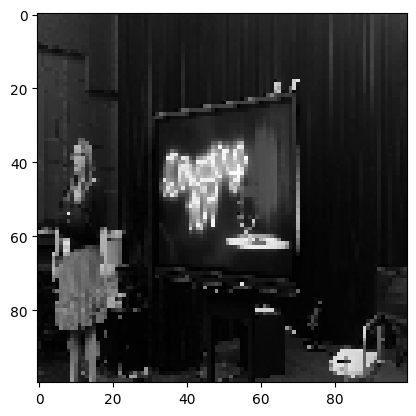

Confidence: [0.92584044]
JERMA LOCATED AT TIMESTAMP: 7762.521433333333


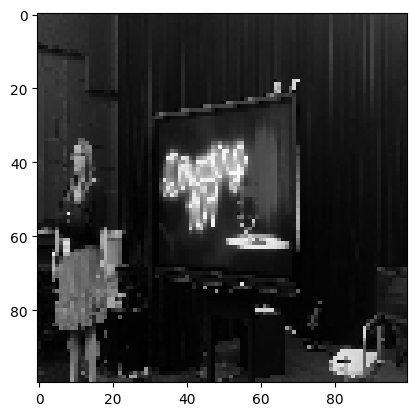

Confidence: [0.9296859]
JERMA LOCATED AT TIMESTAMP: 7762.554800000001


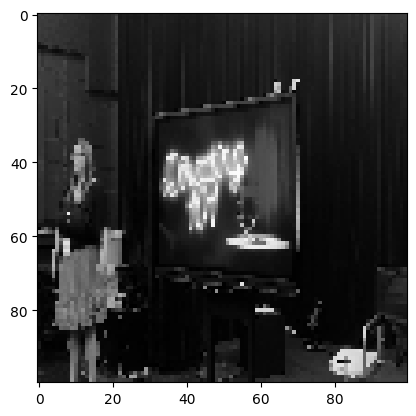

Confidence: [0.9346408]
JERMA LOCATED AT TIMESTAMP: 7762.588166666667


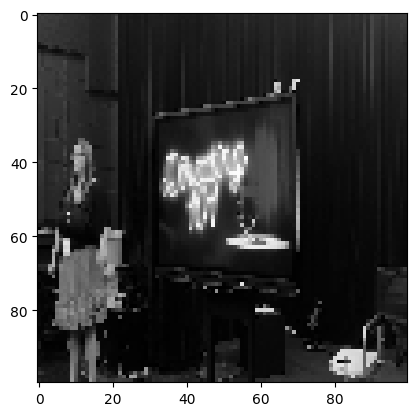

Confidence: [0.9274063]
JERMA LOCATED AT TIMESTAMP: 7762.621533333334


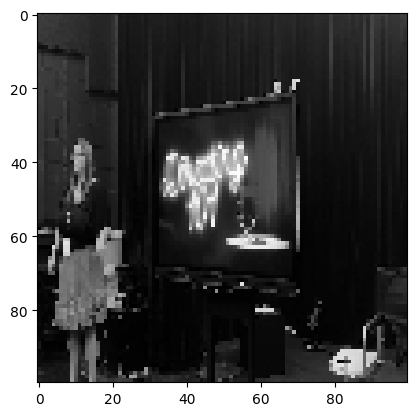

Confidence: [0.9484322]
JERMA LOCATED AT TIMESTAMP: 7762.6549


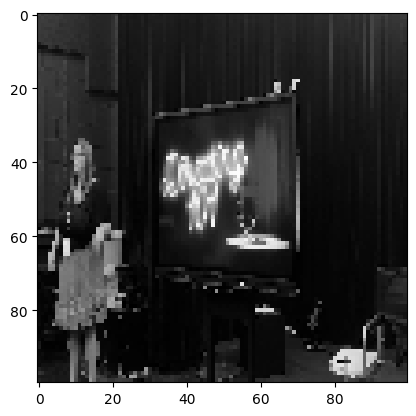

Confidence: [0.9579435]
JERMA LOCATED AT TIMESTAMP: 7762.688266666667


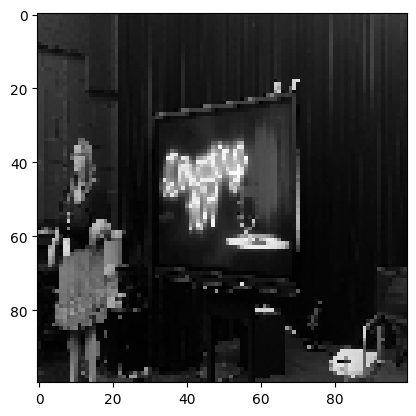

Confidence: [0.96013045]
JERMA LOCATED AT TIMESTAMP: 7762.721633333334


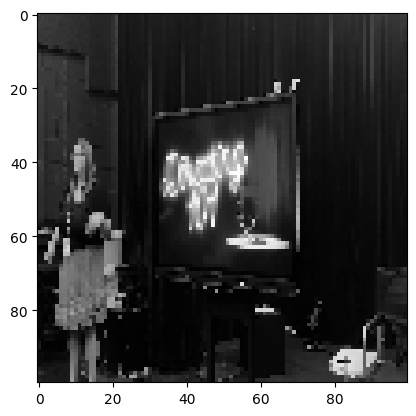

Confidence: [0.9572623]
JERMA LOCATED AT TIMESTAMP: 7762.755


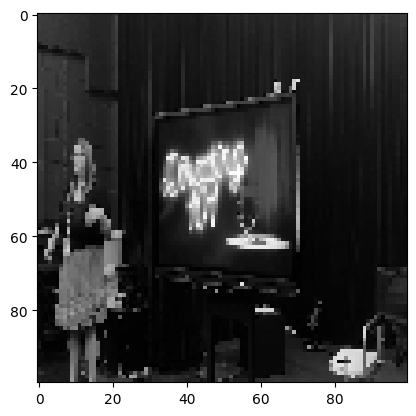

Confidence: [0.960291]
JERMA LOCATED AT TIMESTAMP: 7762.788366666667


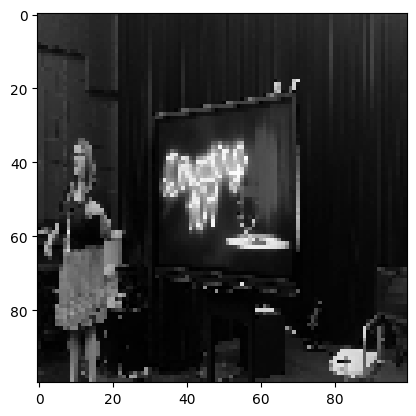

Confidence: [0.94516087]
JERMA LOCATED AT TIMESTAMP: 7762.821733333334


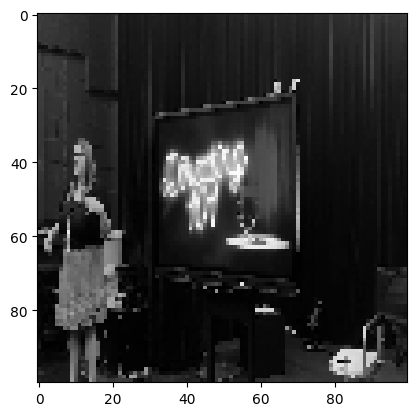

Confidence: [0.939772]
JERMA LOCATED AT TIMESTAMP: 7762.855100000001


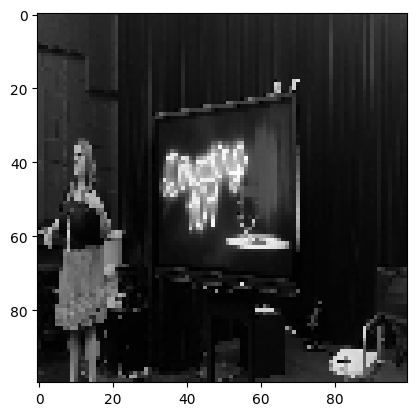

Confidence: [0.92736804]
JERMA LOCATED AT TIMESTAMP: 7762.888466666667


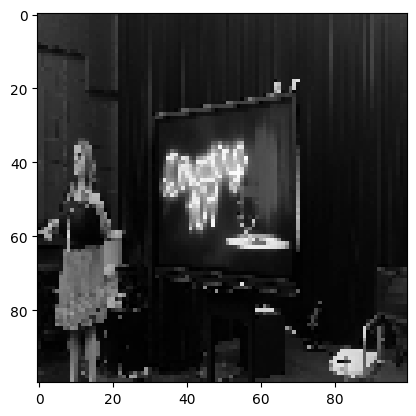

Confidence: [0.9311424]
JERMA LOCATED AT TIMESTAMP: 7762.921833333334


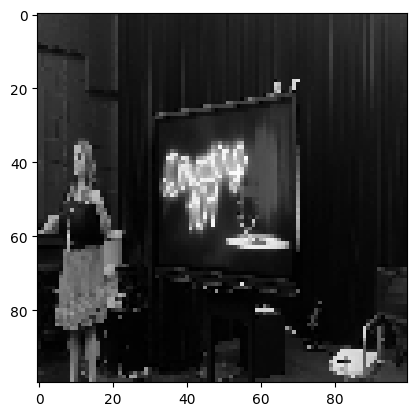

Confidence: [0.91526824]
JERMA LOCATED AT TIMESTAMP: 7762.9552


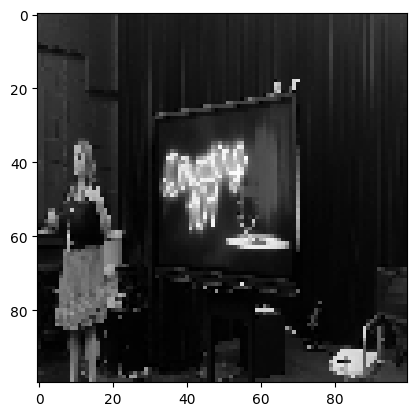

Confidence: [0.91340655]
JERMA LOCATED AT TIMESTAMP: 7762.988566666666


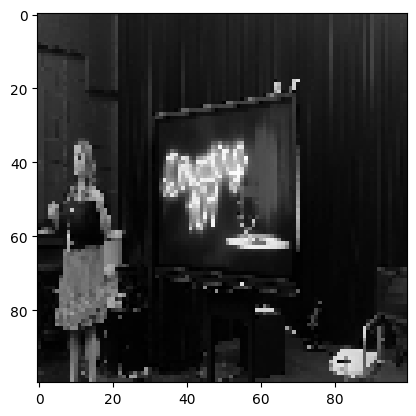

Confidence: [0.9222336]
JERMA LOCATED AT TIMESTAMP: 7763.021933333333


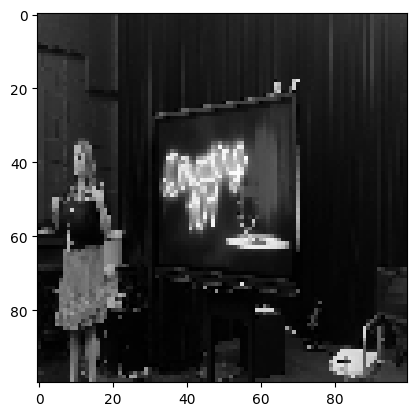

Confidence: [0.9027879]
JERMA LOCATED AT TIMESTAMP: 7763.0553


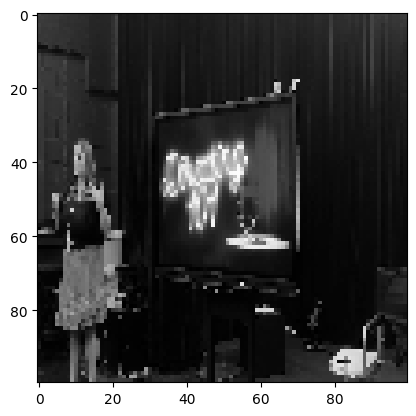

Confidence: [0.9033325]
JERMA LOCATED AT TIMESTAMP: 7763.088666666668


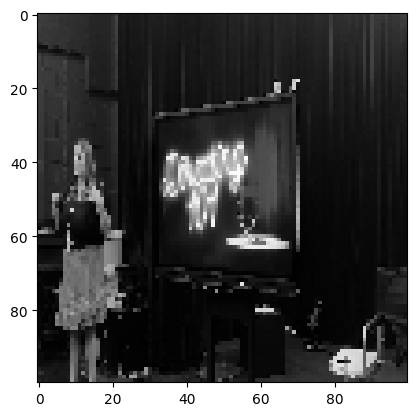

Confidence: [0.90019023]
JERMA LOCATED AT TIMESTAMP: 7763.122033333334


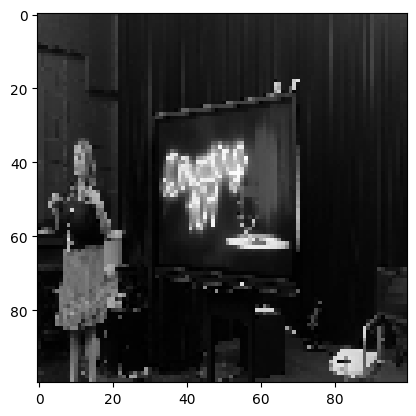

Confidence: [0.9266463]
JERMA LOCATED AT TIMESTAMP: 7763.155400000001


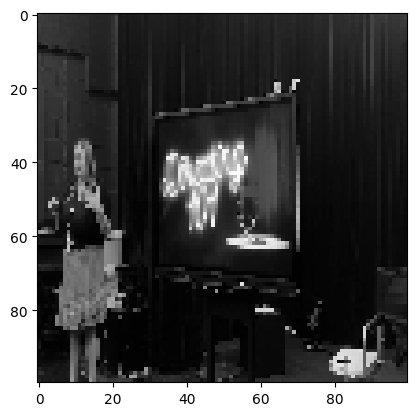

Confidence: [0.92533606]
JERMA LOCATED AT TIMESTAMP: 7763.5224333333335


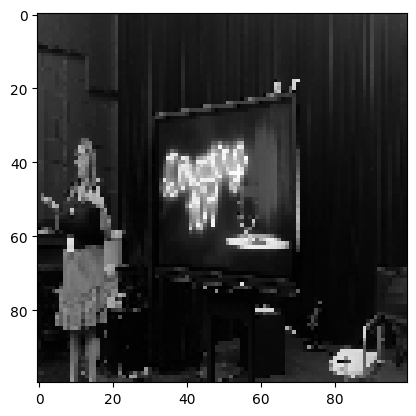

Confidence: [0.9356093]
JERMA LOCATED AT TIMESTAMP: 7763.5558


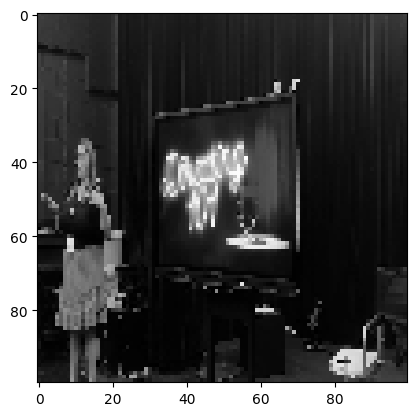

Confidence: [0.92540646]
JERMA LOCATED AT TIMESTAMP: 7763.589166666667


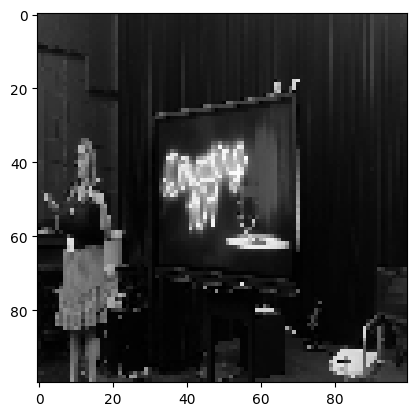

Confidence: [0.92757195]
JERMA LOCATED AT TIMESTAMP: 7763.622533333334


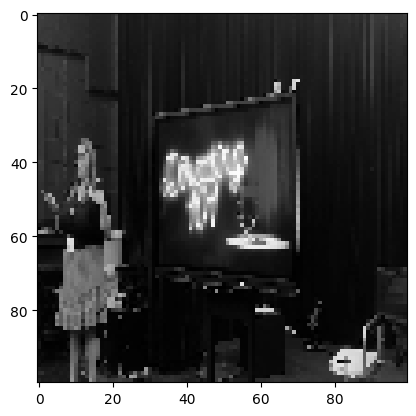

Confidence: [0.9247627]
JERMA LOCATED AT TIMESTAMP: 7763.655900000001


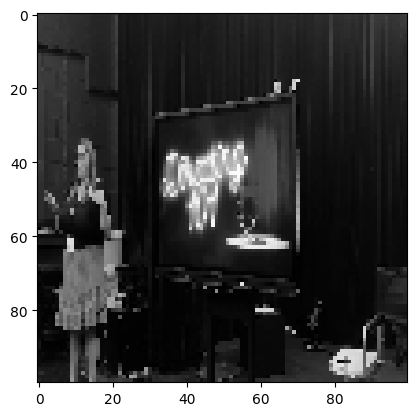

Confidence: [0.929422]
JERMA LOCATED AT TIMESTAMP: 7763.689266666667


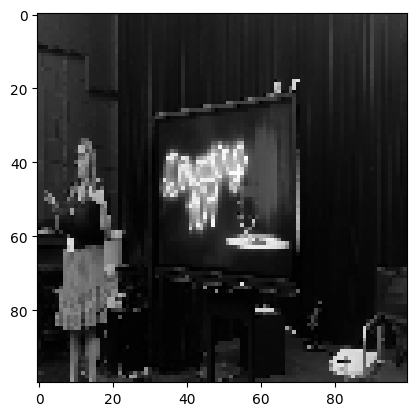

Confidence: [0.92697775]
JERMA LOCATED AT TIMESTAMP: 7763.722633333334


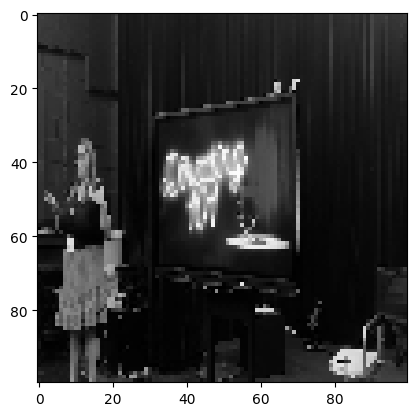

Confidence: [0.92959845]
JERMA LOCATED AT TIMESTAMP: 7763.756


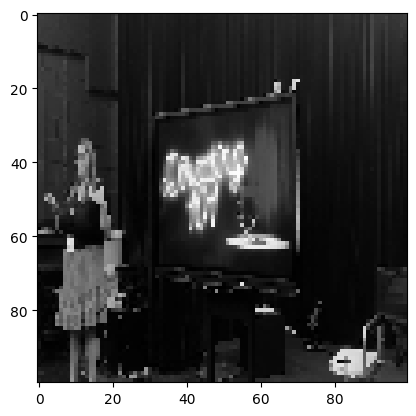

Confidence: [0.9331847]
JERMA LOCATED AT TIMESTAMP: 7763.789366666667


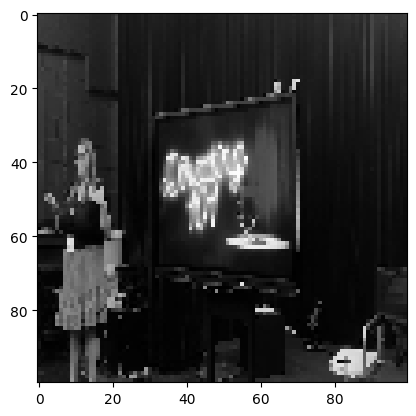

Confidence: [0.93705124]
JERMA LOCATED AT TIMESTAMP: 7763.822733333333


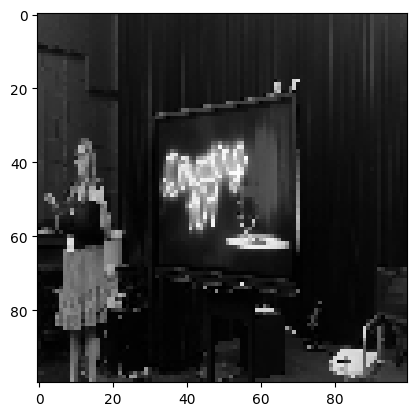

Confidence: [0.9371866]
JERMA LOCATED AT TIMESTAMP: 7763.8561


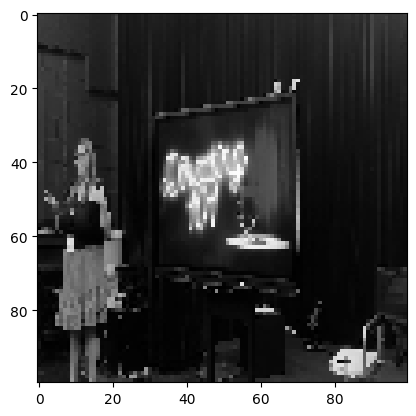

Confidence: [0.9248452]
JERMA LOCATED AT TIMESTAMP: 7763.889466666667


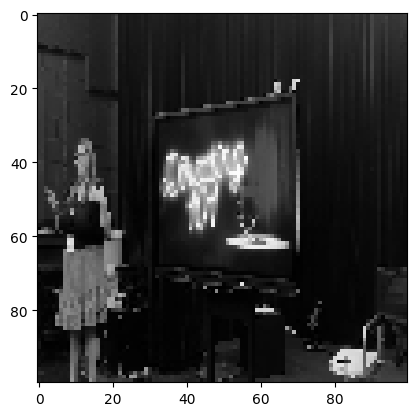

Confidence: [0.9113236]
JERMA LOCATED AT TIMESTAMP: 7763.922833333334


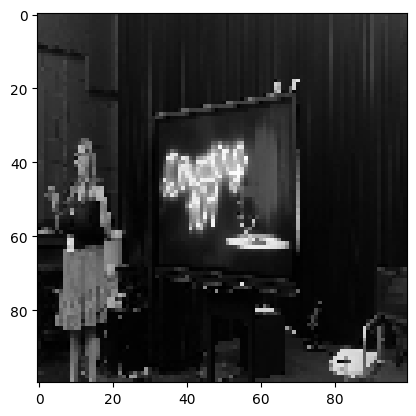

Confidence: [0.91673416]
JERMA LOCATED AT TIMESTAMP: 7764.0563


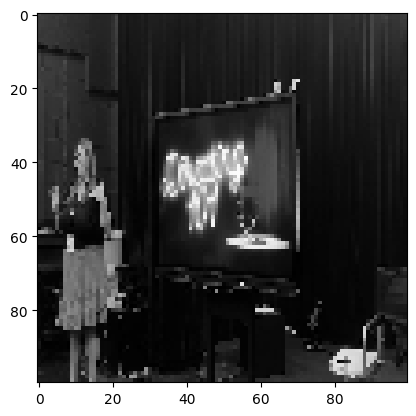

Confidence: [0.927572]
JERMA LOCATED AT TIMESTAMP: 7764.089666666667


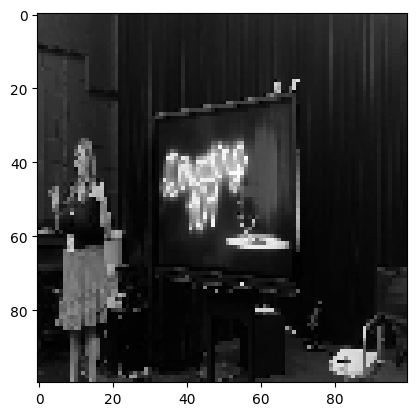

Confidence: [0.93489814]
JERMA LOCATED AT TIMESTAMP: 7764.123033333333


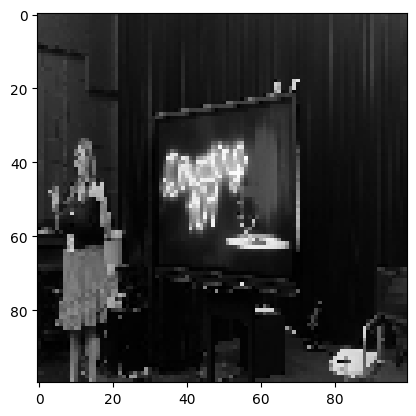

Confidence: [0.9292394]
JERMA LOCATED AT TIMESTAMP: 7764.156400000001


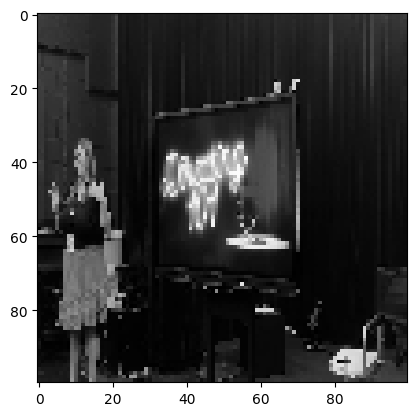

Confidence: [0.9231308]
JERMA LOCATED AT TIMESTAMP: 7764.189766666667


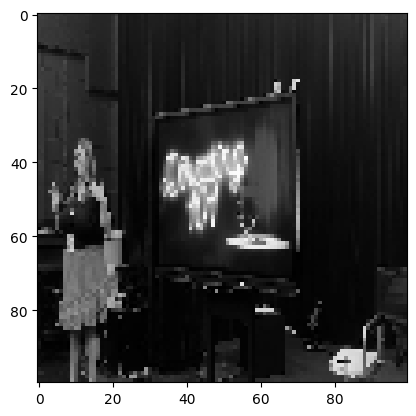

Confidence: [0.92834365]
JERMA LOCATED AT TIMESTAMP: 7764.223133333334


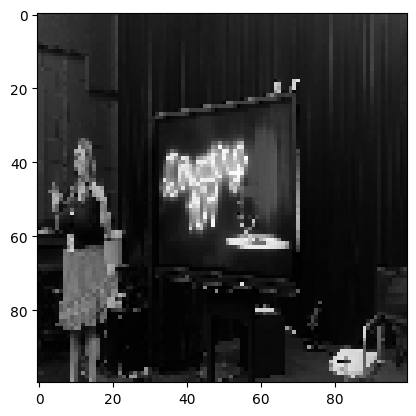

Confidence: [0.9286689]
JERMA LOCATED AT TIMESTAMP: 7764.2565


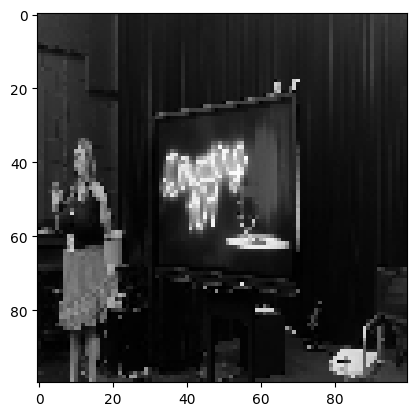

Confidence: [0.92945474]
JERMA LOCATED AT TIMESTAMP: 7764.289866666667


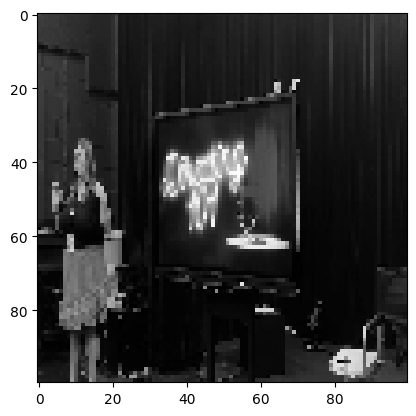

Confidence: [0.9327522]
JERMA LOCATED AT TIMESTAMP: 7764.3232333333335


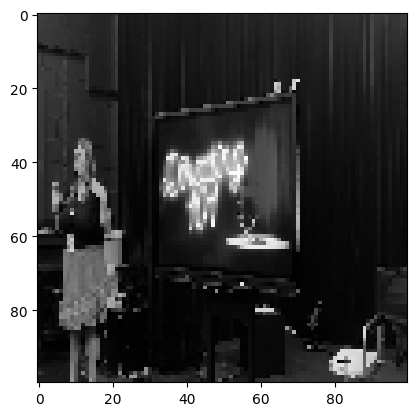

Confidence: [0.9567703]
JERMA LOCATED AT TIMESTAMP: 7764.3566


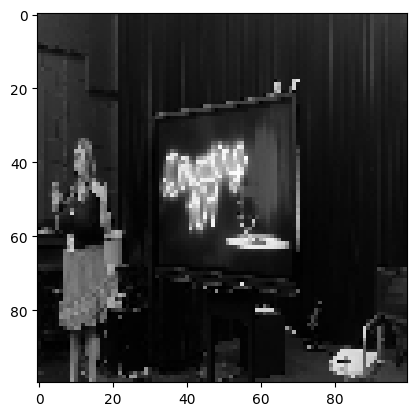

Confidence: [0.95095545]
JERMA LOCATED AT TIMESTAMP: 7764.389966666667


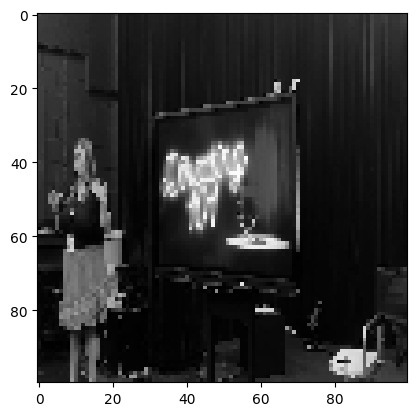

Confidence: [0.93073094]
JERMA LOCATED AT TIMESTAMP: 7764.423333333334


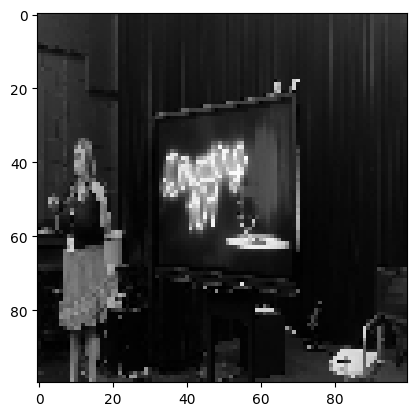

Confidence: [0.9018747]
JERMA LOCATED AT TIMESTAMP: 7764.456700000001


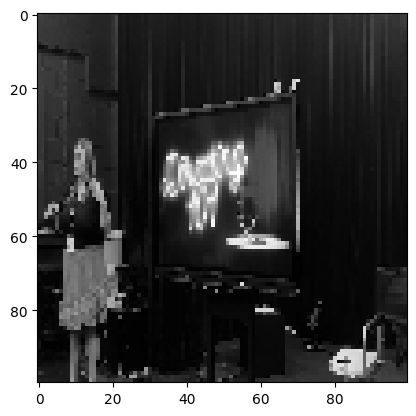

Confidence: [0.9475865]
JERMA LOCATED AT TIMESTAMP: 7764.490066666667


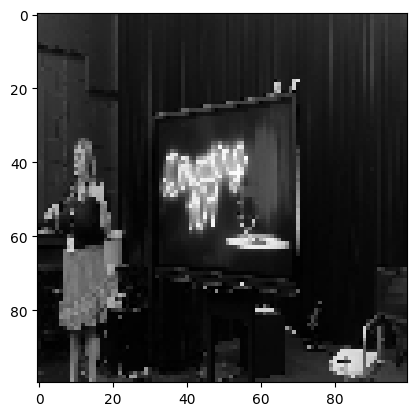

Confidence: [0.90203995]
JERMA LOCATED AT TIMESTAMP: 7764.523433333334


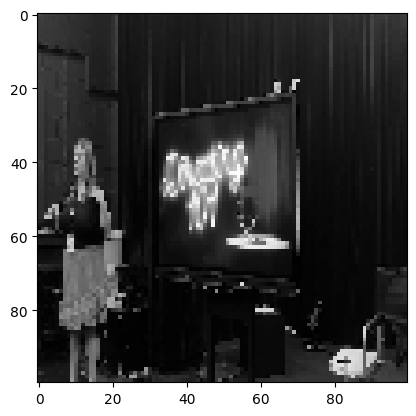

Confidence: [0.9121424]
JERMA LOCATED AT TIMESTAMP: 7764.5568


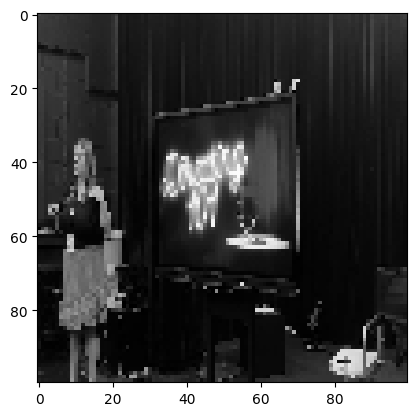

Confidence: [0.9230536]
JERMA LOCATED AT TIMESTAMP: 7764.590166666667


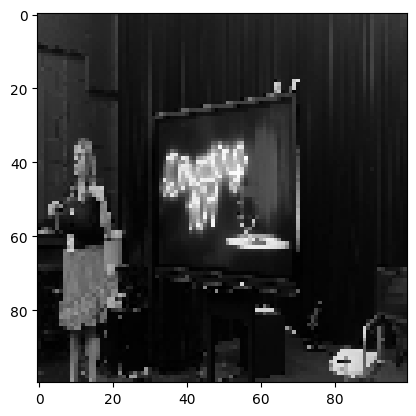

Confidence: [0.9233744]
JERMA LOCATED AT TIMESTAMP: 7764.623533333333


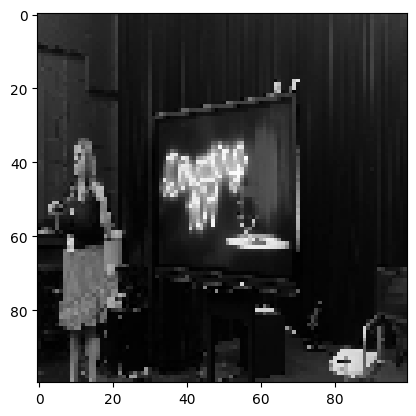

Confidence: [0.9163465]
JERMA LOCATED AT TIMESTAMP: 7764.690266666667


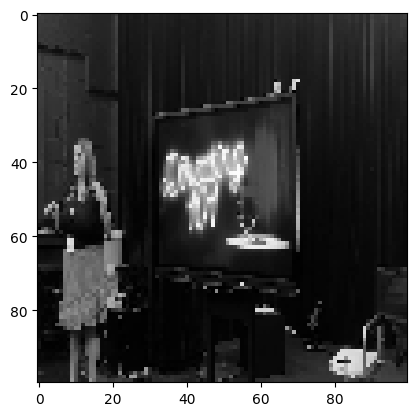

Confidence: [0.9169514]
JERMA LOCATED AT TIMESTAMP: 7764.723633333334


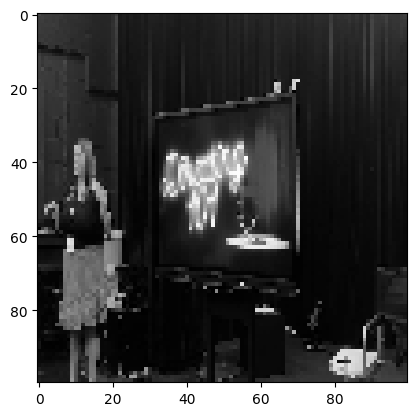

Confidence: [0.91886437]
JERMA LOCATED AT TIMESTAMP: 7765.1574


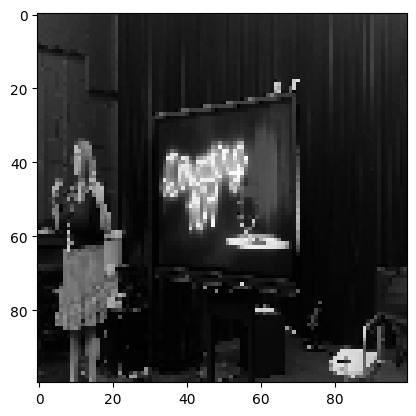

Confidence: [0.9331781]
JERMA LOCATED AT TIMESTAMP: 7765.190766666667


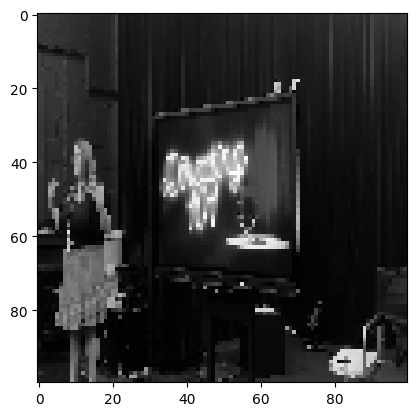

Confidence: [0.90157586]
JERMA LOCATED AT TIMESTAMP: 7765.3576


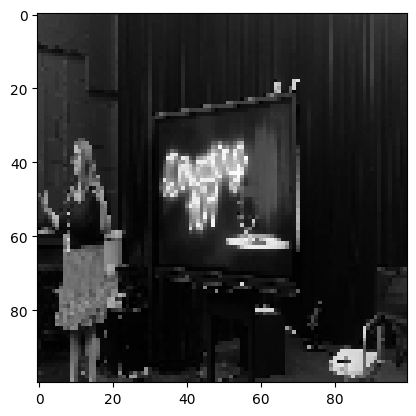

Confidence: [0.90491945]
JERMA LOCATED AT TIMESTAMP: 7765.724633333333


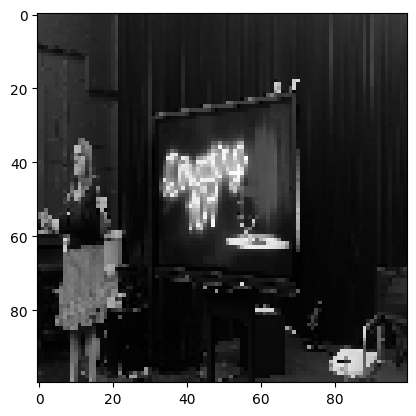

Confidence: [0.9219086]
JERMA LOCATED AT TIMESTAMP: 7765.758000000001


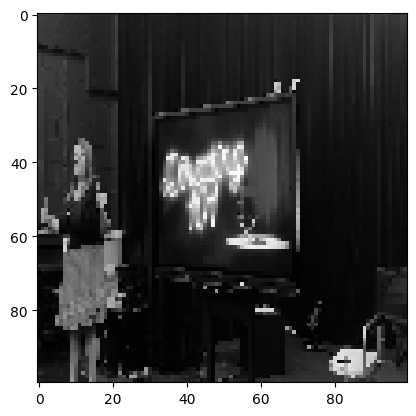

Confidence: [0.92630124]
JERMA LOCATED AT TIMESTAMP: 7765.791366666667


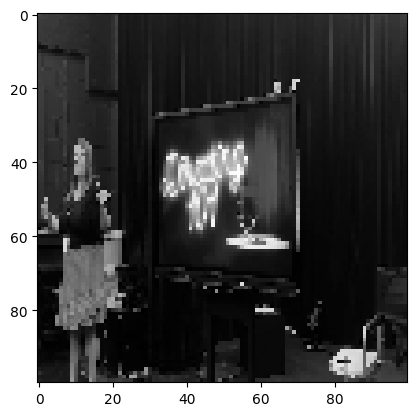

Confidence: [0.94420093]
JERMA LOCATED AT TIMESTAMP: 7765.824733333334


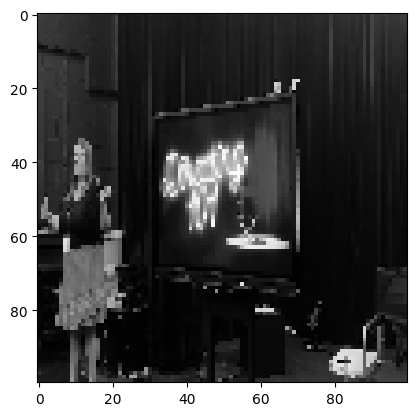

Confidence: [0.94539434]
JERMA LOCATED AT TIMESTAMP: 7765.8581


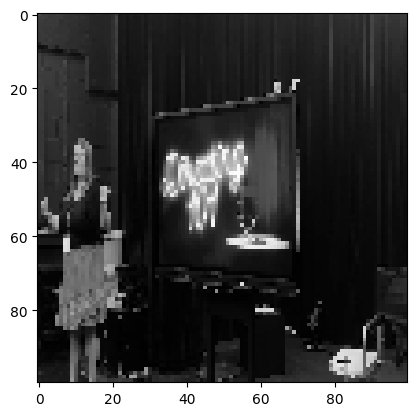

Confidence: [0.9483366]
JERMA LOCATED AT TIMESTAMP: 7765.891466666667


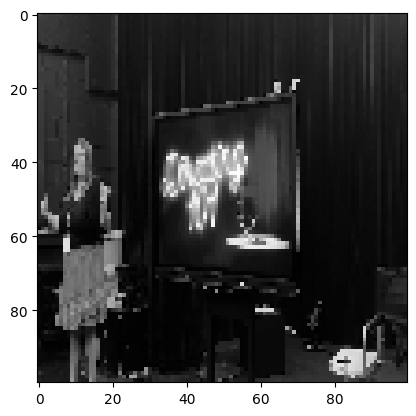

Confidence: [0.9529335]
JERMA LOCATED AT TIMESTAMP: 7765.924833333333


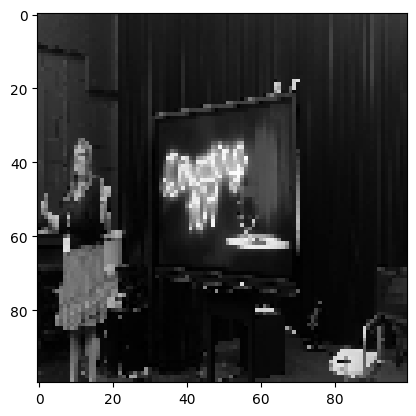

Confidence: [0.92039186]
JERMA LOCATED AT TIMESTAMP: 7766.024933333333


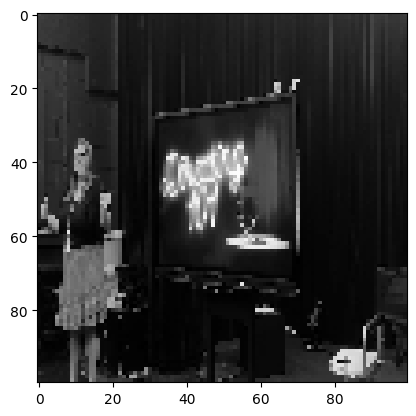

Confidence: [0.9149227]
JERMA LOCATED AT TIMESTAMP: 7766.058300000001


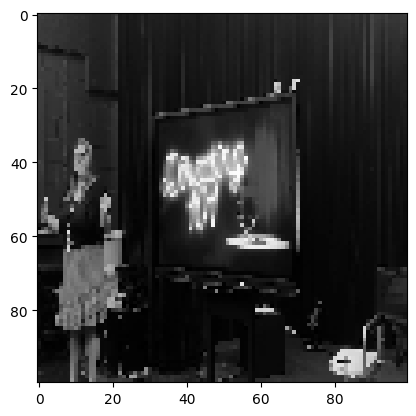

Confidence: [0.9146016]
JERMA LOCATED AT TIMESTAMP: 7766.1584


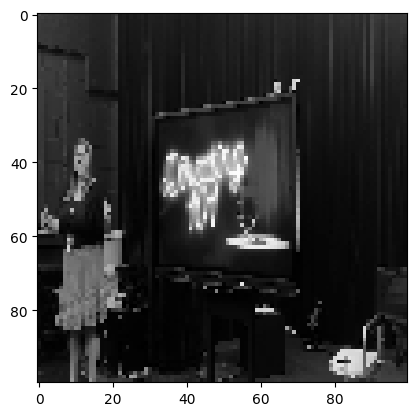

Confidence: [0.908609]
JERMA LOCATED AT TIMESTAMP: 7766.191766666667


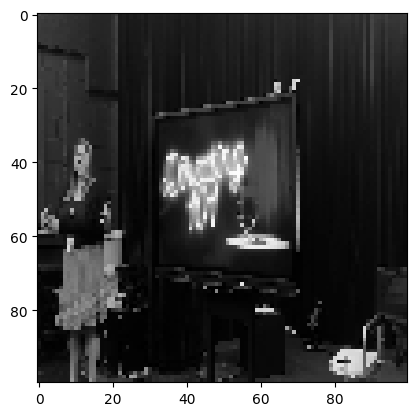

Confidence: [0.9219972]
JERMA LOCATED AT TIMESTAMP: 7766.291866666667


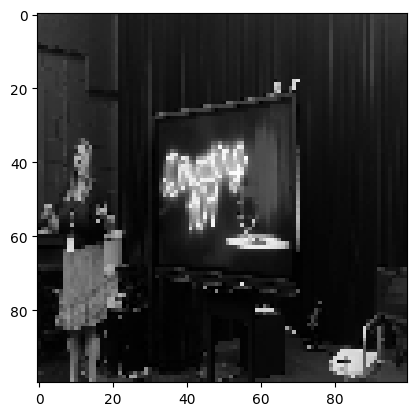

Confidence: [0.91547406]
JERMA LOCATED AT TIMESTAMP: 7766.325233333334


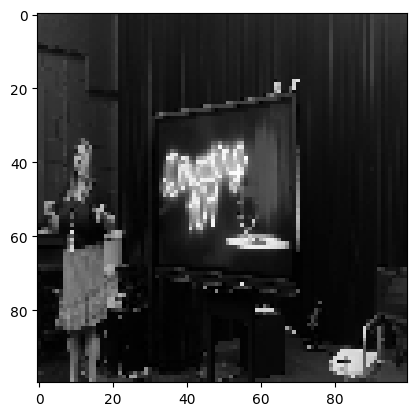

Confidence: [0.9319177]
JERMA LOCATED AT TIMESTAMP: 7766.3586000000005


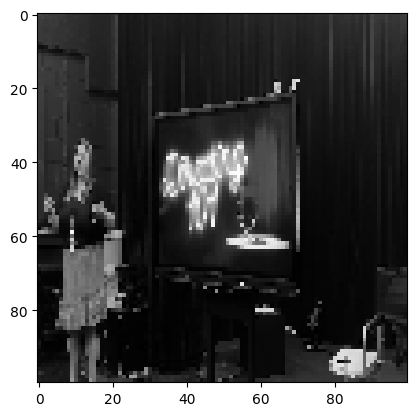

Confidence: [0.92073554]
JERMA LOCATED AT TIMESTAMP: 7766.391966666667


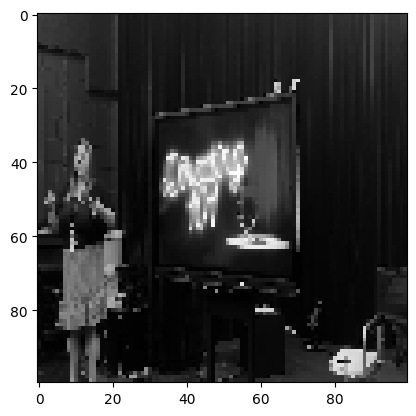

Confidence: [0.9366714]
JERMA LOCATED AT TIMESTAMP: 7766.425333333334


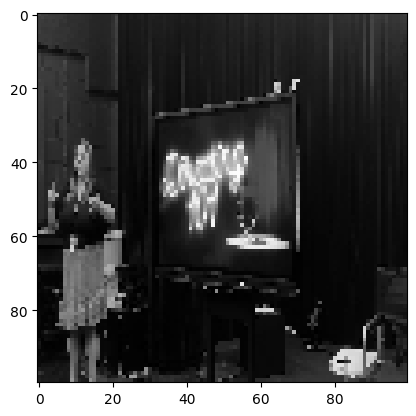

Confidence: [0.94116044]
JERMA LOCATED AT TIMESTAMP: 7766.4587


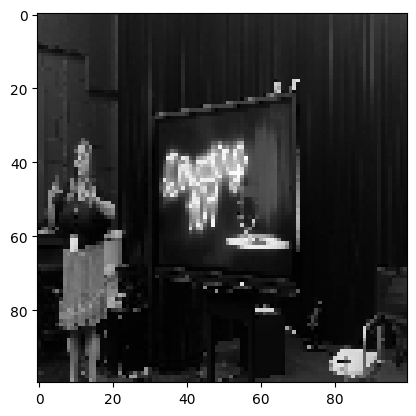

Confidence: [0.9579687]
JERMA LOCATED AT TIMESTAMP: 7766.492066666667


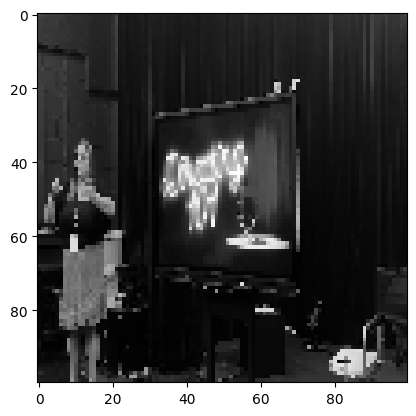

Confidence: [0.9719624]
JERMA LOCATED AT TIMESTAMP: 7766.525433333334


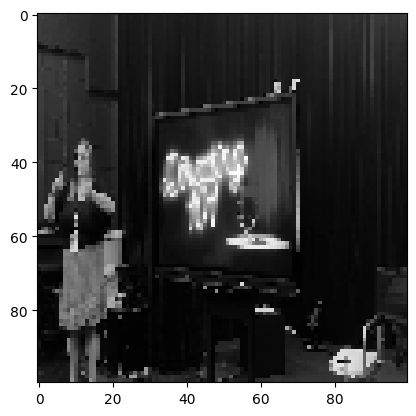

Confidence: [0.97317713]
JERMA LOCATED AT TIMESTAMP: 7766.558800000001


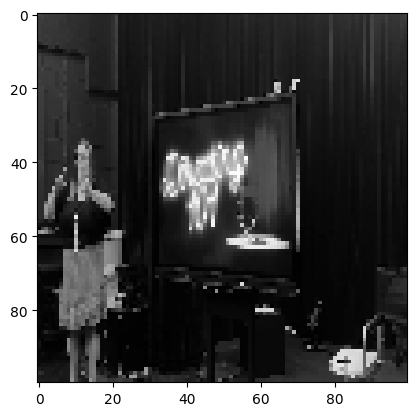

Confidence: [0.96433896]
JERMA LOCATED AT TIMESTAMP: 7766.592166666667


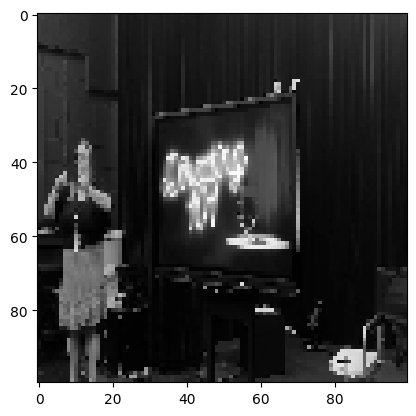

Confidence: [0.974647]
JERMA LOCATED AT TIMESTAMP: 7766.625533333334


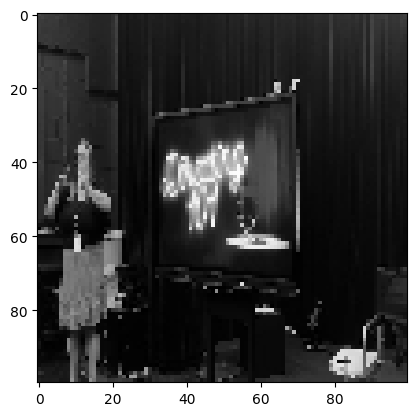

Confidence: [0.96753156]
JERMA LOCATED AT TIMESTAMP: 7766.6589


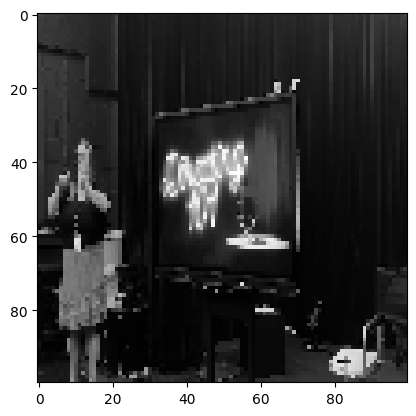

Confidence: [0.9692248]
JERMA LOCATED AT TIMESTAMP: 7766.692266666667


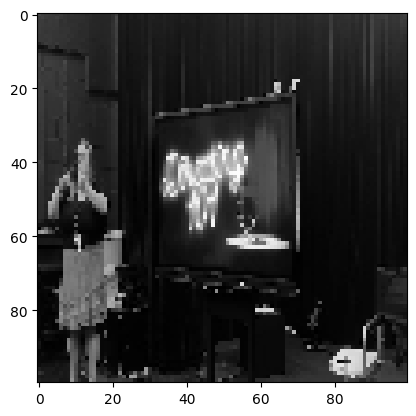

Confidence: [0.9709927]
JERMA LOCATED AT TIMESTAMP: 7766.7256333333335


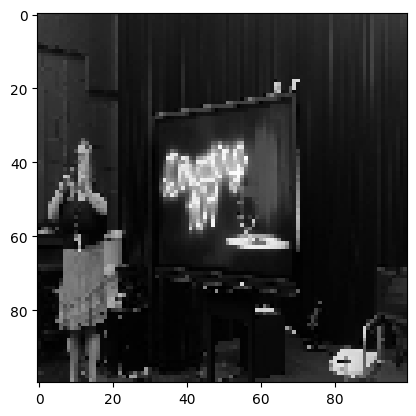

Confidence: [0.9635198]
JERMA LOCATED AT TIMESTAMP: 7766.759


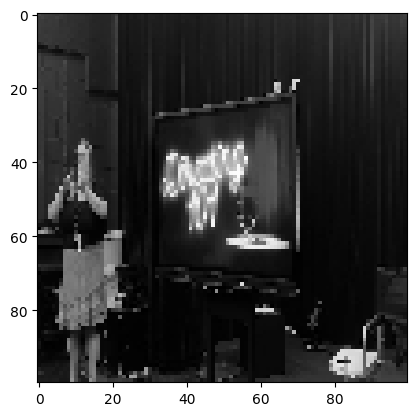

Confidence: [0.96294194]
JERMA LOCATED AT TIMESTAMP: 7766.7923666666675


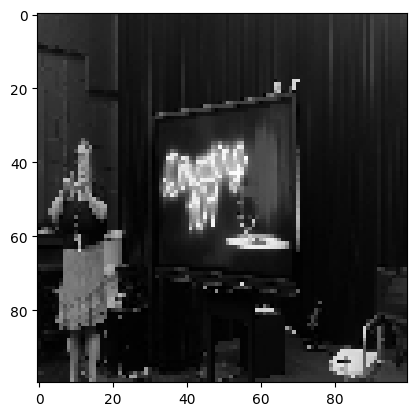

Confidence: [0.956779]
JERMA LOCATED AT TIMESTAMP: 7766.825733333334


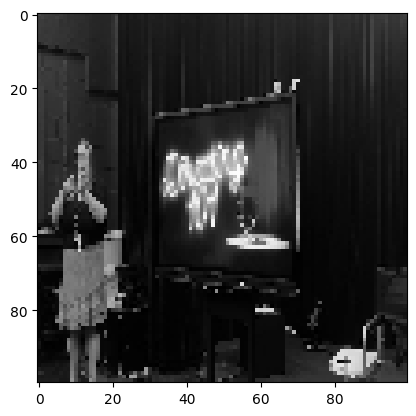

Confidence: [0.9514122]
JERMA LOCATED AT TIMESTAMP: 7766.859100000001


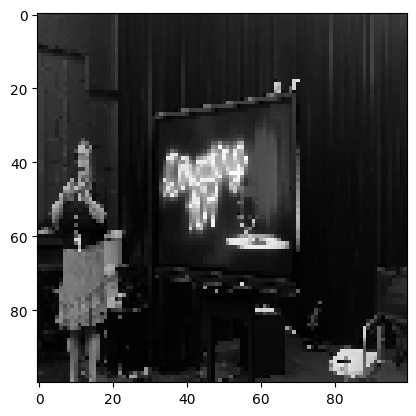

Confidence: [0.9685732]
JERMA LOCATED AT TIMESTAMP: 7766.892466666667


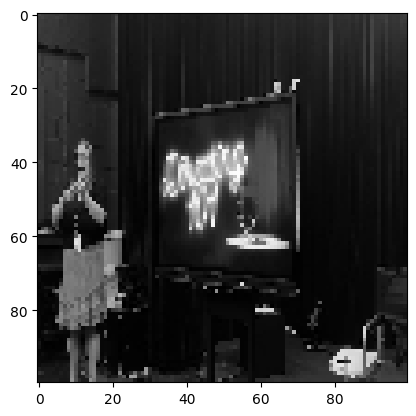

Confidence: [0.9636156]
JERMA LOCATED AT TIMESTAMP: 7766.925833333334


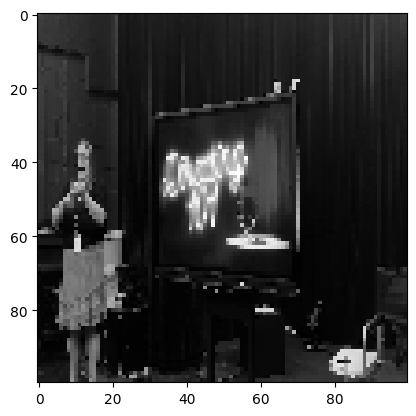

Confidence: [0.9576668]
JERMA LOCATED AT TIMESTAMP: 7766.9592


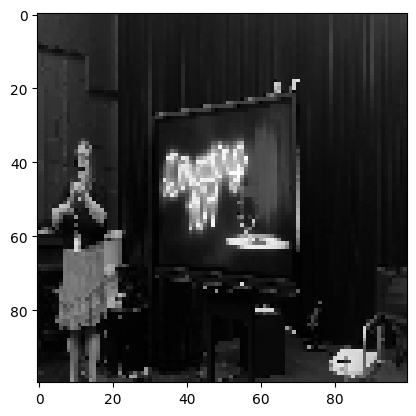

Confidence: [0.9640155]
JERMA LOCATED AT TIMESTAMP: 7766.992566666667


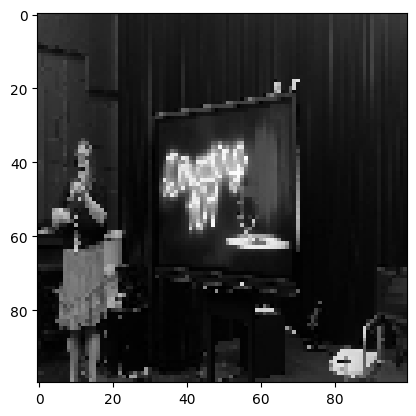

Confidence: [0.95880425]
JERMA LOCATED AT TIMESTAMP: 7767.025933333333


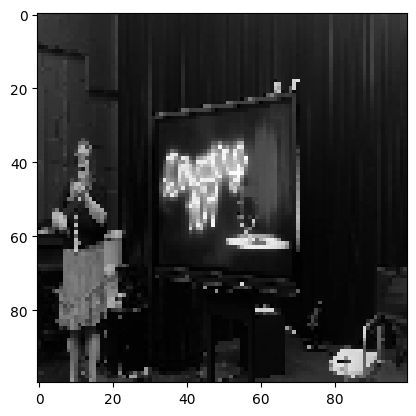

Confidence: [0.94298595]
JERMA LOCATED AT TIMESTAMP: 7767.059300000001


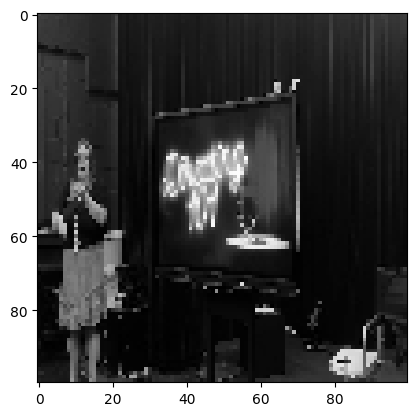

Confidence: [0.95063335]
JERMA LOCATED AT TIMESTAMP: 7767.092666666667


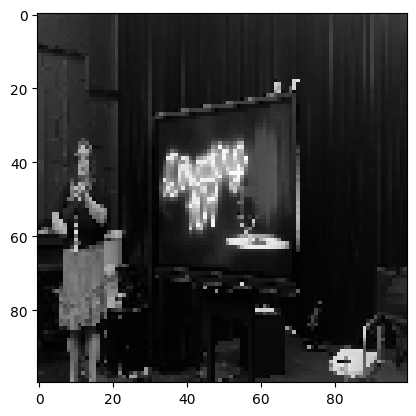

Confidence: [0.959635]
JERMA LOCATED AT TIMESTAMP: 7767.126033333334


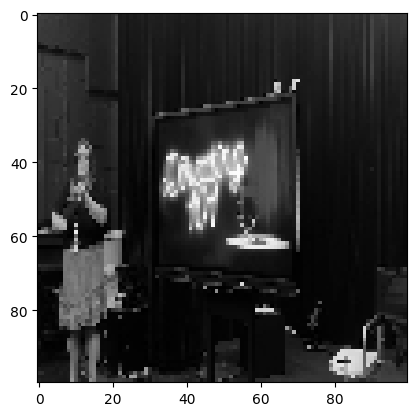

Confidence: [0.9527935]
JERMA LOCATED AT TIMESTAMP: 7767.1594000000005


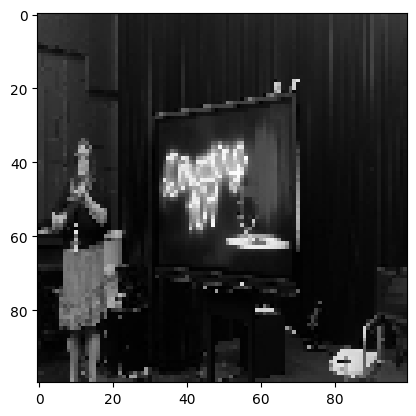

Confidence: [0.94885707]
JERMA LOCATED AT TIMESTAMP: 7767.192766666667


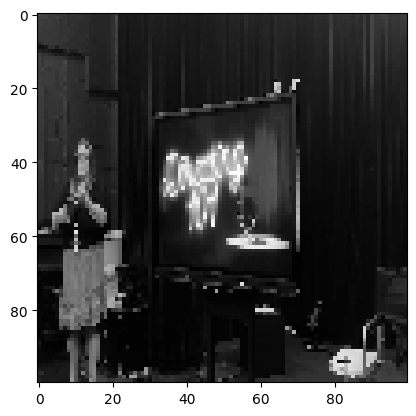

Confidence: [0.93814707]
JERMA LOCATED AT TIMESTAMP: 7767.226133333334


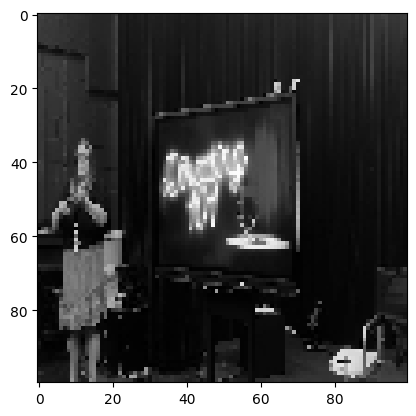

Confidence: [0.94415486]
JERMA LOCATED AT TIMESTAMP: 7767.2595


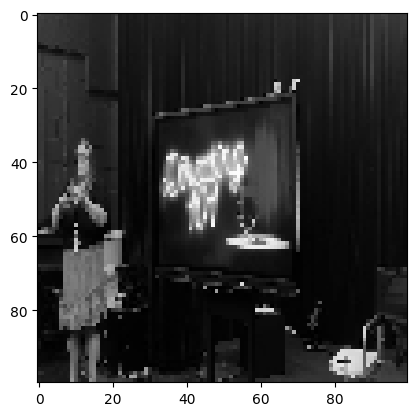

Confidence: [0.9352957]
JERMA LOCATED AT TIMESTAMP: 7767.292866666667


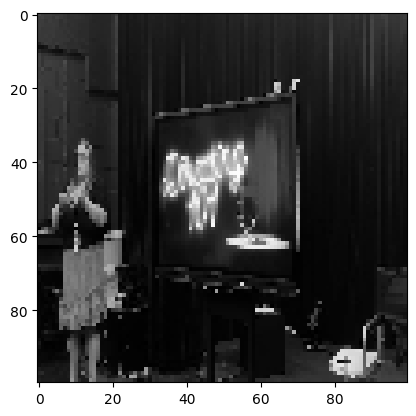

Confidence: [0.9535246]
JERMA LOCATED AT TIMESTAMP: 7767.326233333334


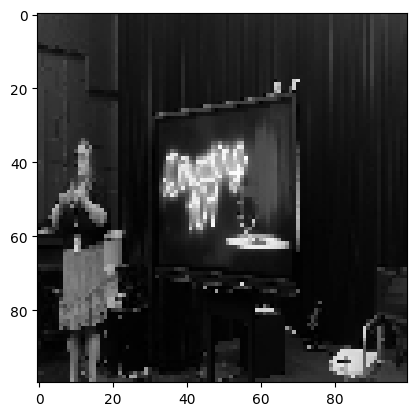

Confidence: [0.962478]
JERMA LOCATED AT TIMESTAMP: 7767.359600000001


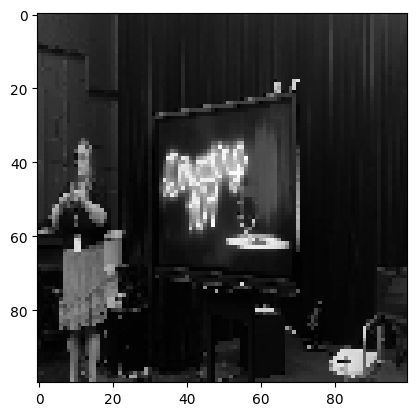

Confidence: [0.96103]
JERMA LOCATED AT TIMESTAMP: 7767.392966666667


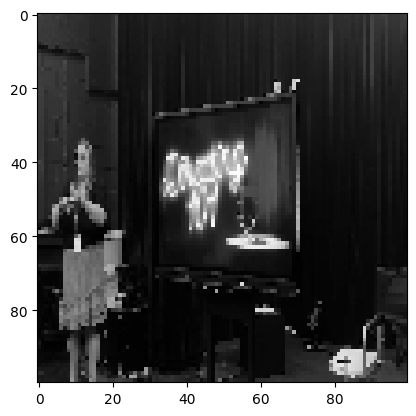

Confidence: [0.96349937]
JERMA LOCATED AT TIMESTAMP: 7767.426333333334


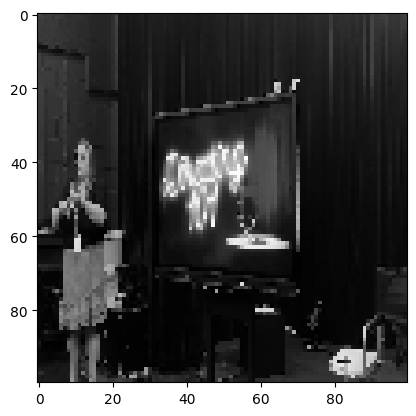

Confidence: [0.96760285]
JERMA LOCATED AT TIMESTAMP: 7767.4597


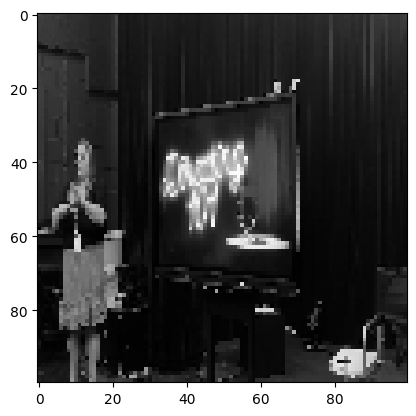

Confidence: [0.96896434]
JERMA LOCATED AT TIMESTAMP: 7767.493066666668


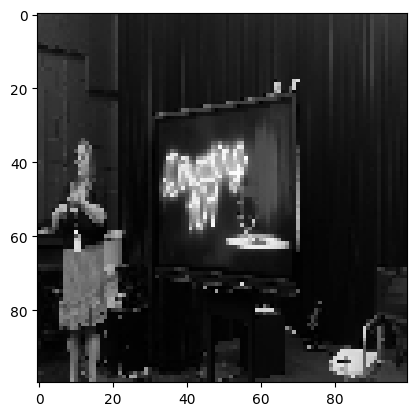

Confidence: [0.97226995]
JERMA LOCATED AT TIMESTAMP: 7767.526433333333


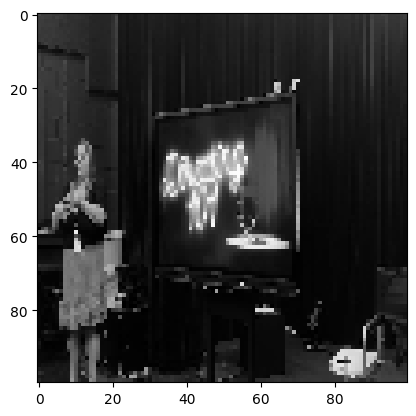

Confidence: [0.9667623]
JERMA LOCATED AT TIMESTAMP: 7767.5598


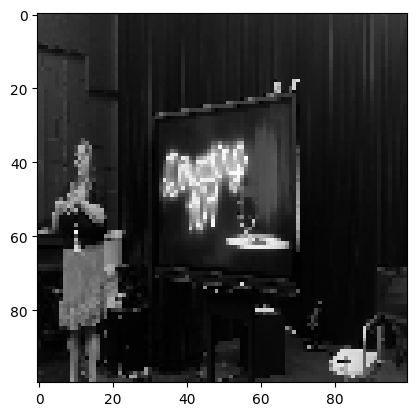

Confidence: [0.9522718]
JERMA LOCATED AT TIMESTAMP: 7767.5931666666675


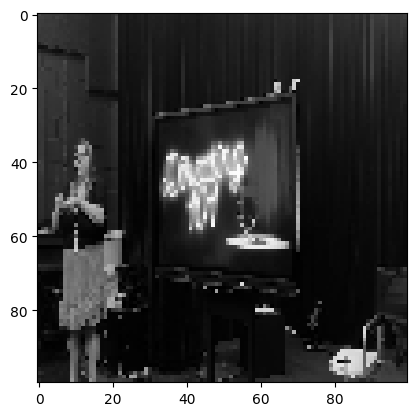

Confidence: [0.9371159]
JERMA LOCATED AT TIMESTAMP: 7767.626533333334


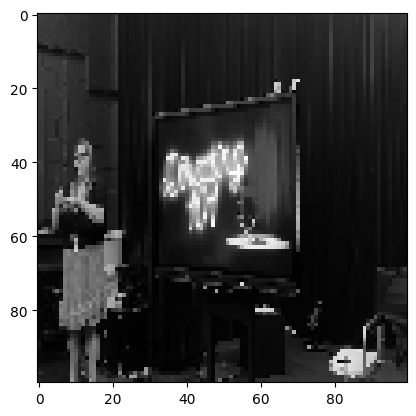

Confidence: [0.9291307]
JERMA LOCATED AT TIMESTAMP: 7767.659900000001


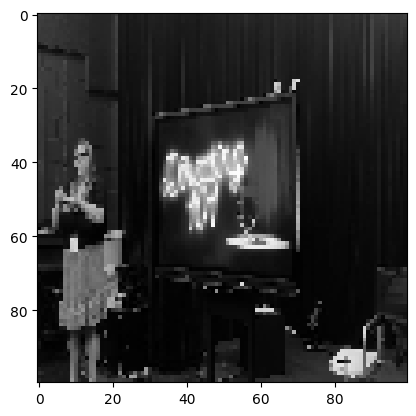

Confidence: [0.9349057]
JERMA LOCATED AT TIMESTAMP: 7767.693266666667


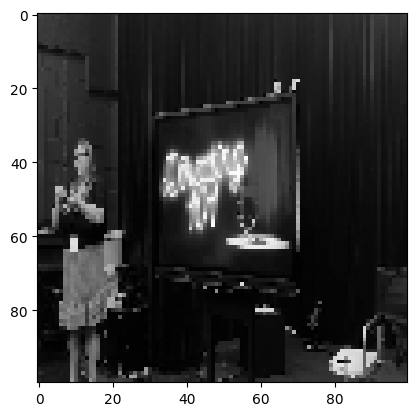

Confidence: [0.9346209]
JERMA LOCATED AT TIMESTAMP: 7767.726633333334


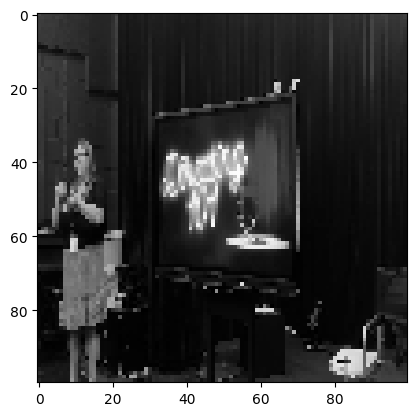

Confidence: [0.9284183]
JERMA LOCATED AT TIMESTAMP: 7767.76


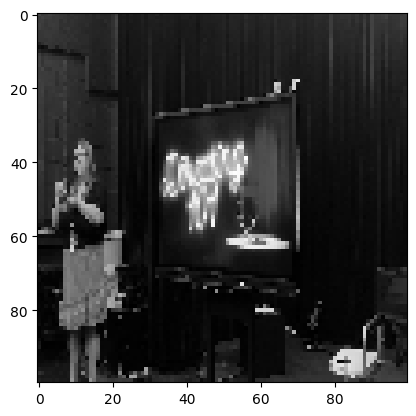

Confidence: [0.9301011]
JERMA LOCATED AT TIMESTAMP: 7767.793366666667


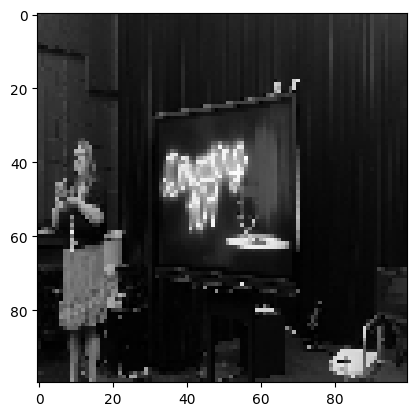

Confidence: [0.9228607]
JERMA LOCATED AT TIMESTAMP: 7767.826733333333


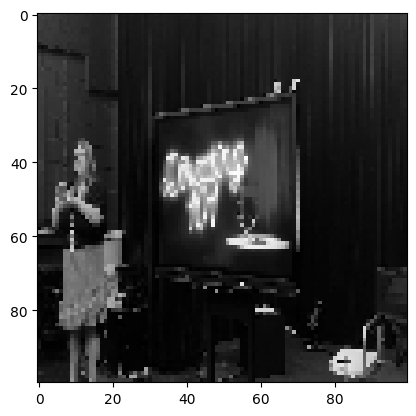

Confidence: [0.9193268]
JERMA LOCATED AT TIMESTAMP: 7767.860100000001


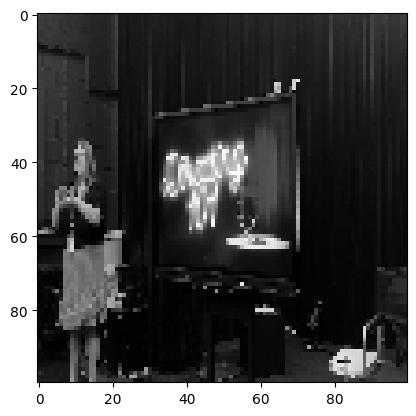

Confidence: [0.9207753]
JERMA LOCATED AT TIMESTAMP: 7767.893466666667


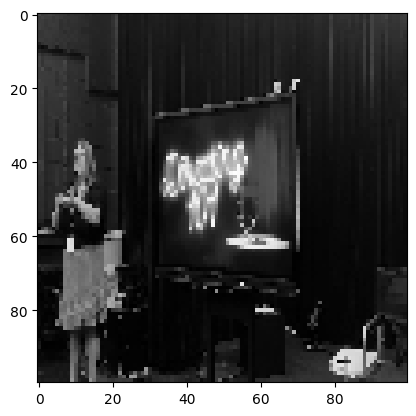

Confidence: [0.91607934]
JERMA LOCATED AT TIMESTAMP: 7767.926833333334


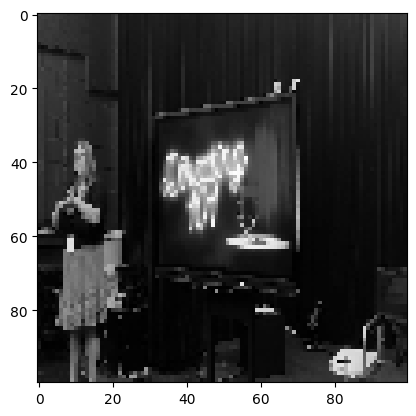

Confidence: [0.9163149]
JERMA LOCATED AT TIMESTAMP: 7767.9602


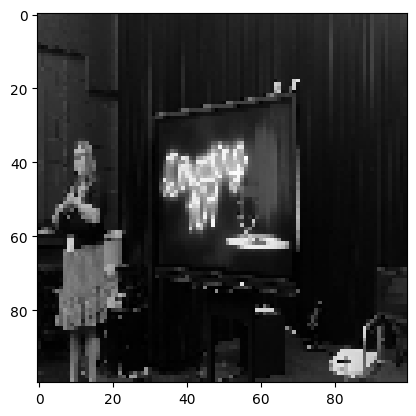

Confidence: [0.92382455]
JERMA LOCATED AT TIMESTAMP: 7767.993566666667


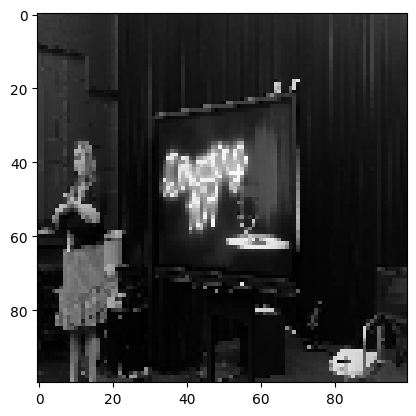

Confidence: [0.9158402]
JERMA LOCATED AT TIMESTAMP: 7768.026933333334


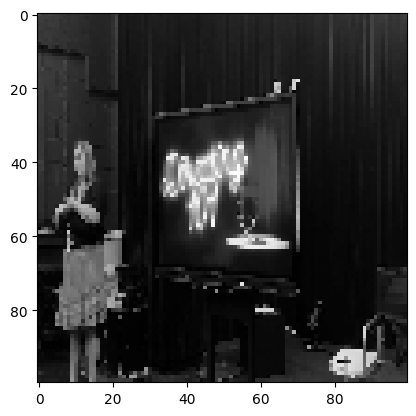

Confidence: [0.90654844]
JERMA LOCATED AT TIMESTAMP: 7768.0603


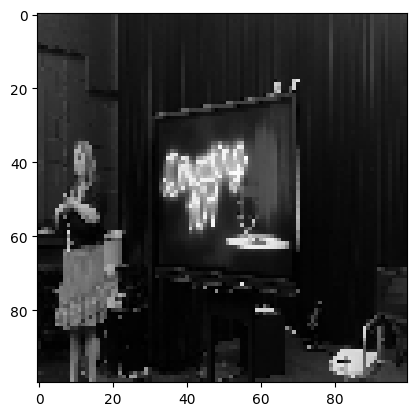

Confidence: [0.91093796]
JERMA LOCATED AT TIMESTAMP: 7768.093666666667


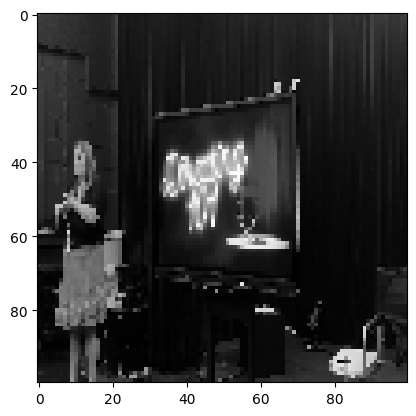

Confidence: [0.9113953]
JERMA LOCATED AT TIMESTAMP: 7768.127033333334


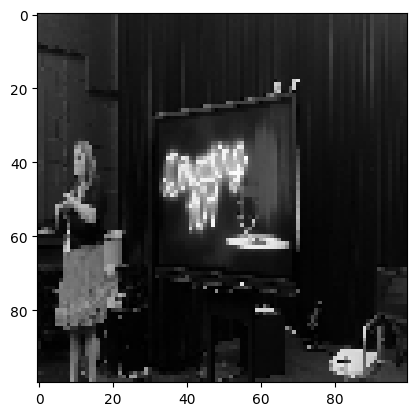

Confidence: [0.91511506]
JERMA LOCATED AT TIMESTAMP: 7768.160400000001


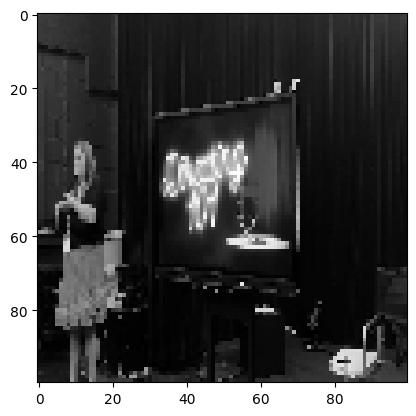

Confidence: [0.9058971]
JERMA LOCATED AT TIMESTAMP: 7768.193766666667


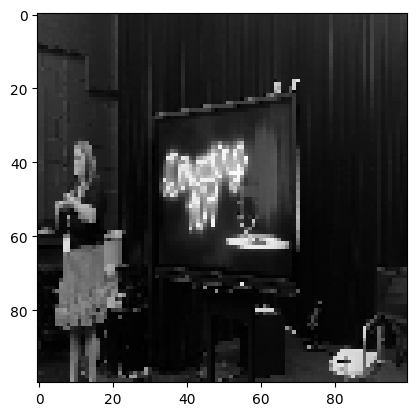

Confidence: [0.9011112]
JERMA LOCATED AT TIMESTAMP: 7768.227133333334


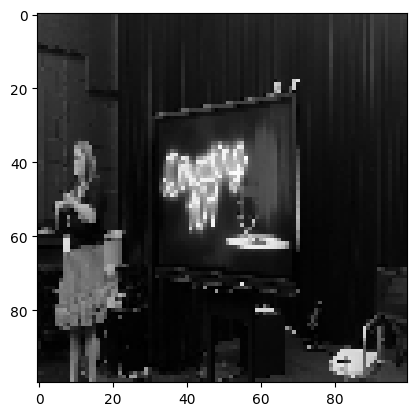

Confidence: [0.90002805]
JERMA LOCATED AT TIMESTAMP: 7768.660900000001


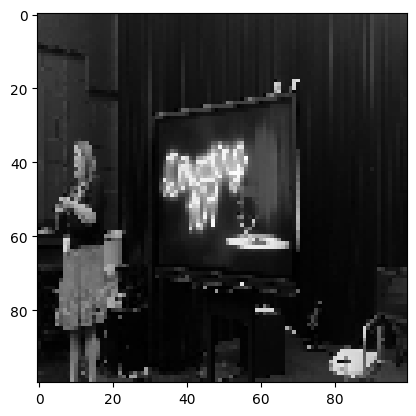

Confidence: [0.900633]
JERMA LOCATED AT TIMESTAMP: 7768.694266666667


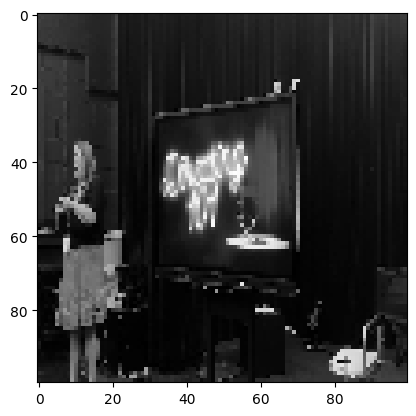

Confidence: [0.90642536]
JERMA LOCATED AT TIMESTAMP: 7768.727633333334


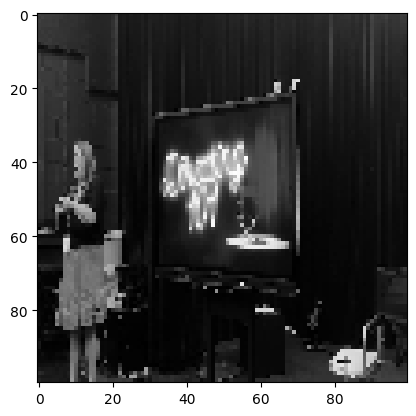

Confidence: [0.9171902]
JERMA LOCATED AT TIMESTAMP: 7768.761


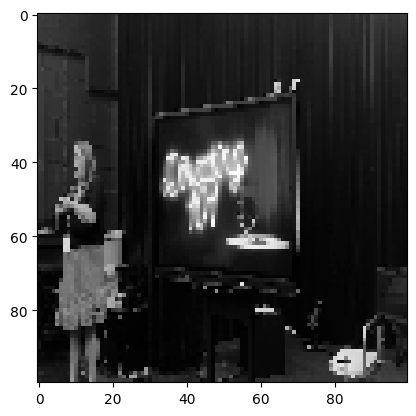

Confidence: [0.92711276]
JERMA LOCATED AT TIMESTAMP: 7768.794366666667


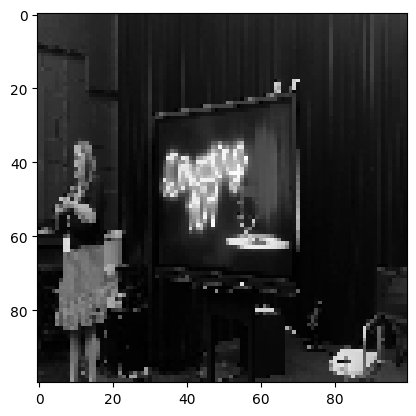

Confidence: [0.95075476]
JERMA LOCATED AT TIMESTAMP: 7768.8277333333335


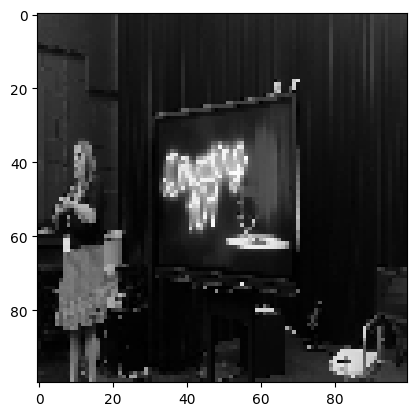

Confidence: [0.9507077]
JERMA LOCATED AT TIMESTAMP: 7768.8611


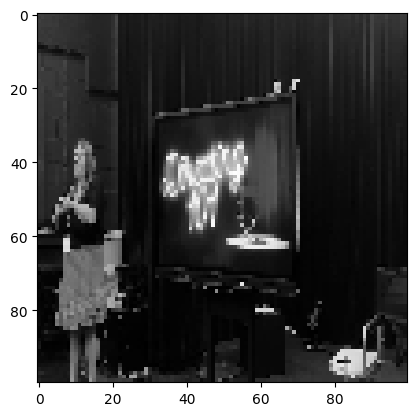

Confidence: [0.94260263]
JERMA LOCATED AT TIMESTAMP: 7768.894466666667


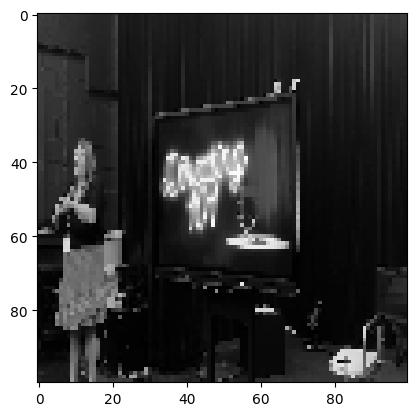

Confidence: [0.95320565]
JERMA LOCATED AT TIMESTAMP: 7768.927833333334


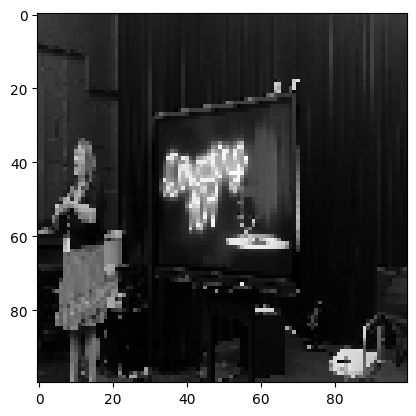

Confidence: [0.949126]
JERMA LOCATED AT TIMESTAMP: 7768.9612


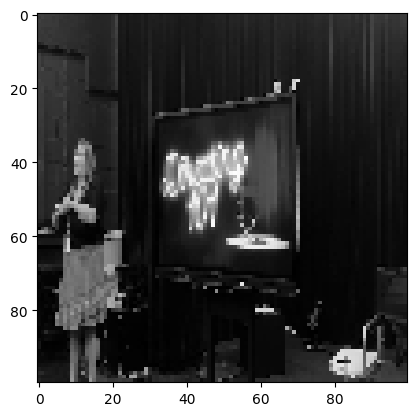

Confidence: [0.9480424]
JERMA LOCATED AT TIMESTAMP: 7768.994566666667


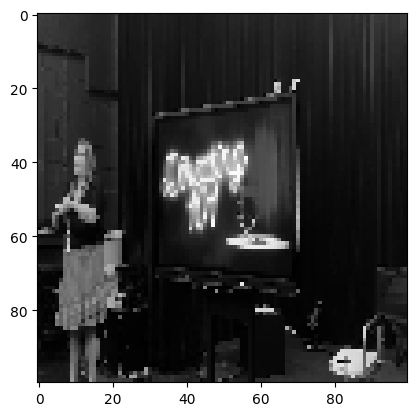

Confidence: [0.94436485]
JERMA LOCATED AT TIMESTAMP: 7769.027933333334


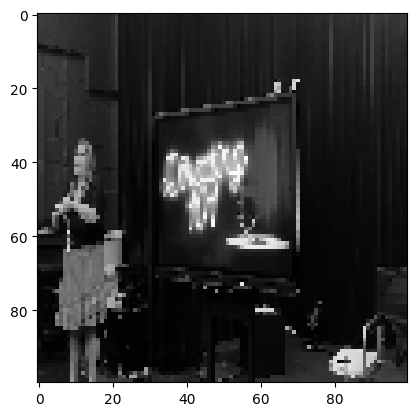

Confidence: [0.945455]
JERMA LOCATED AT TIMESTAMP: 7769.0613


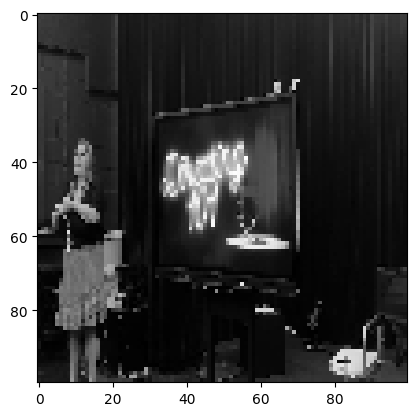

Confidence: [0.9457769]
JERMA LOCATED AT TIMESTAMP: 7769.094666666667


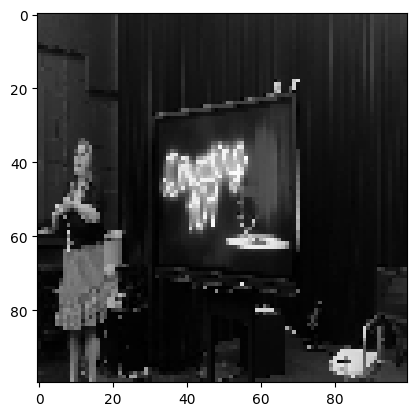

Confidence: [0.9309724]
JERMA LOCATED AT TIMESTAMP: 7769.128033333333


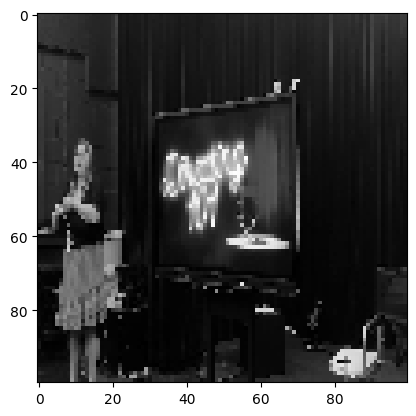

Confidence: [0.91677773]
JERMA LOCATED AT TIMESTAMP: 7769.1614


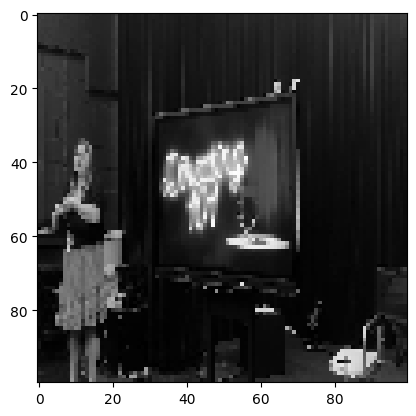

Confidence: [0.9185357]
JERMA LOCATED AT TIMESTAMP: 7769.194766666667


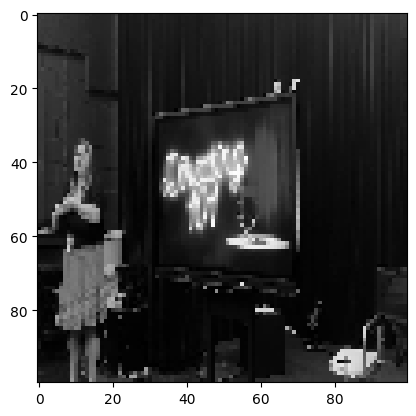

Confidence: [0.9145402]
JERMA LOCATED AT TIMESTAMP: 7769.228133333334


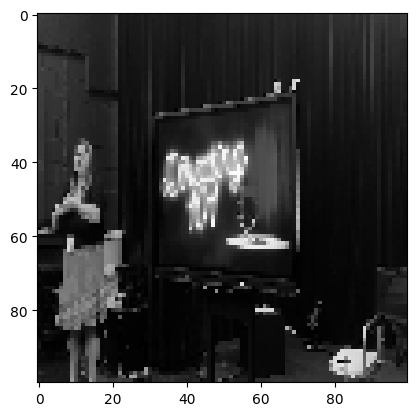

Confidence: [0.92121917]
JERMA LOCATED AT TIMESTAMP: 7769.2615000000005


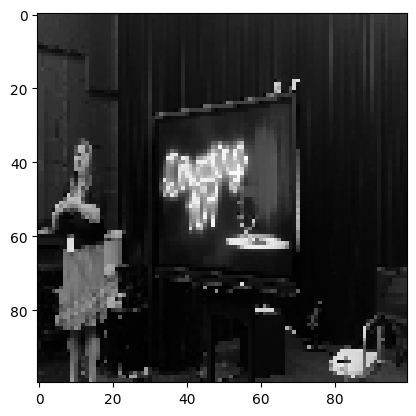

Confidence: [0.93568426]
JERMA LOCATED AT TIMESTAMP: 7769.294866666667


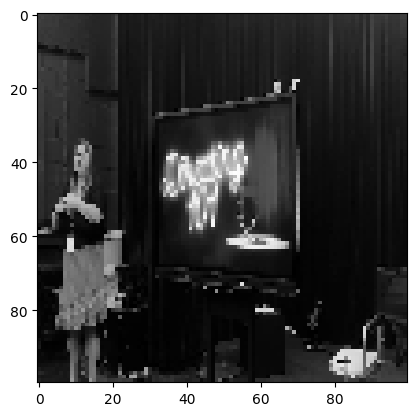

Confidence: [0.94770885]
JERMA LOCATED AT TIMESTAMP: 7769.328233333334


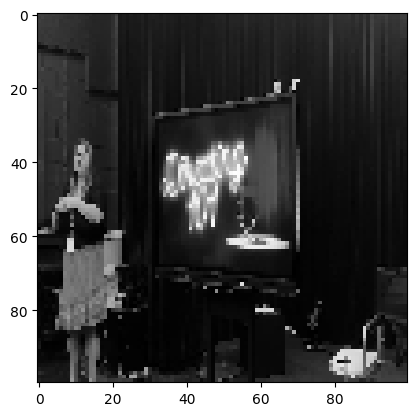

Confidence: [0.94815147]
JERMA LOCATED AT TIMESTAMP: 7769.3616


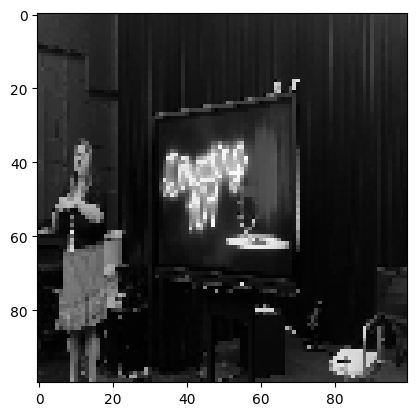

Confidence: [0.9466504]
JERMA LOCATED AT TIMESTAMP: 7769.394966666667


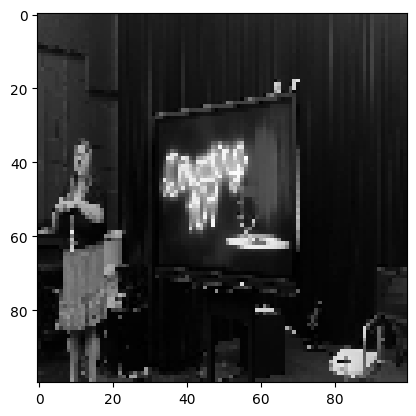

Confidence: [0.95513326]
JERMA LOCATED AT TIMESTAMP: 7769.428333333333


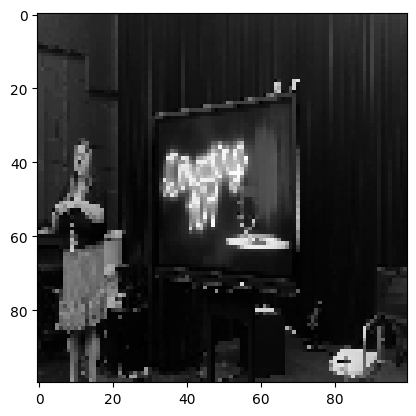

Confidence: [0.95743]
JERMA LOCATED AT TIMESTAMP: 7769.461700000001


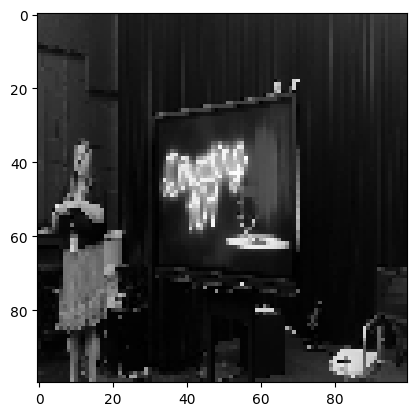

Confidence: [0.96142817]
JERMA LOCATED AT TIMESTAMP: 7769.495066666667


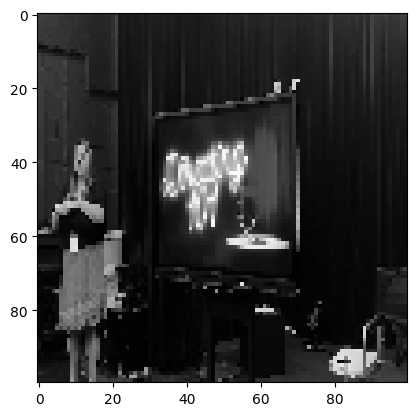

Confidence: [0.9608748]
JERMA LOCATED AT TIMESTAMP: 7769.528433333334


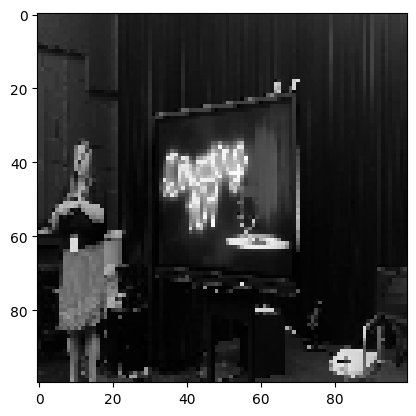

Confidence: [0.958984]
JERMA LOCATED AT TIMESTAMP: 7769.5618


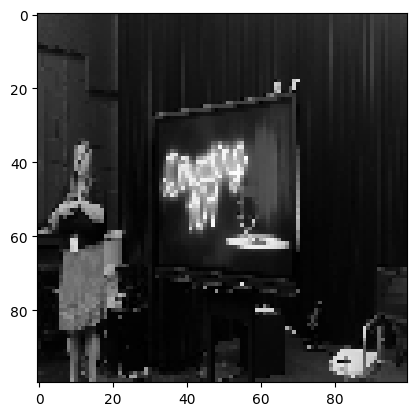

Confidence: [0.94799805]
JERMA LOCATED AT TIMESTAMP: 7769.595166666667


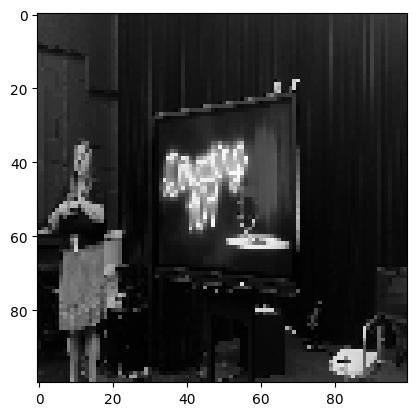

Confidence: [0.9480549]
JERMA LOCATED AT TIMESTAMP: 7769.6285333333335


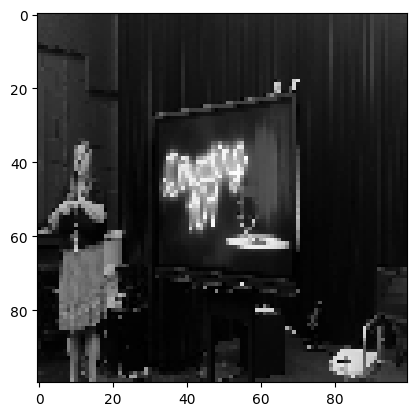

Confidence: [0.9465046]
JERMA LOCATED AT TIMESTAMP: 7769.6619


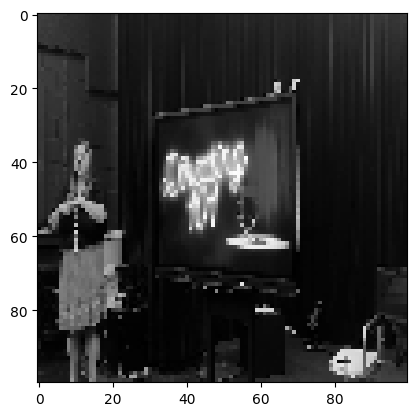

Confidence: [0.9495512]
JERMA LOCATED AT TIMESTAMP: 7769.695266666667


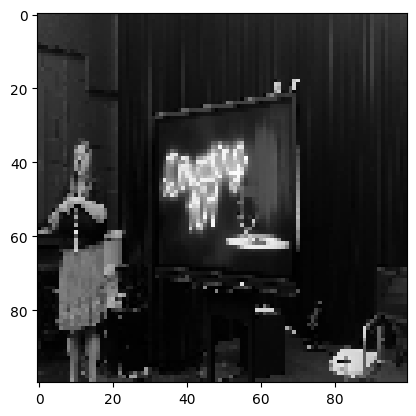

Confidence: [0.92772794]
JERMA LOCATED AT TIMESTAMP: 7769.728633333334


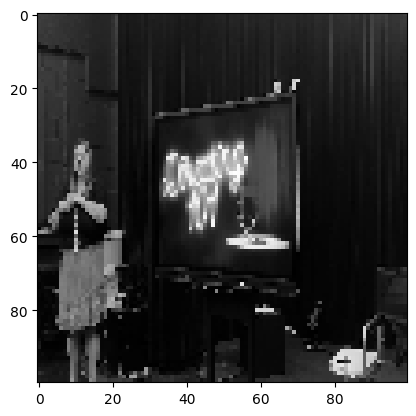

Confidence: [0.93672675]
JERMA LOCATED AT TIMESTAMP: 7769.762000000001


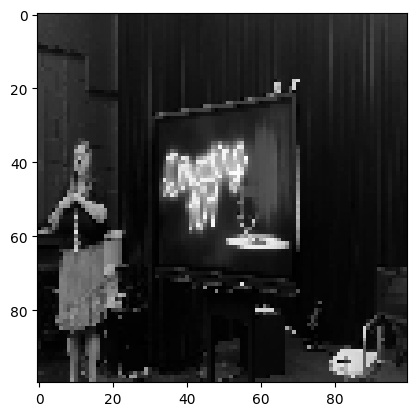

Confidence: [0.95135045]
JERMA LOCATED AT TIMESTAMP: 7769.795366666667


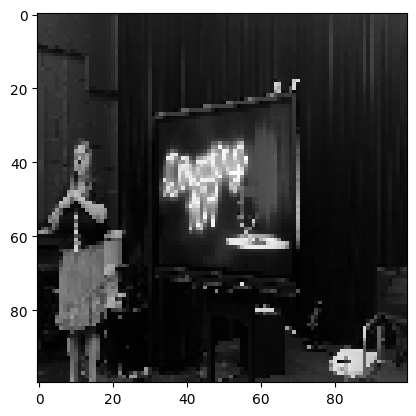

Confidence: [0.96028334]
JERMA LOCATED AT TIMESTAMP: 7769.828733333334


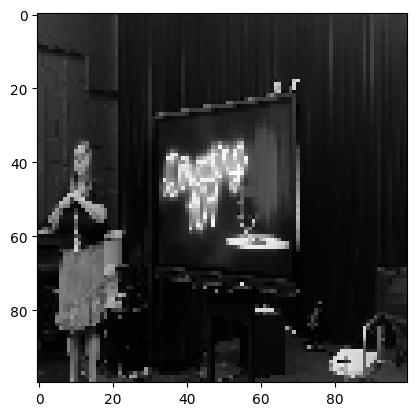

Confidence: [0.96299434]
JERMA LOCATED AT TIMESTAMP: 7769.8621


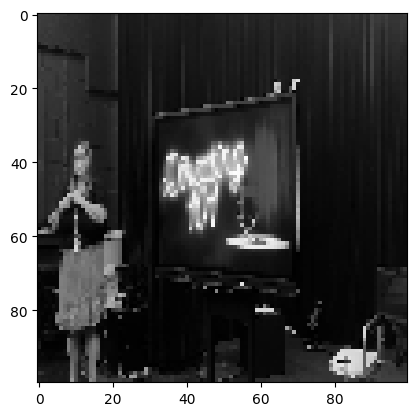

Confidence: [0.9634188]
JERMA LOCATED AT TIMESTAMP: 7769.895466666667


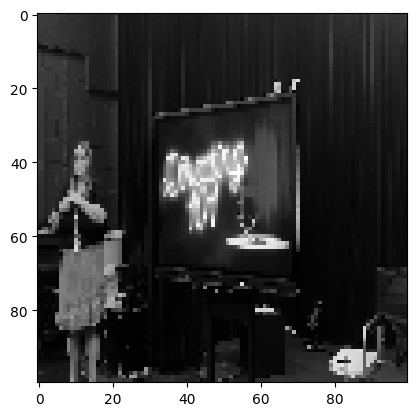

Confidence: [0.954352]
JERMA LOCATED AT TIMESTAMP: 7769.928833333333


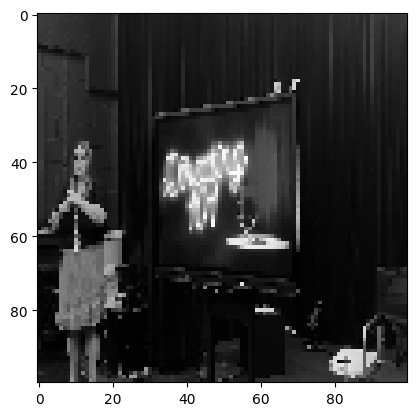

Confidence: [0.9500992]
JERMA LOCATED AT TIMESTAMP: 7769.9622


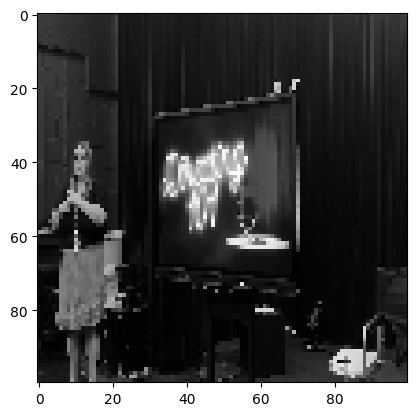

Confidence: [0.95345783]
JERMA LOCATED AT TIMESTAMP: 7769.995566666667


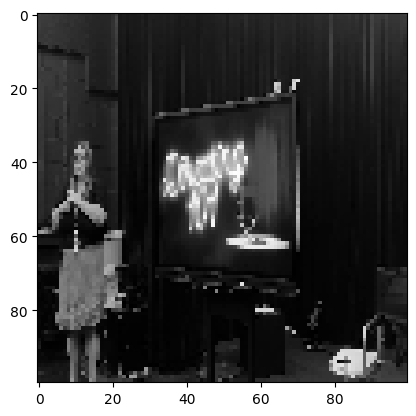

Confidence: [0.9564618]
JERMA LOCATED AT TIMESTAMP: 7770.028933333334


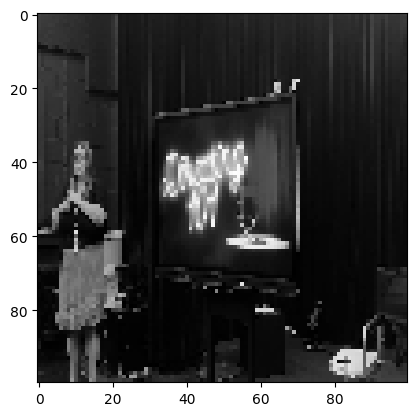

Confidence: [0.9595837]
JERMA LOCATED AT TIMESTAMP: 7770.0623000000005


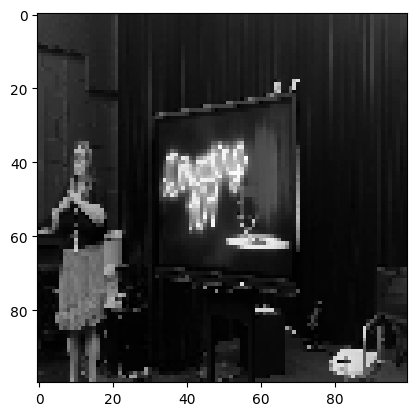

Confidence: [0.9519789]
JERMA LOCATED AT TIMESTAMP: 7770.095666666667


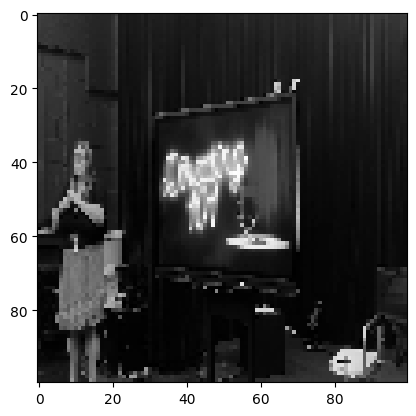

Confidence: [0.94850063]
JERMA LOCATED AT TIMESTAMP: 7770.129033333334


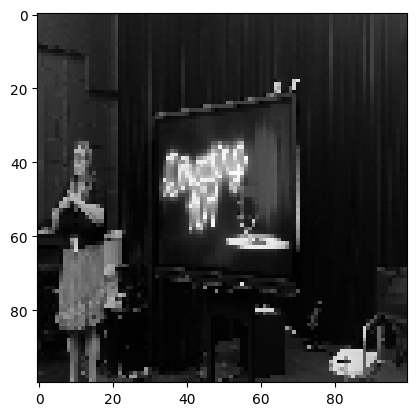

Confidence: [0.9438845]
JERMA LOCATED AT TIMESTAMP: 7770.1624


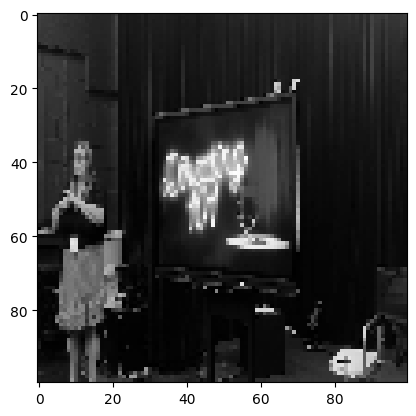

Confidence: [0.9421019]
JERMA LOCATED AT TIMESTAMP: 7770.195766666667


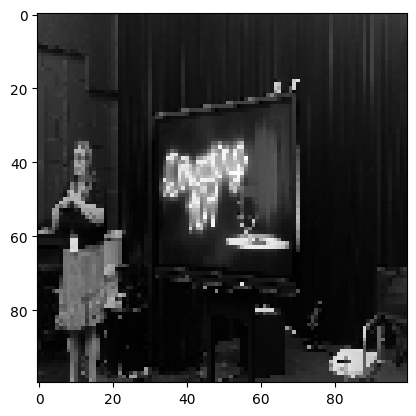

Confidence: [0.9280377]
JERMA LOCATED AT TIMESTAMP: 7770.229133333333


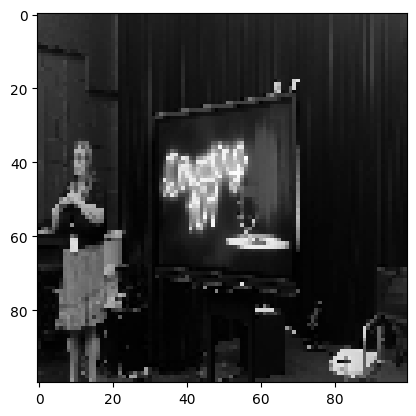

Confidence: [0.9355394]
JERMA LOCATED AT TIMESTAMP: 7770.262500000001


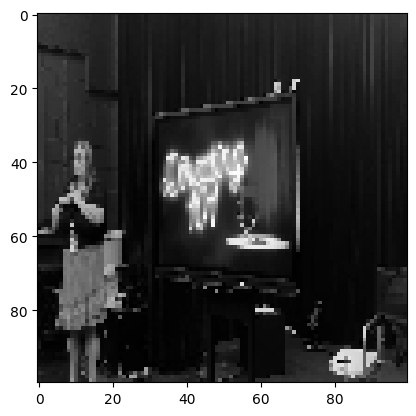

Confidence: [0.9483307]
JERMA LOCATED AT TIMESTAMP: 7770.295866666667


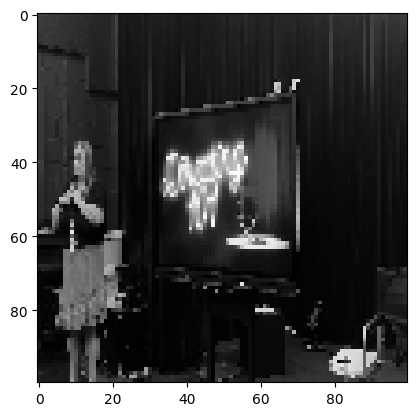

Confidence: [0.9394852]
JERMA LOCATED AT TIMESTAMP: 7770.329233333334


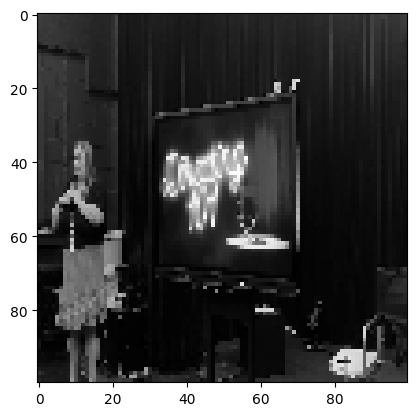

Confidence: [0.9038911]
JERMA LOCATED AT TIMESTAMP: 7770.496066666667


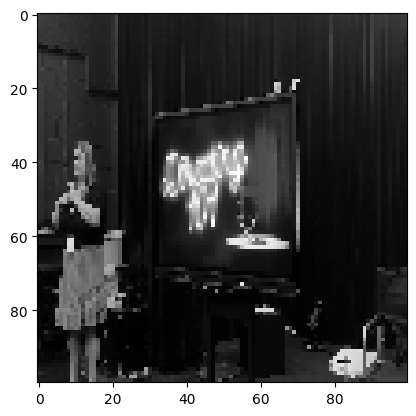

Confidence: [0.9193691]
JERMA LOCATED AT TIMESTAMP: 7770.562800000001


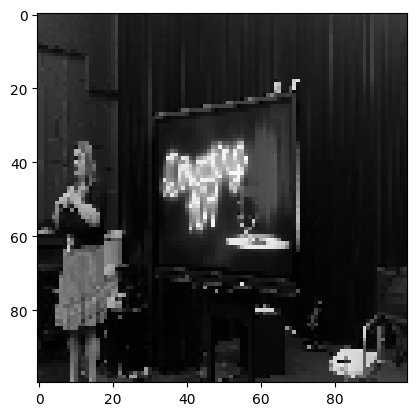

Confidence: [0.90728635]
JERMA LOCATED AT TIMESTAMP: 7770.896466666667


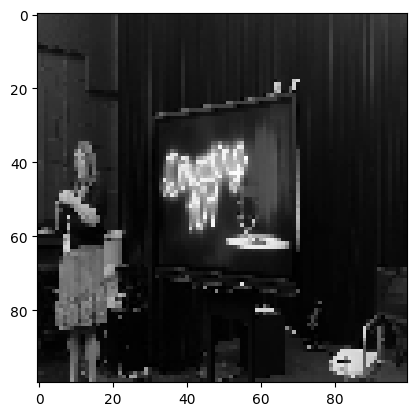

Confidence: [0.91586506]
JERMA LOCATED AT TIMESTAMP: 7770.929833333334


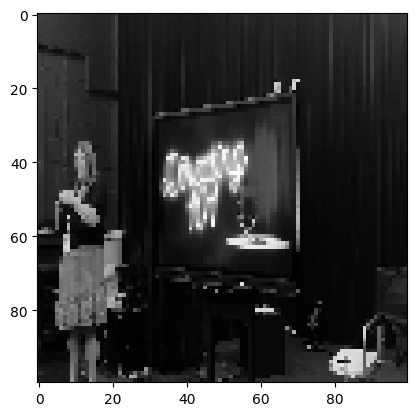

Confidence: [0.9038331]
JERMA LOCATED AT TIMESTAMP: 7770.9632


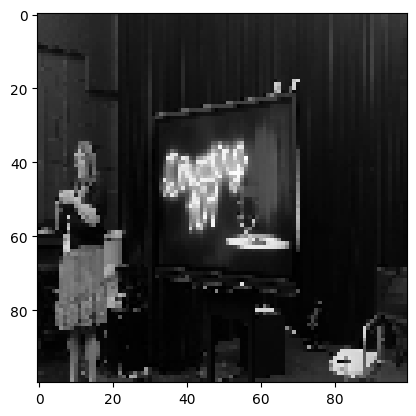

Confidence: [0.92384994]
JERMA LOCATED AT TIMESTAMP: 7770.996566666667


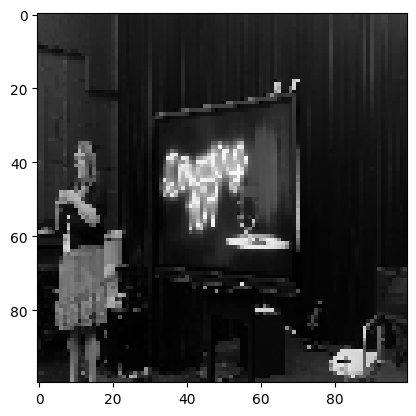

Confidence: [0.9037462]
JERMA LOCATED AT TIMESTAMP: 7771.029933333334


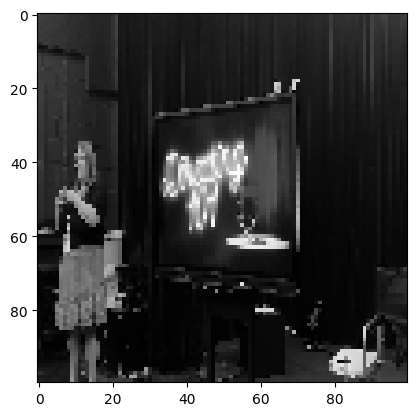

Confidence: [0.90171754]
JERMA LOCATED AT TIMESTAMP: 7771.196766666667


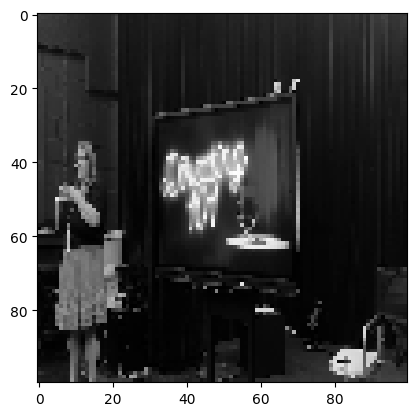

Confidence: [0.90566677]
JERMA LOCATED AT TIMESTAMP: 7771.2301333333335


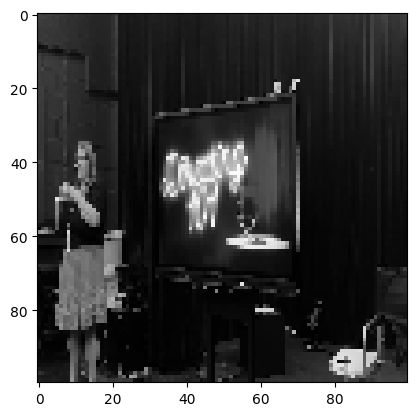

Confidence: [0.9014919]
JERMA LOCATED AT TIMESTAMP: 7771.330233333334


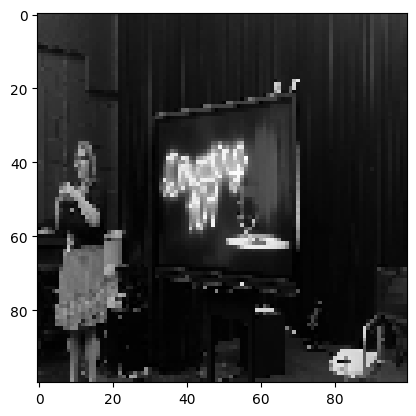

Confidence: [0.9019969]
JERMA LOCATED AT TIMESTAMP: 7771.430333333334


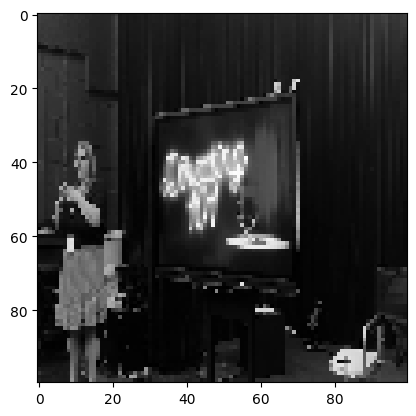

Confidence: [0.91014546]
JERMA LOCATED AT TIMESTAMP: 7771.630533333334


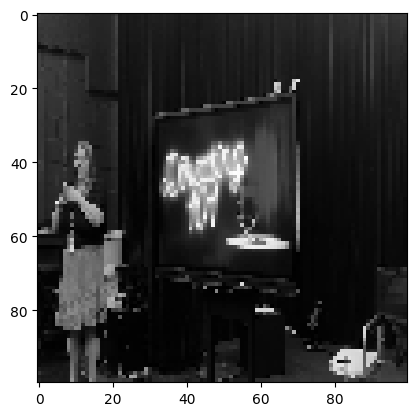

Confidence: [0.90895987]
JERMA LOCATED AT TIMESTAMP: 7771.6639000000005


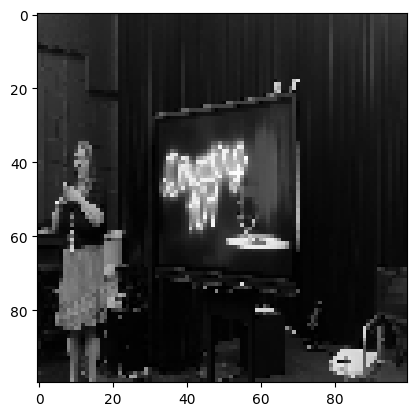

Confidence: [0.9269007]
JERMA LOCATED AT TIMESTAMP: 7771.830733333334


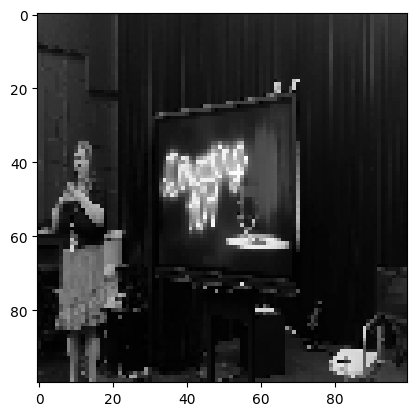

Confidence: [0.9430517]
JERMA LOCATED AT TIMESTAMP: 7771.864100000001


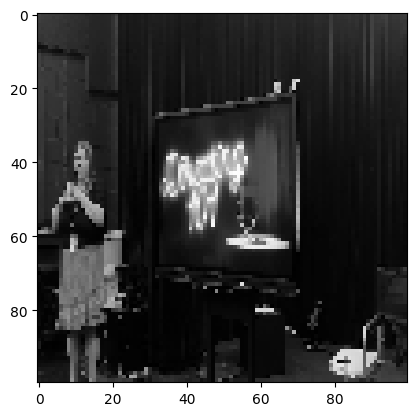

Confidence: [0.9310546]
JERMA LOCATED AT TIMESTAMP: 7771.897466666667


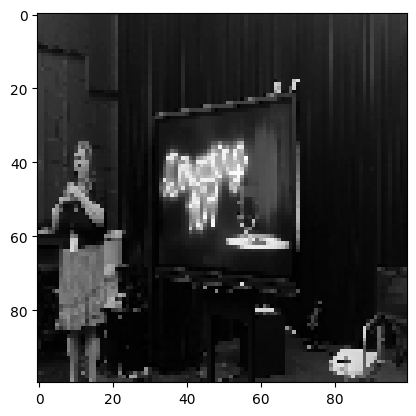

Confidence: [0.92103815]
JERMA LOCATED AT TIMESTAMP: 7771.930833333334


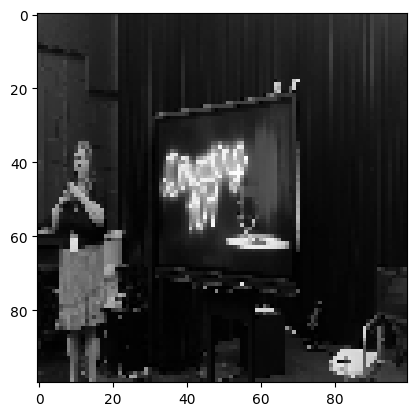

Confidence: [0.95747936]
JERMA LOCATED AT TIMESTAMP: 7771.9642


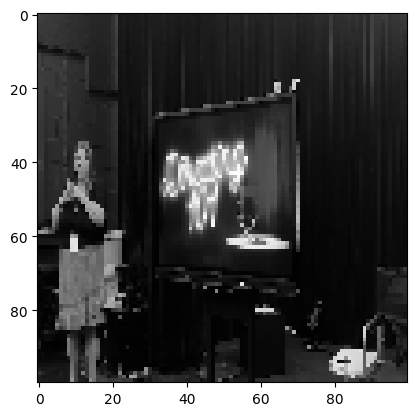

Confidence: [0.95718354]
JERMA LOCATED AT TIMESTAMP: 7771.997566666667


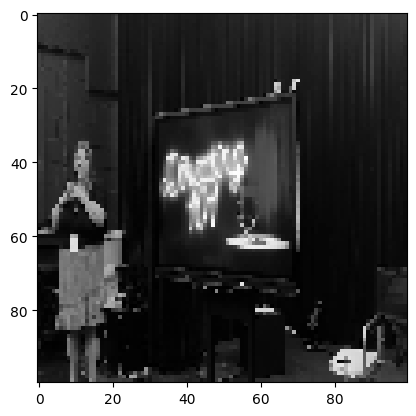

Confidence: [0.96844]
JERMA LOCATED AT TIMESTAMP: 7772.030933333333


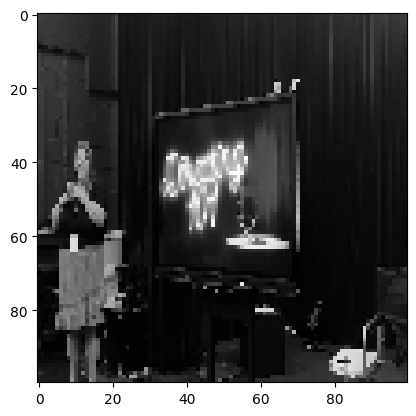

Confidence: [0.96827626]
JERMA LOCATED AT TIMESTAMP: 7772.0643


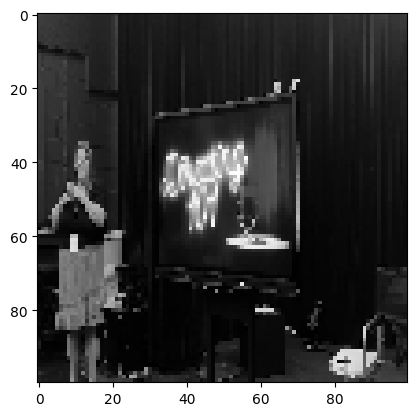

Confidence: [0.95873106]
JERMA LOCATED AT TIMESTAMP: 7772.0976666666675


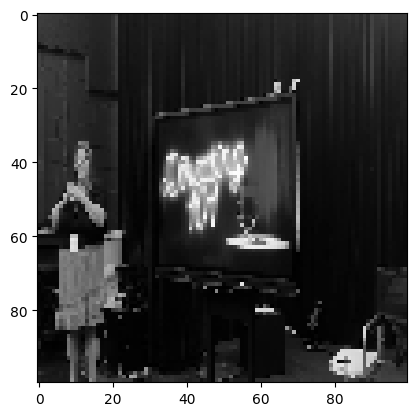

Confidence: [0.95285785]
JERMA LOCATED AT TIMESTAMP: 7772.131033333334


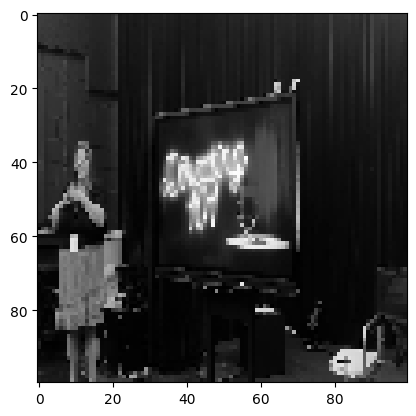

Confidence: [0.9485177]
JERMA LOCATED AT TIMESTAMP: 7772.164400000001


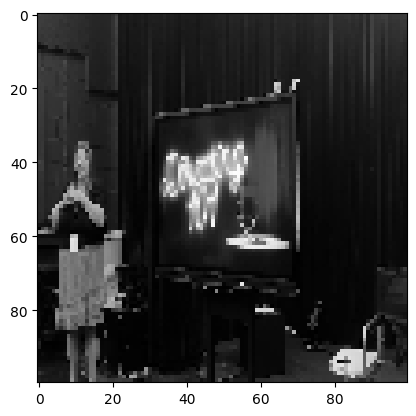

Confidence: [0.94110847]
JERMA LOCATED AT TIMESTAMP: 7772.197766666667


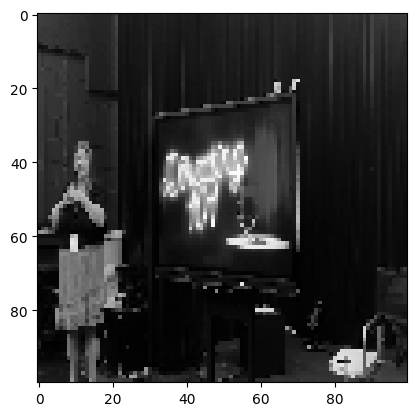

Confidence: [0.92899704]
JERMA LOCATED AT TIMESTAMP: 7772.231133333334


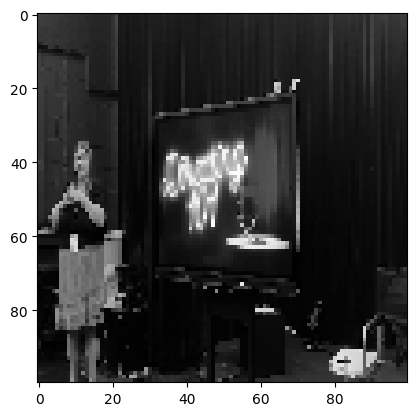

Confidence: [0.91937006]
JERMA LOCATED AT TIMESTAMP: 7772.2645


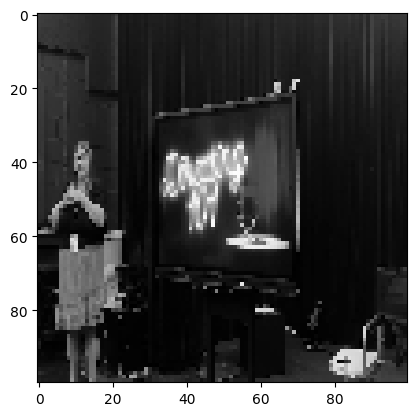

Confidence: [0.9099264]
JERMA LOCATED AT TIMESTAMP: 7772.297866666667


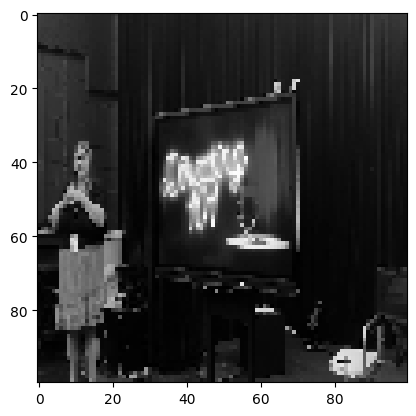

Confidence: [0.91554064]
JERMA LOCATED AT TIMESTAMP: 7772.331233333333


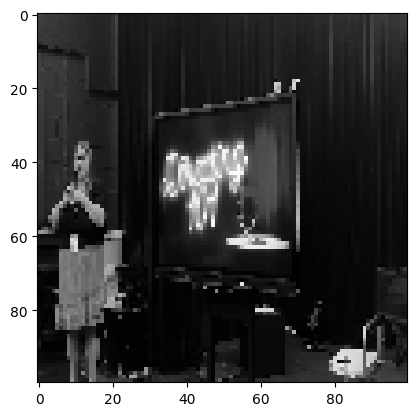

Confidence: [0.92662746]
JERMA LOCATED AT TIMESTAMP: 7772.364600000001


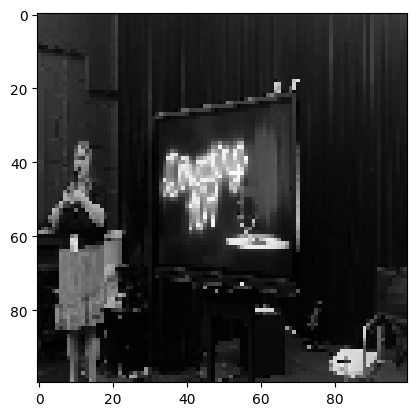

Confidence: [0.92128587]
JERMA LOCATED AT TIMESTAMP: 7772.397966666667


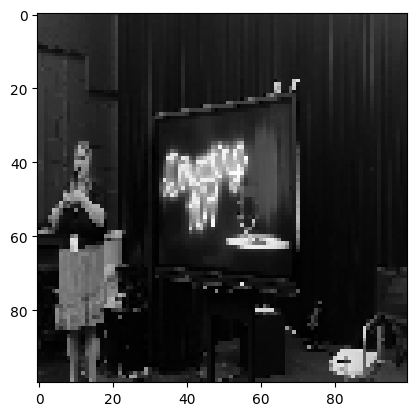

Confidence: [0.9170633]
JERMA LOCATED AT TIMESTAMP: 7772.431333333334


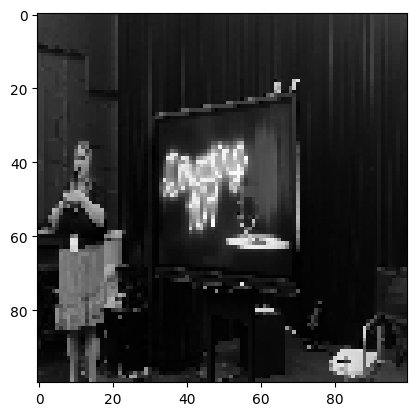

Confidence: [0.9216448]
JERMA LOCATED AT TIMESTAMP: 7772.4647


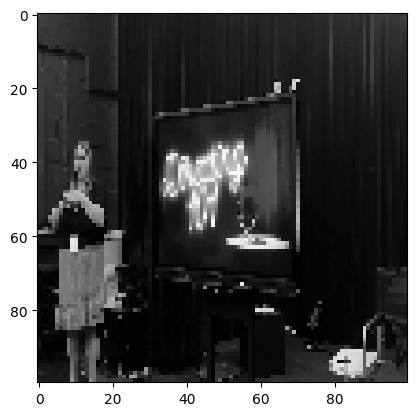

Confidence: [0.92667884]
JERMA LOCATED AT TIMESTAMP: 7772.498066666667


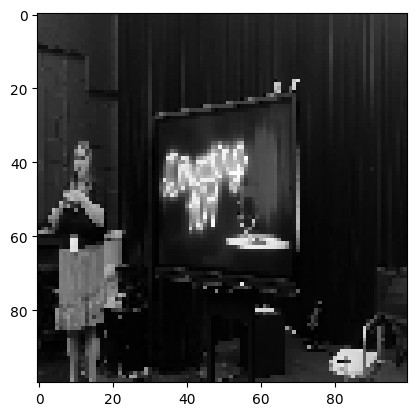

Confidence: [0.92084026]
JERMA LOCATED AT TIMESTAMP: 7772.531433333334


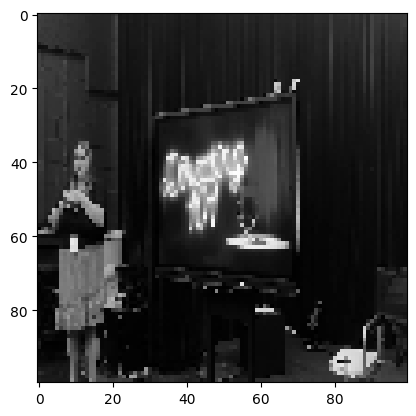

Confidence: [0.9156452]
JERMA LOCATED AT TIMESTAMP: 7772.5648


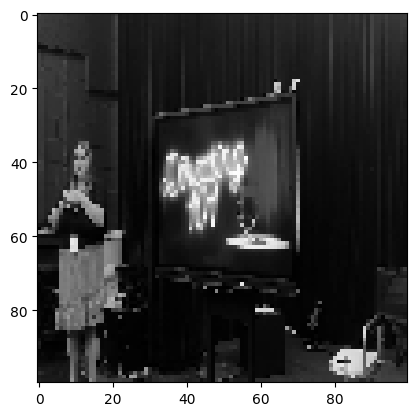

Confidence: [0.9191056]
JERMA LOCATED AT TIMESTAMP: 7772.598166666667


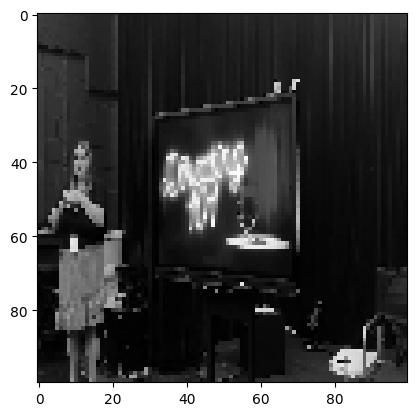

Confidence: [0.93642503]
JERMA LOCATED AT TIMESTAMP: 7772.631533333334


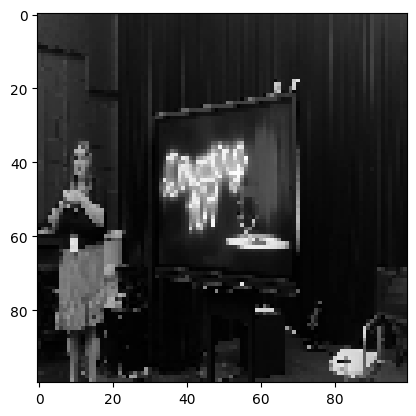

Confidence: [0.9413275]
JERMA LOCATED AT TIMESTAMP: 7772.664900000001


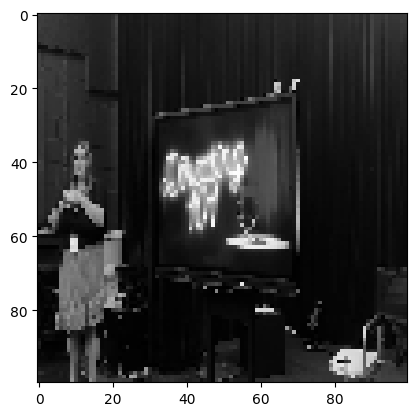

Confidence: [0.9469794]
JERMA LOCATED AT TIMESTAMP: 7772.698266666667


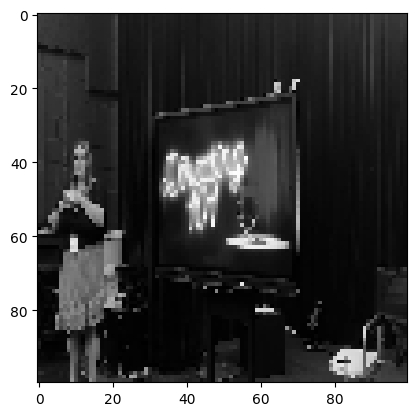

Confidence: [0.94355595]
JERMA LOCATED AT TIMESTAMP: 7772.731633333334


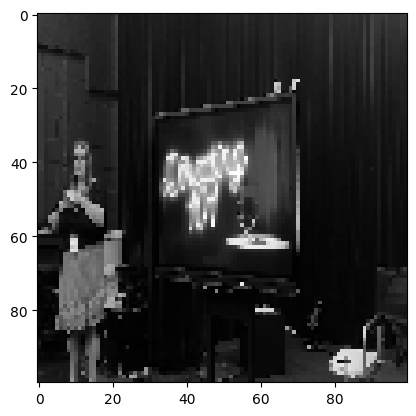

Confidence: [0.9363618]
JERMA LOCATED AT TIMESTAMP: 7772.765


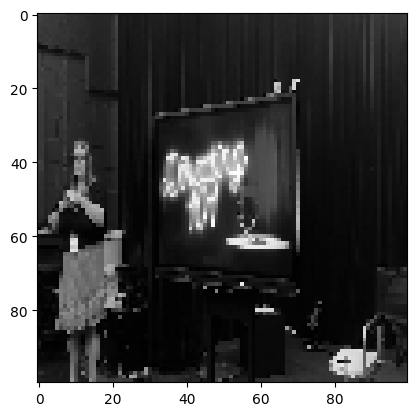

Confidence: [0.94270325]
JERMA LOCATED AT TIMESTAMP: 7772.798366666667


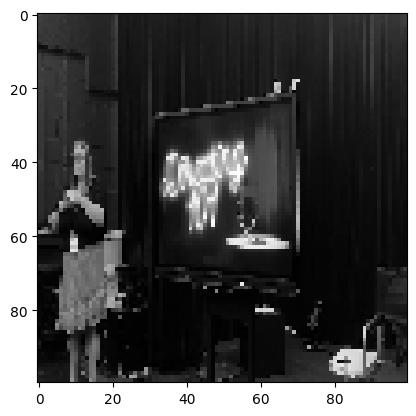

Confidence: [0.93818665]
JERMA LOCATED AT TIMESTAMP: 7772.831733333333


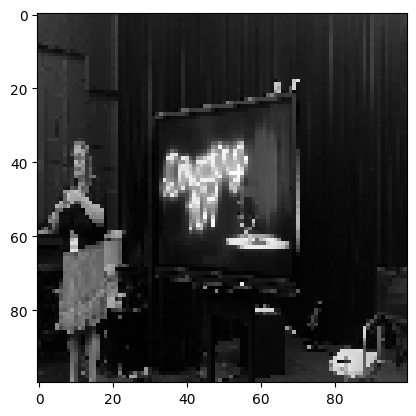

Confidence: [0.9001764]
JERMA LOCATED AT TIMESTAMP: 7772.8651


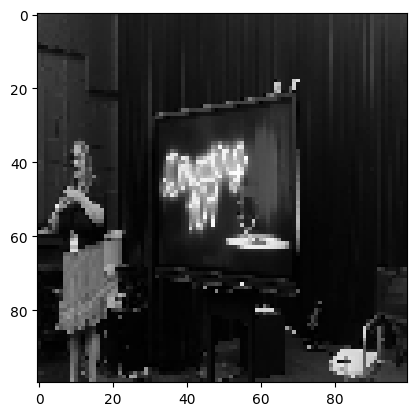

Confidence: [0.91212535]
JERMA LOCATED AT TIMESTAMP: 7772.898466666667


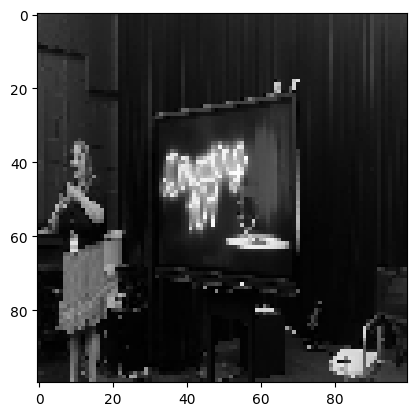

Confidence: [0.905181]
JERMA LOCATED AT TIMESTAMP: 7772.931833333334


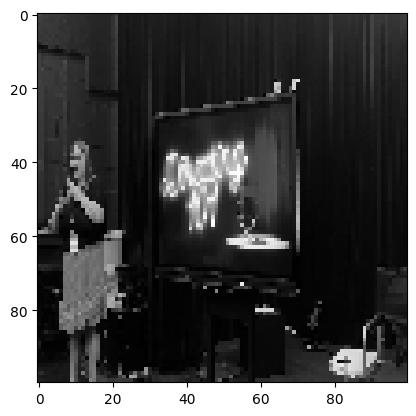

Confidence: [0.95561516]
JERMA LOCATED AT TIMESTAMP: 7772.965200000001


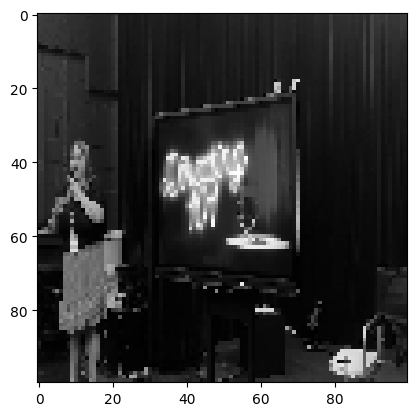

Confidence: [0.9419194]
JERMA LOCATED AT TIMESTAMP: 7772.998566666667


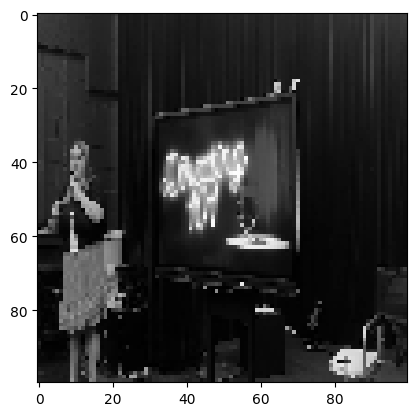

Confidence: [0.93101573]
JERMA LOCATED AT TIMESTAMP: 7773.031933333334


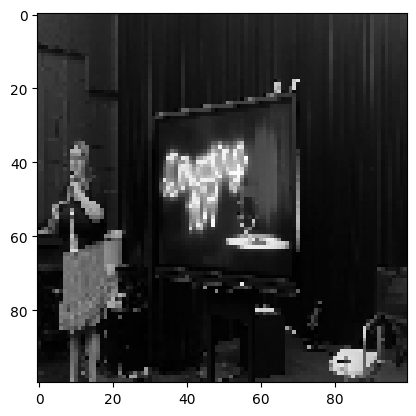

Confidence: [0.9258245]
JERMA LOCATED AT TIMESTAMP: 7773.0653


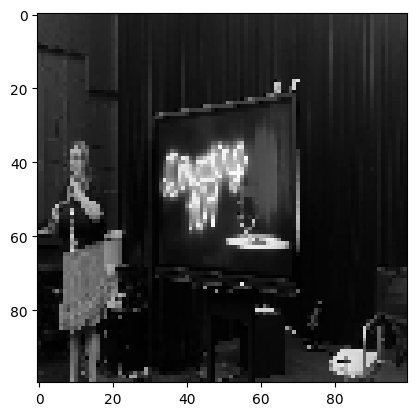

Confidence: [0.9389282]
JERMA LOCATED AT TIMESTAMP: 7773.098666666667


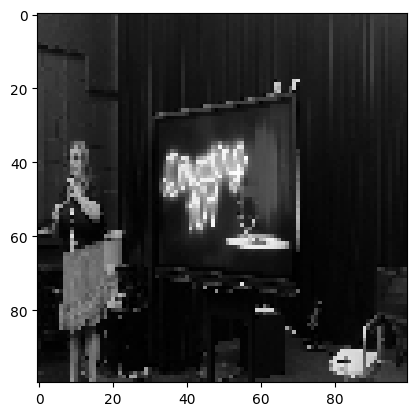

Confidence: [0.9159469]
JERMA LOCATED AT TIMESTAMP: 7773.132033333333


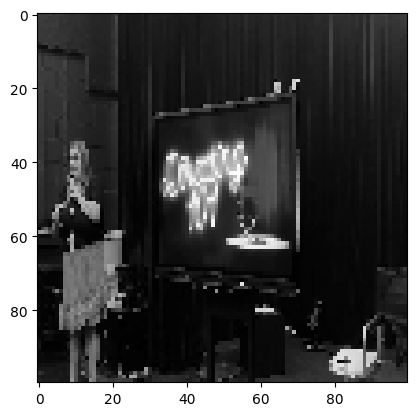

Confidence: [0.91552526]
JERMA LOCATED AT TIMESTAMP: 7773.165400000001


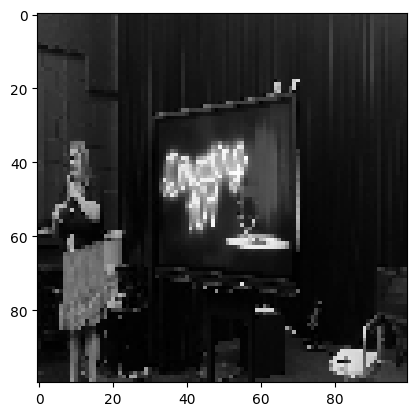

Confidence: [0.9267756]
JERMA LOCATED AT TIMESTAMP: 7773.198766666667


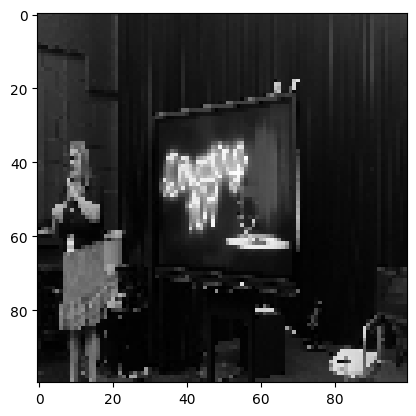

Confidence: [0.92293316]
JERMA LOCATED AT TIMESTAMP: 7773.232133333334


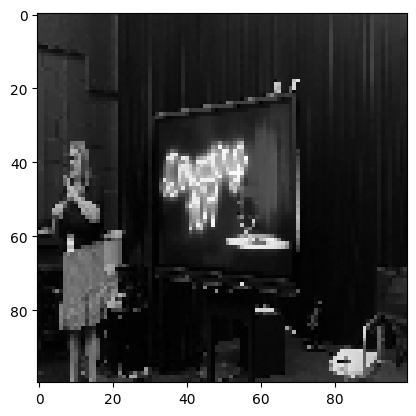

Confidence: [0.9099252]
JERMA LOCATED AT TIMESTAMP: 7773.2655


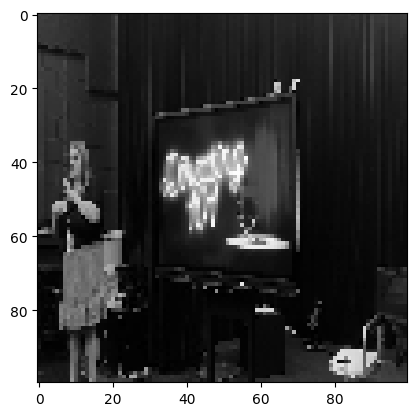

Confidence: [0.9419535]
JERMA LOCATED AT TIMESTAMP: 7773.298866666667


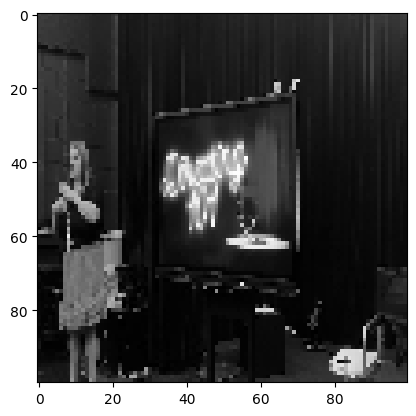

Confidence: [0.935708]
JERMA LOCATED AT TIMESTAMP: 7773.3322333333335


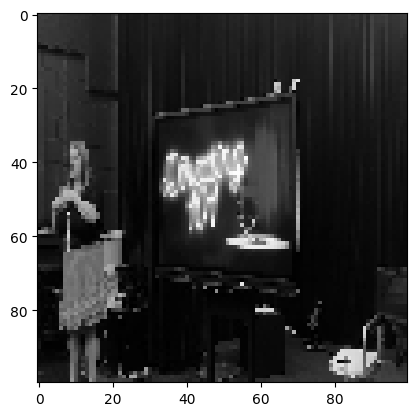

Confidence: [0.943775]
JERMA LOCATED AT TIMESTAMP: 7773.365599999999


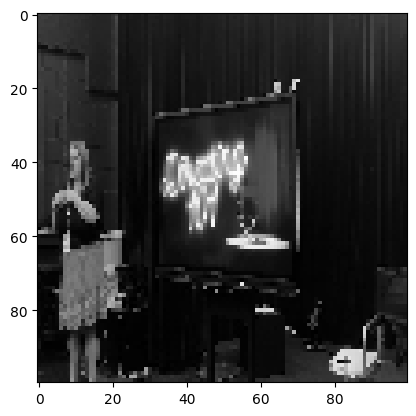

Confidence: [0.9352527]
JERMA LOCATED AT TIMESTAMP: 7773.398966666667


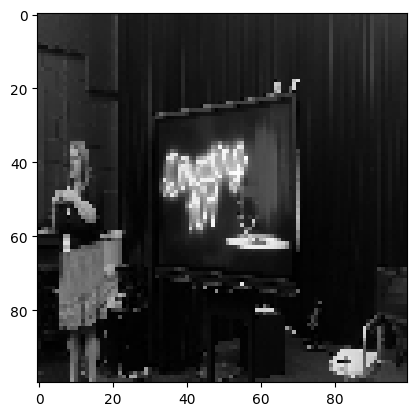

Confidence: [0.9193682]
JERMA LOCATED AT TIMESTAMP: 7773.432333333334


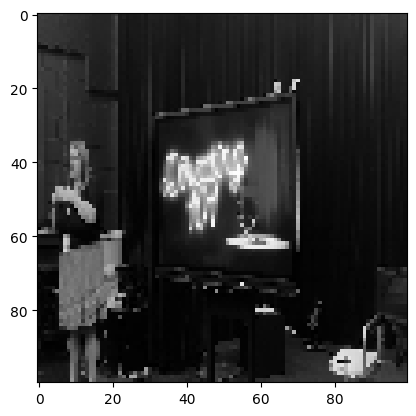

Confidence: [0.9183774]
JERMA LOCATED AT TIMESTAMP: 7773.532433333334


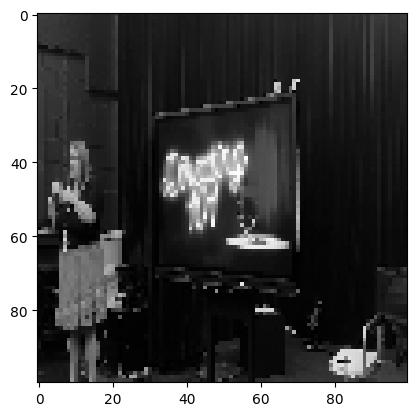

Confidence: [0.9120387]
JERMA LOCATED AT TIMESTAMP: 7773.5658


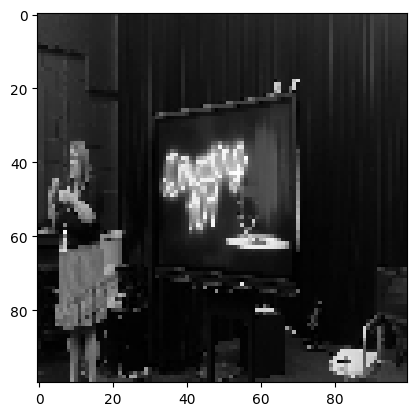

Confidence: [0.94019574]
JERMA LOCATED AT TIMESTAMP: 7773.599166666667


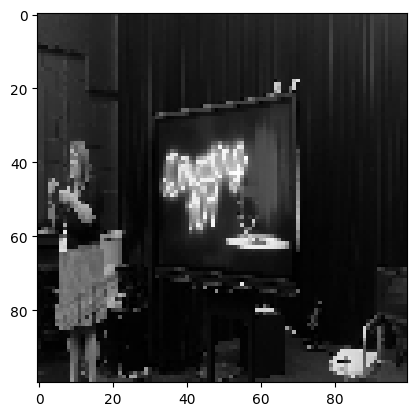

Confidence: [0.94439805]
JERMA LOCATED AT TIMESTAMP: 7773.6659


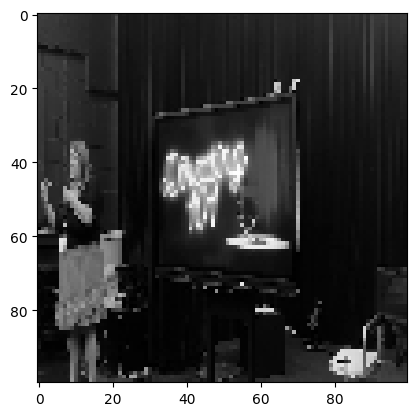

Confidence: [0.94607747]
JERMA LOCATED AT TIMESTAMP: 7773.699266666667


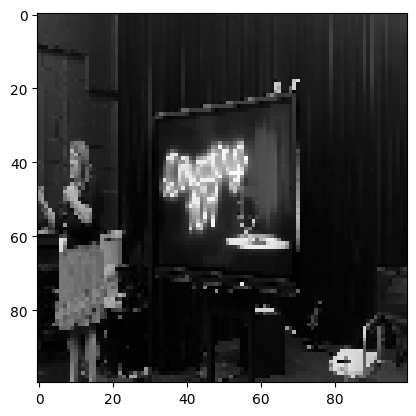

Confidence: [0.93252367]
JERMA LOCATED AT TIMESTAMP: 7773.732633333334


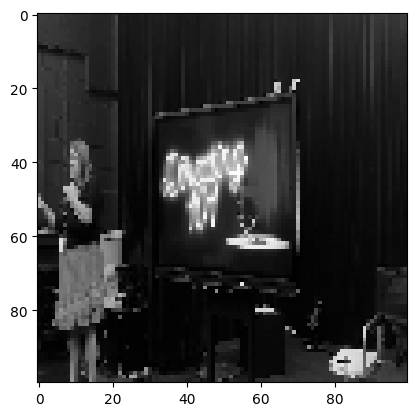

Confidence: [0.9067483]
JERMA LOCATED AT TIMESTAMP: 7773.7660000000005


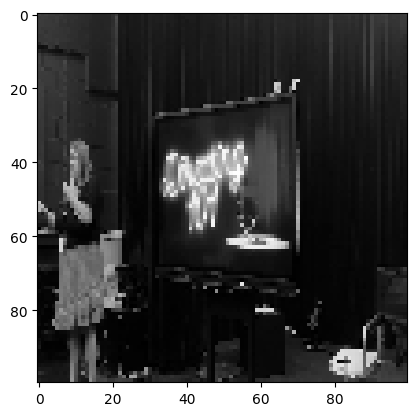

Confidence: [0.91161853]
JERMA LOCATED AT TIMESTAMP: 7773.799366666667


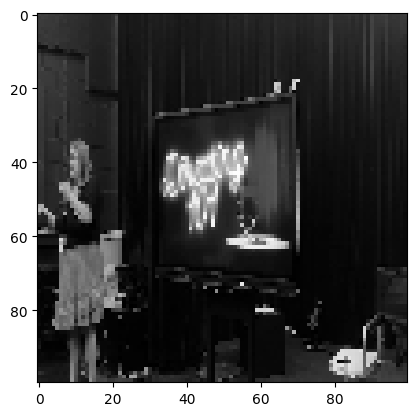

Confidence: [0.92162645]
JERMA LOCATED AT TIMESTAMP: 7773.832733333334


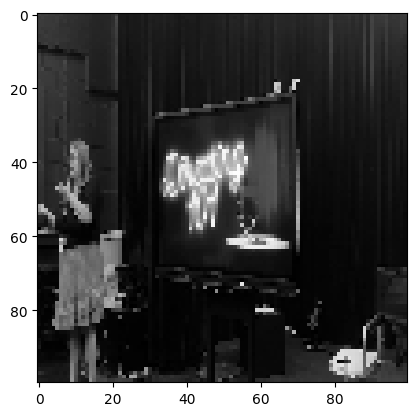

Confidence: [0.9002507]
JERMA LOCATED AT TIMESTAMP: 7773.8661


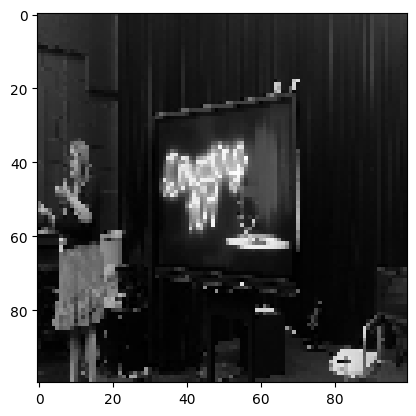

Confidence: [0.9012784]
JERMA LOCATED AT TIMESTAMP: 7774.099666666667


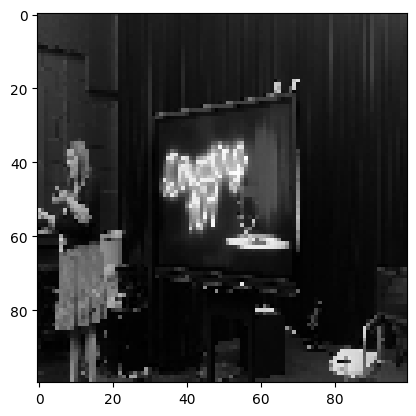

Confidence: [0.9056483]
JERMA LOCATED AT TIMESTAMP: 7774.1330333333335


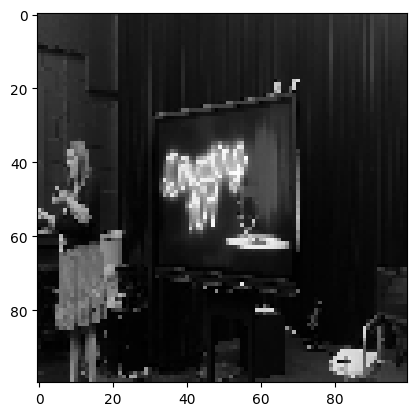

Confidence: [0.93225485]
JERMA LOCATED AT TIMESTAMP: 7774.600166666667


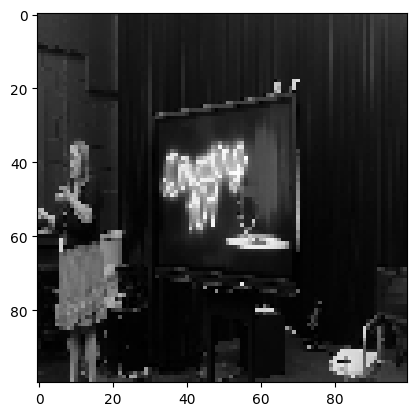

Confidence: [0.95050824]
JERMA LOCATED AT TIMESTAMP: 7774.633533333334


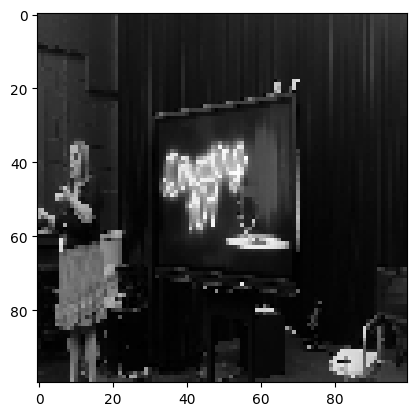

Confidence: [0.95868975]
JERMA LOCATED AT TIMESTAMP: 7774.6669


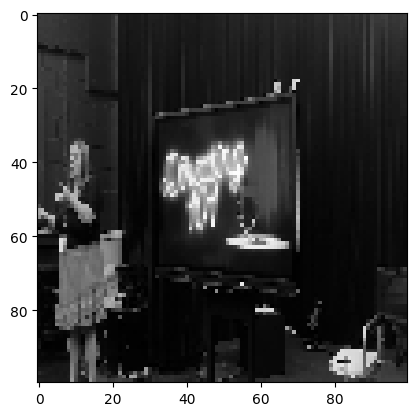

Confidence: [0.95434386]
JERMA LOCATED AT TIMESTAMP: 7774.700266666667


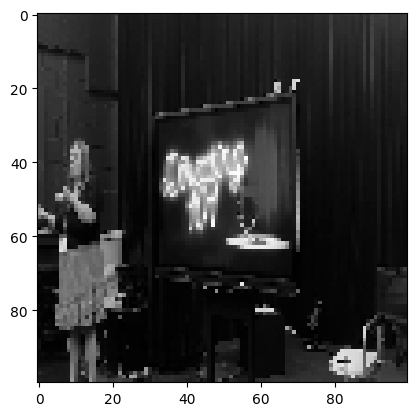

Confidence: [0.9245911]
JERMA LOCATED AT TIMESTAMP: 7774.733633333333


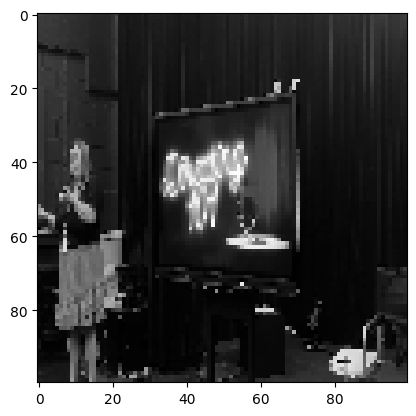

Confidence: [0.9375899]
JERMA LOCATED AT TIMESTAMP: 7774.767000000001


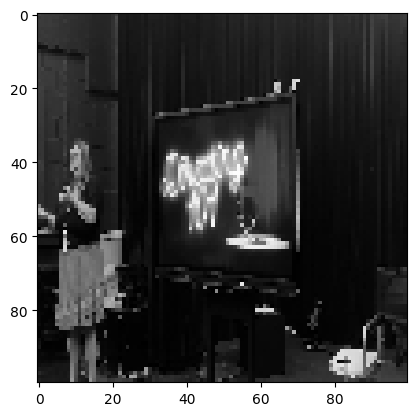

Confidence: [0.95224434]
JERMA LOCATED AT TIMESTAMP: 7774.800366666667


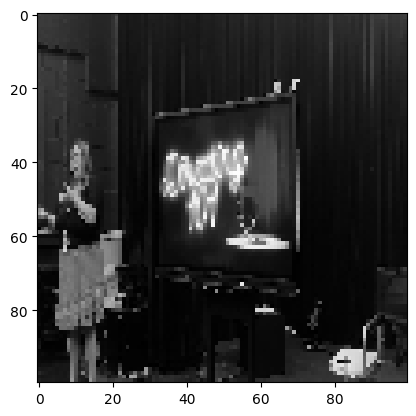

Confidence: [0.9560723]
JERMA LOCATED AT TIMESTAMP: 7774.833733333334


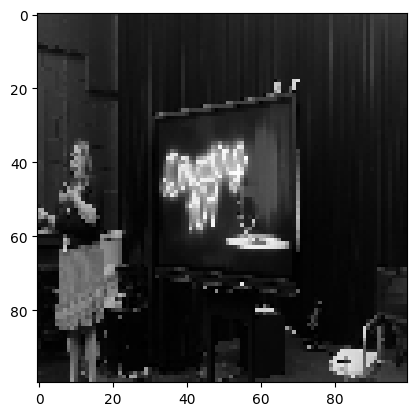

Confidence: [0.93666774]
JERMA LOCATED AT TIMESTAMP: 7774.8671


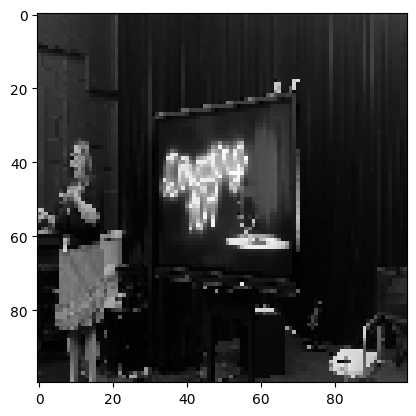

Confidence: [0.9346973]
JERMA LOCATED AT TIMESTAMP: 7774.900466666667


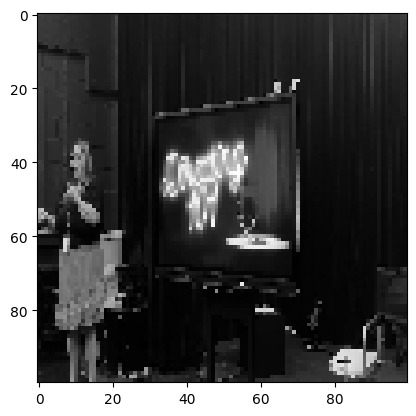

Confidence: [0.9300545]
JERMA LOCATED AT TIMESTAMP: 7774.933833333334


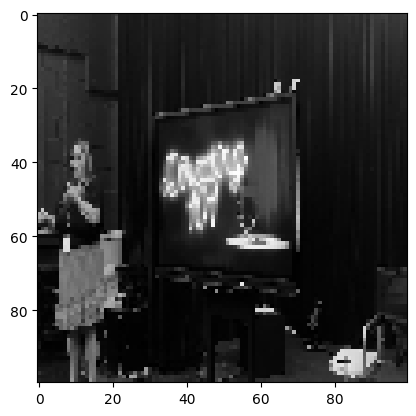

Confidence: [0.9372009]
JERMA LOCATED AT TIMESTAMP: 7774.9672


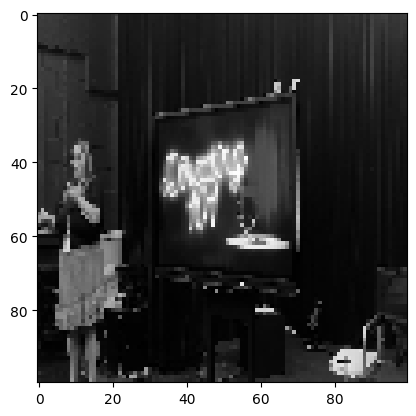

Confidence: [0.9401662]
JERMA LOCATED AT TIMESTAMP: 7775.000566666667


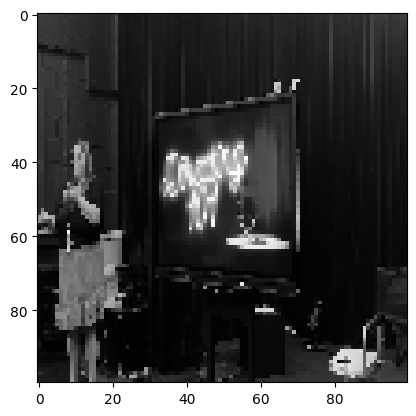

Confidence: [0.9627132]
JERMA LOCATED AT TIMESTAMP: 7775.033933333334


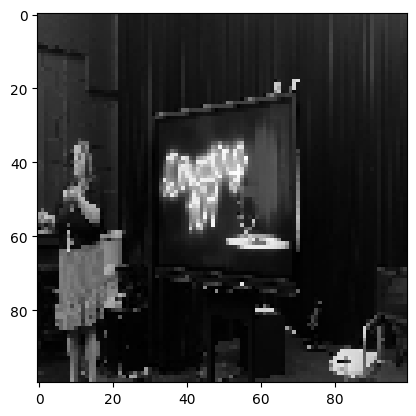

Confidence: [0.9657543]
JERMA LOCATED AT TIMESTAMP: 7775.067300000001


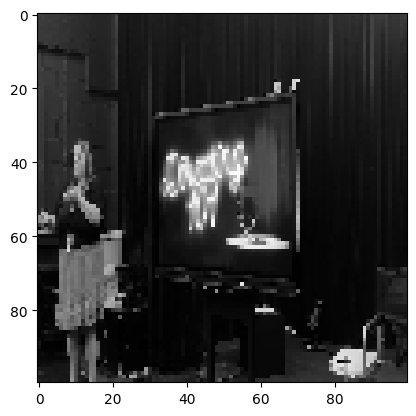

Confidence: [0.9706043]
JERMA LOCATED AT TIMESTAMP: 7775.100666666667


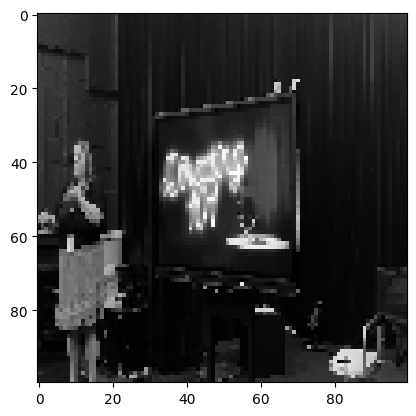

Confidence: [0.9771573]
JERMA LOCATED AT TIMESTAMP: 7775.134033333334


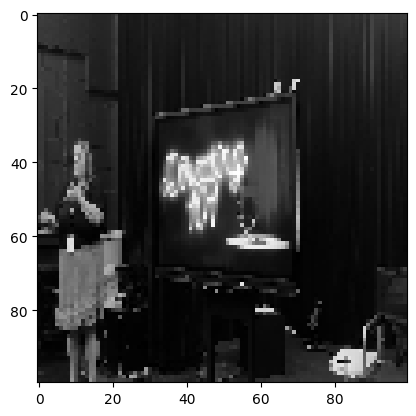

Confidence: [0.9811075]
JERMA LOCATED AT TIMESTAMP: 7775.1674


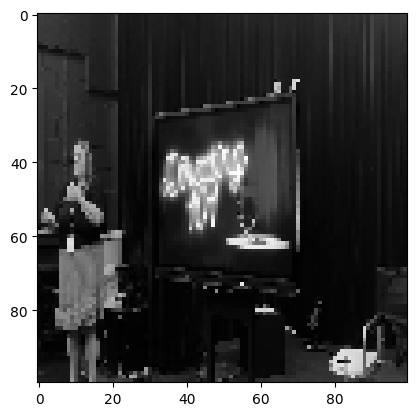

Confidence: [0.9770312]
JERMA LOCATED AT TIMESTAMP: 7775.200766666667


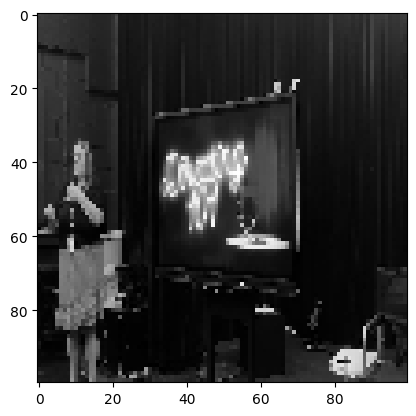

Confidence: [0.9531974]
JERMA LOCATED AT TIMESTAMP: 7775.234133333333


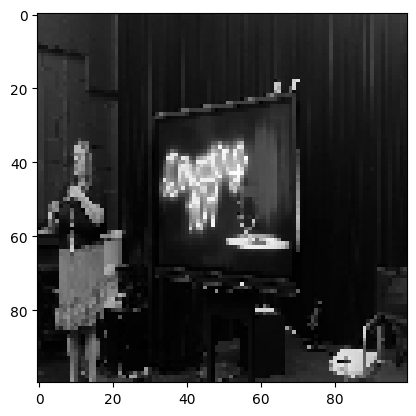

Confidence: [0.96378154]
JERMA LOCATED AT TIMESTAMP: 7775.2675


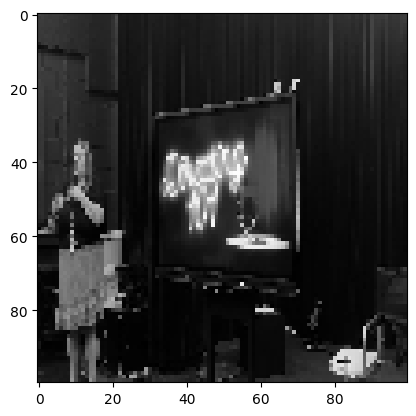

Confidence: [0.96644986]
JERMA LOCATED AT TIMESTAMP: 7775.300866666667


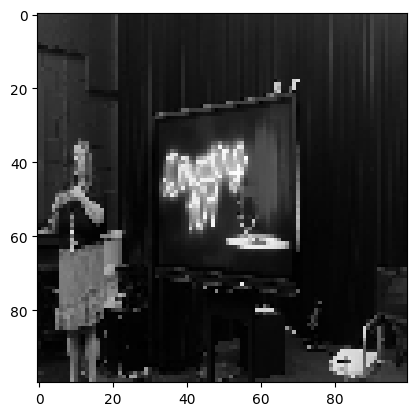

Confidence: [0.9624435]
JERMA LOCATED AT TIMESTAMP: 7775.334233333334


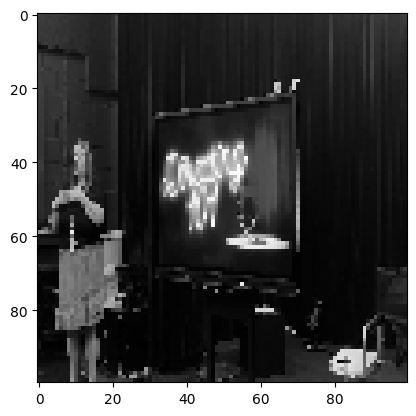

Confidence: [0.95613825]
JERMA LOCATED AT TIMESTAMP: 7775.3676000000005


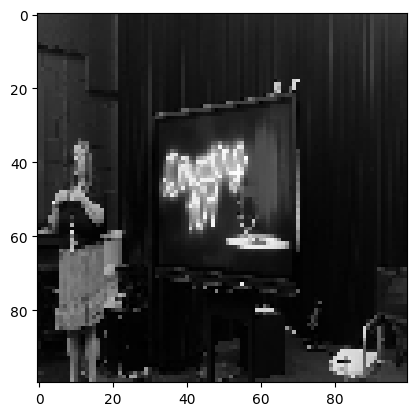

Confidence: [0.9609979]
JERMA LOCATED AT TIMESTAMP: 7775.400966666667


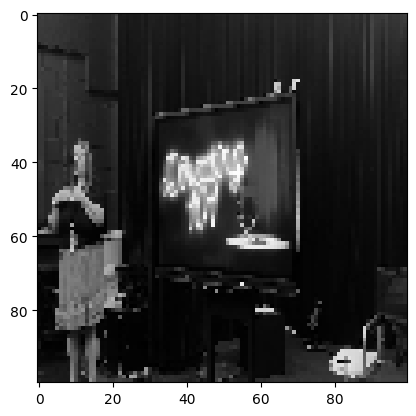

Confidence: [0.95084345]
JERMA LOCATED AT TIMESTAMP: 7775.434333333334


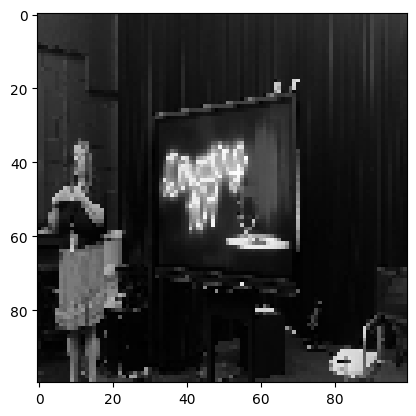

Confidence: [0.96558106]
JERMA LOCATED AT TIMESTAMP: 7775.4677


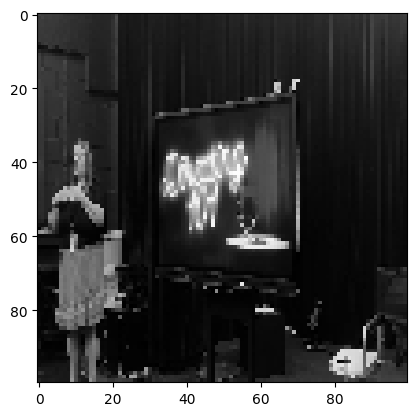

Confidence: [0.9745729]
JERMA LOCATED AT TIMESTAMP: 7775.501066666667


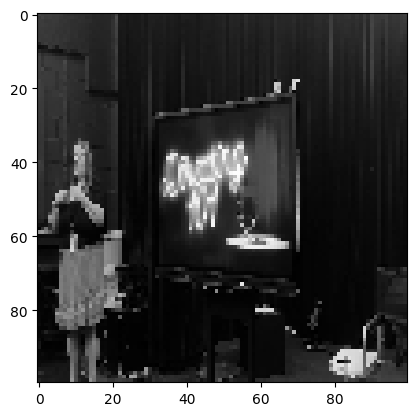

Confidence: [0.97683525]
JERMA LOCATED AT TIMESTAMP: 7775.534433333333


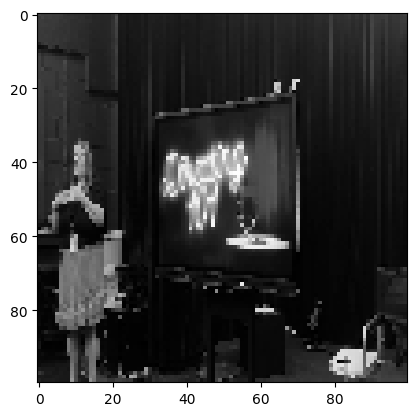

Confidence: [0.9767164]
JERMA LOCATED AT TIMESTAMP: 7775.567800000001


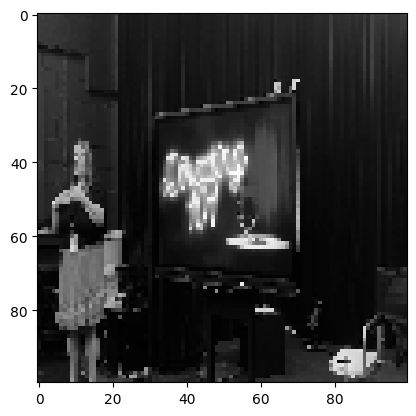

Confidence: [0.9750822]
JERMA LOCATED AT TIMESTAMP: 7775.601166666667


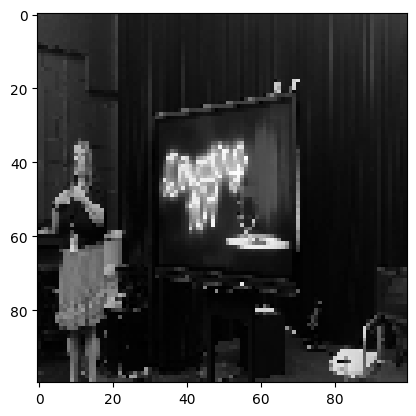

Confidence: [0.974946]
JERMA LOCATED AT TIMESTAMP: 7775.634533333334


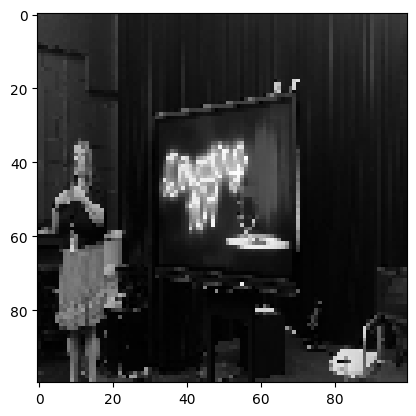

Confidence: [0.9708948]
JERMA LOCATED AT TIMESTAMP: 7775.6679


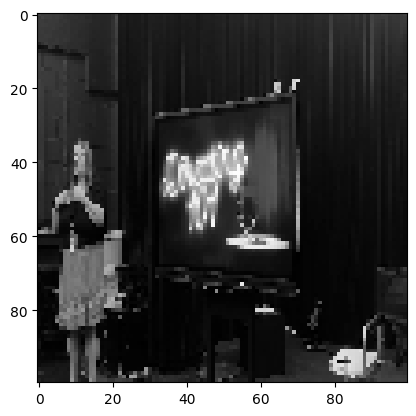

Confidence: [0.97099966]
JERMA LOCATED AT TIMESTAMP: 7775.701266666667


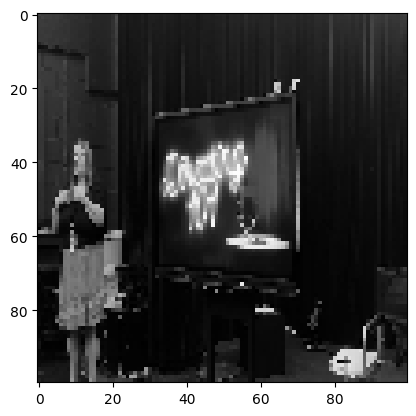

Confidence: [0.97350264]
JERMA LOCATED AT TIMESTAMP: 7775.7346333333335


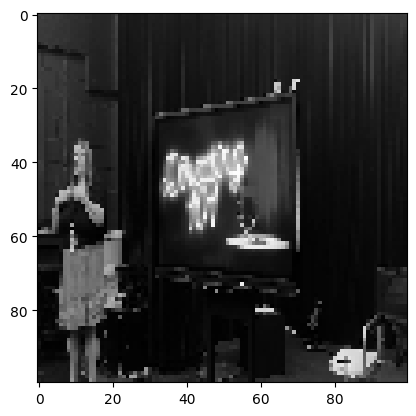

Confidence: [0.9687271]
JERMA LOCATED AT TIMESTAMP: 7775.768


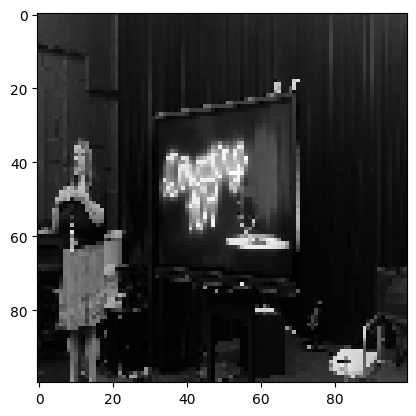

Confidence: [0.96291995]
JERMA LOCATED AT TIMESTAMP: 7775.8013666666675


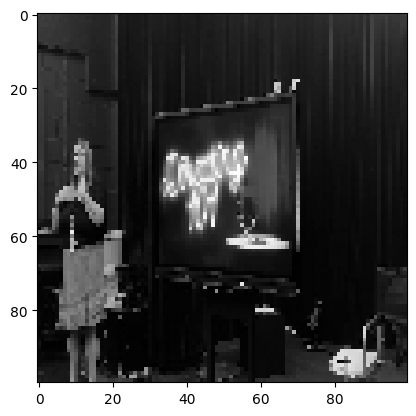

Confidence: [0.9673017]
JERMA LOCATED AT TIMESTAMP: 7775.834733333334


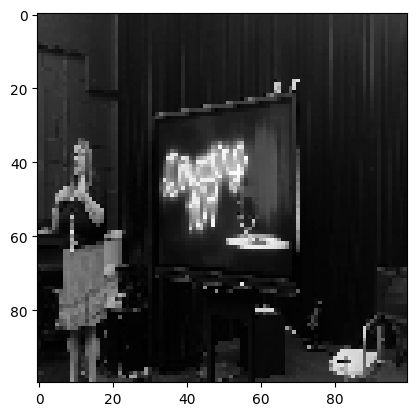

Confidence: [0.9689822]
JERMA LOCATED AT TIMESTAMP: 7775.868100000001


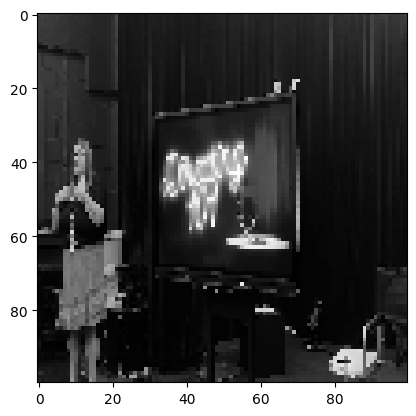

Confidence: [0.9667441]
JERMA LOCATED AT TIMESTAMP: 7775.901466666667


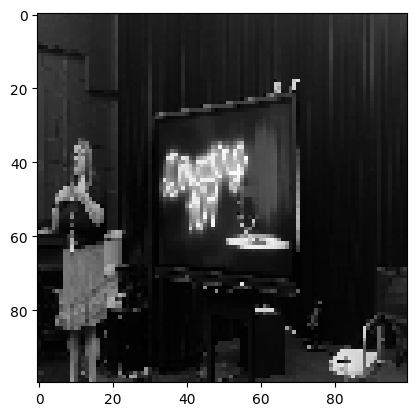

Confidence: [0.96733195]
JERMA LOCATED AT TIMESTAMP: 7775.934833333334


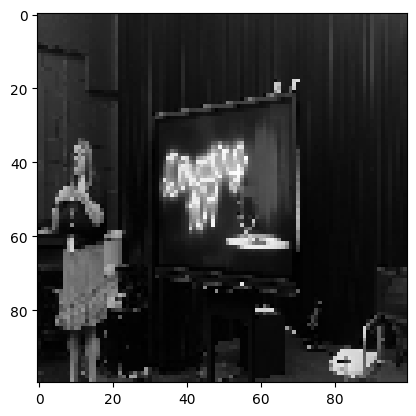

Confidence: [0.9595521]
JERMA LOCATED AT TIMESTAMP: 7775.9682


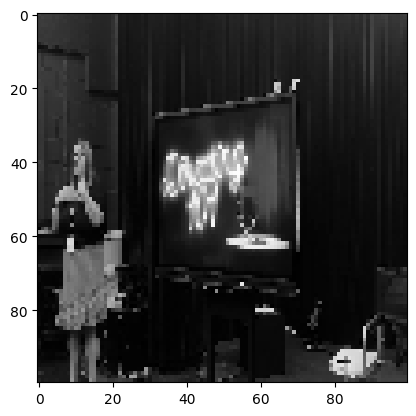

Confidence: [0.9362105]
JERMA LOCATED AT TIMESTAMP: 7776.001566666667


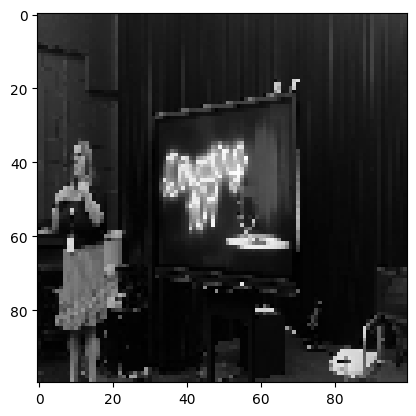

Confidence: [0.9371098]
JERMA LOCATED AT TIMESTAMP: 7776.034933333333


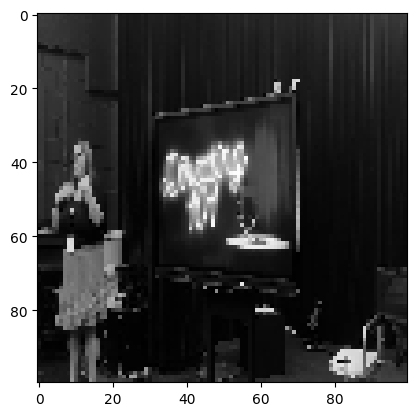

Confidence: [0.9159411]
JERMA LOCATED AT TIMESTAMP: 7776.068300000001


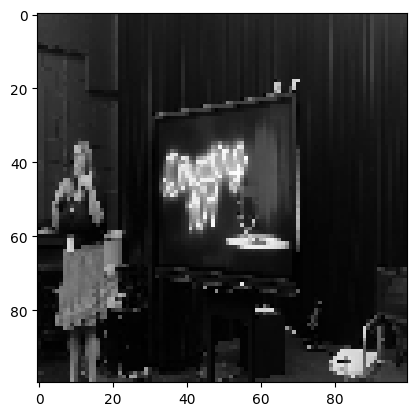

Confidence: [0.9455265]
JERMA LOCATED AT TIMESTAMP: 7776.101666666667


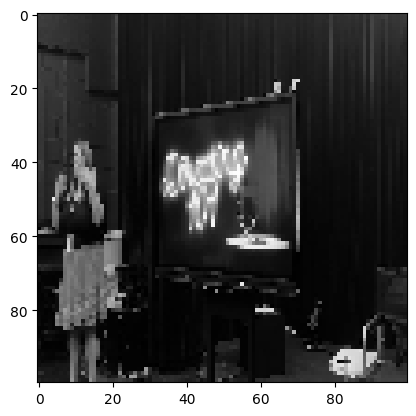

Confidence: [0.9131631]
JERMA LOCATED AT TIMESTAMP: 7776.1684000000005


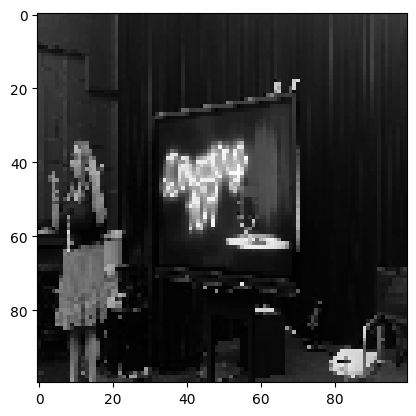

Confidence: [0.92766863]
JERMA LOCATED AT TIMESTAMP: 7776.201766666667


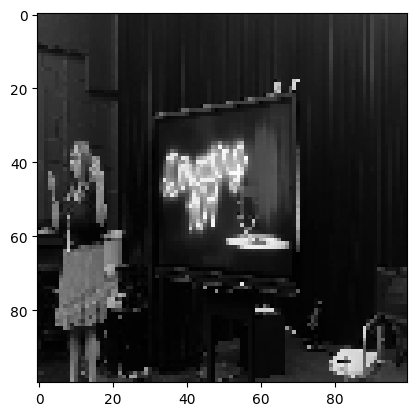

Confidence: [0.92959297]
JERMA LOCATED AT TIMESTAMP: 7776.235133333334


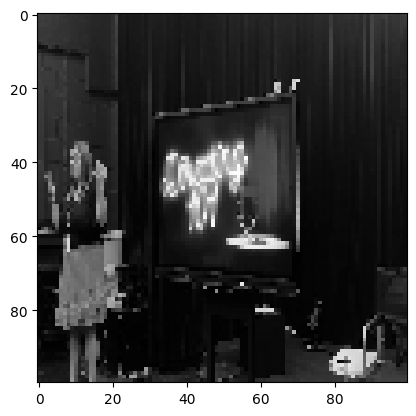

Confidence: [0.9231843]
JERMA LOCATED AT TIMESTAMP: 7776.2685


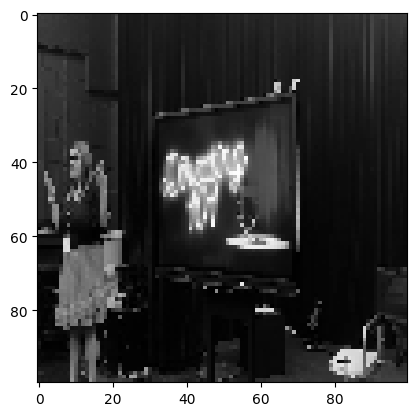

Confidence: [0.93205106]
JERMA LOCATED AT TIMESTAMP: 7776.301866666667


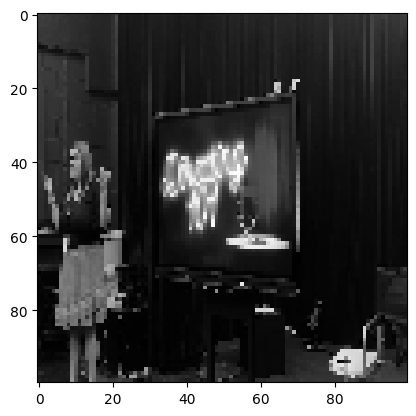

Confidence: [0.9142092]
JERMA LOCATED AT TIMESTAMP: 7776.335233333334


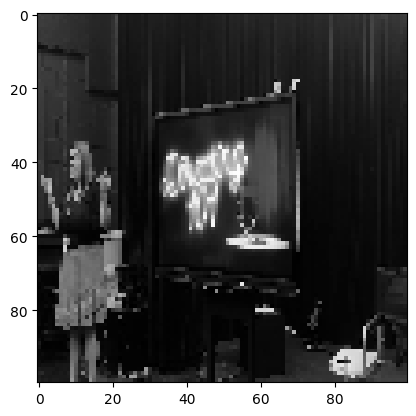

Confidence: [0.91023904]
JERMA LOCATED AT TIMESTAMP: 7776.368600000001


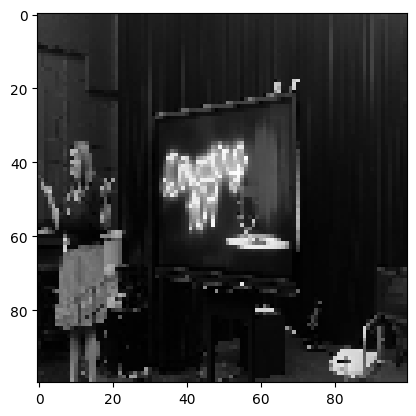

Confidence: [0.9103916]
JERMA LOCATED AT TIMESTAMP: 7776.401966666666


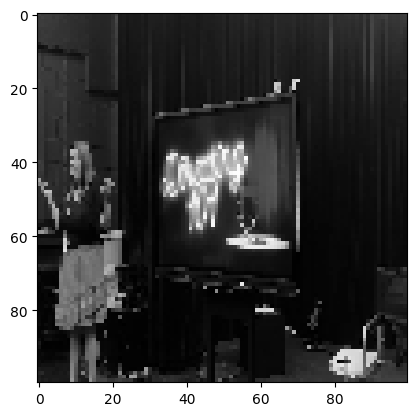

Confidence: [0.93135434]
JERMA LOCATED AT TIMESTAMP: 7776.435333333334


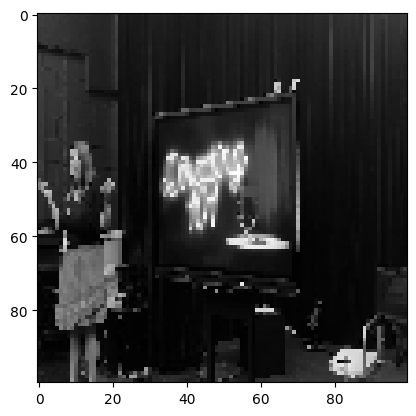

Confidence: [0.91427463]
JERMA LOCATED AT TIMESTAMP: 7776.4687


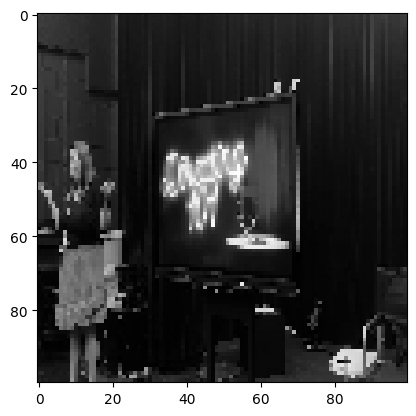

Confidence: [0.91926134]
JERMA LOCATED AT TIMESTAMP: 7776.502066666667


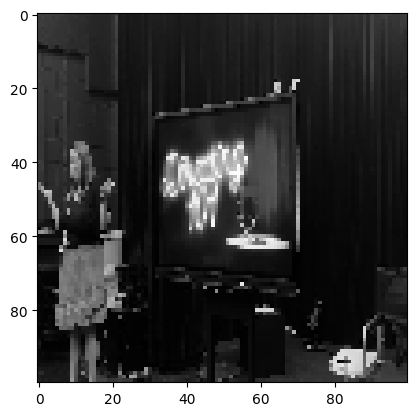

Confidence: [0.9072924]
JERMA LOCATED AT TIMESTAMP: 7776.5354333333335


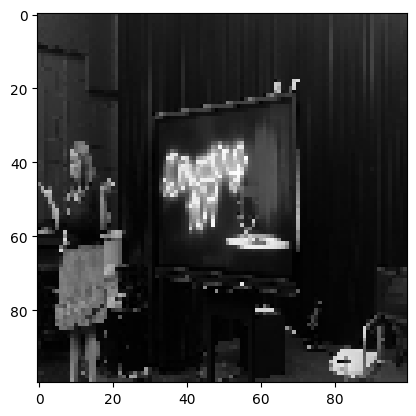

Confidence: [0.9225011]
JERMA LOCATED AT TIMESTAMP: 7776.5688


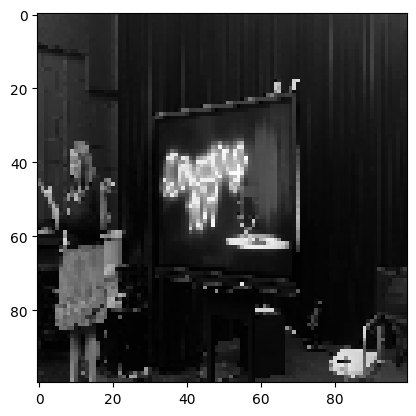

Confidence: [0.9453881]
JERMA LOCATED AT TIMESTAMP: 7777.102666666667


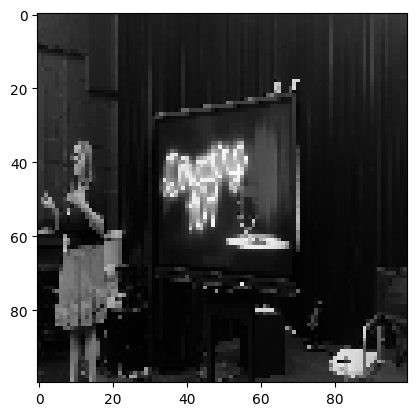

Confidence: [0.94246304]
JERMA LOCATED AT TIMESTAMP: 7777.136033333334


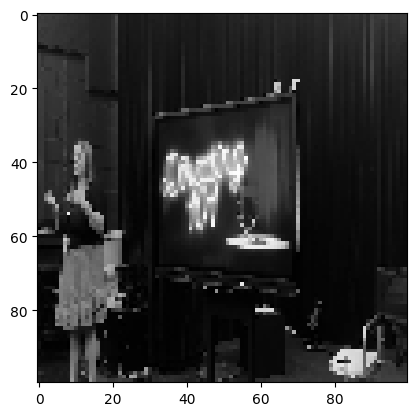

Confidence: [0.954395]
JERMA LOCATED AT TIMESTAMP: 7777.169400000001


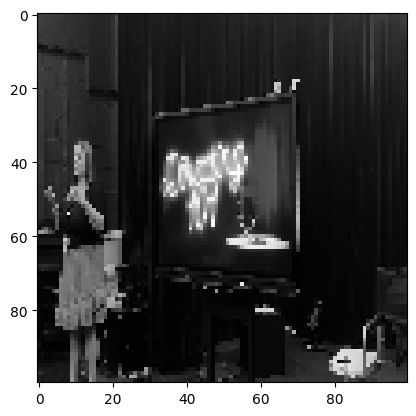

Confidence: [0.95491064]
JERMA LOCATED AT TIMESTAMP: 7777.202766666667


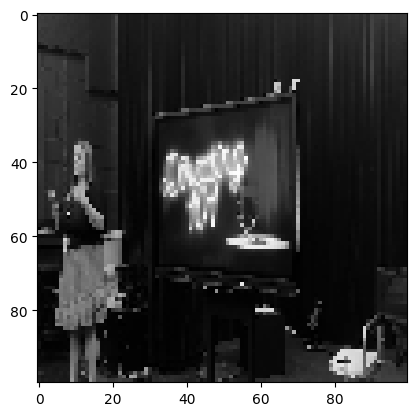

Confidence: [0.9651805]
JERMA LOCATED AT TIMESTAMP: 7777.236133333334


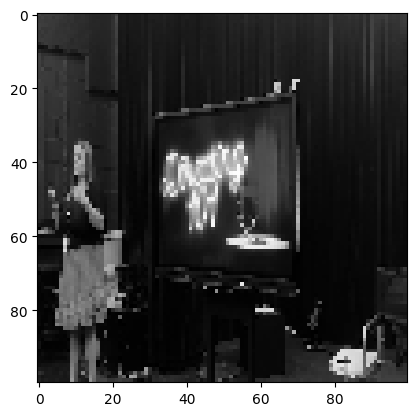

Confidence: [0.96547335]
JERMA LOCATED AT TIMESTAMP: 7777.2695


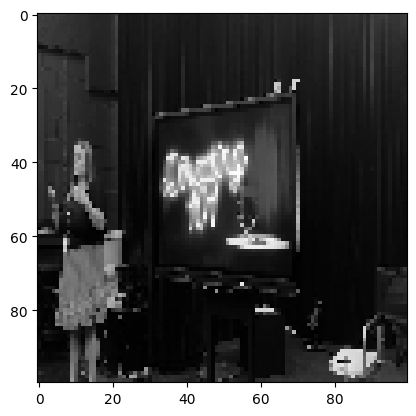

Confidence: [0.96370965]
JERMA LOCATED AT TIMESTAMP: 7777.302866666667


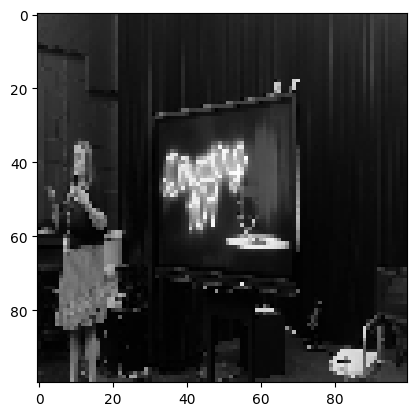

Confidence: [0.95585126]
JERMA LOCATED AT TIMESTAMP: 7777.336233333333


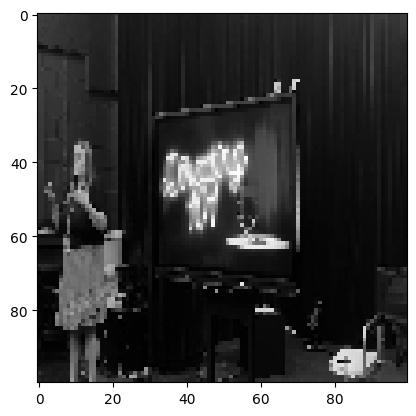

Confidence: [0.9411862]
JERMA LOCATED AT TIMESTAMP: 7777.3696


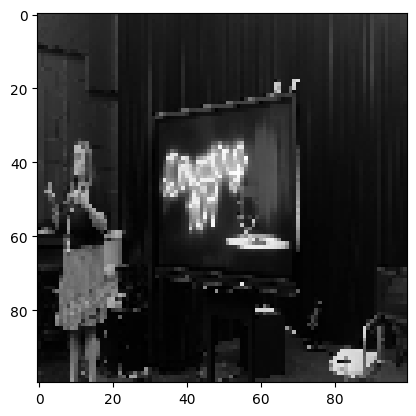

Confidence: [0.9480726]
JERMA LOCATED AT TIMESTAMP: 7777.402966666667


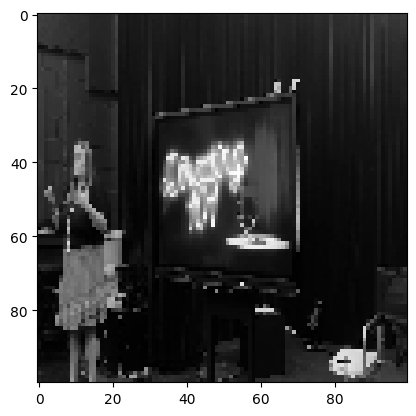

Confidence: [0.9349321]
JERMA LOCATED AT TIMESTAMP: 7777.436333333334


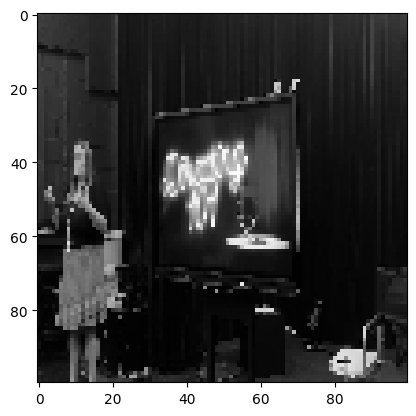

Confidence: [0.9315095]
JERMA LOCATED AT TIMESTAMP: 7777.469700000001


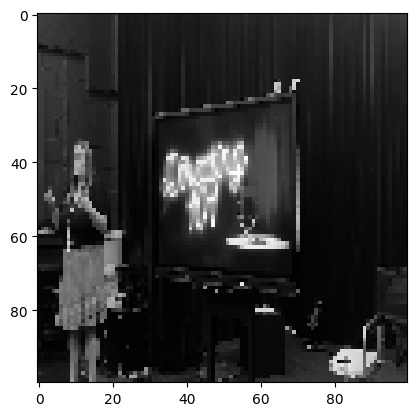

Confidence: [0.93761677]
JERMA LOCATED AT TIMESTAMP: 7777.503066666667


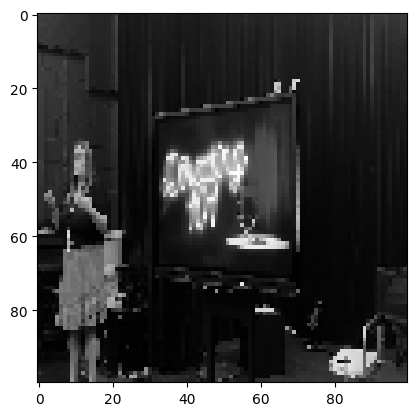

Confidence: [0.93570954]
JERMA LOCATED AT TIMESTAMP: 7777.536433333334


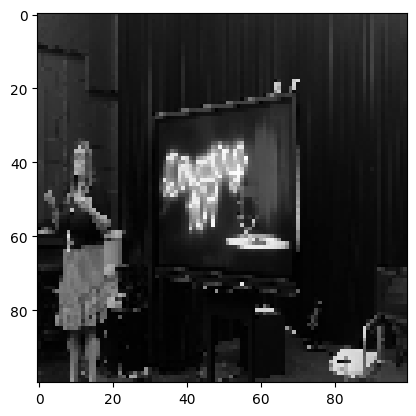

Confidence: [0.9320637]
JERMA LOCATED AT TIMESTAMP: 7777.5698


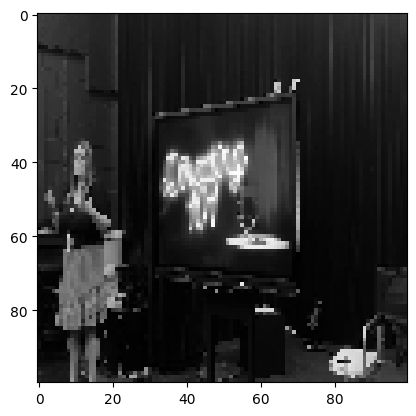

Confidence: [0.93743867]
JERMA LOCATED AT TIMESTAMP: 7777.603166666667


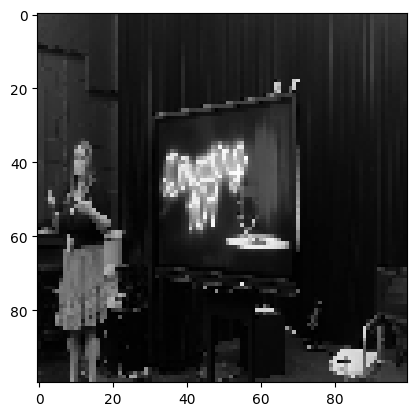

Confidence: [0.9261457]
JERMA LOCATED AT TIMESTAMP: 7777.636533333333


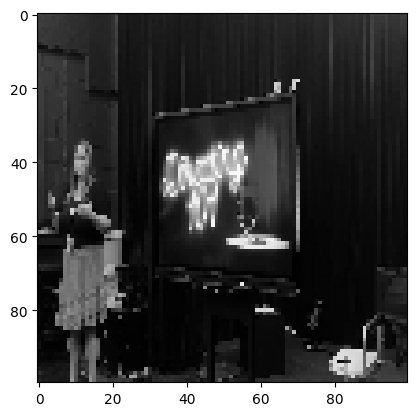

Confidence: [0.9300201]
JERMA LOCATED AT TIMESTAMP: 7777.669900000001


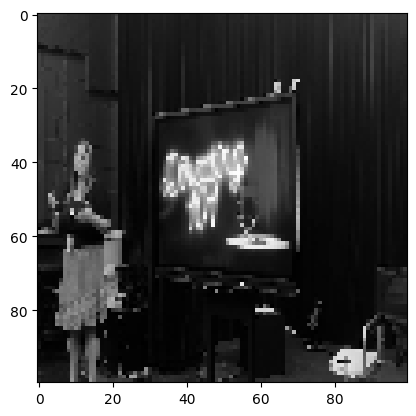

Confidence: [0.9333835]
JERMA LOCATED AT TIMESTAMP: 7777.703266666667


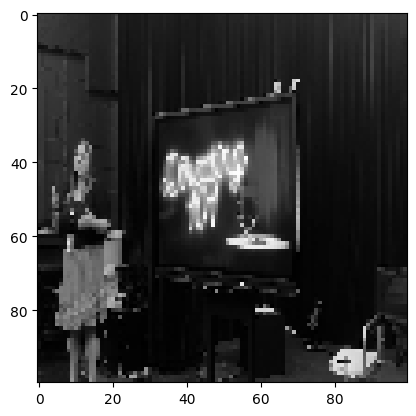

Confidence: [0.92368484]
JERMA LOCATED AT TIMESTAMP: 7777.736633333334


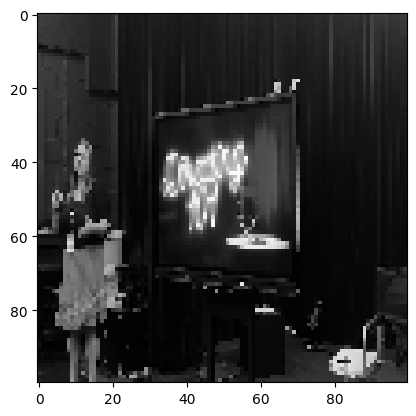

Confidence: [0.9278666]
JERMA LOCATED AT TIMESTAMP: 7777.77


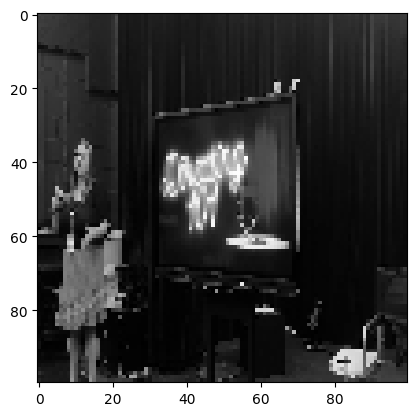

Confidence: [0.9214688]
JERMA LOCATED AT TIMESTAMP: 7777.803366666667


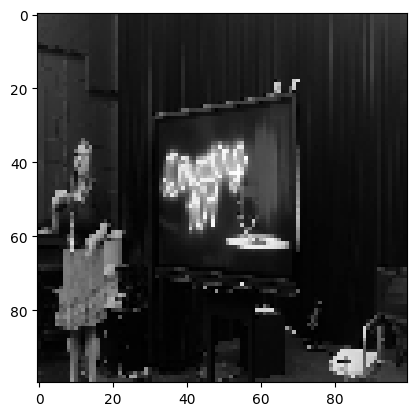

Confidence: [0.93026346]
JERMA LOCATED AT TIMESTAMP: 7777.8367333333335


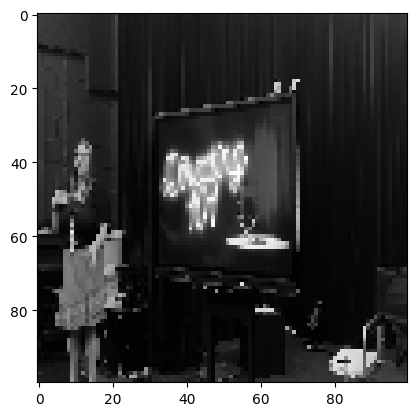

Confidence: [0.931531]
JERMA LOCATED AT TIMESTAMP: 7777.870099999999


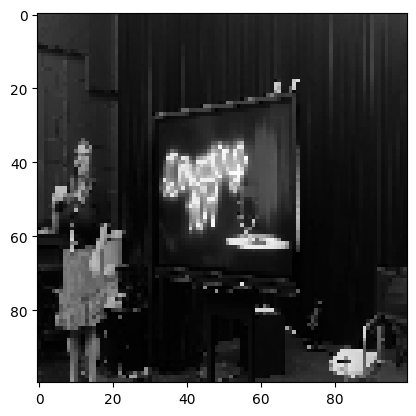

Confidence: [0.9335171]
JERMA LOCATED AT TIMESTAMP: 7777.903466666667


KeyboardInterrupt: ignored

In [ ]:
# the model does still misclassify many images, but also locates the correct image
# started at timestamp 7600 to make it easier to see the moment when the model correctly locates Jerma
timestamp = 7600
while timestamp < 9000:
  timestamp = processVideo(timestamp)

**Saving wrongly classified images of Jerma for further training**

In [ ]:
DIR = "/content/drive/My Drive/jerma/photos/newNeg/nonJermas" # note that nonJermas contains some Jermas
os.makedirs(DIR)

In [ ]:
from PIL import Image
for i, frame in enumerate(saved):
    # Convert the frame to a uint8 NumPy array (assuming it's in the correct format)
    frame_uint8 = (frame * 255).astype(np.uint8)  # Convert from [0, 1] to [0, 255] range for uint8 datatype

    # Convert the NumPy array to a PIL Image and save it
    image = Image.fromarray(frame_uint8)
    image.save(f"{DIR}/{i}.jpeg")  # Replace DIR with your desired directory path

In [ ]:
with open(DIR + "/timestamps.txt", 'a') as file:
    for i, item in enumerate(data):
        file.write(f"{i}: {item}\n")